In [1]:
import sys
import os
import time
import argparse
import numpy as np
import random
import pickle
import itertools
import copy
import pandas as pd
from scipy.special import comb
import matplotlib.pyplot as plt
from PIL import Image
import seaborn as sns
from tqdm.notebook import tqdm

sns.set_style("whitegrid") #darkgrid
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42
SMALL_SIZE=12
MEDIUM_SIZE=15
BIGGER_SIZE=20
plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
#plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
#plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.optimizers import Adam
import tensorflow.keras.layers as layers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import tensorflow.keras.metrics as metrics

physical_devices = tf.config.list_physical_devices('GPU')
try:
  tf.config.experimental.set_memory_growth(physical_devices[0], True)
except:
  # Invalid device or cannot modify virtual devices once initialized.
  pass

import concept_model
import helper
# from test_baselines import run_eval


from utils.test_utils import arg_parser, prepare_data, get_measures
from utils.test_utils import ConceptProfiles
from utils.test_utils import get_recovered_features
from utils.ood_utils import run_ood_over_batch
from utils.stat_utils import hellinger, compute_pval, bayes_posterior, FLD, multivar_separa
from utils.plot_utils import plot_stats, plot_per_class_stats, plot_score_distr
from utils import log


2024-08-12 10:09:03.862261: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-08-12 10:09:03.878685: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-08-12 10:09:03.898161: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-08-12 10:09:03.904092: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-08-12 10:09:03.917891: I tensorflow/core/platform/cpu_feature_guar

In [2]:
class ARGS:
    def __init__(self):

        self.in_data = "data/AwA2/test"
        self.out_data = "SUN" # MSCOCO
        self.workers = 4
        
        self.batch_size = 256
        self.name = "test"
        self.model = "InceptionV3"
        self.model_path = "results/AwA2/inceptionv3_AwA2_normal_epoch_40.weights.h5"
        self.concept_sim_thr = 0.95
        
        self.gpu = "0"
        self.result_dir = f"results/AwA2_2_baseline_normal/epoch_40_{self.concept_sim_thr}" # "results/AwA2_2_feat_l2_0.1_ood_1_sep_50_s0_thr_0.2/epoch_40"
        self.logdir = self.result_dir+"/logs"
        
        self.visualize = True # True False
        self.visualize_with_ood = True # True False
        self.shap = True
        self.separate = True
        self.explain = True
        self.plot = True
        self.out_data_dim = 224
        self.score = "energy"
        self.temperature_energy = 1
        self.temperature_odin = 1000
        

        self.opt = "adam"

args = ARGS()
softmax = layers.Activation('softmax')

In [3]:
def remove_duplicate_concepts(topic_vec, return_mapping=False, thr=0.95):
    # Remove one concept vector if there are two vectors where the dot product is over 0.95
    # topic_vec: dim=(dim_features, n_concepts) (2048, 70)
    # print(np.shape(topic_vec))
    n_concept = topic_vec.shape[1]
    topic_vec_n = topic_vec/(np.linalg.norm(topic_vec,axis=0,keepdims=True)+1e-9)

    topic_vec_n_dot = np.transpose(topic_vec_n) @ topic_vec_n - np.eye(n_concept)
    dict_similar_topic = {}
    idx_delete = set()
    for i in range(n_concept):
        ith_redundant_concepts = [j for j in range(n_concept) if topic_vec_n_dot[i][j] >= thr]
        dict_similar_topic[i] = ith_redundant_concepts
        
        ith_redundant_concepts = [x for x in ith_redundant_concepts if x > i]
        idx_delete.update(ith_redundant_concepts)
    idx_delete = list(idx_delete)

    topic_vec_r = np.delete(topic_vec, idx_delete, axis=1)


    dict_topic_mapping = {}
    count = 0
    for i in range(n_concept):
        if i in idx_delete:
            dict_topic_mapping[i] = None
        else:
            dict_topic_mapping[i] = count
            count += 1
    print('concept mapping between before/after duplicate removal......')
    print(dict_topic_mapping)
    if return_mapping:
        return topic_vec_r, dict_similar_topic, dict_topic_mapping
    else:
        return topic_vec_r, dict_similar_topic

def visualize_nn(test_loader, topic_vec, f_test, save_dir, logger, out_data=None, dir="concepts"):
    num_concept = topic_vec.shape[1]

    f_test_n = f_test/(np.linalg.norm(f_test,axis=3,keepdims=True)+1e-9)
    topic_vec_n = topic_vec/(np.linalg.norm(topic_vec,axis=0,keepdims=True)+1e-9)
    topic_prob = np.matmul(f_test_n,topic_vec_n)
    n_size = np.shape(f_test)[1]
    for i in range(num_concept):
      savepath = os.path.join(save_dir, dir, 'concept'+str(i))
      os.makedirs(savepath, exist_ok=True)
        
      neighbors_num = 15
      ind = np.argpartition(topic_prob[:,:,:,i].flatten(), -neighbors_num)[-neighbors_num:]
      sim_list = topic_prob[:,:,:,i].flatten()[ind]
      logger.info(f'[ID TEST: CONCEPT {i}] top-{neighbors_num} scores: {sim_list}')
      for jc,j in enumerate(ind):
        j_int = int(np.floor(j/(n_size*n_size)))
        a = int((j-j_int*(n_size*n_size))/n_size)
        b = int((j-j_int*(n_size*n_size))%n_size)
        
        if not out_data:
            f1 = savepath+'/concept_full_{}_{}_sim_{}.png'.format(i,jc, round(sim_list[jc], 3))
            f2 = savepath+'/concept_{}_{}_sim_{}.png'.format(i,jc, round(sim_list[jc], 3)) 
        else:
            f1 = savepath+'/{}_concept_full_{}_{}_sim_{}.png'.format(out_data, i,jc, round(sim_list[jc], 3))
            f2 = savepath+'/{}_concept_{}_{}_sim_{}.png'.format(out_data, i,jc, round(sim_list[jc], 3))
            
        # if sim_list[jc]>0.70:
        x_test_filename = test_loader.filepaths[j_int]
        helper.copy_save_image(x_test_filename,f1,f2,a,b)
        

def compute_concept_scores(topic_vec, feature, predict_model=None):
    # topic_vec: concept vectors (dim= (feature_dim, n_concepts))
    # feature: features extracted from an intermediate layer of trained model

    feature_n = tf.math.l2_normalize(feature, axis=3)
    topic_vec_n = tf.math.l2_normalize(topic_vec, axis=0)

    topic_prob = tf.matmul(feature_n, topic_vec_n) # K.dot

    prob_max = tf.math.reduce_max(topic_prob, axis=(1,2))
    prob_max_abs = tf.math.reduce_max(tf.abs(topic_prob), axis=(1,2))
    concept_scores = tf.where(prob_max == prob_max_abs, prob_max, -prob_max_abs)

    """
    ##for debugging
    n_concept = np.shape(concept_scores)[1]
    print(tf.reduce_mean(input_tensor=tf.nn.top_k(K.transpose(K.reshape(topic_prob,(-1,n_concept))),k=10,sorted=True).values))
    print(tf.reduce_mean(input_tensor=K.dot(K.transpose(K.variable(value=topic_vec_n)), K.variable(value=topic_vec_n)) - np.eye(n_concept)))
    """


    if predict_model: # in eager execution
        pred = softmax(predict_model(feature))
        #pred = tf.math.argmax(pred, axis=1)
        return concept_scores.numpy(), pred.numpy()
    else:
        return concept_scores

def prepare_profiles(feature_model, topic_vec, num_classes, args, logger):
    # profiling using validation data
    #profile_path = "{}/AwA2_train_concept_dict.pkl".format(args.result_dir)
    profile_path = "{}/AwA2_val_concept_dict.pkl".format(args.result_dir)
    if not os.path.exists(profile_path):
        logger.info("Profiling the distribution of concept scores from train set...")

        tf.random.set_seed(0)
        datagen = ImageDataGenerator(rescale=1./255.)
                                                #rotation_range=40,
                                                #width_shift_range=0.2, height_shift_range=0.2,
                                                #shear_range=0.2, zoom_range=0.2,
                                                #horizontal_flip=True)
        data_loader = datagen.flow_from_directory("data/AwA2/val", \
                                                batch_size=350, target_size=(224,224), \
                                                class_mode='categorical', \
                                                shuffle=False)

        ConceptP = ConceptProfiles()
        ConceptP.setUp(num_classes, data_loader)
        ConceptP.prepare_concept_dict(feature_model, topic_vec)
        concept_dict = ConceptP.concept_dict

        #LOAD_DIR = 'data/Animals_with_Attributes2'
        #y_train = np.load(LOAD_DIR+'/y_train.npy')
        #y_train = np.argmax(y_train, axis=1)

        logger.info("Saving concept profiles of AwA2 train set in {}".format(profile_path))
        with open(profile_path,'wb') as f:
            pickle.dump(concept_dict, f)

    else:
        logger.info("Loading concept profiles of AwA2 train set from {}".format(profile_path))
        with open(profile_path,'rb') as f:
            concept_dict = pickle.load(f)

    return concept_dict


def compute_coherency(feature, topic_vec):
    """
    compute coherency across top-k nearest neighbors for each concept
    :param topic_vec: concept vectors, dim=(feature_dim, num_concept)
    :param feature: features extracted from an intermediate layer of trained model
    """

    # normalize
    feature_n = tf.math.l2_normalize(feature, axis=3)
    topic_vec_n = tf.math.l2_normalize(topic_vec, axis=0)
    
    topic_prob = tf.matmul(feature_n, topic_vec_n) # normalized concept scores, dim=(num_data, num_concept)
    num_concept = topic_prob.shape[1]
    coher = tf.reduce_mean(tf.nn.top_k(K.transpose(K.reshape(topic_prob,(-1,num_concept))),k=10,sorted=True).values)
    return coher.numpy()

def compute_redundancy(topic_vec):
    """
    compute similarity between concept vectors
    :param topic_vec: normalized concept vectors, dim=(dim_feat, num_concept)
    """
    num_concept = topic_vec.shape[-1]

    topic_vec_n = tf.math.l2_normalize(topic_vec, axis=0)
    redun = tf.reduce_mean(K.dot(K.transpose(topic_vec_n), topic_vec_n) - np.eye(num_concept))
    return redun.numpy()

def compute_completeness(y, yhat, yhat_recov, num_class, logger=None, label=None):
    """
    compute completeness score by Yeh et al.
    :param y: groundtruth class labels, dim=(N,)
    :param yhat: predicted class labels, dim=(N,)
    :param yhat_recov: predicted class labels using recovered features, dim=(N,).
                       If label is not None, per-class predicted labels, dim=(N',) where N' <= N
    """

    acc = np.sum(y == yhat)/len(y)
    if logger:
        logger.info(f'[ID TEST] accuracy with original features: {acc}')
    
    if label is not None:
        acc_recov = np.sum(y[y==label] == yhat_recov)/len(yhat_recov)
        if logger:
            logger.info(f'[ID TEST] per-class accuracy with recovered features: {acc_recov}')
        acc_random = 1/num_class #0.5 #NOTE: check a_r = 0.5?
    else:
        acc_recov = np.sum(y == yhat_recov)/len(y)
        if logger:
            logger.info(f'[ID TEST] accuracy with recovered features: {acc_recov}')
        acc_random = 1/num_class
    
    # compute completeness
    completeness = (acc_recov - acc_random) / (acc - 1/num_class)
    if logger:
        logger.info(f'[ID TEST] completeness score: {completeness}')
    return completeness

def compute_detection_completeness(auroc, auroc_recov, logger=None):
    """
    compute detection completeness score
    """
    # compute completeness
    auroc_random = 1/2
    completeness = (auroc_recov - auroc_random) / (auroc - auroc_random)
    if logger:
        logger.info(f'[DETECTION] auroc with original features: {auroc}')
        logger.info(f'[DETECTION] auroc with recovered features: {auroc_recov}')
        logger.info(f'[DETECTION] completeness score: {completeness}')
    return completeness


def compute_conceptSHAP(concept_mask, topic_vec, 
                        feat_in, feat_out, y, yhat_in, yhat_out, auroc,
                        in_loader, out_loader,
                        topic_model, feature_model, args, logger, 
                        finetune=False, labels=None):

    assert labels is not None

    num_class = 50
    num_concept = topic_vec.shape[1]

    ## modify topic model
    logger.info(f'[ConceptSHAP] using concept mask: {concept_mask}.....')
    #topic_vec_temp = np.random.rand(topic_vec.shape[0], topic_vec.shape[1]) 
    topic_vec_temp = copy.copy(topic_vec)
    topic_vec_temp[:,np.array(concept_mask)==0] = 0
    #print(topic_model.layers[0].get_weights())
    topic_model.layers[0].set_weights([topic_vec_temp])
    #print(topic_model.layers[0].get_weights())

    _, logits_in, _ = topic_model(feat_in)
    _, logits_out, _ = topic_model(feat_out)


    compl_class, compl_detect = np.array([]), np.array([])
    compl_class_2, compl_detect_2 = np.array([]), np.array([])
    for label in labels:
        # compute classification completeness
        _, logits, _ = topic_model(feat_in[np.where(y == label)[0]])
        #print(logits)
        yhat_in_recov = tf.math.argmax(logits, axis=1)
        _compl_class = compute_completeness(y, yhat_in, yhat_in_recov, num_class, logger, label)
        compl_class = np.append(compl_class, _compl_class) 
        
        # compute detection completeness
        idx_in = np.where(tf.math.argmax(logits_in, axis=1).numpy() == label)[0]
        idx_out = np.where(tf.math.argmax(logits_out, axis=1).numpy() == label)[0]
        logger.info(f'[ConceptSHAP CLASS {label}] number of ID: {len(idx_in)} | number of OOD: {len(idx_out)}')
        if len(idx_in) == 0 or len(idx_out) == 0:
            compl_detect = np.append(compl_detect, None)
            continue

        s_in = run_ood_over_batch(None, feature_model, topic_model, args, num_class, feat_in[idx_in])
        s_out = run_ood_over_batch(None, feature_model, topic_model, args, num_class, feat_out[idx_out])
        #s_in, s_out = np.random.rand(len(idx_in)), np.random.rand(len(idx_out))
        auroc_recov, aupr_in, aupr_out, fpr95, thres95 = get_measures(s_in[:,None],s_out[:,None])
        _compl_detect = compute_detection_completeness(auroc, auroc_recov, logger)
        compl_detect = np.append(compl_detect, _compl_detect) 
        logger.info(f'[ConceptSHAP CLASS {label}] auroc: {auroc_recov} | aupr_in: {aupr_in} | aupr_out: {aupr_out} | fpr95: {fpr95} | thres95: {thres95}')
        logger.info(f'[ConceptSHAP CLASS {label}] (before finetuning) classification completeness: {_compl_class} | detection completeness: {_compl_detect}')

        if finetune:
            target_size = (224, 224)
            batch_size = args.batch_size
            train_datagen = ImageDataGenerator(rescale=1. / 255.,
                                           rotation_range=40,
                                           width_shift_range=0.2,
                                           height_shift_range=0.2,
                                           shear_range=0.2,
                                           zoom_range=0.2,
                                           horizontal_flip=True)
            train_loader = train_datagen.flow_from_directory('data/AwA2/train',
                                                    batch_size=batch_size,
                                                    target_size=target_size,
                                                    class_mode='categorical',
                                                    shuffle=True)
            # datagen = ImageDataGenerator(rescale=1.0 / 255.)
            # ood_loader = datagen.flow_from_directory("./data/MSCOCO",
            #                                     batch_size=batch_size,
            #                                     target_size=target_size,
            #                                     class_mode=None, shuffle=True)
    
            optimizer = Adam(learning_rate=0.01)
            optimizer_state = [optimizer.iterations, optimizer.learning_rate, optimizer.beta_1, optimizer.beta_2, optimizer.weight_decay]
            optimizer_reset = tf.compat.v1.variables_initializer(optimizer_state)
            softmax = layers.Activation('softmax')
            #train_acc_metric = tf.keras.metrics.CategoricalAccuracy()
            #test_acc_metric = tf.keras.metrics.CategoricalAccuracy()
        
            COEFF_CONCEPT = 10.0
        
            train_step_signature = [
            tf.TensorSpec(shape=(None, None, None, 3), dtype=tf.float32),
            tf.TensorSpec(shape=(None, None), dtype=tf.float32),
            #tf.TensorSpec(shape=(None, None, None, 3), dtype=tf.float32), 
            ]
            @tf.function(input_signature=train_step_signature)
            def train_step(x_in, y_in): #, x_out=None):
                f_in = feature_model(x_in)
                f_in_n = K.l2_normalize(f_in,axis=(3))
            
                #f_out = feature_model(x_out)
                #f_out_n = K.l2_normalize(f_out,axis=(3))

                obj_terms = {} # terms in the objective function
                with tf.GradientTape() as tape:
                    f_in_recov, logits_in, topic_vec_n = topic_model(f_in, training=True)
                    pred_in = softmax(logits_in) # class prediction using concept scores
                    topic_prob_in_n = K.dot(f_in_n, topic_vec_n) # normalized concept scores

                    #_, logits_out, _ = topic_model(f_out, training=True)
                    #topic_prob_out_n = K.dot(f_out_n, topic_vec_n)

                    # baseline
                    CE_IN = tf.reduce_mean(tf.keras.losses.categorical_crossentropy(y_in, pred_in))
                    loss_coherency = tf.reduce_mean(tf.nn.top_k(K.transpose(K.reshape(topic_prob_in_n,(-1,num_concept))),k=10,sorted=True).values)
                    loss_similarity = tf.reduce_mean(K.dot(K.transpose(topic_vec_n), topic_vec_n) - tf.eye(num_concept))
                    loss = CE_IN - COEFF_CONCEPT*loss_coherency + COEFF_CONCEPT*loss_similarity
                    obj_terms['[ID] CE'] = CE_IN
                    obj_terms['[ID] concept coherency'] = loss_coherency
                    obj_terms['[ID] concept similarity'] = loss_similarity

                grads = tape.gradient(loss, topic_model.trainable_variables)
                optimizer.apply_gradients(zip(grads, topic_model.trainable_variables))
                return obj_terms

            for layer in topic_model.layers:
                layer.trainable = True
                
            for step, (x_in, y_in) in enumerate(train_loader):
                step += 1
                if step == len(train_loader): # >100
                    break
                #x_out = ood_loader.__next__()
                obj_terms = train_step(x_in, y_in) #, x_out)
                if step % 20 == 0:
                    for term in obj_terms:
                        print(f'[STEP{step}] {term}: {obj_terms[term]}')

            for layer in topic_model.layers:
                layer.trainable = False
            #train_acc = train_acc_metric.result()
            #logger.info("Training acc over epoch: %.4f" % (float(train_acc),))

            # compute classification completeness
            _, logits, _ = topic_model(feat_in[np.where(y == label)[0]])
            #print(logits)
            yhat_in_recov = tf.math.argmax(logits, axis=1)
            _compl_class = compute_completeness(y, yhat_in, yhat_in_recov, num_class, logger, label)
            compl_class_2 = np.append(compl_class_2, _compl_class)

            # compute detection completeness
            idx_in = np.where(tf.math.argmax(logits_in, axis=1).numpy() == label)[0]
            idx_out = np.where(tf.math.argmax(logits_out, axis=1).numpy() == label)[0]
            s_in = run_ood_over_batch(None, feature_model, topic_model, args, num_class, feat_in[idx_in])
            s_out = run_ood_over_batch(None, feature_model, topic_model, args, num_class, feat_out[idx_out])
            auroc_recov, aupr_in, aupr_out, fpr95, thres95 = get_measures(s_in[:,None],s_out[:,None])
            _compl_detect = compute_detection_completeness(auroc, auroc_recov, logger)
            compl_detect_2 = np.append(compl_detect_2, _compl_detect)
            logger.info(f'[ConceptSHAP CLASS {label}] auroc: {auroc_recov} | aupr_in: {aupr_in} | aupr_out: {aupr_out} | fpr95: {fpr95} | thres95: {thres95}')
            logger.info(f'[ConceptSHAP CLASS {label}] (after finetuning) classification completeness: {_compl_class} | detection completeness: {_compl_detect}')

        logger.info('--------------------------------------------------------')

    topic_model.layers[0].set_weights([topic_vec])
    if finetune:
        return compl_class_2, compl_detect_2
    else:
        assert len(compl_class) == len(labels)
        assert len(compl_detect) == len(labels)
        return compl_class, compl_detect


def compute_separability(in_concept, out_concept, in_yhat, out_yhat, num_classes, logger=None):
    # compute Multivariate Separability (global)
    separa = {'global': multivar_separa(in_concept, out_concept).numpy()}

    # compute per-class separability
    # num_classes = 50
    num_concepts = in_concept.shape[1]
    for i in range(num_classes):
        idx_in = np.where(in_yhat == i)[0]
        idx_out = np.where(out_yhat == i)[0]
        if logger:
            logger.info(f'class {i}: num IN - {len(idx_in)}, num OUT - {len(idx_out)}')

        ## explanation using groundtruth ID/OOD labels
        #sep_concept_ith = FLD(in_concept[idx_in,:], out_concept[idx_out,:], optimal=False)
        sep_concept_ith = multivar_separa(in_concept[idx_in,:], out_concept[idx_out,:]).numpy()
        if logger:
            logger.info(f'[CLASS {i}: SEPARABILITY, CONCEPTS] separability using groundtruth ID/OOD: {sep_concept_ith}')

        separa['class'+str(i)] = sep_concept_ith

    return separa


def explain_topK(scores, top_k, separa, figname=None):
    """
    Plot bar graph of top-k largest average concept scores
    :param scores: concept scores, dim=(N,num_concepts)
    :param top_k: interested in printing top-k highest concept scores
    :param separa: separability score averaged across concepts or per-class multivariate separability
    """
    s_mean = np.mean(scores, axis=0)
    concept_idx = np.argsort(np.abs(s_mean))[::-1][:top_k] 
    
    num_types = 1 
    num_concepts = top_k
    bar_width = 0.35
    index = np.arange(num_concepts) * bar_width * (num_types + 1)

    fig, ax = plt.subplots(figsize=(3*top_k/5,3))
    bar = ax.bar(index + 0 * bar_width, s_mean[concept_idx],
            bar_width, yerr=np.std(scores[:,concept_idx],axis=0))
    ax.set_title('Top-{0} concept scores, separability: {1:.5f}'.format(top_k, separa))
    ax.set_ylabel('Concept score')
    ax.set_xticks(index + num_types * bar_width / 2)
    ax.set_xticklabels(['concept {}'.format(c) for c in concept_idx], rotation=45)
    fig.tight_layout()
    plt.savefig(figname)
    plt.close()


def explain_relative(scores, labels, separa, shap_class_i, figname, figname_dist, top_k=6):
    """
    scores: dictionary of concept scores of groundtruth ID, groundtruth OOD, ID -> ID, ID -> OOD, OOD -> ID, OOD -> OOD
    labels: labels for different types of scores
    separa: separability scores, dim=(num_concepts,)
    """
    # concepts with top-k separability scores
    concept_idx = np.argsort(shap_class_i)[::-1][:top_k] # top K: from largest to smallest value
    # concept_idx = np.arange(top_k)
    num_types = len(labels)
    num_concepts = top_k
    bar_width = 0.35
    # create location for each bar. scale by an appropriate factor to ensure 
    # the final plot doesn't have any parts overlapping
    index = np.arange(num_concepts) * bar_width * (num_types + 1)

    fig, ax = plt.subplots(figsize=(3*top_k/2,5))
    for i in range(num_types):
        bar = ax.bar(index + i * bar_width, np.mean(scores[labels[i]][:,concept_idx],axis=0),
                bar_width, yerr=np.std(scores[labels[i]][:,concept_idx],axis=0), 
                label=f"{labels[i]}, num={len(scores[labels[i]])}")
    ax.set_title('Concept scores for each concept and ID/OOD data, separability: {1:.5f}'.format(top_k, separa))
    ax.set_ylabel('Concept score')
    ax.set_xticks(index + num_types * bar_width / 2)
    ax.set_xticklabels([f'concept {c}\nshap={round(shap_class_i[c], 3)}' for c in concept_idx], rotation=45)
    ax.legend()
    fig.tight_layout()
    plt.savefig(figname)
    plt.close()



def save_images(filepaths, figname, k=5):

    fig, axes = plt.subplots(1,k)
    count = 0
    np.random.shuffle(filepaths)
    for f in filepaths:
        img = Image.open(f).resize((100,100), Image.LANCZOS)
        axes[count].imshow(img)
        #ax2.set_title("ID image", size=10, color='b')
        axes[count].axis('off')
    
        count += 1
        if count >= k:
            break

    fig.savefig(figname)
    plt.close()

def run_eval(feature_model, predict_model, in_loader, out_loader, logger, args, num_classes):
    in_scores = np.array([])
    for i, (x, y) in tqdm(enumerate(in_loader)):
        if i == len(in_loader):
            break
        score = run_ood_over_batch(x, feature_model, predict_model, args, num_classes).numpy()
        in_scores = np.concatenate([in_scores, score])
    out_scores = np.array([])
    for i, x in tqdm(enumerate(out_loader)):
        if i == len(in_loader):
            break
        score = run_ood_over_batch(x, feature_model, predict_model, args, num_classes).numpy()
        out_scores = np.concatenate([out_scores, score])
    in_examples = np.expand_dims(in_scores, axis=1)
    out_examples = np.expand_dims(out_scores, axis=1)
    auroc, aupr_in, aupr_out, fpr, thres95 = get_measures(in_examples, out_examples)
    return in_scores, out_scores, auroc, fpr, thres95

def get_class_labels(loader, savepath):
    """
    extract groundtruth class labels from data loader
    :param loader: data loader
    :param savepath: path to the numpy file
    """

    if os.path.exists(savepath):
        y = np.load(savepath)
    else:
        num_data = len(loader.filenames)
        y = []
        for (_, y_batch), _ in zip(loader, range(len(loader))):
            y.extend(y_batch)
       
        np.save(savepath, y)
    return y

In [4]:
with tf.device('/CPU:0'):

    logger = log.setup_logger(args, filename="eval_{}.log".format(args.score))
    LOAD_DIR = 'data/AwA2'
    TOPIC_PATH = os.path.join(args.result_dir,'topic_vec_inceptionv3.npy')
    INPUT_SHAPE = (args.out_data_dim, args.out_data_dim)
    TRAIN_DIR = "data/AwA2/train"
    N_CLASSES = 50
    N_CONCEPTS_ORIG = 100 #np.shape(topic_vec_orig)[-1]
    _ = 0
    
    if args.score == 'ODIN':
        args.batch_size = 200
    
    if not os.path.exists(os.path.join(args.result_dir, 'plots')):
        os.makedirs(os.path.join(args.result_dir, 'plots'))
    if not os.path.exists(os.path.join(args.result_dir, 'explanations')):
        os.makedirs(os.path.join(args.result_dir, 'explanations'))
    if not os.path.exists(os.path.join(args.result_dir, 'explanations', args.out_data+'_'+args.score)):
        os.makedirs(os.path.join(args.result_dir, 'explanations', args.out_data+'_'+args.score))
    explain_dir = os.path.join(args.result_dir, 'explanations', args.out_data+'_'+args.score)
    
    in_loader, out_loader = prepare_data(args, logger)
    
    ## load trained_model
    logger.info(f"Loading model from {args.model_path}")
    feature_model, predict_model = helper.load_model_inception_new(_, in_loader, batch_size=args.batch_size, 
                                        input_size=INPUT_SHAPE, pretrain=True, modelname=args.model_path)
    
    in_test_features = feature_model.predict(in_loader)
    out_test_features = feature_model.predict(out_loader, steps=len(in_loader))
    N_IN = in_test_features.shape[0]
    N_OUT = out_test_features.shape[0]


2024-08-12 10:09:09.734407: I tensorflow/core/common_runtime/gpu/gpu_device.cc:2021] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 448 MB memory:  -> device: 0, name: Tesla V100-SXM2-32GB, pci bus id: 0000:af:00.0, compute capability: 7.0
2024-08-12 10:09:09,743 [INFO] utils.log: <__main__.ARGS object at 0x7f5536426310>


Found 3772 images belonging to 50 classes.
Found 10000 images belonging to 1 classes.


2024-08-12 10:09:10,320 [INFO] utils.log: Using an in-distribution set.
2024-08-12 10:09:10,323 [INFO] utils.log: Using an out-of-distribution set.
2024-08-12 10:09:10,325 [INFO] utils.log: Loading model from results/AwA2/inceptionv3_AwA2_normal_epoch_40.weights.h5




original model to be trained


/home/dingw/.conda/envs/adv_train/lib/python3.11/site-packages/keras/src/saving/saving_lib.py:576: UserWarning: Skipping variable loading for optimizer 'adam', because it has 2 variables whereas the saved optimizer has 10 variables. 
  saveable.load_own_variables(weights_store.get(inner_path))
/home/dingw/.conda/envs/adv_train/lib/python3.11/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
I0000 00:00:1723450171.367429 1324027 service.cc:146] XLA service 0x7f538c011170 initialized for platform Host (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1723450171.367477 1324027 service.cc:154]   StreamExecutor device (0): Host, Default Version
2024-08-12 10:09:31.492194: I tensor

15/15 ━━━━━━━━━━━━━━━━━━━━ 101s 6s/step - accuracy: 0.8741 - loss: 0.7714
Loss of the trained original model: 0.7113224267959595
Accuracy of the trained original model: 0.8950158953666687


Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_2 (InputLayer)            │ (None, 5, 5, 2048)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_max_pooling2d            │ (None, 2048)           │             0 │
│ (GlobalMaxPooling2D)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 2048)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 256)            │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 256)            │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_1 (Dense)                 │ (None, 50)             │        12,850 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 537,394 (2.05 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 537,394 (2.05 MB)

None
15/15 ━━━━━━━━━━━━━━━━━━━━ 98s 6s/step
15/15 ━━━━━━━━━━━━━━━━━━━━ 104s 6s/step


In [5]:
args.result_dir

'results/AwA2_2_baseline_normal/epoch_40_0.95'

In [6]:
with tf.device('/CPU:0'):
    ## load topic model
    topic_model = concept_model.TopicModel(in_test_features, N_CONCEPTS_ORIG, thres=0.0, predict=predict_model)
    for layer in topic_model.layers:
        layer.trainable = False
    topic_model(in_test_features)
    topic_model.load_weights(os.path.dirname(args.result_dir)+f"/topic_epoch{os.path.dirname(args.logdir).split('_')[-2]}.weights.h5")

In [7]:
with tf.device('/CPU:0'):

    ## load topic_vec
    topic_vec_orig = topic_model.layers[0].get_weights()[0]
    np.save(args.result_dir+'/topic_vec_orig.npy', topic_vec_orig)
    logger.info(f'Number of concepts before removing duplicate ones: {str(N_CONCEPTS_ORIG)}')
    
    topic_vec, dict_dupl_topic = remove_duplicate_concepts(topic_vec_orig, thr=args.concept_sim_thr)
    N_CONCEPTS = np.shape(topic_vec)[-1] # 25
    logger.info(f'Number of concepts after removing duplicate ones: {str(N_CONCEPTS)}')
    
    in_test_concepts, in_test_logits = compute_concept_scores(topic_vec, in_test_features, predict_model)
    out_test_concepts, out_test_logits = compute_concept_scores(topic_vec, out_test_features, predict_model)
    in_test_yhat = np.argmax(in_test_logits, axis=1) 
    out_test_yhat = np.argmax(out_test_logits, axis=1)

2024-08-12 10:14:51,175 [INFO] utils.log: Number of concepts before removing duplicate ones: 100
2024-08-12 10:14:51,256 [INFO] utils.log: Number of concepts after removing duplicate ones: 34


concept mapping between before/after duplicate removal......
{0: 0, 1: 1, 2: 2, 3: 3, 4: None, 5: 4, 6: 5, 7: None, 8: 6, 9: 7, 10: 8, 11: 9, 12: 10, 13: None, 14: None, 15: 11, 16: None, 17: 12, 18: 13, 19: None, 20: None, 21: 14, 22: 15, 23: 16, 24: 17, 25: None, 26: 18, 27: 19, 28: None, 29: 20, 30: None, 31: None, 32: None, 33: 21, 34: 22, 35: None, 36: 23, 37: None, 38: None, 39: None, 40: 24, 41: None, 42: None, 43: None, 44: None, 45: None, 46: None, 47: None, 48: None, 49: None, 50: None, 51: 25, 52: None, 53: None, 54: None, 55: None, 56: None, 57: None, 58: None, 59: None, 60: None, 61: None, 62: None, 63: None, 64: None, 65: 26, 66: None, 67: None, 68: None, 69: None, 70: None, 71: 27, 72: None, 73: 28, 74: None, 75: None, 76: None, 77: 29, 78: 30, 79: None, 80: None, 81: None, 82: 31, 83: 32, 84: None, 85: None, 86: None, 87: None, 88: None, 89: None, 90: None, 91: None, 92: None, 93: None, 94: None, 95: None, 96: None, 97: None, 98: 33, 99: None}


In [8]:
with tf.device('/CPU:0'):
    ## Visualize the nearest neighbors
    if args.visualize:
        visualize_nn(in_loader, topic_vec, in_test_features, args.result_dir, logger)
    if args.visualize_with_ood:
        visualize_nn(out_loader, topic_vec, out_test_features, args.result_dir, logger, args.out_data)


2024-08-12 10:14:54,661 [INFO] utils.log: [ID TEST: CONCEPT 0] top-15 scores: [0.7742039  0.774439   0.7748876  0.7801432  0.78046036 0.7766548
 0.7761112  0.77900505 0.7853343  0.7860842  0.788719   0.7953527
 0.79929936 0.7928829  0.79385936]
2024-08-12 10:14:59,526 [INFO] utils.log: [ID TEST: CONCEPT 1] top-15 scores: [0.78342235 0.783521   0.78364533 0.78974825 0.78933007 0.7838859
 0.7910979  0.7835591  0.78933895 0.78645384 0.79028255 0.81363255
 0.7935834  0.7887372  0.78770137]
2024-08-12 10:15:03,843 [INFO] utils.log: [ID TEST: CONCEPT 2] top-15 scores: [0.74813133 0.7496848  0.7833135  0.75928175 0.77771693 0.7669567
 0.7525966  0.75496185 0.78238106 0.7645464  0.75378096 0.7545926
 0.7712778  0.7565353  0.77646506]
2024-08-12 10:15:09,021 [INFO] utils.log: [ID TEST: CONCEPT 3] top-15 scores: [0.847221   0.8483144  0.84799063 0.8486535  0.851948   0.8513071
 0.85055935 0.8683002  0.8539558  0.85677075 0.8532916  0.85530686
 0.85808504 0.8574655  0.87281865]
2024-08-12 10:15:1

In [9]:
with tf.device('/CPU:0'):
    # target OOD detector
    logger.info("[ID TEST] performance of target OOD detector with test set...")
    in_test_scores, out_test_scores, auroc, fpr, thres95 = run_eval(feature_model, predict_model, in_loader, out_loader, logger, args, N_CLASSES)
    # in_test_scores, out_test_scores, thres95, auroc = np.random.rand(N_IN), np.random.rand(N_OUT), 0.5419758558273315, 0.955332290562036
    
    # Plot ID vs OOD scores by the target detector
    savefig = os.path.join(args.result_dir, 'plots', '{}_AwA2_test_{}_test.jpg'.format(args.score, args.out_data))
    plot_stats(in_test_scores, out_test_scores, savename=savefig)
    
    ######################################
    ## Evaluating coherency......
    coherency = compute_coherency(in_test_features, topic_vec)
    logger.info(f'[ID TEST] coherency: {coherency}')
    
    ######################################
    ## Evaluating redundancy.......
    redundancy = compute_redundancy(topic_vec)
    logger.info(f'[CONCEPTS] redundancy: {redundancy}')
    
    #######################################
    ## Evaluating the difference between two worlds......
    y_test = np.argmax(np.load('data/AwA2/y_test.npy'), axis=1) # true labels
    
    logger.info("[ID TEST RECOVERED] performance of target OOD detector with test set...")
    in_test_scores_recov, out_test_scores_recov, auroc_recov, fpr_recov, thres95_recov = run_eval(feature_model, topic_model, in_loader, out_loader, logger, args, N_CLASSES)
    savefig = os.path.join(args.result_dir, 'plots', '{}_recov_AwA2_test_{}_test.jpg'.format(args.score, args.out_data))
    plot_stats(in_test_scores_recov, out_test_scores_recov, savename=savefig)
    
    # compute completeness scores
    _, logits_recov, _ = topic_model(in_test_features)
    in_test_yhat_recov = tf.math.argmax(logits_recov, axis=1).numpy()
    compute_completeness(y_test, in_test_yhat, in_test_yhat_recov, N_CLASSES, logger)
    compute_detection_completeness(auroc, auroc_recov, logger)
    
    ######################################
    ## Compute Hellinger distance between original vs reconstructed classifier outputs
    in_test_logits_recov = softmax(logits_recov).numpy()
    H = np.array([hellinger(in_test_logits[i,:], in_test_logits_recov[i,:]) for i in range(in_test_logits.shape[0])])
    fig = plt.figure()
    ax = plt.subplot(111)
    sns.histplot(H, color='blue')
    ax.legend(['in-distribution (test)'])
    fig.savefig(os.path.join(args.result_dir, 'plots', 'classification_hellinger.jpg'))
    plt.close()
    
    ######################################
    # Save results....
    results = {'in_yhat':in_test_yhat, 'out_yhat':out_test_yhat, 
            'in_yhat_recov':in_test_yhat_recov, 
            # 'out_yhat_recov':out_test_yhat_recov,
            'in_logits':in_test_logits, 'in_logits_recov':in_test_logits_recov,
            'in_concepts':in_test_concepts, 'out_concepts':out_test_concepts,
            'in_scores':in_test_scores, 'out_scores':out_test_scores,
            'thres':thres95,
            'in_scores_recov':in_test_scores_recov, 'out_scores_recov':out_test_scores_recov}
    
    result_path = os.path.join(args.result_dir,'results_{}_{}.pkl'.format(args.score,args.out_data))
    with open(result_path,'wb') as f:
        pickle.dump(results, f)

2024-08-12 10:19:17,707 [INFO] utils.log: [ID TEST] performance of target OOD detector with test set...


0it [00:00, ?it/s]

0it [00:00, ?it/s]

3046


2024-08-12 10:24:14,375 [INFO] utils.log: [ID TEST] coherency: 0.8638136386871338
2024-08-12 10:24:14,381 [INFO] utils.log: [CONCEPTS] redundancy: 0.017867231741547585
2024-08-12 10:24:14,389 [INFO] utils.log: [ID TEST RECOVERED] performance of target OOD detector with test set...


0it [00:00, ?it/s]

0it [00:00, ?it/s]

3176


2024-08-12 10:30:14,031 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:30:14,034 [INFO] utils.log: [ID TEST] accuracy with recovered features: 0.8753976670201484
2024-08-12 10:30:14,036 [INFO] utils.log: [ID TEST] completeness score: 0.977579562256102
2024-08-12 10:30:14,037 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:30:14,039 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9727966071270767
2024-08-12 10:30:14,041 [INFO] utils.log: [DETECTION] completeness score: 0.9723518753610889


<Figure size 1200x400 with 0 Axes>

<Figure size 1200x400 with 0 Axes>

In [10]:
with tf.device('/CPU:0'):
    ## Evaluating separability of concepts......
    #separa_path = os.path.join(args.result_dir, 'separability_AwA2_{}_raw.npy'.format(args.out_data))
    separa_path = os.path.join(args.result_dir, 'separability_{}_AwA2_{}_multiv.npy'.format(args.score, args.out_data))
    if args.separate:
        idx_IN_IN = in_test_scores >= thres95
        idx_IN_OUT = ~idx_IN_IN
        idx_OUT_IN = out_test_scores >= thres95
        idx_OUT_OUT = ~idx_OUT_IN
        # separa = compute_separability(in_test_concepts, out_test_concepts, in_test_yhat, out_test_yhat, logger) # using groundtruth ID/OOD labels
        in_detect_concepts = np.r_[in_test_concepts[idx_IN_IN], out_test_concepts[idx_OUT_IN]]
        out_detect_concepts = np.r_[in_test_concepts[idx_IN_OUT], out_test_concepts[idx_OUT_OUT]]
        in_detect_yhat = np.r_[in_test_yhat[idx_IN_IN], out_test_yhat[idx_OUT_IN]]
        out_detect_yhat = np.r_[in_test_yhat[idx_IN_OUT], out_test_yhat[idx_OUT_OUT]]
        separa = compute_separability(in_detect_concepts, out_detect_concepts, in_detect_yhat, out_detect_yhat, N_CLASSES, logger) # using detector's ID/OOD results in canonical world
    
        separa_global = separa['global']
        logger.info(f'[GLOBAL SEPARABILITY] multivariate separability: {separa_global}')
        separa_class = np.array([separa['class'+str(i)] for i in range(N_CLASSES)], dtype=np.float64)
        logger.info(f'[PER-CLASS SEPARABILIRY] averaged separability: {np.nanmean(separa_class)}')
    
        rlt_dir_ = []
        for p_ in args.result_dir.split("/"):        
            if "AwA2" in p_:
                rlt_dir_ += ["AwA2_2_baseline_normal"]
            elif "epoch" in p_:
                rlt_dir_ += [f"epoch_40_{args.concept_sim_thr}"]
            else:
                rlt_dir_ += [p_]
        baseline_folder = "/".join(rlt_dir_)
    
        separa0_path = os.path.join(baseline_folder, 'separability_{}_AwA2_{}_multiv.npy'.format(args.score, args.out_data))
        if os.path.exists(separa0_path):
            import statistics 
            separa0 = np.load(separa0_path, allow_pickle=True).item()
            rel_separa_list = []
            for i in range(N_CLASSES):
                if np.isnan(separa0['class'+str(i)]) or np.isnan(separa['class'+str(i)]):
                    continue
                else:
                    rel_ = (separa['class'+str(i)] - separa0['class'+str(i)]) / separa0['class'+str(i)]
                    rel_separa_list.append(rel_)
            rel_separa = statistics.median(rel_separa_list)
            logger.info(f'[RELATIVE SEPARABILITY] relative separability: {rel_separa}')
            separa['relative'] = rel_separa
    
        np.save(separa_path, separa)


2024-08-12 10:30:14,994 [INFO] utils.log: class 0: num IN - 101, num OUT - 4
2024-08-12 10:30:15,002 [INFO] utils.log: [CLASS 0: SEPARABILITY, CONCEPTS] separability using groundtruth ID/OOD: 0.734642744064331
2024-08-12 10:30:15,005 [INFO] utils.log: class 1: num IN - 27, num OUT - 316
2024-08-12 10:30:15,012 [INFO] utils.log: [CLASS 1: SEPARABILITY, CONCEPTS] separability using groundtruth ID/OOD: 0.036323465406894684
2024-08-12 10:30:15,015 [INFO] utils.log: class 2: num IN - 19, num OUT - 31
2024-08-12 10:30:15,024 [INFO] utils.log: [CLASS 2: SEPARABILITY, CONCEPTS] separability using groundtruth ID/OOD: 0.9298259615898132
2024-08-12 10:30:15,026 [INFO] utils.log: class 3: num IN - 0, num OUT - 0
2024-08-12 10:30:15,032 [INFO] utils.log: [CLASS 3: SEPARABILITY, CONCEPTS] separability using groundtruth ID/OOD: nan
2024-08-12 10:30:15,034 [INFO] utils.log: class 4: num IN - 63, num OUT - 29
2024-08-12 10:30:15,040 [INFO] utils.log: [CLASS 4: SEPARABILITY, CONCEPTS] separability using

In [11]:
with tf.device('/CPU:0'):
    # Generating explanations.....
    classes = np.argsort(separa_class)[::-1]
    #classes = np.append(classes[:5],[c for c in classes[-9:] if separa_class[c]]) # omitting classes with separability==0
    classes = np.delete(classes, np.where(np.isnan(separa_class[classes]))[0])
    
    if args.explain:
        logger.info(f'classes with highest and lowest separabilities...: {classes}')
        k = 10
        for i in range(N_CLASSES):
    
            idx_in = np.where(in_test_yhat == i)[0]
            idx_out = np.where(out_test_yhat == i)[0]
            in_concepts_ith = in_test_concepts[idx_in,:] # concept scores of ID data classified as class i
            out_concepts_ith = out_test_concepts[idx_out,:] # concept scores of OOD data classified as class i
            
            if len(idx_in) == 0 or len(idx_out) ==0:
                continue
    
            # indices for OOD detection results
            idx_IN_IN = in_test_scores[idx_in] >= thres95   # ID detected as ID
            idx_IN_OUT = ~idx_IN_IN                 # ID detected as OOD
            idx_OUT_OUT = out_test_scores[idx_out] < thres95 # OOD detected as OOD
            idx_OUT_IN = ~idx_OUT_OUT               # OOD detected as ID
    
            # print(np.sum(idx_IN_IN))
            # print(np.sum(idx_IN_OUT))
            # print(np.sum(idx_OUT_OUT))
            # print(np.sum(idx_OUT_IN))
            
            explain_topK(in_concepts_ith, top_k=k, separa=separa_class[i], 
                        figname=os.path.join(explain_dir,'class{}_AwA2_top{}.jpg'.format(i, k)))
            explain_topK(out_concepts_ith, top_k=k, separa=separa_class[i],
                        figname=os.path.join(explain_dir,'class{}_{}_top{}.jpg'.format(i, args.out_data, k)))
    
    
            # # most prominent concepts for ID/OOD images
            # explain_topK(np.r_[in_concepts_ith[idx_IN_IN], out_concepts_ith[idx_OUT_IN]], top_k=k, separa=separa_class[i],
            #             figname=os.path.join(explain_dir,'class{}_AwA2_top{}_detected_{}.jpg'.format(i, k, args.score)))
            # explain_topK(np.r_[in_concepts_ith[idx_IN_OUT], out_concepts_ith[idx_OUT_OUT]], top_k=k, separa=separa_class[i],
            #             figname=os.path.join(explain_dir,'class{}_{}_top{}_detected_{}.jpg'.format(i, args.out_data, k, args.score)))
            
            
            # visualize example ID/OOD images
            in_files_ith = np.array(in_loader.filepaths)[idx_in]
            out_files_ith = np.array(out_loader.filepaths)[idx_out]
            if np.sum(idx_IN_IN)!=0:
                save_images(in_files_ith[idx_IN_IN], figname=os.path.join(explain_dir,'class{}_{}_AwA2_IN.jpg'.format(i, args.score)))
            if np.sum(idx_IN_OUT)!=0:
                save_images(in_files_ith[idx_IN_OUT], figname=os.path.join(explain_dir,'class{}_{}_AwA2_OUT.jpg'.format(i, args.score)))
            if np.sum(idx_OUT_OUT)!=0:
                save_images(out_files_ith[idx_OUT_OUT], figname=os.path.join(explain_dir,'class{}_{}_{}_OUT.jpg'.format(i, args.score, args.out_data)))
            if np.sum(idx_OUT_IN)!=0:
                save_images(out_files_ith[idx_OUT_IN], figname=os.path.join(explain_dir,'class{}_{}_{}_IN.jpg'.format(i, args.score, args.out_data)))
    logger.flush()
    
    
    ###########################################
    ## Computing ConceptSHAP.............
            
    if args.shap:
    
        shap_path = os.path.join(explain_dir,'{}_SHAP.pkl'.format(args.score.lower()))
        if os.path.exists(shap_path):
            print(f"Loading shap values from file {shap_path}")
            with open(shap_path,'rb') as f:
                shap_expl = pickle.load(f)
    
        else:
            nc = N_CONCEPTS_ORIG # number of concepts before duplicate removal
            #inputs = list(itertools.product([0, 1], repeat=N_CONCEPTS_ORIG)) #NOTE: computationally very expensive
            inputs = np.ones((len(dict_dupl_topic),nc))
            for d in dict_dupl_topic:
                idx = [d] + dict_dupl_topic[d]
                inputs[d,idx] = 0
            inputs = np.unique([tuple(row) for row in inputs], axis=0)
            # inputs = inputs[:2]
    
            #classes = [1, 4]
            outputs_class = np.array([])
            outputs_detect = np.array([])
            kernel = np.array([])
            for concept_mask in inputs:
                logger.info('======================================================')
                compl_class, compl_detect = compute_conceptSHAP(concept_mask, topic_vec_orig,
                                            in_test_features, out_test_features, y_test, in_test_yhat, out_test_yhat, auroc,
                                            in_loader, out_loader,
                                            topic_model, feature_model, args, logger,
                                            finetune=False, labels=list(range(N_CLASSES)))
                outputs_class = np.append(outputs_class, compl_class)
                outputs_detect = np.append(outputs_detect, compl_detect)
                k = np.sum(concept_mask)
                kernel = np.append(kernel, (nc-1)*1.0/((nc-k)*k*comb(nc, k)))
    
            outputs_class = outputs_class.reshape(-1,N_CLASSES)
            outputs_detect = outputs_detect.reshape(-1,N_CLASSES)
            kernel[kernel == np.inf] = 1e+4
            x = np.array(inputs)
            xkx = np.matmul(np.matmul(x.transpose(), np.diag(kernel)), x)
            shap_expl = {'mask': inputs}
            for i in range(N_CLASSES):
                xky_class = np.matmul(np.matmul(x.transpose(), np.diag(kernel)), outputs_class[:,i])
                shap_class = np.matmul(np.linalg.pinv(xkx), xky_class)
                shap_expl[f'shap_class_class{i}'] = shap_class
    
                idx = ~np.isnan(outputs_detect[:,i].astype(float))
                xkx_detect = np.matmul(np.matmul(x[idx,:].T, np.diag(kernel[idx])), x[idx,:])
                xky_detect = np.matmul(np.matmul(x[idx,:].T, np.diag(kernel[idx])), outputs_detect[idx,i])
                shap_detect = np.matmul(np.linalg.pinv(xkx), xky_detect)
                shap_expl[f'shap_detect_class{i}'] = shap_detect
                shap_expl[f'mask_detect_class{i}'] = x[idx,:]
    
            print(f"Saving shap values to file {shap_path}")
            with open(shap_path,'wb') as f:
                pickle.dump(shap_expl, f)
    
    # concept_dict = prepare_profiles(feature_model, topic_vec, N_CLASSES, args, logger)
    
    # if args.plot:
    #     log_path = '{}/{}'.format(args.logdir, args.name)
    #     plot_score_distr(concept_dict, in_test_concepts, in_test_yhat, out_test_concepts, out_test_yhat, save_plot=log_path)
    
    logger.flush()
            

2024-08-12 10:30:15,657 [INFO] utils.log: classes with highest and lowest separabilities...: [27 37 24 10 48 25 41 18 45 35  2  6 49  0 46 14  5 36 13 38  4 34 32 26
 43 19 30 33  7 21 39 11 44 40 20 17  8 12 15 22  1 23 28  9 42 47 29]
2024-08-12 10:31:15,486 [INFO] utils.log: ======================================================
2024-08-12 10:31:15,489 [INFO] utils.log: [ConceptSHAP] using concept mask: [0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1.].....
2024-08-12 10:31:18,079 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:18,089 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8301886792452831
2024-08-12 10:31:18,091 [INFO] utils.log: [ID TEST] complete

5
1


2024-08-12 10:31:18,480 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:18,482 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9545454545454546
2024-08-12 10:31:18,484 [INFO] utils.log: [DETECTION] completeness score: 0.9348166177625254
2024-08-12 10:31:18,486 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9545454545454546 | aupr_in: 0.9924242424242424 | aupr_out: 0.8333333333333333 | fpr95: 0.5 | thres95: 5.619460105895996
2024-08-12 10:31:18,488 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.43427781952153577 | detection completeness: 0.9348166177625254
2024-08-12 10:31:18,490 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:18,523 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:18,525 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:31:18,527 [I

1
4


2024-08-12 10:31:18,683 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9942528735632185 | aupr_in: 0.999410508071505 | aupr_out: 0.9583333333333334 | fpr95: 0.0 | thres95: 7.690293312072754
2024-08-12 10:31:18,685 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0164787590843092
2024-08-12 10:31:18,686 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:18,757 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:18,759 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8666666666666667
2024-08-12 10:31:18,761 [INFO] utils.log: [ID TEST] completeness score: 0.9676014575304394
2024-08-12 10:31:18,764 [INFO] utils.log: [ConceptSHAP CLASS 5] number of ID: 89 | number of OOD: 58
2024-08-12 10:31:18,893 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:18

26
8


2024-08-12 10:31:19,136 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:19,138 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8243243243243243
2024-08-12 10:31:19,140 [INFO] utils.log: [ID TEST] completeness score: 0.9192110888307898
2024-08-12 10:31:19,142 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 82 | number of OOD: 66
2024-08-12 10:31:19,269 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:19,271 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9676644493717663
2024-08-12 10:31:19,274 [INFO] utils.log: [DETECTION] completeness score: 0.9617970973808744
2024-08-12 10:31:19,276 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9676644493717663 | aupr_in: 0.9773942579819368 | aupr_out: 0.959229370944384 | fpr95: 0.25757575757575757 | thres95: 5.410418510437012
2024-08-12 10:31:19,278 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetunin

17


2024-08-12 10:31:19,592 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:19,594 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9813218390804599
2024-08-12 10:31:19,596 [INFO] utils.log: [DETECTION] completeness score: 0.9898848380617548
2024-08-12 10:31:19,597 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9813218390804599 | aupr_in: 0.9791370674656636 | aupr_out: 0.985868228303444 | fpr95: 0.08045977011494253 | thres95: 6.436728477478027
2024-08-12 10:31:19,599 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.0540467724824318 | detection completeness: 0.9898848380617548
2024-08-12 10:31:19,601 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:19,713 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:19,716 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.78518518518518

70


2024-08-12 10:31:20,209 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:20,212 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9663585356880059
2024-08-12 10:31:20,214 [INFO] utils.log: [DETECTION] completeness score: 0.9591113597924004
2024-08-12 10:31:20,216 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9663585356880059 | aupr_in: 0.9480056041584979 | aupr_out: 0.983684636075338 | fpr95: 0.2996688741721854 | thres95: 6.39086389541626
2024-08-12 10:31:20,219 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8744814572431705 | detection completeness: 0.9591113597924004
2024-08-12 10:31:20,221 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:20,292 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:20,295 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:

408
3


2024-08-12 10:31:20,408 [INFO] utils.log: [ConceptSHAP CLASS 10] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.190742492675781
2024-08-12 10:31:20,410 [INFO] utils.log: [ConceptSHAP CLASS 10] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:31:20,412 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:20,509 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:20,512 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8296296296296296
2024-08-12 10:31:20,514 [INFO] utils.log: [ID TEST] completeness score: 0.9252741846725898
2024-08-12 10:31:20,517 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 147 | number of OOD: 18
2024-08-12 10:31:20,659 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:20,662 [INFO] utils.log: 

13


2024-08-12 10:31:20,963 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:20,966 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9413919413919414
2024-08-12 10:31:20,968 [INFO] utils.log: [DETECTION] completeness score: 0.9077651478712288
2024-08-12 10:31:20,970 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9413919413919414 | aupr_in: 0.9346155779673562 | aupr_out: 0.949163494902191 | fpr95: 0.2642857142857143 | thres95: 7.084306716918945
2024-08-12 10:31:20,972 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.9077651478712288
2024-08-12 10:31:20,974 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:21,060 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:21,063 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.91428571428571

61


2024-08-12 10:31:21,184 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:21,186 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9980392156862745
2024-08-12 10:31:21,188 [INFO] utils.log: [DETECTION] completeness score: 1.0242657372660768
2024-08-12 10:31:21,190 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9980392156862745 | aupr_in: 0.9998114630467572 | aupr_out: 0.980909090909091 | fpr95: 0.0 | thres95: 9.149323463439941
2024-08-12 10:31:21,192 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.022022236919103 | detection completeness: 1.0242657372660768
2024-08-12 10:31:21,194 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:21,260 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:21,262 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:31:21,263 [IN

7


2024-08-12 10:31:21,477 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:21,480 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9946666666666667
2024-08-12 10:31:21,482 [INFO] utils.log: [DETECTION] completeness score: 1.017329764557031
2024-08-12 10:31:21,484 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9946666666666667 | aupr_in: 0.9992592592592593 | aupr_out: 0.9558085433085434 | fpr95: 0.0 | thres95: 7.182116508483887
2024-08-12 10:31:21,487 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 0.9551474714780336 | detection completeness: 1.017329764557031
2024-08-12 10:31:21,489 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:21,585 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:21,588 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:31:21,591 [IN

13


2024-08-12 10:31:21,686 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:21,689 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9834710743801653
2024-08-12 10:31:21,691 [INFO] utils.log: [ID TEST] completeness score: 1.1010897825102357
2024-08-12 10:31:21,695 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 135 | number of OOD: 211
2024-08-12 10:31:21,992 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:21,994 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9717395120238722
2024-08-12 10:31:21,997 [INFO] utils.log: [DETECTION] completeness score: 0.9701778572092208
2024-08-12 10:31:21,999 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9717395120238722 | aupr_in: 0.9738321529947523 | aupr_out: 0.9719408918349521 | fpr95: 0.2890995260663507 | thres95: 6.4135332107543945
2024-08-12 10:31:22,001 [INFO] utils.log: [ConceptSHAP CLASS 17] (before fin

138


2024-08-12 10:31:22,212 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:22,215 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:22,217 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:22,219 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.400473594665527
2024-08-12 10:31:22,221 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:31:22,223 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:22,302 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:22,305 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:31:22,307 [INFO] utils.log: [ID TEST] completeness score

5


2024-08-12 10:31:22,444 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:22,446 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.985248447204969
2024-08-12 10:31:22,448 [INFO] utils.log: [DETECTION] completeness score: 0.9979602868194661
2024-08-12 10:31:22,450 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.985248447204969 | aupr_in: 0.9978996634462428 | aupr_out: 0.8866204075790541 | fpr95: 0.07142857142857142 | thres95: 6.56400728225708
2024-08-12 10:31:22,452 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 0.9979602868194661
2024-08-12 10:31:22,454 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:22,527 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:22,529 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.74683544303797

14


2024-08-12 10:31:22,679 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:22,682 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9718023255813953
2024-08-12 10:31:22,684 [INFO] utils.log: [DETECTION] completeness score: 0.9703070393554862
2024-08-12 10:31:22,686 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9718023255813953 | aupr_in: 0.988177186894041 | aupr_out: 0.9357386071199334 | fpr95: 0.325 | thres95: 5.468268394470215
2024-08-12 10:31:22,688 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.8306539772460554 | detection completeness: 0.9703070393554862
2024-08-12 10:31:22,690 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:22,756 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:22,758 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.927536231884058
2024-08-12

16


2024-08-12 10:31:23,056 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:23,058 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9693935926773456
2024-08-12 10:31:23,061 [INFO] utils.log: [DETECTION] completeness score: 0.9653532475532807
2024-08-12 10:31:23,063 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9693935926773456 | aupr_in: 0.9333990958529053 | aupr_out: 0.9915703503936111 | fpr95: 0.2795031055900621 | thres95: 6.074458599090576
2024-08-12 10:31:23,065 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.9653532475532807
2024-08-12 10:31:23,067 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:23,207 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:23,211 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.896969696969

83


2024-08-12 10:31:23,458 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:23,461 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.964857796665577
2024-08-12 10:31:23,463 [INFO] utils.log: [DETECTION] completeness score: 0.9560249450827998
2024-08-12 10:31:23,465 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.964857796665577 | aupr_in: 0.986890860796149 | aupr_out: 0.8919321398017572 | fpr95: 0.34210526315789475 | thres95: 6.43502140045166
2024-08-12 10:31:23,466 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0022328625959525 | detection completeness: 0.9560249450827998
2024-08-12 10:31:23,468 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:23,545 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:23,548 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.847222222222222

45


2024-08-12 10:31:23,792 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:23,794 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8788919000301114
2024-08-12 10:31:23,796 [INFO] utils.log: [DETECTION] completeness score: 0.7792277778642843
2024-08-12 10:31:23,798 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8788919000301114 | aupr_in: 0.790028480703384 | aupr_out: 0.9398901743543461 | fpr95: 0.6048780487804878 | thres95: 6.6849589347839355
2024-08-12 10:31:23,799 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 0.9453796392800683 | detection completeness: 0.7792277778642843
2024-08-12 10:31:23,801 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:23,845 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:23,848 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.633333333333

60
1


2024-08-12 10:31:24,003 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:24,005 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:31:24,007 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:31:24,010 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 74 | number of OOD: 4
2024-08-12 10:31:24,106 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:24,109 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:24,110 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:24,113 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.043023109436035
2024-08-12 10:31:24,115 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:31:24,327 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:24,330 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:24,332 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:24,334 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.668760299682617
2024-08-12 10:31:24,336 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.0977886423980774 | detection completeness: 1.0282982795387778
2024-08-12 10:31:24,338 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:24,365 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:24,367 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2
2024-08-12 10:31:24,369 [INFO] utils.log: [ID TEST] completeness score

5
0


2024-08-12 10:31:24,934 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:24,937 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8573827005730659
2024-08-12 10:31:24,939 [INFO] utils.log: [DETECTION] completeness score: 0.7349920322724116
2024-08-12 10:31:24,941 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8573827005730659 | aupr_in: 0.470166362506057 | aupr_out: 0.9825668320893518 | fpr95: 0.6031518624641834 | thres95: 5.679030895233154
2024-08-12 10:31:24,943 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7497650420056758 | detection completeness: 0.7349920322724116
2024-08-12 10:31:24,945 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:24,992 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:24,995 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 

193


2024-08-12 10:31:25,203 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:25,205 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9896103896103896
2024-08-12 10:31:25,206 [INFO] utils.log: [DETECTION] completeness score: 1.0069310425613487
2024-08-12 10:31:25,208 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9896103896103896 | aupr_in: 0.9953584955235819 | aupr_out: 0.9788890795381259 | fpr95: 0.09090909090909091 | thres95: 5.683047771453857
2024-08-12 10:31:25,210 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.7934549634867157 | detection completeness: 1.0069310425613487
2024-08-12 10:31:25,212 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:25,283 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:25,286 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.74324324324

8
4


2024-08-12 10:31:25,453 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:25,456 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9078947368421053
2024-08-12 10:31:25,458 [INFO] utils.log: [ID TEST] completeness score: 1.014718395474835
2024-08-12 10:31:25,461 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 89 | number of OOD: 45
2024-08-12 10:31:25,571 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:25,574 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.978776529338327
2024-08-12 10:31:25,576 [INFO] utils.log: [DETECTION] completeness score: 0.9846501628042977
2024-08-12 10:31:25,578 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.978776529338327 | aupr_in: 0.9902469547725525 | aupr_out: 0.9562321701639811 | fpr95: 0.17777777777777778 | thres95: 5.562251091003418
2024-08-12 10:31:25,581 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuni

21
6


2024-08-12 10:31:25,829 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:25,832 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:31:25,834 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:31:25,837 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 10
2024-08-12 10:31:25,953 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:25,955 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9477272727272726
2024-08-12 10:31:25,958 [INFO] utils.log: [DETECTION] completeness score: 0.9207943684960872
2024-08-12 10:31:25,960 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9477272727272726 | aupr_in: 0.9934605185733171 | aupr_out: 0.8240510697032435 | fpr95: 0.3 | thres95: 9.867389678955078
2024-08-12 10:31:25,962 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classific

4


2024-08-12 10:31:26,247 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:26,249 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:26,250 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:26,252 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.633295059204102
2024-08-12 10:31:26,254 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0282982795387778
2024-08-12 10:31:26,255 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:26,319 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:26,322 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8076923076923077
2024-08-12 10:31:26,324 [INFO] utils.log: [ID TEST] com

6


2024-08-12 10:31:26,458 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:26,461 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9135802469135802
2024-08-12 10:31:26,463 [INFO] utils.log: [DETECTION] completeness score: 0.8505677127049149
2024-08-12 10:31:26,465 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9135802469135802 | aupr_in: 0.9756665903370281 | aupr_out: 0.7853085676886657 | fpr95: 0.38095238095238093 | thres95: 5.193894863128662
2024-08-12 10:31:26,467 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.900203415364479 | detection completeness: 0.8505677127049149
2024-08-12 10:31:26,469 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:26,511 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:26,514 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.548387096774

11
2


2024-08-12 10:31:26,676 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:26,679 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.971830985915493
2024-08-12 10:31:26,681 [INFO] utils.log: [ID TEST] completeness score: 1.0877870660958262
2024-08-12 10:31:26,684 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 100 | number of OOD: 80
2024-08-12 10:31:26,834 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:26,836 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.984875
2024-08-12 10:31:26,837 [INFO] utils.log: [DETECTION] completeness score: 0.9971922565827297
2024-08-12 10:31:26,838 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.984875 | aupr_in: 0.9904202699492455 | aupr_out: 0.9773594223984039 | fpr95: 0.0625 | thres95: 7.338467121124268
2024-08-12 10:31:26,840 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completenes

42


2024-08-12 10:31:27,179 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:27,181 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9334384236453201
2024-08-12 10:31:27,184 [INFO] utils.log: [DETECTION] completeness score: 0.8914079706409652
2024-08-12 10:31:27,186 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9334384236453201 | aupr_in: 0.9309423904732769 | aupr_out: 0.9321242110479911 | fpr95: 0.4433497536945813 | thres95: 6.121135234832764
2024-08-12 10:31:27,188 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 1.07426618513222 | detection completeness: 0.8914079706409652
2024-08-12 10:31:27,190 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:27,299 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:27,301 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.97183098591549

115


2024-08-12 10:31:27,770 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:27,772 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9393620938984848
2024-08-12 10:31:27,774 [INFO] utils.log: [DETECTION] completeness score: 0.9035905705007338
2024-08-12 10:31:27,776 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9393620938984848 | aupr_in: 0.910236152669933 | aupr_out: 0.974163149220395 | fpr95: 0.5135135135135135 | thres95: 5.451101303100586
2024-08-12 10:31:27,778 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0877870660958262 | detection completeness: 0.9035905705007338
2024-08-12 10:31:27,781 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:27,838 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:27,841 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.66
2024-08-12 

256
2


2024-08-12 10:31:28,013 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:28,015 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:28,018 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:28,020 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.974501132965088
2024-08-12 10:31:28,022 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.7771287296701166 | detection completeness: 1.0282982795387778
2024-08-12 10:31:28,024 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:28,061 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:28,064 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4
2024-08-12 10:31:28,067 [INFO] utils.log: [ID TEST] completeness score: 0.43427781952

1
1


2024-08-12 10:31:28,227 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:28,230 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:31:28,232 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:31:28,235 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 116 | number of OOD: 3
2024-08-12 10:31:28,352 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:28,355 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:28,357 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:28,359 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999997 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.068758010864258
2024-08-12 10:31:28,362 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0437905486745684 | dete

6
5


2024-08-12 10:31:28,575 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:28,577 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2727272727272727
2024-08-12 10:31:28,579 [INFO] utils.log: [ID TEST] completeness score: 0.2888259182463802
2024-08-12 10:31:28,582 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 6 | number of OOD: 76
2024-08-12 10:31:28,678 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:28,680 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9978070175438596
2024-08-12 10:31:28,682 [INFO] utils.log: [DETECTION] completeness score: 1.023788199365362
2024-08-12 10:31:28,685 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9978070175438596 | aupr_in: 0.976190476190476 | aupr_out: 0.9998291182501708 | fpr95: 0.013157894736842105 | thres95: 7.988679885864258
2024-08-12 10:31:28,687 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetun

0


2024-08-12 10:31:28,928 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:28,930 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9807692307692307
2024-08-12 10:31:28,932 [INFO] utils.log: [DETECTION] completeness score: 0.9887483457103632
2024-08-12 10:31:28,935 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9807692307692307 | aupr_in: 0.9996371552975328 | aupr_out: 0.5 | fpr95: 0.0 | thres95: 7.651124477386475
2024-08-12 10:31:28,937 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9295069119583749 | detection completeness: 0.9887483457103632
2024-08-12 10:31:28,938 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:29,025 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:29,028 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:31:29,030 [

4


2024-08-12 10:31:29,159 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:29,161 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:29,163 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:29,165 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 16.013341903686523
2024-08-12 10:31:29,168 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:31:29,170 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:29,173 [INFO] utils.log: ======================================================
2024-08-12 10:31:29,176 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 0. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1.

6


2024-08-12 10:31:31,653 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:31,656 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8773584905660378
2024-08-12 10:31:31,658 [INFO] utils.log: [ID TEST] completeness score: 0.9798204627139318
2024-08-12 10:31:31,662 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 135 | number of OOD: 46
2024-08-12 10:31:31,811 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:31,812 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9990338164251207
2024-08-12 10:31:31,814 [INFO] utils.log: [DETECTION] completeness score: 1.0263112297232437
2024-08-12 10:31:31,815 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9990338164251207 | aupr_in: 0.9996805800509505 | aupr_out: 0.9971388889999035 | fpr95: 0.0 | thres95: 8.56187629699707
2024-08-12 10:31:31,817 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificati

12


2024-08-12 10:31:32,298 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:32,300 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.902085994040017
2024-08-12 10:31:32,302 [INFO] utils.log: [DETECTION] completeness score: 0.8269286717959775
2024-08-12 10:31:32,305 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.902085994040017 | aupr_in: 0.6609287082510754 | aupr_out: 0.9838973419571098 | fpr95: 0.47987117552334946 | thres95: 5.354774475097656
2024-08-12 10:31:32,307 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.9441586602553227 | detection completeness: 0.8269286717959775
2024-08-12 10:31:32,309 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:32,355 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:32,358 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4
2024-08-12 10

133
1


2024-08-12 10:31:32,498 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:32,501 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:31:32,503 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:31:32,506 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:31:32,574 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:32,577 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:31:32,580 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:31:32,584 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 61 | number of OOD: 3
2024-08-12 10:31:32,685 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:32,687 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9890

4
5


2024-08-12 10:31:32,940 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:32,943 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7241379310344828
2024-08-12 10:31:32,945 [INFO] utils.log: [ID TEST] completeness score: 0.8047144350843702
2024-08-12 10:31:32,947 [INFO] utils.log: [ConceptSHAP CLASS 6] number of ID: 44 | number of OOD: 2
2024-08-12 10:31:33,028 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:33,031 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:33,033 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:33,035 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.960177421569824
2024-08-12 10:31:33,037 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.8047144350843702 | detectio

2
8


2024-08-12 10:31:33,302 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:33,305 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7884615384615384
2024-08-12 10:31:33,307 [INFO] utils.log: [ID TEST] completeness score: 0.8782257929190571
2024-08-12 10:31:33,310 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 85 | number of OOD: 13
2024-08-12 10:31:33,414 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:33,417 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9737556561085973
2024-08-12 10:31:33,418 [INFO] utils.log: [DETECTION] completeness score: 0.9743242521964709
2024-08-12 10:31:33,420 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9737556561085973 | aupr_in: 0.9963340421493962 | aupr_out: 0.7957340547838285 | fpr95: 0.07692307692307693 | thres95: 5.82724666595459
2024-08-12 10:31:33,422 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetunin

13


2024-08-12 10:31:33,707 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:33,710 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9794258373205742
2024-08-12 10:31:33,711 [INFO] utils.log: [DETECTION] completeness score: 0.9859855273663689
2024-08-12 10:31:33,713 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9794258373205742 | aupr_in: 0.9830883660082154 | aupr_out: 0.9737810571384886 | fpr95: 0.09022556390977443 | thres95: 6.707236289978027
2024-08-12 10:31:33,715 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.739034184098052 | detection completeness: 0.9859855273663689
2024-08-12 10:31:33,717 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:33,768 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:33,771 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

109
3


2024-08-12 10:31:33,980 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:33,983 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7333333333333333
2024-08-12 10:31:33,986 [INFO] utils.log: [ID TEST] completeness score: 0.8152232752421811
2024-08-12 10:31:33,989 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 122 | number of OOD: 88
2024-08-12 10:31:34,173 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:34,176 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9823956780923994
2024-08-12 10:31:34,178 [INFO] utils.log: [DETECTION] completeness score: 0.9920932916787127
2024-08-12 10:31:34,180 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9823956780923994 | aupr_in: 0.987991016679647 | aupr_out: 0.9750598653823894 | fpr95: 0.09090909090909091 | thres95: 6.19927978515625
2024-08-12 10:31:34,182 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetu

51


2024-08-12 10:31:34,550 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:34,553 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9584076496234641
2024-08-12 10:31:34,555 [INFO] utils.log: [DETECTION] completeness score: 0.9427595948704461
2024-08-12 10:31:34,557 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9584076496234641 | aupr_in: 0.9107126641535751 | aupr_out: 0.9838443691352068 | fpr95: 0.23850574712643677 | thres95: 6.758420467376709
2024-08-12 10:31:34,559 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0604569123623466 | detection completeness: 0.9427595948704461
2024-08-12 10:31:34,561 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:34,648 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:34,651 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.89523809523

142


2024-08-12 10:31:34,795 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:34,798 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.995
2024-08-12 10:31:34,800 [INFO] utils.log: [DETECTION] completeness score: 1.01801529674339
2024-08-12 10:31:34,802 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.995 | aupr_in: 0.9999009900990099 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 8.612164497375488
2024-08-12 10:31:34,804 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0002539251636375 | detection completeness: 1.01801529674339
2024-08-12 10:31:34,806 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:34,872 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:34,874 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:31:34,876 [INFO] utils.log: [ID TEST] com

6
5


2024-08-12 10:31:35,044 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:35,047 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9326923076923077
2024-08-12 10:31:35,049 [INFO] utils.log: [ID TEST] completeness score: 1.043057961259721
2024-08-12 10:31:35,052 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 133 | number of OOD: 178
2024-08-12 10:31:35,253 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:35,255 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9782461772408549
2024-08-12 10:31:35,256 [INFO] utils.log: [DETECTION] completeness score: 0.9835594425055371
2024-08-12 10:31:35,258 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9782461772408549 | aupr_in: 0.9770395937426168 | aupr_out: 0.9807109568002101 | fpr95: 0.1797752808988764 | thres95: 5.770319938659668
2024-08-12 10:31:35,259 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finet

104


2024-08-12 10:31:35,560 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:35,562 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9965034965034965
2024-08-12 10:31:35,565 [INFO] utils.log: [DETECTION] completeness score: 1.021107382479066
2024-08-12 10:31:35,567 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9965034965034965 | aupr_in: 0.9995874397896916 | aupr_out: 0.975983292725374 | fpr95: 0.0 | thres95: 8.601778984069824
2024-08-12 10:31:35,569 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0160854246221578 | detection completeness: 1.021107382479066
2024-08-12 10:31:35,571 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:35,657 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:35,661 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 10

8


2024-08-12 10:31:35,774 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:35,776 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9895833333333334
2024-08-12 10:31:35,778 [INFO] utils.log: [DETECTION] completeness score: 1.0068753987150534
2024-08-12 10:31:35,780 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9895833333333334 | aupr_in: 0.9998926116838488 | aupr_out: 0.5 | fpr95: 0.0 | thres95: 10.219267845153809
2024-08-12 10:31:35,782 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0068753987150534
2024-08-12 10:31:35,784 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:35,851 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:35,854 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:31:35,857 [INFO] utils.log

6


2024-08-12 10:31:36,079 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:36,082 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.979199372056515
2024-08-12 10:31:36,084 [INFO] utils.log: [DETECTION] completeness score: 0.9855197796835541
2024-08-12 10:31:36,087 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.979199372056515 | aupr_in: 0.988466932387158 | aupr_out: 0.9636723473345479 | fpr95: 0.10714285714285714 | thres95: 6.342978477478027
2024-08-12 10:31:36,089 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9608505254037444 | detection completeness: 0.9855197796835541
2024-08-12 10:31:36,091 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:36,151 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:36,153 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94202898550724

33


2024-08-12 10:31:36,594 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:36,597 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9266460450729119
2024-08-12 10:31:36,599 [INFO] utils.log: [DETECTION] completeness score: 0.8774387882409984
2024-08-12 10:31:36,601 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9266460450729119 | aupr_in: 0.8465695498818615 | aupr_out: 0.9811272264663102 | fpr95: 0.4079147640791476 | thres95: 5.942714214324951
2024-08-12 10:31:36,604 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.053728256215107 | detection completeness: 0.8774387882409984
2024-08-12 10:31:36,606 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:36,751 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:36,755 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9515151515151

349


2024-08-12 10:31:37,245 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:37,248 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9658536585365853
2024-08-12 10:31:37,250 [INFO] utils.log: [DETECTION] completeness score: 0.958073031180032
2024-08-12 10:31:37,252 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9658536585365853 | aupr_in: 0.9475879015011492 | aupr_out: 0.984051695032272 | fpr95: 0.2898032200357782 | thres95: 6.10386848449707
2024-08-12 10:31:37,254 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0645693917138763 | detection completeness: 0.958073031180032
2024-08-12 10:31:37,256 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:37,334 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:37,337 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9305555555555556

252


2024-08-12 10:31:37,631 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:37,633 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9010226195313558
2024-08-12 10:31:37,635 [INFO] utils.log: [DETECTION] completeness score: 0.824741739440454
2024-08-12 10:31:37,637 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9010226195313558 | aupr_in: 0.7722045092338182 | aupr_out: 0.966507859123421 | fpr95: 0.4485981308411215 | thres95: 8.030917167663574
2024-08-12 10:31:37,639 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.824741739440454
2024-08-12 10:31:37,642 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:37,675 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:37,678 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.633333333333333

80
1


2024-08-12 10:31:37,833 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 74 | number of OOD: 1
2024-08-12 10:31:37,942 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:37,944 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:37,946 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:37,949 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.961690902709961
2024-08-12 10:31:37,951 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:31:37,953 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:38,056 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:38,060 [INFO] utils.log: [ID TEST] per-class accura

4


2024-08-12 10:31:38,199 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:38,202 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:38,204 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:38,206 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.219059944152832
2024-08-12 10:31:38,208 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:31:38,211 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:38,244 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:38,247 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:31:38,249 [INFO] utils.log: [ID TEST] completeness score: -0.0228567273

6


2024-08-12 10:31:38,432 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:38,434 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8258064516129033
2024-08-12 10:31:38,436 [INFO] utils.log: [DETECTION] completeness score: 0.6700524273123651
2024-08-12 10:31:38,438 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8258064516129033 | aupr_in: 0.2727829188355504 | aupr_out: 0.9881501752075582 | fpr95: 0.5483870967741935 | thres95: 5.508822441101074
2024-08-12 10:31:38,440 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.04152842010250417 | detection completeness: 0.6700524273123651
2024-08-12 10:31:38,442 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:38,480 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:38,485 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.10526315789

0


2024-08-12 10:31:38,661 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:38,662 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:38,664 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:38,665 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.412199020385742
2024-08-12 10:31:38,668 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.6153505945783619 | detection completeness: 1.0282982795387778
2024-08-12 10:31:38,670 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:38,732 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:38,735 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 10:31:38,738 [INFO] utils.log: [ID TEST] completeness score

2
4


2024-08-12 10:31:38,895 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:38,898 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7894736842105263
2024-08-12 10:31:38,900 [INFO] utils.log: [ID TEST] completeness score: 0.8793825098898689
2024-08-12 10:31:38,903 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 69 | number of OOD: 9
2024-08-12 10:31:39,000 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:39,003 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9935587761674718
2024-08-12 10:31:39,005 [INFO] utils.log: [DETECTION] completeness score: 1.015051280768552
2024-08-12 10:31:39,007 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9935587761674718 | aupr_in: 0.9992058765137976 | aupr_out: 0.9467813051146385 | fpr95: 0.0 | thres95: 6.932013511657715
2024-08-12 10:31:39,009 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classificat

7
3


2024-08-12 10:31:39,236 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:39,239 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 10:31:39,241 [INFO] utils.log: [ID TEST] completeness score: 1.081019309119995
2024-08-12 10:31:39,244 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 129 | number of OOD: 6
2024-08-12 10:31:39,378 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:39,381 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.7958656330749354
2024-08-12 10:31:39,383 [INFO] utils.log: [DETECTION] completeness score: 0.6084762429312148
2024-08-12 10:31:39,385 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.7958656330749354 | aupr_in: 0.9881943507458207 | aupr_out: 0.4217685004561791 | fpr95: 0.5 | thres95: 6.650105953216553
2024-08-12 10:31:39,388 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classifica

8


2024-08-12 10:31:39,595 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:39,598 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:39,600 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:39,602 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.841936111450195
2024-08-12 10:31:39,604 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0282982795387778
2024-08-12 10:31:39,606 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:39,658 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:39,661 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4423076923076923
2024-08-12 10:31:39,662 [INFO] utils.log: [ID TEST] completeness score

6
1


2024-08-12 10:31:39,852 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:39,855 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:31:39,857 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:31:39,859 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 125 | number of OOD: 50
2024-08-12 10:31:40,005 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:40,007 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97184
2024-08-12 10:31:40,009 [INFO] utils.log: [DETECTION] completeness score: 0.970384520435154
2024-08-12 10:31:40,011 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.97184 | aupr_in: 0.9893521295464727 | aupr_out: 0.924588907466652 | fpr95: 0.14 | thres95: 6.791935443878174
2024-08-12 10:31:40,013 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.119979639818697

39


2024-08-12 10:31:40,335 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:40,338 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9054648956356735
2024-08-12 10:31:40,340 [INFO] utils.log: [DETECTION] completeness score: 0.8338777091910663
2024-08-12 10:31:40,342 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9054648956356735 | aupr_in: 0.9185410857737346 | aupr_out: 0.9028649956412954 | fpr95: 0.5705882352941176 | thres95: 6.140967845916748
2024-08-12 10:31:40,344 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 1.07426618513222 | detection completeness: 0.8338777091910663
2024-08-12 10:31:40,346 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:40,437 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:40,440 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.97887323943661

35


2024-08-12 10:31:40,676 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:40,678 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9808679125752298
2024-08-12 10:31:40,680 [INFO] utils.log: [DETECTION] completeness score: 0.9889512943730244
2024-08-12 10:31:40,682 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9808679125752298 | aupr_in: 0.98223457141892 | aupr_out: 0.9813267380998216 | fpr95: 0.08292682926829269 | thres95: 6.905879020690918
2024-08-12 10:31:40,685 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.095835209526544 | detection completeness: 0.9889512943730244
2024-08-12 10:31:40,687 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:40,740 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:40,743 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.76
2024-08-12 

136
4


2024-08-12 10:31:40,884 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:40,887 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:31:40,890 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:31:40,893 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 14 | number of OOD: 1
2024-08-12 10:31:40,942 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:40,944 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:40,947 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:40,949 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.672042369842529
2024-08-12 10:31:40,951 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.7771287296701166 | detection completene

1
2


2024-08-12 10:31:41,182 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:41,185 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9583333333333334
2024-08-12 10:31:41,186 [INFO] utils.log: [ID TEST] completeness score: 1.072361457853617
2024-08-12 10:31:41,189 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 119 | number of OOD: 9
2024-08-12 10:31:41,306 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:41,308 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9981325863678804
2024-08-12 10:31:41,310 [INFO] utils.log: [DETECTION] completeness score: 1.024457763088586
2024-08-12 10:31:41,312 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9981325863678804 | aupr_in: 0.9998593555069086 | aupr_out: 0.9797979797979798 | fpr95: 0.0 | thres95: 7.299251556396484
2024-08-12 10:31:41,314 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classificat

7
7


2024-08-12 10:31:41,507 [INFO] utils.log: [DETECTION] completeness score: 1.01427603027234
2024-08-12 10:31:41,509 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9931818181818182 | aupr_in: 0.9996253746253746 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 11.967217445373535
2024-08-12 10:31:41,510 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.01427603027234
2024-08-12 10:31:41,512 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:41,560 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:41,562 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.13636363636363635
2024-08-12 10:31:41,564 [INFO] utils.log: [ID TEST] completeness score: 0.13298459545157074
2024-08-12 10:31:41,567 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 6 | number of OOD: 58
2024-08-12 10:31:41,646 [I

0


2024-08-12 10:31:41,883 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:41,886 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.972027972027972
2024-08-12 10:31:41,888 [INFO] utils.log: [DETECTION] completeness score: 0.9707711030610838
2024-08-12 10:31:41,890 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.972027972027972 | aupr_in: 0.9751795998714207 | aupr_out: 0.9724791993259494 | fpr95: 0.2948717948717949 | thres95: 5.681548595428467
2024-08-12 10:31:41,892 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9866487303164716 | detection completeness: 0.9707711030610838
2024-08-12 10:31:41,894 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:41,977 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:41,979 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.99145299145299

22


2024-08-12 10:31:42,107 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:42,109 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:42,112 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:42,114 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.349141120910645
2024-08-12 10:31:42,116 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:31:42,118 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:42,121 [INFO] utils.log: ======================================================
2024-08-12 10:31:42,125 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:31:44,614 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:44,617 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:31:44,619 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:31:44,622 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 104 | number of OOD: 11
2024-08-12 10:31:44,750 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:44,752 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:44,754 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:44,756 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.435949325561523
2024-08-12 10:31:44,758 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.9043501365805964 | detection completenes

5


2024-08-12 10:31:44,977 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:44,980 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.873015873015873
2024-08-12 10:31:44,982 [INFO] utils.log: [ID TEST] completeness score: 0.9748575614489279
2024-08-12 10:31:44,986 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 58 | number of OOD: 3
2024-08-12 10:31:45,067 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:45,070 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942528735632185
2024-08-12 10:31:45,072 [INFO] utils.log: [DETECTION] completeness score: 1.0164787590843092
2024-08-12 10:31:45,074 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9942528735632185 | aupr_in: 0.9997077732320282 | aupr_out: 0.9166666666666665 | fpr95: 0.0 | thres95: 6.700379848480225
2024-08-12 10:31:45,076 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification

4


2024-08-12 10:31:45,277 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:45,279 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9812823576264437
2024-08-12 10:31:45,281 [INFO] utils.log: [DETECTION] completeness score: 0.9898036406392776
2024-08-12 10:31:45,283 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9812823576264437 | aupr_in: 0.991428010666372 | aupr_out: 0.9453027567227029 | fpr95: 0.1111111111111111 | thres95: 6.742488384246826
2024-08-12 10:31:45,285 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 0.9898036406392776
2024-08-12 10:31:45,286 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:45,336 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:45,339 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.844827586206896

48


2024-08-12 10:31:45,526 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:45,528 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8488888888888889
2024-08-12 10:31:45,530 [INFO] utils.log: [DETECTION] completeness score: 0.7175236883892806
2024-08-12 10:31:45,532 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.8488888888888889 | aupr_in: 0.924758028035461 | aupr_out: 0.7066367181681122 | fpr95: 0.7222222222222222 | thres95: 5.548198699951172
2024-08-12 10:31:45,534 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.9426429621556385 | detection completeness: 0.7175236883892806
2024-08-12 10:31:45,536 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:45,594 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:45,597 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.756756756756756

29
10


2024-08-12 10:31:45,726 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:45,801 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:45,804 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6826923076923077
2024-08-12 10:31:45,807 [INFO] utils.log: [ID TEST] completeness score: 0.757348869469237
2024-08-12 10:31:45,810 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 73 | number of OOD: 2
2024-08-12 10:31:45,915 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:45,917 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:45,919 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:45,921 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.735493659973145
2024-08-12 10:31:45,922 [INFO] utils.log: [C

4


2024-08-12 10:31:46,742 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:46,744 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9443432473323777
2024-08-12 10:31:46,746 [INFO] utils.log: [DETECTION] completeness score: 0.9138347935131154
2024-08-12 10:31:46,748 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9443432473323777 | aupr_in: 0.8931663209040626 | aupr_out: 0.9872456045808178 | fpr95: 0.47644927536231885 | thres95: 6.410052299499512
2024-08-12 10:31:46,750 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 0.9138347935131154
2024-08-12 10:31:46,752 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:46,804 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:46,807 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9821428571428

327
3


2024-08-12 10:31:46,996 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:46,999 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8666666666666667
2024-08-12 10:31:47,001 [INFO] utils.log: [ID TEST] completeness score: 0.9676014575304394
2024-08-12 10:31:47,003 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 154 | number of OOD: 93
2024-08-12 10:31:47,195 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:47,197 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9856165340036308
2024-08-12 10:31:47,199 [INFO] utils.log: [DETECTION] completeness score: 0.9987172928630359
2024-08-12 10:31:47,201 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9856165340036308 | aupr_in: 0.9919840723789131 | aupr_out: 0.9752009030308697 | fpr95: 0.021505376344086023 | thres95: 7.366543292999268
2024-08-12 10:31:47,203 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fin

51


2024-08-12 10:31:47,541 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:47,543 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9231963818657367
2024-08-12 10:31:47,544 [INFO] utils.log: [DETECTION] completeness score: 0.8703442227591454
2024-08-12 10:31:47,546 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9231963818657367 | aupr_in: 0.8952597712976335 | aupr_out: 0.9506153857469058 | fpr95: 0.4596774193548387 | thres95: 6.585235118865967
2024-08-12 10:31:47,548 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.1080750943274273 | detection completeness: 0.8703442227591454
2024-08-12 10:31:47,549 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:47,622 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:47,625 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.952380952380

60


2024-08-12 10:31:47,766 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:47,768 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9730866274179983
2024-08-12 10:31:47,769 [INFO] utils.log: [DETECTION] completeness score: 0.972948330093461
2024-08-12 10:31:47,771 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9730866274179983 | aupr_in: 0.9919866263356798 | aupr_out: 0.8958733718502987 | fpr95: 0.0975609756097561 | thres95: 7.619919300079346
2024-08-12 10:31:47,772 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.065558860430034 | detection completeness: 0.972948330093461
2024-08-12 10:31:47,773 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:47,830 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:47,833 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10

34
4


2024-08-12 10:31:48,025 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:48,029 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9519230769230769
2024-08-12 10:31:48,031 [INFO] utils.log: [ID TEST] completeness score: 1.0650355837051428
2024-08-12 10:31:48,034 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 173 | number of OOD: 657
2024-08-12 10:31:48,513 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:48,516 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9350788748999217
2024-08-12 10:31:48,519 [INFO] utils.log: [DETECTION] completeness score: 0.8947817170465133
2024-08-12 10:31:48,521 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9350788748999217 | aupr_in: 0.8953985021241575 | aupr_out: 0.9704253972767931 | fpr95: 0.5205479452054794 | thres95: 5.880889415740967
2024-08-12 10:31:48,523 [INFO] utils.log: [ConceptSHAP CLASS 15] (before fine

316


2024-08-12 10:31:48,722 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:48,725 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9338842975206612
2024-08-12 10:31:48,727 [INFO] utils.log: [ID TEST] completeness score: 1.0444202105848506
2024-08-12 10:31:48,731 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 113 | number of OOD: 16
2024-08-12 10:31:48,877 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:48,879 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9928097345132744
2024-08-12 10:31:48,881 [INFO] utils.log: [DETECTION] completeness score: 1.013510804279924
2024-08-12 10:31:48,883 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9928097345132744 | aupr_in: 0.9990296589481956 | aupr_out: 0.943689556970807 | fpr95: 0.0 | thres95: 9.52964973449707
2024-08-12 10:31:48,885 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classificat

15


2024-08-12 10:31:49,086 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:49,089 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9933993399339934
2024-08-12 10:31:49,091 [INFO] utils.log: [DETECTION] completeness score: 1.0147233847593882
2024-08-12 10:31:49,093 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9933993399339934 | aupr_in: 0.9998049018646769 | aupr_out: 0.8666666666666667 | fpr95: 0.0 | thres95: 9.93393325805664
2024-08-12 10:31:49,095 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0147233847593882
2024-08-12 10:31:49,097 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:49,175 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:49,178 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9069767441860465
2024-08-12 1

6
5


2024-08-12 10:31:49,287 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9939024390243902 | aupr_in: 0.9998530708198649 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 7.1744232177734375
2024-08-12 10:31:49,289 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0136692800827034 | detection completeness: 1.0157580566175732
2024-08-12 10:31:49,291 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:49,359 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:49,362 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.46835443037974683
2024-08-12 10:31:49,364 [INFO] utils.log: [ID TEST] completeness score: 0.5123957484161491
2024-08-12 10:31:49,367 [INFO] utils.log: [ConceptSHAP CLASS 20] number of ID: 42 | number of OOD: 0
2024-08-12 10:31:49,437 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 1

10


2024-08-12 10:31:50,139 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:50,142 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9666883327916802
2024-08-12 10:31:50,144 [INFO] utils.log: [DETECTION] completeness score: 0.9597896193810107
2024-08-12 10:31:50,146 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9666883327916802 | aupr_in: 0.9585845083432092 | aupr_out: 0.9748752824909162 | fpr95: 0.2647058823529412 | thres95: 6.835498809814453
2024-08-12 10:31:50,148 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 0.9597896193810107
2024-08-12 10:31:50,151 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:50,209 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:50,212 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.694444444444

293


2024-08-12 10:31:50,391 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:50,393 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8922030350601778
2024-08-12 10:31:50,395 [INFO] utils.log: [DETECTION] completeness score: 0.8066034123645357
2024-08-12 10:31:50,398 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8922030350601778 | aupr_in: 0.8214734761359932 | aupr_out: 0.9317969425017989 | fpr95: 0.6666666666666666 | thres95: 7.1530914306640625
2024-08-12 10:31:50,400 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 0.7707796387414392 | detection completeness: 0.8066034123645357
2024-08-12 10:31:50,402 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:50,445 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:50,448 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.66666666666

42
1


2024-08-12 10:31:50,608 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:50,611 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:31:50,613 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:31:50,616 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 0
2024-08-12 10:31:50,709 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:50,712 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:31:50,714 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:31:50,718 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 114 | number of OOD: 5
2024-08-12 10:31:50,858 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:50,861 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99

7


2024-08-12 10:31:51,329 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:51,331 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8730248764281663
2024-08-12 10:31:51,332 [INFO] utils.log: [DETECTION] completeness score: 0.7671616773124972
2024-08-12 10:31:51,334 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8730248764281663 | aupr_in: 0.4715311971261456 | aupr_out: 0.9878184392169196 | fpr95: 0.6132404181184669 | thres95: 6.094388008117676
2024-08-12 10:31:51,337 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.5566095996684473 | detection completeness: 0.7671616773124972
2024-08-12 10:31:51,339 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:51,367 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:51,370 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

18


2024-08-12 10:31:51,582 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:51,585 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7368421052631579
2024-08-12 10:31:51,587 [INFO] utils.log: [ID TEST] completeness score: 0.8192332274076616
2024-08-12 10:31:51,590 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 61 | number of OOD: 0
2024-08-12 10:31:51,650 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:51,652 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.875
2024-08-12 10:31:51,654 [INFO] utils.log: [ID TEST] completeness score: 0.9771250939234555
2024-08-12 10:31:51,657 [INFO] utils.log: [ConceptSHAP CLASS 33] number of ID: 100 | number of OOD: 29
2024-08-12 10:31:51,770 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:51,773 [INFO] utils.log: [DETECTION] auroc with recovered features: 0

14
4


2024-08-12 10:31:52,025 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:52,028 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9636363636363636
2024-08-12 10:31:52,030 [INFO] utils.log: [ID TEST] completeness score: 1.0784219537400817
2024-08-12 10:31:52,032 [INFO] utils.log: [ConceptSHAP CLASS 35] number of ID: 110 | number of OOD: 1
2024-08-12 10:31:52,133 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:52,135 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:52,137 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:52,139 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999996 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.874074935913086
2024-08-12 10:31:52,141 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0784219537400817 | dete

6


2024-08-12 10:31:52,456 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:52,459 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.978095238095238
2024-08-12 10:31:52,461 [INFO] utils.log: [DETECTION] completeness score: 0.9832490215780312
2024-08-12 10:31:52,463 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.978095238095238 | aupr_in: 0.992016415764788 | aupr_out: 0.9343810658245337 | fpr95: 0.09523809523809523 | thres95: 7.467129707336426
2024-08-12 10:31:52,465 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.039498205511519 | detection completeness: 0.9832490215780312
2024-08-12 10:31:52,467 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:52,540 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:52,543 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.23
2024-08-12 1

31
1


2024-08-12 10:31:52,737 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:52,740 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9014084507042254
2024-08-12 10:31:52,743 [INFO] utils.log: [ID TEST] completeness score: 1.0073056317886475
2024-08-12 10:31:52,746 [INFO] utils.log: [ConceptSHAP CLASS 40] number of ID: 136 | number of OOD: 40
2024-08-12 10:31:52,929 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:52,931 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9852941176470589
2024-08-12 10:31:52,934 [INFO] utils.log: [DETECTION] completeness score: 0.9980542124935198
2024-08-12 10:31:52,936 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9852941176470589 | aupr_in: 0.9957280184570162 | aupr_out: 0.9553176103938443 | fpr95: 0.075 | thres95: 8.633965492248535
2024-08-12 10:31:52,938 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classi

20
5


2024-08-12 10:31:53,143 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:53,145 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.65
2024-08-12 10:31:53,147 [INFO] utils.log: [ID TEST] completeness score: 0.7199869113120199
2024-08-12 10:31:53,150 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 13 | number of OOD: 1
2024-08-12 10:31:53,204 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:53,206 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:53,208 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:53,210 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.45012092590332
2024-08-12 10:31:53,212 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.7199869113120199 | detection completene

1
1


2024-08-12 10:31:53,450 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:53,452 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9416666666666667
2024-08-12 10:31:53,455 [INFO] utils.log: [ID TEST] completeness score: 1.0533141850675845
2024-08-12 10:31:53,458 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 125 | number of OOD: 2
2024-08-12 10:31:53,616 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:53,618 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.992
2024-08-12 10:31:53,620 [INFO] utils.log: [DETECTION] completeness score: 1.0118455070661574
2024-08-12 10:31:53,622 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.992 | aupr_in: 0.9998740157480316 | aupr_out: 0.5833333333333333 | fpr95: 0.0 | thres95: 6.108237266540527
2024-08-12 10:31:53,624 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0533

8


2024-08-12 10:31:53,825 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:53,828 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:53,829 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:53,831 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.085853576660156
2024-08-12 10:31:53,833 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0282982795387778
2024-08-12 10:31:53,835 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:53,873 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:53,876 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5454545454545454
2024-08-12 10:31:53,878 [INFO] utils.log: [ID TEST] completeness scor

4


2024-08-12 10:31:54,096 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:54,098 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9318364073777065
2024-08-12 10:31:54,100 [INFO] utils.log: [DETECTION] completeness score: 0.8881132694974047
2024-08-12 10:31:54,102 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9318364073777065 | aupr_in: 0.9453484154398912 | aupr_out: 0.8970715916504811 | fpr95: 0.3448275862068966 | thres95: 6.565979957580566
2024-08-12 10:31:54,104 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.6005085638359992 | detection completeness: 0.8881132694974047
2024-08-12 10:31:54,106 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:54,150 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:54,153 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

79


2024-08-12 10:31:54,325 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:54,327 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9780219780219781
2024-08-12 10:31:54,329 [INFO] utils.log: [DETECTION] completeness score: 0.9830983551634471
2024-08-12 10:31:54,331 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9780219780219781 | aupr_in: 0.9976320147832777 | aupr_out: 0.8755411255411255 | fpr95: 0.2857142857142857 | thres95: 6.646198272705078
2024-08-12 10:31:54,333 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.948554184744407 | detection completeness: 0.9830983551634471
2024-08-12 10:31:54,335 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:54,423 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:54,426 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529

3


2024-08-12 10:31:54,569 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:54,571 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:31:54,573 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:31:54,575 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.358933448791504
2024-08-12 10:31:54,577 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:31:54,579 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:54,583 [INFO] utils.log: ======================================================
2024-08-12 10:31:54,586 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 0.

6


2024-08-12 10:31:57,131 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:57,135 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8301886792452831
2024-08-12 10:31:57,137 [INFO] utils.log: [ID TEST] completeness score: 0.9259130869044064
2024-08-12 10:31:57,140 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 110 | number of OOD: 23
2024-08-12 10:31:57,270 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:57,272 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9972332015810277
2024-08-12 10:31:57,274 [INFO] utils.log: [DETECTION] completeness score: 1.0226080914306581
2024-08-12 10:31:57,276 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9972332015810277 | aupr_in: 0.9994560994560991 | aupr_out: 0.9853736671690108 | fpr95: 0.0 | thres95: 9.387253761291504
2024-08-12 10:31:57,278 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificat

13
1


2024-08-12 10:31:57,514 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:57,516 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9740259740259741
2024-08-12 10:31:57,518 [INFO] utils.log: [DETECTION] completeness score: 0.9748801870952052
2024-08-12 10:31:57,520 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9740259740259741 | aupr_in: 0.9841597796143251 | aupr_out: 0.9682539682539681 | fpr95: 0.14285714285714285 | thres95: 5.519547462463379
2024-08-12 10:31:57,522 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.49141963787963255 | detection completeness: 0.9748801870952052
2024-08-12 10:31:57,524 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:57,560 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:57,562 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

1
5


2024-08-12 10:31:57,715 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:57,789 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:57,792 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:31:57,795 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:31:57,798 [INFO] utils.log: [ConceptSHAP CLASS 5] number of ID: 92 | number of OOD: 95
2024-08-12 10:31:57,949 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:57,951 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.995766590389016
2024-08-12 10:31:57,953 [INFO] utils.log: [DETECTION] completeness score: 1.0195918638996624
2024-08-12 10:31:57,955 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.995766590389016 | aupr_in: 0.9958069258514076 | aupr_out: 0.9960040971576515 | fpr95: 0.031578947368421054 | thres95: 6

13
12


2024-08-12 10:31:58,196 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:58,199 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7702702702702703
2024-08-12 10:31:58,201 [INFO] utils.log: [ID TEST] completeness score: 0.8574361500652797
2024-08-12 10:31:58,204 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 66 | number of OOD: 42
2024-08-12 10:31:58,325 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:58,327 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9866522366522367
2024-08-12 10:31:58,328 [INFO] utils.log: [DETECTION] completeness score: 1.0008473153663862
2024-08-12 10:31:58,330 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9866522366522367 | aupr_in: 0.9925887373551985 | aupr_out: 0.9778062894577377 | fpr95: 0.21428571428571427 | thres95: 5.521164417266846
2024-08-12 10:31:58,331 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuni

7


2024-08-12 10:31:58,753 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:58,755 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9723510904921879
2024-08-12 10:31:58,757 [INFO] utils.log: [DETECTION] completeness score: 0.9714356273827648
2024-08-12 10:31:58,758 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9723510904921879 | aupr_in: 0.9577535644447931 | aupr_out: 0.9846959830821153 | fpr95: 0.19924812030075187 | thres95: 5.894339561462402
2024-08-12 10:31:58,760 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.0540467724824318 | detection completeness: 0.9714356273827648
2024-08-12 10:31:58,762 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:58,865 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:58,868 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8074074074074

62


2024-08-12 10:31:59,471 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:59,473 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9443267403873754
2024-08-12 10:31:59,475 [INFO] utils.log: [DETECTION] completeness score: 0.9138008453868226
2024-08-12 10:31:59,477 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9443267403873754 | aupr_in: 0.8891125354741954 | aupr_out: 0.9850936427583699 | fpr95: 0.4847250509164969 | thres95: 5.676363468170166
2024-08-12 10:31:59,479 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8998778209578803 | detection completeness: 0.9138008453868226
2024-08-12 10:31:59,481 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:31:59,536 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:59,539 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

503
3


2024-08-12 10:31:59,761 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:31:59,763 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8444444444444444
2024-08-12 10:31:59,765 [INFO] utils.log: [ID TEST] completeness score: 0.9422050938157296
2024-08-12 10:31:59,768 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 162 | number of OOD: 47
2024-08-12 10:31:59,956 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:31:59,959 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9827948515891778
2024-08-12 10:31:59,961 [INFO] utils.log: [DETECTION] completeness score: 0.9929142305186622
2024-08-12 10:31:59,963 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9827948515891778 | aupr_in: 0.9947043777969922 | aupr_out: 0.955568132815977 | fpr95: 0.0851063829787234 | thres95: 6.768330097198486
2024-08-12 10:31:59,965 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetu

23


2024-08-12 10:32:00,258 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:00,260 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9596508417208516
2024-08-12 10:32:00,262 [INFO] utils.log: [DETECTION] completeness score: 0.9453163394602055
2024-08-12 10:32:00,264 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9596508417208516 | aupr_in: 0.9559416927373023 | aupr_out: 0.9638566360442011 | fpr95: 0.1743119266055046 | thres95: 7.1772685050964355
2024-08-12 10:32:00,267 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0366478213798063 | detection completeness: 0.9453163394602055
2024-08-12 10:32:00,268 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:00,361 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:00,364 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94285714285

55


2024-08-12 10:32:00,488 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:00,490 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9958391123439667
2024-08-12 10:32:00,493 [INFO] utils.log: [DETECTION] completeness score: 1.0197410123026716
2024-08-12 10:32:00,495 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9958391123439667 | aupr_in: 0.9997252244000732 | aupr_out: 0.9379251700680271 | fpr95: 0.0 | thres95: 8.51855754852295
2024-08-12 10:32:00,496 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0197410123026716
2024-08-12 10:32:00,498 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:00,550 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:00,553 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:32:00,555 [IN

8
11


2024-08-12 10:32:00,767 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:00,770 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8269230769230769
2024-08-12 10:32:00,772 [INFO] utils.log: [ID TEST] completeness score: 0.9221810378099008
2024-08-12 10:32:00,776 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 94 | number of OOD: 14
2024-08-12 10:32:00,915 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:00,917 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9863221884498481
2024-08-12 10:32:00,919 [INFO] utils.log: [DETECTION] completeness score: 1.0001685393690243
2024-08-12 10:32:00,921 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9863221884498481 | aupr_in: 0.9980639573128047 | aupr_out: 0.9052295918367347 | fpr95: 0.0 | thres95: 6.906548500061035
2024-08-12 10:32:00,923 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classific

13


2024-08-12 10:32:01,297 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:01,299 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9985007496251874
2024-08-12 10:32:01,300 [INFO] utils.log: [DETECTION] completeness score: 1.0252149263767425
2024-08-12 10:32:01,302 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9985007496251874 | aupr_in: 0.9994084375806186 | aupr_out: 0.996460551534829 | fpr95: 0.0 | thres95: 9.251724243164062
2024-08-12 10:32:01,304 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0538651392390814 | detection completeness: 1.0252149263767425
2024-08-12 10:32:01,306 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:01,368 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:01,371 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 

9
5


2024-08-12 10:32:01,537 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:01,539 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:32:01,541 [INFO] utils.log: [ID TEST] completeness score: 1.0668244599507004
2024-08-12 10:32:01,544 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 92 | number of OOD: 28
2024-08-12 10:32:01,652 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:01,655 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9899068322981366
2024-08-12 10:32:01,657 [INFO] utils.log: [DETECTION] completeness score: 1.0075407055729328
2024-08-12 10:32:01,658 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9899068322981366 | aupr_in: 0.9972928720203695 | aupr_out: 0.9571790277121994 | fpr95: 0.03571428571428571 | thres95: 6.911487579345703
2024-08-12 10:32:01,660 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finet

22


2024-08-12 10:32:01,860 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:01,862 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.978776529338327
2024-08-12 10:32:01,864 [INFO] utils.log: [DETECTION] completeness score: 0.9846501628042977
2024-08-12 10:32:01,865 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.978776529338327 | aupr_in: 0.9938580997976434 | aupr_out: 0.9335744346048449 | fpr95: 0.14814814814814814 | thres95: 5.646623611450195
2024-08-12 10:32:01,867 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.8451202603746876 | detection completeness: 0.9846501628042977
2024-08-12 10:32:01,869 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:01,933 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:01,936 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9275362318840

13


2024-08-12 10:32:02,218 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:02,220 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9857471264367815
2024-08-12 10:32:02,222 [INFO] utils.log: [DETECTION] completeness score: 0.9989858688116953
2024-08-12 10:32:02,224 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9857471264367815 | aupr_in: 0.9623371943779666 | aupr_out: 0.9965067706950488 | fpr95: 0.11494252873563218 | thres95: 6.40231990814209
2024-08-12 10:32:02,226 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.9989858688116953
2024-08-12 10:32:02,228 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:02,341 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:02,344 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.909090909090

111


2024-08-12 10:32:02,571 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:02,573 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97924936845904
2024-08-12 10:32:02,575 [INFO] utils.log: [DETECTION] completeness score: 0.9856226021129533
2024-08-12 10:32:02,577 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.97924936845904 | aupr_in: 0.9901329420830802 | aupr_out: 0.9497673593520342 | fpr95: 0.058823529411764705 | thres95: 7.771814823150635
2024-08-12 10:32:02,578 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0160854246221578 | detection completeness: 0.9856226021129533
2024-08-12 10:32:02,580 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:02,647 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:02,649 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95833333333333

92


2024-08-12 10:32:02,985 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:02,987 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9160745047372955
2024-08-12 10:32:02,988 [INFO] utils.log: [DETECTION] completeness score: 0.85569739476262
2024-08-12 10:32:02,990 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9160745047372955 | aupr_in: 0.7821054458878478 | aupr_out: 0.9755531868511891 | fpr95: 0.4082687338501292 | thres95: 7.192147731781006
2024-08-12 10:32:02,992 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.85569739476262
2024-08-12 10:32:02,993 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:03,037 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:03,040 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6666666666666666


109
1


2024-08-12 10:32:03,186 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:03,188 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:32:03,190 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:32:03,192 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 3
2024-08-12 10:32:03,273 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:03,275 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:03,277 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:03,279 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.346490859985352
2024-08-12 10:32:03,281 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:32:03,480 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:03,483 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:03,485 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:03,487 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.235329627990723
2024-08-12 10:32:03,489 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:32:03,491 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:03,517 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:03,519 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2
2024-08-12 10:32:03,521 [INFO] utils.log: [ID TEST] completeness score: 0.20571054608

6


2024-08-12 10:32:04,006 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:04,008 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8553637627432809
2024-08-12 10:32:04,009 [INFO] utils.log: [DETECTION] completeness score: 0.7308398916786842
2024-08-12 10:32:04,011 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8553637627432809 | aupr_in: 0.36615292477862077 | aupr_out: 0.9857319984437605 | fpr95: 0.6024096385542169 | thres95: 5.5347747802734375
2024-08-12 10:32:04,013 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.685379894559933 | detection completeness: 0.7308398916786842
2024-08-12 10:32:04,015 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:04,063 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:04,066 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894

112


2024-08-12 10:32:04,322 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:04,324 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9953601953601954
2024-08-12 10:32:04,326 [INFO] utils.log: [DETECTION] completeness score: 1.0187560732817635
2024-08-12 10:32:04,328 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9953601953601954 | aupr_in: 0.9979683669275878 | aupr_out: 0.9894849748782373 | fpr95: 0.0 | thres95: 5.769583702087402
2024-08-12 10:32:04,330 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.9567173016527065 | detection completeness: 1.0187560732817635
2024-08-12 10:32:04,332 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:04,413 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:04,416 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8108108108108109
2024-08-12

20


2024-08-12 10:32:04,531 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:04,534 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9797297297297297
2024-08-12 10:32:04,535 [INFO] utils.log: [DETECTION] completeness score: 0.9866105114493678
2024-08-12 10:32:04,538 [INFO] utils.log: [ConceptSHAP CLASS 31] auroc: 0.9797297297297297 | aupr_in: 0.999452088148867 | aupr_out: 0.7 | fpr95: 0.0 | thres95: 9.602334022521973
2024-08-12 10:32:04,539 [INFO] utils.log: [ConceptSHAP CLASS 31] (before finetuning) classification completeness: 0.9037673541394123 | detection completeness: 0.9866105114493678
2024-08-12 10:32:04,541 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:04,624 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:04,627 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7894736842105263
2024-08-12 10:32:04,629 [I

5
3


2024-08-12 10:32:04,731 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:04,733 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:04,735 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:04,737 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.581068992614746
2024-08-12 10:32:04,739 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8793825098898689 | detection completeness: 1.0282982795387778
2024-08-12 10:32:04,741 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:04,819 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:04,822 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.875
2024-08-12 10:32:04,824 [INFO] utils.log: [ID TEST] completeness sco

23


2024-08-12 10:32:05,253 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:05,255 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9691091954022988
2024-08-12 10:32:05,258 [INFO] utils.log: [DETECTION] completeness score: 0.9647683570960084
2024-08-12 10:32:05,260 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9691091954022988 | aupr_in: 0.9937291469285414 | aupr_out: 0.9170843776106934 | fpr95: 0.1875 | thres95: 9.640100479125977
2024-08-12 10:32:05,263 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9647683570960084
2024-08-12 10:32:05,265 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:05,358 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:05,362 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:32:05,36

4


2024-08-12 10:32:05,548 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:05,550 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9616477272727273
2024-08-12 10:32:05,552 [INFO] utils.log: [DETECTION] completeness score: 0.9494231274150648
2024-08-12 10:32:05,553 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9616477272727273 | aupr_in: 0.9874486546260944 | aupr_out: 0.8981309207368935 | fpr95: 0.4090909090909091 | thres95: 5.265137672424316
2024-08-12 10:32:05,555 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.9221810378099008 | detection completeness: 0.9494231274150648
2024-08-12 10:32:05,557 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:05,592 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:05,594 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.161290322580

6


2024-08-12 10:32:05,774 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:05,776 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9984177215189873
2024-08-12 10:32:05,778 [INFO] utils.log: [DETECTION] completeness score: 1.0250441710592246
2024-08-12 10:32:05,781 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9984177215189873 | aupr_in: 0.9998417721518985 | aupr_out: 0.9861111111111112 | fpr95: 0.0 | thres95: 6.815803527832031
2024-08-12 10:32:05,783 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.039498205511519 | detection completeness: 1.0250441710592246
2024-08-12 10:32:05,785 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:05,862 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:05,865 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.88
2024-08-12 10:32:05,867 [

5


2024-08-12 10:32:05,989 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:05,991 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9417543859649122
2024-08-12 10:32:05,992 [INFO] utils.log: [DETECTION] completeness score: 0.908510550132857
2024-08-12 10:32:05,994 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9417543859649122 | aupr_in: 0.9905534924698125 | aupr_out: 0.7255810465638299 | fpr95: 0.3333333333333333 | thres95: 7.722604751586914
2024-08-12 10:32:05,995 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9828392757592651 | detection completeness: 0.908510550132857
2024-08-12 10:32:05,997 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:06,108 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:06,112 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.96478873239436

13


2024-08-12 10:32:06,386 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:06,388 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9730298110979929
2024-08-12 10:32:06,391 [INFO] utils.log: [DETECTION] completeness score: 0.9728314818452384
2024-08-12 10:32:06,393 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9730298110979929 | aupr_in: 0.977245632623169 | aupr_out: 0.9702961507965445 | fpr95: 0.125 | thres95: 6.785172939300537
2024-08-12 10:32:06,395 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0797389226651082 | detection completeness: 0.9728314818452384
2024-08-12 10:32:06,397 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:06,463 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:06,466 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.72
2024-08-12 10:32:06,468

110
5


2024-08-12 10:32:06,607 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:06,609 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:32:06,611 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:32:06,613 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 16 | number of OOD: 4
2024-08-12 10:32:06,659 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:06,661 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.984375
2024-08-12 10:32:06,663 [INFO] utils.log: [DETECTION] completeness score: 0.996163958303191
2024-08-12 10:32:06,666 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.984375 | aupr_in: 0.9963235294117647 | aupr_out: 0.95 | fpr95: 0.25 | thres95: 5.894382476806641
2024-08-12 10:32:06,668 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8914123663863103 | detection

1
1


2024-08-12 10:32:06,878 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:06,881 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:32:06,883 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:32:06,885 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 165 | number of OOD: 17
2024-08-12 10:32:07,052 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:07,054 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.980035650623886
2024-08-12 10:32:07,056 [INFO] utils.log: [DETECTION] completeness score: 0.9872396673076396
2024-08-12 10:32:07,057 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.980035650623886 | aupr_in: 0.9979563571673539 | aupr_out: 0.8436375307698838 | fpr95: 0.11764705882352941 | thres95: 5.842589378356934
2024-08-12 10:32:07,059 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetu

17
6


2024-08-12 10:32:07,253 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:07,292 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:07,294 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:32:07,296 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:32:07,299 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 14 | number of OOD: 115
2024-08-12 10:32:07,433 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:07,436 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.868944099378882
2024-08-12 10:32:07,438 [INFO] utils.log: [DETECTION] completeness score: 0.7587691652745764
2024-08-12 10:32:07,440 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.868944099378882 | aupr_in: 0.6120068486530374 | aupr_out: 0.9548513579689164 | fpr95: 1.0 | thres95: 4.49954605102

1
2


2024-08-12 10:32:07,734 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:07,736 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9923574368018813
2024-08-12 10:32:07,738 [INFO] utils.log: [DETECTION] completeness score: 1.0125806103629942
2024-08-12 10:32:07,740 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9923574368018813 | aupr_in: 0.9946160574971548 | aupr_out: 0.9899492908186499 | fpr95: 0.05555555555555555 | thres95: 6.7189435958862305
2024-08-12 10:32:07,742 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0125806103629942
2024-08-12 10:32:07,744 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:07,832 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:07,835 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-

19


2024-08-12 10:32:07,986 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:07,989 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9992295839753467
2024-08-12 10:32:07,991 [INFO] utils.log: [DETECTION] completeness score: 1.0267138445934176
2024-08-12 10:32:07,993 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 0.9992295839753467 | aupr_in: 0.9999287850733513 | aupr_out: 0.9924242424242425 | fpr95: 0.0 | thres95: 14.839314460754395
2024-08-12 10:32:07,995 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0267138445934176
2024-08-12 10:32:07,997 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:08,001 [INFO] utils.log: ======================================================
2024-08-12 10:32:08,004 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7


2024-08-12 10:32:10,570 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:10,573 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7735849056603774
2024-08-12 10:32:10,576 [INFO] utils.log: [ID TEST] completeness score: 0.8612242359329761
2024-08-12 10:32:10,579 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 100 | number of OOD: 0
2024-08-12 10:32:10,626 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:10,629 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5128205128205128
2024-08-12 10:32:10,631 [INFO] utils.log: [ID TEST] completeness score: 0.5632132045346773
2024-08-12 10:32:10,634 [INFO] utils.log: [ConceptSHAP CLASS 1] number of ID: 29 | number of OOD: 50
2024-08-12 10:32:10,744 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:10,747 [INFO] utils.log: [DETECTION] auroc with recovered 

1
1


2024-08-12 10:32:10,957 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:10,960 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:32:10,962 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:32:10,964 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:32:11,014 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:11,016 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9206349206349206
2024-08-12 10:32:11,018 [INFO] utils.log: [ID TEST] completeness score: 1.0292783408375914
2024-08-12 10:32:11,021 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 63 | number of OOD: 9
2024-08-12 10:32:11,109 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:11,111 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.987

6


2024-08-12 10:32:11,354 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:11,357 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9974457215836525
2024-08-12 10:32:11,359 [INFO] utils.log: [DETECTION] completeness score: 1.0230451593367915
2024-08-12 10:32:11,361 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9974457215836525 | aupr_in: 0.9984609037322554 | aupr_out: 0.9959995605892661 | fpr95: 0.018518518518518517 | thres95: 6.704522132873535
2024-08-12 10:32:11,363 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0230451593367915
2024-08-12 10:32:11,365 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:11,425 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:11,428 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.775862068965

9
4


2024-08-12 10:32:11,614 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:11,616 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6891891891891891
2024-08-12 10:32:11,618 [INFO] utils.log: [ID TEST] completeness score: 0.7647737419170145
2024-08-12 10:32:11,621 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 56 | number of OOD: 17
2024-08-12 10:32:11,710 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:11,713 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9852941176470588
2024-08-12 10:32:11,714 [INFO] utils.log: [DETECTION] completeness score: 0.9980542124935196
2024-08-12 10:32:11,716 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9852941176470588 | aupr_in: 0.9960837185413457 | aupr_out: 0.9416043228509082 | fpr95: 0.0 | thres95: 6.315210819244385
2024-08-12 10:32:11,718 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classificati

13


2024-08-12 10:32:12,050 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:12,052 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9691980517253206
2024-08-12 10:32:12,054 [INFO] utils.log: [DETECTION] completeness score: 0.9649510987041873
2024-08-12 10:32:12,056 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9691980517253206 | aupr_in: 0.9763967580529155 | aupr_out: 0.9539520489689466 | fpr95: 0.20155038759689922 | thres95: 5.812216281890869
2024-08-12 10:32:12,058 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.03206915003701 | detection completeness: 0.9649510987041873
2024-08-12 10:32:12,060 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:12,166 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:12,169 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.762962962962963

101


2024-08-12 10:32:12,726 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:12,728 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.927556512378902
2024-08-12 10:32:12,730 [INFO] utils.log: [DETECTION] completeness score: 0.8793112521696502
2024-08-12 10:32:12,731 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.927556512378902 | aupr_in: 0.8686285819953659 | aupr_out: 0.981638947915017 | fpr95: 0.5263724434876211 | thres95: 5.664382457733154
2024-08-12 10:32:12,733 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8490850935284607 | detection completeness: 0.8793112521696502
2024-08-12 10:32:12,735 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:12,788 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:12,790 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:3

370
3


2024-08-12 10:32:13,004 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:13,007 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9481481481481482
2024-08-12 10:32:13,009 [INFO] utils.log: [ID TEST] completeness score: 1.0607214578177082
2024-08-12 10:32:13,011 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 176 | number of OOD: 76
2024-08-12 10:32:13,190 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:13,192 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9703947368421053
2024-08-12 10:32:13,194 [INFO] utils.log: [DETECTION] completeness score: 0.9674121971976661
2024-08-12 10:32:13,195 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9703947368421053 | aupr_in: 0.9879902066203945 | aupr_out: 0.9321637252867268 | fpr95: 0.19736842105263158 | thres95: 6.379208564758301
2024-08-12 10:32:13,196 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

36


2024-08-12 10:32:13,514 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:13,516 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9709902370990237
2024-08-12 10:32:13,518 [INFO] utils.log: [DETECTION] completeness score: 0.9686369009769742
2024-08-12 10:32:13,520 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9709902370990237 | aupr_in: 0.9447591346189653 | aupr_out: 0.9856565039896699 | fpr95: 0.15481171548117154 | thres95: 6.7255940437316895
2024-08-12 10:32:13,521 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0366478213798063 | detection completeness: 0.9686369009769742
2024-08-12 10:32:13,523 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:13,606 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:13,609 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9809523809

130


2024-08-12 10:32:13,727 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:13,729 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9668803418803419
2024-08-12 10:32:13,731 [INFO] utils.log: [DETECTION] completeness score: 0.960184504612064
2024-08-12 10:32:13,733 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9668803418803419 | aupr_in: 0.9977541450910176 | aupr_out: 0.6806547619047619 | fpr95: 0.375 | thres95: 6.2274041175842285
2024-08-12 10:32:13,734 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.098211328063232 | detection completeness: 0.960184504612064
2024-08-12 10:32:13,736 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:13,791 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:13,793 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:32:13,795 [

9
4


2024-08-12 10:32:13,975 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:13,978 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8846153846153846
2024-08-12 10:32:13,981 [INFO] utils.log: [ID TEST] completeness score: 0.9881139051461664
2024-08-12 10:32:13,984 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 118 | number of OOD: 196
2024-08-12 10:32:14,219 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:14,221 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9695607056381874
2024-08-12 10:32:14,224 [INFO] utils.log: [DETECTION] completeness score: 0.9656969314935252
2024-08-12 10:32:14,226 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9695607056381874 | aupr_in: 0.9690083081594006 | aupr_out: 0.9597952863443812 | fpr95: 0.20918367346938777 | thres95: 5.637290000915527
2024-08-12 10:32:14,228 [INFO] utils.log: [ConceptSHAP CLASS 15] (before fin

161


2024-08-12 10:32:14,418 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9338842975206612
2024-08-12 10:32:14,420 [INFO] utils.log: [ID TEST] completeness score: 1.0444202105848506
2024-08-12 10:32:14,423 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 176 | number of OOD: 20
2024-08-12 10:32:14,586 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:14,588 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9588068181818182
2024-08-12 10:32:14,590 [INFO] utils.log: [DETECTION] completeness score: 0.9435805235540491
2024-08-12 10:32:14,592 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9588068181818182 | aupr_in: 0.9949753872614518 | aupr_out: 0.8359398370259878 | fpr95: 0.2 | thres95: 5.8118085861206055
2024-08-12 10:32:14,595 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0444202105848506 | detection completeness: 0.9435805235540491
2024-08-12 10:32:1

14


2024-08-12 10:32:14,795 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:14,797 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:14,799 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:14,801 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.76551628112793
2024-08-12 10:32:14,803 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:32:14,805 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:14,870 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:14,873 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:32:14,875 [INFO] utils.log: [ID TEST] completeness score: 

5


2024-08-12 10:32:15,015 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:15,017 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9835106382978724
2024-08-12 10:32:15,019 [INFO] utils.log: [DETECTION] completeness score: 0.9943863150007971
2024-08-12 10:32:15,021 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9835106382978724 | aupr_in: 0.9968272502738496 | aupr_out: 0.8967460420556397 | fpr95: 0.05 | thres95: 6.5215606689453125
2024-08-12 10:32:15,023 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0668244599507004 | detection completeness: 0.9943863150007971
2024-08-12 10:32:15,025 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:15,102 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:15,105 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8481012658227848
2024-08-

20


2024-08-12 10:32:15,305 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:15,307 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9643929643929643
2024-08-12 10:32:15,309 [INFO] utils.log: [DETECTION] completeness score: 0.9550689726303963
2024-08-12 10:32:15,311 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9643929643929643 | aupr_in: 0.9739046348178734 | aupr_out: 0.9417089383788244 | fpr95: 0.25225225225225223 | thres95: 5.404372215270996
2024-08-12 10:32:15,313 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9463842422751122 | detection completeness: 0.9550689726303963
2024-08-12 10:32:15,315 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:15,390 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:15,394 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.91304347826

84


2024-08-12 10:32:15,552 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:15,554 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.98989160881744
2024-08-12 10:32:15,556 [INFO] utils.log: [DETECTION] completeness score: 1.007509397014915
2024-08-12 10:32:15,558 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.98989160881744 | aupr_in: 0.98603277065481 | aupr_out: 0.9936352617171957 | fpr95: 0.06722689075630252 | thres95: 6.610414505004883
2024-08-12 10:32:15,560 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0206025644133117 | detection completeness: 1.007509397014915
2024-08-12 10:32:15,562 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:15,672 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:15,675 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8787878787878788
20

38


2024-08-12 10:32:15,854 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:15,856 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9897627248373517
2024-08-12 10:32:15,859 [INFO] utils.log: [DETECTION] completeness score: 1.0072443346649453
2024-08-12 10:32:15,862 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9897627248373517 | aupr_in: 0.996139983552299 | aupr_out: 0.9715133986764116 | fpr95: 0.029850746268656716 | thres95: 8.564623832702637
2024-08-12 10:32:15,864 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 0.9814540195566446 | detection completeness: 1.0072443346649453
2024-08-12 10:32:15,866 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:15,931 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:15,933 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94444444444

45


2024-08-12 10:32:16,329 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:16,331 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8965355205262933
2024-08-12 10:32:16,334 [INFO] utils.log: [DETECTION] completeness score: 0.8155135870664022
2024-08-12 10:32:16,337 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8965355205262933 | aupr_in: 0.7404422814253677 | aupr_out: 0.9726155166383044 | fpr95: 0.5359477124183006 | thres95: 6.422151565551758
2024-08-12 10:32:16,339 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0564887305319233 | detection completeness: 0.8155135870664022
2024-08-12 10:32:16,341 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:16,387 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:16,391 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12

36
1


2024-08-12 10:32:16,569 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:16,571 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:32:16,573 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:32:16,576 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 76 | number of OOD: 3
2024-08-12 10:32:16,665 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:16,667 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:16,669 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:16,671 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.942584037780762
2024-08-12 10:32:16,673 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:32:16,893 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:16,896 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:16,898 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:16,901 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.890753746032715
2024-08-12 10:32:16,903 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.0977886423980774 | detection completeness: 1.0282982795387778
2024-08-12 10:32:16,905 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:16,932 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:16,935 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3
2024-08-12 10:32:16,938 [INFO] utils.log: [ID TEST] completeness score: 0.31999418280

5


2024-08-12 10:32:17,465 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:17,468 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8524058838194963
2024-08-12 10:32:17,470 [INFO] utils.log: [DETECTION] completeness score: 0.724756728061861
2024-08-12 10:32:17,472 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8524058838194963 | aupr_in: 0.40986147508577714 | aupr_out: 0.9842683664694103 | fpr95: 0.662303664921466 | thres95: 5.490041732788086
2024-08-12 10:32:17,475 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7497650420056758 | detection completeness: 0.724756728061861
2024-08-12 10:32:17,477 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:17,515 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:17,519 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894736

66


2024-08-12 10:32:17,728 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:17,730 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9867294520547945
2024-08-12 10:32:17,732 [INFO] utils.log: [DETECTION] completeness score: 1.0010061162975943
2024-08-12 10:32:17,734 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9867294520547945 | aupr_in: 0.9946143363637479 | aupr_out: 0.9693504176725627 | fpr95: 0.0625 | thres95: 5.810918807983398
2024-08-12 10:32:17,736 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8825071479408926 | detection completeness: 1.0010061162975943
2024-08-12 10:32:17,738 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:17,806 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:17,809 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8243243243243243
2024-08

14
4


2024-08-12 10:32:17,927 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9375
2024-08-12 10:32:17,930 [INFO] utils.log: [DETECTION] completeness score: 0.8997609945964307
2024-08-12 10:32:17,931 [INFO] utils.log: [ConceptSHAP CLASS 31] auroc: 0.9375 | aupr_in: 0.9992086070916503 | aupr_out: 0.16666666666666666 | fpr95: 1.0 | thres95: 8.787816047668457
2024-08-12 10:32:17,933 [INFO] utils.log: [ConceptSHAP CLASS 31] (before finetuning) classification completeness: 0.9192110888307898 | detection completeness: 0.8997609945964307
2024-08-12 10:32:17,934 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:18,002 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:18,005 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7894736842105263
2024-08-12 10:32:18,007 [INFO] utils.log: [ID TEST] completeness score: 0.8793825098898689
2024-08-12 10:32:18,010 [INFO] utils.log: [Co

3
16


2024-08-12 10:32:18,303 [INFO] utils.log: [DETECTION] completeness score: 1.0012155264974272
2024-08-12 10:32:18,305 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9868312757201645 | aupr_in: 0.9978296076641868 | aupr_out: 0.8869718682876577 | fpr95: 0.06666666666666667 | thres95: 5.7400994300842285
2024-08-12 10:32:18,307 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 1.0012155264974272
2024-08-12 10:32:18,309 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:18,377 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:18,380 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:32:18,381 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:32:18,384 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 89 | number of OOD: 28
2024-08

12


2024-08-12 10:32:18,741 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:18,743 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:18,745 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:18,747 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.96453857421875
2024-08-12 10:32:18,749 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0282982795387778
2024-08-12 10:32:18,751 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:18,807 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:18,809 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6923076923076923
2024-08-12 10:32:18,811 [INFO] utils.log: [ID TEST] comp

6
2


2024-08-12 10:32:18,942 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:18,944 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3870967741935484
2024-08-12 10:32:18,946 [INFO] utils.log: [ID TEST] completeness score: 0.41953154381622043
2024-08-12 10:32:18,949 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 23 | number of OOD: 1
2024-08-12 10:32:19,015 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:19,017 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9565217391304348
2024-08-12 10:32:19,019 [INFO] utils.log: [DETECTION] completeness score: 0.9388810378397537
2024-08-12 10:32:19,021 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 0.9565217391304348 | aupr_in: 0.9981884057971014 | aupr_out: 0.5 | fpr95: 1.0 | thres95: 5.0851616859436035
2024-08-12 10:32:19,023 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification complete

1
3


2024-08-12 10:32:19,272 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:19,275 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.87
2024-08-12 10:32:19,277 [INFO] utils.log: [ID TEST] completeness score: 0.9714109120876457
2024-08-12 10:32:19,280 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 93 | number of OOD: 12
2024-08-12 10:32:19,395 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:19,398 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9507168458781362
2024-08-12 10:32:19,400 [INFO] utils.log: [DETECTION] completeness score: 0.926942714351264
2024-08-12 10:32:19,402 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9507168458781362 | aupr_in: 0.9937458438349143 | aupr_out: 0.6885304248891205 | fpr95: 0.25 | thres95: 8.228033065795898
2024-08-12 10:32:19,404 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification complete

12


2024-08-12 10:32:19,700 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:19,703 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.987408424908425
2024-08-12 10:32:19,706 [INFO] utils.log: [DETECTION] completeness score: 1.002402489532078
2024-08-12 10:32:19,708 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.987408424908425 | aupr_in: 0.9926479015221099 | aupr_out: 0.9795553065976641 | fpr95: 0.04395604395604396 | thres95: 7.89040470123291
2024-08-12 10:32:19,710 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0555944923729546 | detection completeness: 1.002402489532078
2024-08-12 10:32:19,712 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:19,766 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:19,770 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.74
2024-08-12 10

39
2


2024-08-12 10:32:19,929 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:19,932 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:32:19,933 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:32:19,936 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 16 | number of OOD: 1
2024-08-12 10:32:20,004 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:20,006 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:20,009 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:20,010 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.190893173217773
2024-08-12 10:32:20,012 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 1.028298279

1
1


2024-08-12 10:32:20,234 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:20,237 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9666666666666667
2024-08-12 10:32:20,239 [INFO] utils.log: [ID TEST] completeness score: 1.081885094246633
2024-08-12 10:32:20,242 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 121 | number of OOD: 10
2024-08-12 10:32:20,361 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:20,363 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942148760330579
2024-08-12 10:32:20,365 [INFO] utils.log: [DETECTION] completeness score: 1.0164006134945276
2024-08-12 10:32:20,367 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9942148760330579 | aupr_in: 0.9995480371900826 | aupr_out: 0.9063455988455987 | fpr95: 0.0 | thres95: 6.684647560119629
2024-08-12 10:32:20,369 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classific

13
6


2024-08-12 10:32:20,562 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:20,604 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:20,608 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:32:20,610 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:32:20,613 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 20 | number of OOD: 193
2024-08-12 10:32:20,794 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:20,796 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8365284974093264
2024-08-12 10:32:20,798 [INFO] utils.log: [DETECTION] completeness score: 0.6921033498035609
2024-08-12 10:32:20,801 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.8365284974093264 | aupr_in: 0.5885790934650387 | aupr_out: 0.9754912150920582 | fpr95: 0.7772020725388601 | thres

1


2024-08-12 10:32:21,057 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:21,059 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9811422413793103
2024-08-12 10:32:21,060 [INFO] utils.log: [DETECTION] completeness score: 0.9895154780475522
2024-08-12 10:32:21,062 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9811422413793103 | aupr_in: 0.9924953495531177 | aupr_out: 0.9532915804777726 | fpr95: 0.1724137931034483 | thres95: 5.4845733642578125
2024-08-12 10:32:21,063 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.9895154780475522
2024-08-12 10:32:21,064 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:21,146 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:21,149 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

14


2024-08-12 10:32:23,768 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:23,770 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.839622641509434
2024-08-12 10:32:23,772 [INFO] utils.log: [ID TEST] completeness score: 0.9366945620663115
2024-08-12 10:32:23,775 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 117 | number of OOD: 10
2024-08-12 10:32:23,925 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:23,927 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9991452991452991
2024-08-12 10:32:23,930 [INFO] utils.log: [DETECTION] completeness score: 1.0265405047019593
2024-08-12 10:32:23,932 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9991452991452991 | aupr_in: 0.9999275677241777 | aupr_out: 0.9909090909090909 | fpr95: 0.0 | thres95: 9.125221252441406
2024-08-12 10:32:23,933 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificati

7


2024-08-12 10:32:24,138 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:24,140 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.876764705882353
2024-08-12 10:32:24,142 [INFO] utils.log: [DETECTION] completeness score: 0.7748529976995144
2024-08-12 10:32:24,145 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.876764705882353 | aupr_in: 0.7980381835061281 | aupr_out: 0.9209637973446734 | fpr95: 0.63 | thres95: 4.980616569519043
2024-08-12 10:32:24,147 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.7097306875041564 | detection completeness: 0.7748529976995144
2024-08-12 10:32:24,149 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:24,185 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:24,188 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6
2024-08-12 10:32:24,190 [INF

39
1


2024-08-12 10:32:24,382 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:24,384 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:32:24,386 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:32:24,388 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 60 | number of OOD: 6
2024-08-12 10:32:24,472 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:24,474 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9861111111111112
2024-08-12 10:32:24,476 [INFO] utils.log: [DETECTION] completeness score: 0.9997344384404786
2024-08-12 10:32:24,478 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9861111111111112 | aupr_in: 0.9986460855528654 | aupr_out: 0.8833333333333333 | fpr95: 0.16666666666666666 | thres95: 6.1841206550598145
2024-08-12 10:32:24,480 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuni

5


2024-08-12 10:32:24,778 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:24,780 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9914205344585091
2024-08-12 10:32:24,782 [INFO] utils.log: [DETECTION] completeness score: 1.0106537802274231
2024-08-12 10:32:24,784 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9914205344585091 | aupr_in: 0.9921999537261965 | aupr_out: 0.9909995668166482 | fpr95: 0.06111111111111111 | thres95: 6.715537071228027
2024-08-12 10:32:24,786 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 1.0183941849598588 | detection completeness: 1.0106537802274231
2024-08-12 10:32:24,788 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:24,839 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:24,841 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8103448275862

102
11


2024-08-12 10:32:25,027 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:25,030 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7702702702702703
2024-08-12 10:32:25,032 [INFO] utils.log: [ID TEST] completeness score: 0.8574361500652797
2024-08-12 10:32:25,035 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 67 | number of OOD: 123
2024-08-12 10:32:25,200 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:25,202 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9933260526635118
2024-08-12 10:32:25,204 [INFO] utils.log: [DETECTION] completeness score: 1.0145726624110913
2024-08-12 10:32:25,206 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9933260526635118 | aupr_in: 0.9906409764045192 | aupr_out: 0.9960339841879549 | fpr95: 0.032520325203252036 | thres95: 6.500396728515625
2024-08-12 10:32:25,208 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetu

33


2024-08-12 10:32:25,422 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:25,424 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9913185024416713
2024-08-12 10:32:25,426 [INFO] utils.log: [DETECTION] completeness score: 1.010443941532679
2024-08-12 10:32:25,428 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9913185024416713 | aupr_in: 0.998398416563623 | aupr_out: 0.9523007358074058 | fpr95: 0.0 | thres95: 7.334595680236816
2024-08-12 10:32:25,430 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9221810378099008 | detection completeness: 1.010443941532679
2024-08-12 10:32:25,432 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:25,534 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:25,537 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1037037037037037
2024-08-12 10:3

14
1


2024-08-12 10:32:25,622 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.803000450134277
2024-08-12 10:32:25,624 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.09565963665873985 | detection completeness: 1.0282982795387778
2024-08-12 10:32:25,626 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:25,683 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:25,687 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:32:25,689 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:32:25,692 [INFO] utils.log: [ConceptSHAP CLASS 10] number of ID: 57 | number of OOD: 4
2024-08-12 10:32:25,786 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:25,789 [INFO] utils.log: [DETECTION] auroc with recovered f

3


2024-08-12 10:32:26,079 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:26,082 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9758064516129032
2024-08-12 10:32:26,084 [INFO] utils.log: [DETECTION] completeness score: 0.9785419111739984
2024-08-12 10:32:26,086 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9758064516129032 | aupr_in: 0.9977482030633483 | aupr_out: 0.8615702479338843 | fpr95: 0.09090909090909091 | thres95: 6.609649181365967
2024-08-12 10:32:26,087 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classification completeness: 0.8660160026716006 | detection completeness: 0.9785419111739984
2024-08-12 10:32:26,089 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:26,170 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:26,173 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.90625
2024-

9


2024-08-12 10:32:26,357 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:26,359 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9592915675389903
2024-08-12 10:32:26,361 [INFO] utils.log: [DETECTION] completeness score: 0.9445774574140241
2024-08-12 10:32:26,364 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9592915675389903 | aupr_in: 0.963337552480884 | aupr_out: 0.9591043354808054 | fpr95: 0.20512820512820512 | thres95: 7.519824981689453
2024-08-12 10:32:26,366 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.012838730397266 | detection completeness: 0.9445774574140241
2024-08-12 10:32:26,368 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:26,444 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:26,447 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

16


2024-08-12 10:32:26,604 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:26,606 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9914079822616408
2024-08-12 10:32:26,607 [INFO] utils.log: [DETECTION] completeness score: 1.010627965422535
2024-08-12 10:32:26,608 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9914079822616408 | aupr_in: 0.9946809887774969 | aupr_out: 0.9863733026646191 | fpr95: 0.045454545454545456 | thres95: 7.853871822357178
2024-08-12 10:32:26,610 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.010627965422535
2024-08-12 10:32:26,612 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:26,661 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:26,664 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12

46
3


2024-08-12 10:32:26,828 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:26,831 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9519230769230769
2024-08-12 10:32:26,833 [INFO] utils.log: [ID TEST] completeness score: 1.0650355837051428
2024-08-12 10:32:26,837 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 126 | number of OOD: 133
2024-08-12 10:32:27,011 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:27,014 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9745196324143692
2024-08-12 10:32:27,016 [INFO] utils.log: [DETECTION] completeness score: 0.9758954432381383
2024-08-12 10:32:27,018 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9745196324143692 | aupr_in: 0.9779909789810859 | aupr_out: 0.9733323956787467 | fpr95: 0.15789473684210525 | thres95: 5.9781174659729
2024-08-12 10:32:27,020 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finet

62


2024-08-12 10:32:27,354 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:27,357 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9986149584487535
2024-08-12 10:32:27,359 [INFO] utils.log: [DETECTION] completeness score: 1.0254498078503047
2024-08-12 10:32:27,361 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9986149584487535 | aupr_in: 0.9993478447340669 | aupr_out: 0.9971279617335498 | fpr95: 0.0 | thres95: 8.890053749084473
2024-08-12 10:32:27,363 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0538651392390814 | detection completeness: 1.0254498078503047
2024-08-12 10:32:27,365 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:27,428 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:27,431 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12

14
7


2024-08-12 10:32:27,554 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9956709956709957
2024-08-12 10:32:27,557 [INFO] utils.log: [DETECTION] completeness score: 1.0193952641315158
2024-08-12 10:32:27,559 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9956709956709957 | aupr_in: 0.9996979495929391 | aupr_out: 0.947845804988662 | fpr95: 0.0 | thres95: 10.172808647155762
2024-08-12 10:32:27,561 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0193952641315158
2024-08-12 10:32:27,562 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:27,640 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:27,643 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:32:27,646 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:32:27,649

27


2024-08-12 10:32:28,168 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:28,170 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9906172839506173
2024-08-12 10:32:28,172 [INFO] utils.log: [DETECTION] completeness score: 1.0090018179968157
2024-08-12 10:32:28,174 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9906172839506173 | aupr_in: 0.9945366888594818 | aupr_out: 0.9851404756327241 | fpr95: 0.04 | thres95: 6.121523380279541
2024-08-12 10:32:28,177 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.8595865435033196 | detection completeness: 1.0090018179968157
2024-08-12 10:32:28,179 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:28,253 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:28,256 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9130434782608695
2024-08-1

15


2024-08-12 10:32:28,560 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:28,562 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9693451386568661
2024-08-12 10:32:28,564 [INFO] utils.log: [DETECTION] completeness score: 0.9652535971814891
2024-08-12 10:32:28,566 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9693451386568661 | aupr_in: 0.9548153384375098 | aupr_out: 0.9877282954063467 | fpr95: 0.13719512195121952 | thres95: 6.582250118255615
2024-08-12 10:32:28,569 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0206025644133117 | detection completeness: 0.9652535971814891
2024-08-12 10:32:28,571 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:28,704 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:28,707 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95757575757

242


2024-08-12 10:32:29,194 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:29,196 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9768567351244029
2024-08-12 10:32:29,198 [INFO] utils.log: [DETECTION] completeness score: 0.9807019206298043
2024-08-12 10:32:29,200 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9768567351244029 | aupr_in: 0.9680025109313717 | aupr_out: 0.9871379475297275 | fpr95: 0.16297786720321933 | thres95: 6.229806900024414
2024-08-12 10:32:29,202 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0714956727269789 | detection completeness: 0.9807019206298043
2024-08-12 10:32:29,204 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:29,265 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:29,268 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95833333333

281


2024-08-12 10:32:29,612 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:29,614 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9019813902572523
2024-08-12 10:32:29,616 [INFO] utils.log: [DETECTION] completeness score: 0.8267135440162772
2024-08-12 10:32:29,618 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9019813902572523 | aupr_in: 0.7581008829293877 | aupr_out: 0.9713270604659576 | fpr95: 0.5241379310344828 | thres95: 6.893908500671387
2024-08-12 10:32:29,620 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.8267135440162772
2024-08-12 10:32:29,621 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:29,656 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:29,659 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6
2024-08-12 

99
1


2024-08-12 10:32:29,886 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:29,888 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:29,890 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:29,892 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.42158031463623
2024-08-12 10:32:29,893 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:32:29,895 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:29,978 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:29,980 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9805825242718447
2024-08-12 10:32:29,982 [INFO] utils.log: [ID TEST] com

4


2024-08-12 10:32:30,096 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:30,098 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:30,100 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:30,102 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.090863227844238
2024-08-12 10:32:30,104 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.0977886423980774 | detection completeness: 1.0282982795387778
2024-08-12 10:32:30,107 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:30,140 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:30,143 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4
2024-08-12 10:32:30,146 [INFO] utils.log: [ID TEST] completeness score: 0.43427781952

5
0


2024-08-12 10:32:30,612 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:30,614 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8963588335836743
2024-08-12 10:32:30,616 [INFO] utils.log: [DETECTION] completeness score: 0.815150213308178
2024-08-12 10:32:30,618 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8963588335836743 | aupr_in: 0.5534405629457452 | aupr_out: 0.9879877705035299 | fpr95: 0.5278396436525612 | thres95: 5.620523929595947
2024-08-12 10:32:30,621 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.5566095996684473 | detection completeness: 0.815150213308178
2024-08-12 10:32:30,623 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:30,663 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:30,665 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.15789473684210

70


2024-08-12 10:32:30,878 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:30,881 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9727272727272727
2024-08-12 10:32:30,883 [INFO] utils.log: [DETECTION] completeness score: 0.9722092824730262
2024-08-12 10:32:30,885 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9727272727272727 | aupr_in: 0.9877495827154741 | aupr_out: 0.9374037111365816 | fpr95: 0.29545454545454547 | thres95: 5.779077529907227
2024-08-12 10:32:30,887 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.852823086456167 | detection completeness: 0.9722092824730262
2024-08-12 10:32:30,889 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:30,957 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:30,960 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

22


2024-08-12 10:32:31,127 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:31,129 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9985507246376812
2024-08-12 10:32:31,131 [INFO] utils.log: [DETECTION] completeness score: 1.0253177048154771
2024-08-12 10:32:31,133 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9985507246376812 | aupr_in: 0.9997929606625255 | aupr_out: 0.9909090909090909 | fpr95: 0.0 | thres95: 6.926257610321045
2024-08-12 10:32:31,135 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8944198305104206 | detection completeness: 1.0253177048154771
2024-08-12 10:32:31,137 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:31,193 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:31,195 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666666
2024-08-12

4


2024-08-12 10:32:31,336 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:31,338 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9834826427771557
2024-08-12 10:32:31,340 [INFO] utils.log: [DETECTION] completeness score: 0.9943287395092214
2024-08-12 10:32:31,342 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9834826427771557 | aupr_in: 0.9942298554929844 | aupr_out: 0.9504474475397485 | fpr95: 0.05263157894736842 | thres95: 6.311586380004883
2024-08-12 10:32:31,344 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.9943287395092214
2024-08-12 10:32:31,346 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:31,430 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:31,433 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.98863636363

26


2024-08-12 10:32:31,565 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:31,567 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9722222222222222
2024-08-12 10:32:31,569 [INFO] utils.log: [DETECTION] completeness score: 0.971170597342179
2024-08-12 10:32:31,571 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9722222222222222 | aupr_in: 0.9934633899876321 | aupr_out: 0.9215528711484597 | fpr95: 0.15 | thres95: 10.528247833251953
2024-08-12 10:32:31,573 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.971170597342179
2024-08-12 10:32:31,574 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:31,657 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:31,659 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9818181818181818
2024-08-12

9


2024-08-12 10:32:31,779 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:31,781 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:31,783 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:31,785 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999996 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.020495414733887
2024-08-12 10:32:31,787 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0282982795387778
2024-08-12 10:32:31,789 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:31,844 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:31,847 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:32:31,849 [INFO] utils.log: [ID TEST] com

6
10


2024-08-12 10:32:32,003 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:32,006 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.41935483870967744
2024-08-12 10:32:32,008 [INFO] utils.log: [ID TEST] completeness score: 0.45639723307950875
2024-08-12 10:32:32,011 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 22 | number of OOD: 0
2024-08-12 10:32:32,072 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:32,075 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9154929577464789
2024-08-12 10:32:32,078 [INFO] utils.log: [ID TEST] completeness score: 1.0234019186500831
2024-08-12 10:32:32,081 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 85 | number of OOD: 25
2024-08-12 10:32:32,188 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:32,190 [INFO] utils.log: [DETECTION] auroc with recover

6


2024-08-12 10:32:32,396 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:32,398 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9571428571428572
2024-08-12 10:32:32,400 [INFO] utils.log: [DETECTION] completeness score: 0.9401584270068827
2024-08-12 10:32:32,402 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9571428571428572 | aupr_in: 0.9883611734606614 | aupr_out: 0.862228280089769 | fpr95: 0.32142857142857145 | thres95: 7.808113098144531
2024-08-12 10:32:32,404 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9828392757592651 | detection completeness: 0.9401584270068827
2024-08-12 10:32:32,407 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:32,504 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:32,507 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.964788732394

13


2024-08-12 10:32:32,680 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:32,682 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9836601307189542
2024-08-12 10:32:32,684 [INFO] utils.log: [DETECTION] completeness score: 0.994693760599602
2024-08-12 10:32:32,686 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9836601307189542 | aupr_in: 0.9948965973063562 | aupr_out: 0.946248667188393 | fpr95: 0.05555555555555555 | thres95: 7.1398773193359375
2024-08-12 10:32:32,689 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0797389226651082 | detection completeness: 0.994693760599602
2024-08-12 10:32:32,691 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:32,740 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:32,743 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 

47
3


2024-08-12 10:32:32,911 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:32,914 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6666666666666666
2024-08-12 10:32:32,916 [INFO] utils.log: [ID TEST] completeness score: 0.739034184098052
2024-08-12 10:32:32,919 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 24 | number of OOD: 38
2024-08-12 10:32:33,005 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:33,007 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9780701754385965
2024-08-12 10:32:33,009 [INFO] utils.log: [DETECTION] completeness score: 0.983197477804621
2024-08-12 10:32:33,011 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.9780701754385965 | aupr_in: 0.9678327125495736 | aupr_out: 0.9866035708509916 | fpr95: 0.2894736842105263 | thres95: 5.648242950439453
2024-08-12 10:32:33,013 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuni

1


2024-08-12 10:32:33,239 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:33,242 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9984721161191749
2024-08-12 10:32:33,244 [INFO] utils.log: [DETECTION] completeness score: 1.0251560388068028
2024-08-12 10:32:33,245 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9984721161191749 | aupr_in: 0.9998611014653795 | aupr_out: 0.9841597796143251 | fpr95: 0.0 | thres95: 7.130756378173828
2024-08-12 10:32:33,247 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0628378214606007 | detection completeness: 1.0251560388068028
2024-08-12 10:32:33,249 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:33,325 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:33,327 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12

8
6


2024-08-12 10:32:33,460 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:33,464 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:32:33,466 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:32:33,469 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 27 | number of OOD: 580
2024-08-12 10:32:33,827 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:33,829 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.819029374201788
2024-08-12 10:32:33,831 [INFO] utils.log: [DETECTION] completeness score: 0.6561147132280631
2024-08-12 10:32:33,833 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.819029374201788 | aupr_in: 0.49100220702617986 | aupr_out: 0.9856937091429329 | fpr95: 0.8758620689655172 | thres95: 5.038143157958984
2024-08-12 10:32:33,835 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finet

1


2024-08-12 10:32:34,182 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:34,185 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9743871513102282
2024-08-12 10:32:34,187 [INFO] utils.log: [DETECTION] completeness score: 0.9756229830552191
2024-08-12 10:32:34,190 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9743871513102282 | aupr_in: 0.9628113100963981 | aupr_out: 0.9866537566959193 | fpr95: 0.1242603550295858 | thres95: 6.066134929656982
2024-08-12 10:32:34,192 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.0628378214606007 | detection completeness: 0.9756229830552191
2024-08-12 10:32:34,194 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:34,281 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:34,284 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.991452991452

83


2024-08-12 10:32:34,409 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:34,411 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:34,414 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:34,416 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 15.835108757019043
2024-08-12 10:32:34,418 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:32:34,419 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:34,422 [INFO] utils.log: ======================================================
2024-08-12 10:32:34,425 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1.

6


2024-08-12 10:32:36,942 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:36,946 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8018867924528302
2024-08-12 10:32:36,948 [INFO] utils.log: [ID TEST] completeness score: 0.8935686614186913
2024-08-12 10:32:36,951 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 97 | number of OOD: 11
2024-08-12 10:32:37,072 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:37,074 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9981255857544518
2024-08-12 10:32:37,076 [INFO] utils.log: [DETECTION] completeness score: 1.0244433656510974
2024-08-12 10:32:37,078 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9981255857544518 | aupr_in: 0.9997885220620291 | aupr_out: 0.986013986013986 | fpr95: 0.0 | thres95: 9.76604175567627
2024-08-12 10:32:37,080 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification

6


2024-08-12 10:32:37,291 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:37,293 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8897945321786381
2024-08-12 10:32:37,295 [INFO] utils.log: [DETECTION] completeness score: 0.8016500936258327
2024-08-12 10:32:37,297 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8897945321786381 | aupr_in: 0.7804283737344315 | aupr_out: 0.960670251030499 | fpr95: 0.7350993377483444 | thres95: 4.9851179122924805
2024-08-12 10:32:37,299 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.6804271909102605 | detection completeness: 0.8016500936258327
2024-08-12 10:32:37,301 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:37,331 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:37,334 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 1

16
1


2024-08-12 10:32:37,517 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:37,520 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:32:37,522 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:32:37,525 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:32:37,584 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:37,587 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:32:37,589 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:32:37,592 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 60 | number of OOD: 6
2024-08-12 10:32:37,691 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:37,694 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.997

4
4


2024-08-12 10:32:37,891 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:37,893 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:37,895 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.819549560546875
2024-08-12 10:32:37,896 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0282982795387778
2024-08-12 10:32:37,898 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:37,944 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:37,947 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.896551724137931
2024-08-12 10:32:37,948 [INFO] utils.log: [ID TEST] completeness score: 1.0017551880433249
2024-08-12 10:32:37,952 [INFO] utils.log: [ConceptSHAP CLASS 6] number of ID: 91 | nu

54
9


2024-08-12 10:32:38,355 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:38,358 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7788461538461539
2024-08-12 10:32:38,359 [INFO] utils.log: [ID TEST] completeness score: 0.8672369816963462
2024-08-12 10:32:38,362 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 90 | number of OOD: 13
2024-08-12 10:32:38,468 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:38,470 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.982905982905983
2024-08-12 10:32:38,472 [INFO] utils.log: [DETECTION] completeness score: 0.9931427828024095
2024-08-12 10:32:38,474 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.982905982905983 | aupr_in: 0.9976905330325394 | aupr_out: 0.8598346977306253 | fpr95: 0.0 | thres95: 7.138606071472168
2024-08-12 10:32:38,475 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification

15


2024-08-12 10:32:38,986 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:38,988 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9620566285602481
2024-08-12 10:32:38,990 [INFO] utils.log: [DETECTION] completeness score: 0.9502640723959824
2024-08-12 10:32:38,993 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9620566285602481 | aupr_in: 0.9404136470050564 | aupr_out: 0.9854693446603238 | fpr95: 0.3680297397769517 | thres95: 6.008351802825928
2024-08-12 10:32:38,995 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8660160026716006 | detection completeness: 0.9502640723959824
2024-08-12 10:32:38,997 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:39,051 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:39,054 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

277
3


2024-08-12 10:32:39,243 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:39,246 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9259259259259259
2024-08-12 10:32:39,248 [INFO] utils.log: [ID TEST] completeness score: 1.0353250941029986
2024-08-12 10:32:39,251 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 175 | number of OOD: 306
2024-08-12 10:32:39,606 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:39,608 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9795144724556489
2024-08-12 10:32:39,610 [INFO] utils.log: [DETECTION] completeness score: 0.986167814080177
2024-08-12 10:32:39,612 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9795144724556489 | aupr_in: 0.9734827750594415 | aupr_out: 0.986875457833394 | fpr95: 0.1503267973856209 | thres95: 6.36548376083374
2024-08-12 10:32:39,614 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetun

117


2024-08-12 10:32:39,899 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:39,902 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9182277728218853
2024-08-12 10:32:39,904 [INFO] utils.log: [DETECTION] completeness score: 0.8601257984961589
2024-08-12 10:32:39,907 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9182277728218853 | aupr_in: 0.9534631272101016 | aupr_out: 0.8592621479981147 | fpr95: 0.3220338983050847 | thres95: 6.713867664337158
2024-08-12 10:32:39,909 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.8601257984961589
2024-08-12 10:32:39,911 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:40,022 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:40,025 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.942857142857

39


2024-08-12 10:32:40,177 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:40,180 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.994392523364486
2024-08-12 10:32:40,182 [INFO] utils.log: [DETECTION] completeness score: 1.016765962385072
2024-08-12 10:32:40,184 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.994392523364486 | aupr_in: 0.9997451146983858 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 8.63219165802002
2024-08-12 10:32:40,186 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.016765962385072
2024-08-12 10:32:40,188 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:40,251 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:40,254 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 10:32

8
3


2024-08-12 10:32:40,452 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:40,456 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9038461538461539
2024-08-12 10:32:40,458 [INFO] utils.log: [ID TEST] completeness score: 1.0100915275915883
2024-08-12 10:32:40,461 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 122 | number of OOD: 220
2024-08-12 10:32:40,728 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:40,730 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9862518628912071
2024-08-12 10:32:40,732 [INFO] utils.log: [DETECTION] completeness score: 1.000023908067108
2024-08-12 10:32:40,735 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9862518628912071 | aupr_in: 0.9810737024779533 | aupr_out: 0.991740662308611 | fpr95: 0.1409090909090909 | thres95: 6.197780609130859
2024-08-12 10:32:40,737 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetu

46


2024-08-12 10:32:41,036 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:41,038 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9975685234305924
2024-08-12 10:32:41,040 [INFO] utils.log: [DETECTION] completeness score: 1.0232977131926566
2024-08-12 10:32:41,042 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9975685234305924 | aupr_in: 0.9991978533206742 | aupr_out: 0.9930927706325504 | fpr95: 0.0 | thres95: 8.870963096618652
2024-08-12 10:32:41,044 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0538651392390814 | detection completeness: 1.0232977131926566
2024-08-12 10:32:41,046 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:41,120 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:41,123 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12

11
5


2024-08-12 10:32:41,237 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:41,297 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:41,300 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:32:41,302 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:32:41,305 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 91 | number of OOD: 7
2024-08-12 10:32:41,403 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:41,406 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9748822605965464
2024-08-12 10:32:41,408 [INFO] utils.log: [DETECTION] completeness score: 0.9766412231098284
2024-08-12 10:32:41,410 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9748822605965464 | aupr_in: 0.9981123841129873 | aupr_out: 0.7313448456305598 | fpr95: 0.14285714285714285 | thres95

9


2024-08-12 10:32:41,696 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:41,697 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9693033001571503
2024-08-12 10:32:41,699 [INFO] utils.log: [DETECTION] completeness score: 0.9651675522669365
2024-08-12 10:32:41,701 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9693033001571503 | aupr_in: 0.9721192773048167 | aupr_out: 0.9585347175556275 | fpr95: 0.1686746987951807 | thres95: 6.061176300048828
2024-08-12 10:32:41,703 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.0187156579182728 | detection completeness: 0.9651675522669365
2024-08-12 10:32:41,705 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:41,762 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:41,765 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.884057971014

141


2024-08-12 10:32:41,960 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:41,963 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9898715415019763
2024-08-12 10:32:41,965 [INFO] utils.log: [DETECTION] completeness score: 1.0074681266429826
2024-08-12 10:32:41,967 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9898715415019763 | aupr_in: 0.9798390462693365 | aupr_out: 0.9960813221173298 | fpr95: 0.06521739130434782 | thres95: 6.749410629272461
2024-08-12 10:32:41,969 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 0.9874768726115165 | detection completeness: 1.0074681266429826
2024-08-12 10:32:41,971 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:42,114 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:42,117 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.93333333333

40


2024-08-12 10:32:42,523 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:42,525 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9821598209541598
2024-08-12 10:32:42,527 [INFO] utils.log: [DETECTION] completeness score: 0.9916082286997753
2024-08-12 10:32:42,529 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9821598209541598 | aupr_in: 0.9768716032952978 | aupr_out: 0.9896028197022313 | fpr95: 0.10863509749303621 | thres95: 6.8338212966918945
2024-08-12 10:32:42,531 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 0.9916082286997753
2024-08-12 10:32:42,534 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:42,598 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:42,601 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.875
2024-0

164


2024-08-12 10:32:42,840 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:42,842 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8495195607412492
2024-08-12 10:32:42,844 [INFO] utils.log: [DETECTION] completeness score: 0.7188207259507519
2024-08-12 10:32:42,846 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8495195607412492 | aupr_in: 0.775813082402111 | aupr_out: 0.9068322513893561 | fpr95: 0.675531914893617 | thres95: 6.787942886352539
2024-08-12 10:32:42,847 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 0.7188207259507519
2024-08-12 10:32:42,849 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:42,892 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:42,895 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 1

47


2024-08-12 10:32:43,054 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:43,057 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:32:43,059 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:32:43,062 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 113 | number of OOD: 20
2024-08-12 10:32:43,192 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:43,194 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942477876106195
2024-08-12 10:32:43,196 [INFO] utils.log: [DETECTION] completeness score: 1.0164682993316947
2024-08-12 10:32:43,198 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 0.9942477876106195 | aupr_in: 0.9990420066334162 | aupr_out: 0.9636123905764 | fpr95: 0.0 | thres95: 8.506217956542969
2024-08-12 10:32:43,200 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classificat

15


2024-08-12 10:32:43,681 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:43,683 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8651195119125767
2024-08-12 10:32:43,685 [INFO] utils.log: [DETECTION] completeness score: 0.750903531851482
2024-08-12 10:32:43,687 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8651195119125767 | aupr_in: 0.42552309447978803 | aupr_out: 0.9854416861998468 | fpr95: 0.6733212341197822 | thres95: 5.503960132598877
2024-08-12 10:32:43,689 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.6370910339756258 | detection completeness: 0.750903531851482
2024-08-12 10:32:43,691 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:43,721 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:43,724 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 

8


2024-08-12 10:32:43,947 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:43,949 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9546218487394958
2024-08-12 10:32:43,951 [INFO] utils.log: [DETECTION] completeness score: 0.9349737297991242
2024-08-12 10:32:43,952 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9546218487394958 | aupr_in: 0.9675847469388459 | aupr_out: 0.9346341176800781 | fpr95: 0.3058823529411765 | thres95: 5.806593894958496
2024-08-12 10:32:43,954 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.927033240167981 | detection completeness: 0.9349737297991242
2024-08-12 10:32:43,956 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:44,016 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:44,018 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7972972972972

50
5


2024-08-12 10:32:44,188 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:44,191 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7631578947368421
2024-08-12 10:32:44,193 [INFO] utils.log: [ID TEST] completeness score: 0.8493078686487653
2024-08-12 10:32:44,196 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 62 | number of OOD: 1
2024-08-12 10:32:44,292 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:44,294 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:44,297 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:44,299 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.618511199951172
2024-08-12 10:32:44,301 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8493078686487653 | detection completene

3


2024-08-12 10:32:44,500 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:44,502 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.976521164021164
2024-08-12 10:32:44,503 [INFO] utils.log: [DETECTION] completeness score: 0.9800117862535573
2024-08-12 10:32:44,505 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.976521164021164 | aupr_in: 0.9913776581264091 | aupr_out: 0.9314575686196738 | fpr95: 0.2777777777777778 | thres95: 5.850522994995117
2024-08-12 10:32:44,506 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.9800117862535573
2024-08-12 10:32:44,507 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:44,571 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:44,573 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.98863636363636

21
4


2024-08-12 10:32:44,778 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:44,781 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9636363636363636
2024-08-12 10:32:44,783 [INFO] utils.log: [ID TEST] completeness score: 1.0784219537400817
2024-08-12 10:32:44,787 [INFO] utils.log: [ConceptSHAP CLASS 35] number of ID: 108 | number of OOD: 0
2024-08-12 10:32:44,838 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:44,841 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5
2024-08-12 10:32:44,843 [INFO] utils.log: [ID TEST] completeness score: 0.5485614562377293
2024-08-12 10:32:44,846 [INFO] utils.log: [ConceptSHAP CLASS 36] number of ID: 27 | number of OOD: 2
2024-08-12 10:32:44,915 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:44,917 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.90

1
1


2024-08-12 10:32:45,130 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:45,132 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8591549295774648
2024-08-12 10:32:45,135 [INFO] utils.log: [ID TEST] completeness score: 0.9590167712043403
2024-08-12 10:32:45,138 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 74 | number of OOD: 3
2024-08-12 10:32:45,244 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:45,246 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9909909909909911
2024-08-12 10:32:45,248 [INFO] utils.log: [DETECTION] completeness score: 1.0097703826101514
2024-08-12 10:32:45,249 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9909909909909911 | aupr_in: 0.9996372047723397 | aupr_out: 0.8666666666666667 | fpr95: 0.0 | thres95: 6.908902168273926
2024-08-12 10:32:45,251 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classifica

5


2024-08-12 10:32:45,522 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:45,525 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.955733808674985
2024-08-12 10:32:45,527 [INFO] utils.log: [DETECTION] completeness score: 0.9372605827762833
2024-08-12 10:32:45,529 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.955733808674985 | aupr_in: 0.9861780109547955 | aupr_out: 0.852592631625239 | fpr95: 0.20588235294117646 | thres95: 8.106853485107422
2024-08-12 10:32:45,531 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9828392757592651 | detection completeness: 0.9372605827762833
2024-08-12 10:32:45,533 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:45,660 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:45,663 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95070422535211

26


2024-08-12 10:32:45,905 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:45,907 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9864929590956989
2024-08-12 10:32:45,910 [INFO] utils.log: [DETECTION] completeness score: 1.0005197456916723
2024-08-12 10:32:45,912 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9864929590956989 | aupr_in: 0.9936013992345658 | aupr_out: 0.9731342783768393 | fpr95: 0.1232876712328767 | thres95: 7.042738914489746
2024-08-12 10:32:45,914 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0636426358036724 | detection completeness: 1.0005197456916723
2024-08-12 10:32:45,916 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:45,984 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:45,987 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.74
2024-08-1

25
6


2024-08-12 10:32:46,106 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9803921568627451
2024-08-12 10:32:46,108 [INFO] utils.log: [DETECTION] completeness score: 0.9879728568117668
2024-08-12 10:32:46,110 [INFO] utils.log: [ConceptSHAP CLASS 41] auroc: 0.9803921568627451 | aupr_in: 0.9985262078687687 | aupr_out: 0.7708333333333333 | fpr95: 0.0 | thres95: 7.0449910163879395
2024-08-12 10:32:46,112 [INFO] utils.log: [ConceptSHAP CLASS 41] (before finetuning) classification completeness: 0.8228421843565941 | detection completeness: 0.9879728568117668
2024-08-12 10:32:46,114 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:46,157 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:46,160 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05
2024-08-12 10:32:46,162 [INFO] utils.log: [ID TEST] completeness score: 0.03428509101485809
2024-08-12 10:32:46,165 [INFO] uti

1


2024-08-12 10:32:46,546 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:46,549 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9968730456535335
2024-08-12 10:32:46,551 [INFO] utils.log: [DETECTION] completeness score: 1.0218673959894422
2024-08-12 10:32:46,553 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9968730456535335 | aupr_in: 0.9996667551635402 | aupr_out: 0.9786324786324787 | fpr95: 0.0 | thres95: 6.879888534545898
2024-08-12 10:32:46,555 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.081885094246633 | detection completeness: 1.0218673959894422
2024-08-12 10:32:46,557 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:46,634 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:46,637 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 

7


2024-08-12 10:32:46,771 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:46,773 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9886363636363636
2024-08-12 10:32:46,775 [INFO] utils.log: [DETECTION] completeness score: 1.0049278640947148
2024-08-12 10:32:46,777 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9886363636363636 | aupr_in: 0.9997474747474747 | aupr_out: 0.5833333333333333 | fpr95: 0.0 | thres95: 11.20881462097168
2024-08-12 10:32:46,779 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0049278640947148
2024-08-12 10:32:46,780 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:46,820 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:46,824 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.45454545454545453
2024-08-1

6


2024-08-12 10:32:47,198 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:47,199 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9044311377245509
2024-08-12 10:32:47,202 [INFO] utils.log: [DETECTION] completeness score: 0.8317516862281323
2024-08-12 10:32:47,204 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9044311377245509 | aupr_in: 0.49463048419548167 | aupr_out: 0.9945175983060341 | fpr95: 0.43912175648702595 | thres95: 5.7400922775268555
2024-08-12 10:32:47,206 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.4966143486394595 | detection completeness: 0.8317516862281323
2024-08-12 10:32:47,208 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:47,244 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:47,246 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.642857142

1


2024-08-12 10:32:47,418 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:47,421 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:47,422 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:47,424 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.860804557800293
2024-08-12 10:32:47,427 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9104596391723425 | detection completeness: 1.0282982795387778
2024-08-12 10:32:47,429 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:47,512 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:47,515 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:32:47,517 [INFO] utils.log: [ID TEST] completeness score

3


2024-08-12 10:32:47,653 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:47,655 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:47,658 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:47,660 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 14.777650833129883
2024-08-12 10:32:47,661 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:32:47,663 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:47,666 [INFO] utils.log: ======================================================
2024-08-12 10:32:47,669 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:32:50,213 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:50,215 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8018867924528302
2024-08-12 10:32:50,217 [INFO] utils.log: [ID TEST] completeness score: 0.8935686614186913
2024-08-12 10:32:50,220 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 99 | number of OOD: 20
2024-08-12 10:32:50,343 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:50,345 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:50,348 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:50,350 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999997 | aupr_out: 1.0000000000000002 | fpr95: 0.0 | thres95: 9.885488510131836
2024-08-12 10:32:50,352 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.89356866141

5
29


2024-08-12 10:32:50,544 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:50,576 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:50,579 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:32:50,581 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:32:50,584 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 24 | number of OOD: 38
2024-08-12 10:32:50,668 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:50,670 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9769736842105263
2024-08-12 10:32:50,671 [INFO] utils.log: [DETECTION] completeness score: 0.9809424377179131
2024-08-12 10:32:50,673 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9769736842105263 | aupr_in: 0.9658462547252191 | aupr_out: 0.9864643738464747 | fpr95: 0.18421052631578946 | thres95: 5.640065193176

1


2024-08-12 10:32:50,877 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:50,879 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99375
2024-08-12 10:32:50,881 [INFO] utils.log: [DETECTION] completeness score: 1.0154445510445431
2024-08-12 10:32:50,883 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.99375 | aupr_in: 0.9991665123028003 | aupr_out: 0.9659090909090909 | fpr95: 0.125 | thres95: 5.956340789794922
2024-08-12 10:32:50,885 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 1.0154445510445431
2024-08-12 10:32:50,887 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:50,952 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:50,955 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:32:50,956 [INFO] u

3


2024-08-12 10:32:51,110 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:51,112 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9948519948519948
2024-08-12 10:32:51,114 [INFO] utils.log: [DETECTION] completeness score: 1.0177109098652768
2024-08-12 10:32:51,116 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9948519948519948 | aupr_in: 0.9941279355168638 | aupr_out: 0.9958259717995107 | fpr95: 0.036036036036036036 | thres95: 7.165942668914795
2024-08-12 10:32:51,118 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0177109098652768
2024-08-12 10:32:51,120 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:51,169 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:51,171 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7931034482758

13
10


2024-08-12 10:32:51,354 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:51,356 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 10:32:51,358 [INFO] utils.log: [ID TEST] completeness score: 0.8419924153739022
2024-08-12 10:32:51,361 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 63 | number of OOD: 29
2024-08-12 10:32:51,462 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:51,465 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9890530925013683
2024-08-12 10:32:51,466 [INFO] utils.log: [DETECTION] completeness score: 1.0057849072445515
2024-08-12 10:32:51,468 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9890530925013683 | aupr_in: 0.9954013060637257 | aupr_out: 0.9755398329824019 | fpr95: 0.10344827586206896 | thres95: 6.1531243324279785
2024-08-12 10:32:51,470 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetun

9


2024-08-12 10:32:51,745 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:51,746 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9881644372855242
2024-08-12 10:32:51,748 [INFO] utils.log: [DETECTION] completeness score: 1.0039573019854402
2024-08-12 10:32:51,749 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9881644372855242 | aupr_in: 0.9880826561591712 | aupr_out: 0.9895158549365285 | fpr95: 0.061068702290076333 | thres95: 7.1282196044921875
2024-08-12 10:32:51,751 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.03206915003701 | detection completeness: 1.0039573019854402
2024-08-12 10:32:51,752 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:51,865 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:51,868 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8222222222222

37


2024-08-12 10:32:52,430 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:52,433 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9684826050803358
2024-08-12 10:32:52,434 [INFO] utils.log: [DETECTION] completeness score: 0.963479713595908
2024-08-12 10:32:52,436 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9684826050803358 | aupr_in: 0.9420388300326648 | aupr_out: 0.9912031260462453 | fpr95: 0.31326949384404923 | thres95: 6.351496696472168
2024-08-12 10:32:52,439 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9168087301010199 | detection completeness: 0.963479713595908
2024-08-12 10:32:52,441 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:52,506 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:52,508 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10

288
3


2024-08-12 10:32:52,693 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:52,695 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9111111111111111
2024-08-12 10:32:52,697 [INFO] utils.log: [ID TEST] completeness score: 1.0183941849598588
2024-08-12 10:32:52,699 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 158 | number of OOD: 98
2024-08-12 10:32:52,912 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:52,914 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9859209506587445
2024-08-12 10:32:52,916 [INFO] utils.log: [DETECTION] completeness score: 0.9993433551084687
2024-08-12 10:32:52,918 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9859209506587445 | aupr_in: 0.9916052287841535 | aupr_out: 0.9782935008442497 | fpr95: 0.1326530612244898 | thres95: 6.915037631988525
2024-08-12 10:32:52,919 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finet

29


2024-08-12 10:32:53,228 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:53,230 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9432400932400932
2024-08-12 10:32:53,232 [INFO] utils.log: [DETECTION] completeness score: 0.9115660506027906
2024-08-12 10:32:53,234 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9432400932400932 | aupr_in: 0.930024367786741 | aupr_out: 0.9526805930343938 | fpr95: 0.30128205128205127 | thres95: 6.520488262176514
2024-08-12 10:32:53,235 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.9115660506027906
2024-08-12 10:32:53,237 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:53,308 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:53,311 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9428571428571

89
7


2024-08-12 10:32:53,429 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9968253968253968 | aupr_in: 0.9998219848687137 | aupr_out: 0.9484126984126984 | fpr95: 0.0 | thres95: 8.981463432312012
2024-08-12 10:32:53,431 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0217694015734522
2024-08-12 10:32:53,433 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:53,489 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:53,491 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 10:32:53,493 [INFO] utils.log: [ID TEST] completeness score: 1.1029223806073252
2024-08-12 10:32:53,495 [INFO] utils.log: [ConceptSHAP CLASS 14] number of ID: 66 | number of OOD: 1
2024-08-12 10:32:53,577 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32

3


2024-08-12 10:32:53,962 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:53,964 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9753986984195094
2024-08-12 10:32:53,966 [INFO] utils.log: [DETECTION] completeness score: 0.9777033273595117
2024-08-12 10:32:53,968 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9753986984195094 | aupr_in: 0.9710025341608095 | aupr_out: 0.9750380626518749 | fpr95: 0.18143459915611815 | thres95: 6.019753932952881
2024-08-12 10:32:53,969 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.021080338814299 | detection completeness: 0.9777033273595117
2024-08-12 10:32:53,971 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:54,054 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:54,056 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12

196


2024-08-12 10:32:54,164 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 115 | number of OOD: 35
2024-08-12 10:32:54,338 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:54,340 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9975155279503106
2024-08-12 10:32:54,342 [INFO] utils.log: [DETECTION] completeness score: 1.0231887228702623
2024-08-12 10:32:54,344 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9975155279503106 | aupr_in: 0.9992748664494324 | aupr_out: 0.9916840252332862 | fpr95: 0.0 | thres95: 9.231027603149414
2024-08-12 10:32:54,346 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0538651392390814 | detection completeness: 1.0231887228702623
2024-08-12 10:32:54,348 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:54,420 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:54,42

13


2024-08-12 10:32:54,571 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:54,574 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:54,575 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:54,577 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.242262840270996
2024-08-12 10:32:54,579 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:32:54,581 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:54,670 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:54,673 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:32:54,675 [INFO] utils.log: [ID TEST] completeness score

5


2024-08-12 10:32:54,794 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:54,795 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9772036474164134
2024-08-12 10:32:54,797 [INFO] utils.log: [DETECTION] completeness score: 0.9814153792558549
2024-08-12 10:32:54,799 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9772036474164134 | aupr_in: 0.9954133504782753 | aupr_out: 0.8707610256287737 | fpr95: 0.047619047619047616 | thres95: 6.862873554229736
2024-08-12 10:32:54,801 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0668244599507004 | detection completeness: 0.9814153792558549
2024-08-12 10:32:54,802 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:54,871 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:54,874 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8860759493

21


2024-08-12 10:32:55,081 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:55,084 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9660633484162895
2024-08-12 10:32:55,086 [INFO] utils.log: [DETECTION] completeness score: 0.9585042786651049
2024-08-12 10:32:55,088 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9660633484162895 | aupr_in: 0.9730582271794384 | aupr_out: 0.9477522271286863 | fpr95: 0.16923076923076924 | thres95: 5.952862739562988
2024-08-12 10:32:55,090 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9897830916610085 | detection completeness: 0.9585042786651049
2024-08-12 10:32:55,092 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:55,153 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:55,156 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95652173913

107


2024-08-12 10:32:55,383 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:55,385 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9843495934959349
2024-08-12 10:32:55,387 [INFO] utils.log: [DETECTION] completeness score: 0.9961117073743525
2024-08-12 10:32:55,390 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9843495934959349 | aupr_in: 0.9689687367019015 | aupr_out: 0.994072864543477 | fpr95: 0.16097560975609757 | thres95: 6.485547065734863
2024-08-12 10:32:55,392 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0702911021160046 | detection completeness: 0.9961117073743525
2024-08-12 10:32:55,394 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:55,517 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:55,520 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.903030303030

31


2024-08-12 10:32:55,740 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:55,742 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9827636576102834
2024-08-12 10:32:55,744 [INFO] utils.log: [DETECTION] completeness score: 0.9928500770890041
2024-08-12 10:32:55,745 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9827636576102834 | aupr_in: 0.9896625566982893 | aupr_out: 0.9720499067126469 | fpr95: 0.0873015873015873 | thres95: 7.392462730407715
2024-08-12 10:32:55,747 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0091591436090552 | detection completeness: 0.9928500770890041
2024-08-12 10:32:55,749 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:55,802 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:55,805 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.930555555555

71


2024-08-12 10:32:56,080 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:56,083 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9115740740740741
2024-08-12 10:32:56,085 [INFO] utils.log: [DETECTION] completeness score: 0.8464418245462718
2024-08-12 10:32:56,088 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9115740740740741 | aupr_in: 0.7941931348225266 | aupr_out: 0.9698464172671731 | fpr95: 0.41025641025641024 | thres95: 7.586755275726318
2024-08-12 10:32:56,090 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8464418245462718
2024-08-12 10:32:56,092 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:56,141 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:56,143 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.66666666666

110
1


2024-08-12 10:32:56,303 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:56,305 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:32:56,307 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:32:56,310 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 4
2024-08-12 10:32:56,411 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:56,414 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:56,416 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:56,418 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.151925086975098
2024-08-12 10:32:56,420 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:32:56,661 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:56,664 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:56,666 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:56,668 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.739014625549316
2024-08-12 10:32:56,670 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:32:56,672 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:56,710 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:56,713 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3
2024-08-12 10:32:56,715 [INFO] utils.log: [ID TEST] completeness score

5


2024-08-12 10:32:57,282 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:57,285 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8359010376546286
2024-08-12 10:32:57,287 [INFO] utils.log: [DETECTION] completeness score: 0.6908129182310897
2024-08-12 10:32:57,289 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8359010376546286 | aupr_in: 0.3078018099925183 | aupr_out: 0.9834169957681245 | fpr95: 0.6859395532194481 | thres95: 5.7878923416137695
2024-08-12 10:32:57,290 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7175724682828045 | detection completeness: 0.6908129182310897
2024-08-12 10:32:57,292 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:57,331 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:57,334 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894

65


2024-08-12 10:32:57,557 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:57,559 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.990409764603313
2024-08-12 10:32:57,561 [INFO] utils.log: [DETECTION] completeness score: 1.0085750344212074
2024-08-12 10:32:57,562 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.990409764603313 | aupr_in: 0.9963636065848572 | aupr_out: 0.9755365060144641 | fpr95: 0.03225806451612903 | thres95: 5.762783050537109
2024-08-12 10:32:57,564 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.9121912094256183 | detection completeness: 1.0085750344212074
2024-08-12 10:32:57,566 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:57,627 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:57,629 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7297297297297

14


2024-08-12 10:32:57,797 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:57,798 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:57,800 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:57,802 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 7.9868364334106445
2024-08-12 10:32:57,803 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8793825098898689 | detection completeness: 1.0282982795387778
2024-08-12 10:32:57,805 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:57,860 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:57,863 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:32:57,864 [INFO] utils.lo

3
7


2024-08-12 10:32:58,033 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:58,036 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:32:58,038 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:32:58,041 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 15
2024-08-12 10:32:58,156 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:58,158 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9636363636363637
2024-08-12 10:32:58,160 [INFO] utils.log: [DETECTION] completeness score: 0.953512950117776
2024-08-12 10:32:58,162 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9636363636363637 | aupr_in: 0.9930039731158931 | aupr_out: 0.9026423104854477 | fpr95: 0.2 | thres95: 9.708196640014648
2024-08-12 10:32:58,164 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classifica

5


2024-08-12 10:32:58,422 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:58,425 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:58,426 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:58,428 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999996 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.377274513244629
2024-08-12 10:32:58,431 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:32:58,433 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:58,493 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:58,496 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7307692307692307
2024-08-12 10:32:58,498 [INFO] utils.log: [ID TEST] com

5
4


2024-08-12 10:32:58,636 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:58,638 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.22580645161290322
2024-08-12 10:32:58,640 [INFO] utils.log: [ID TEST] completeness score: 0.23520309749977913
2024-08-12 10:32:58,643 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 16 | number of OOD: 1
2024-08-12 10:32:58,709 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:58,711 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:32:58,713 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:58,715 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.050044536590576
2024-08-12 10:32:58,717 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification completeness: 0.23520309749977913 | detection complet

1
4


2024-08-12 10:32:58,910 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:32:58,912 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.150274276733398
2024-08-12 10:32:58,915 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 0.975113058065776 | detection completeness: 1.0282982795387778
2024-08-12 10:32:58,917 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:58,987 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:58,991 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.86
2024-08-12 10:32:58,993 [INFO] utils.log: [ID TEST] completeness score: 0.9599825484160264
2024-08-12 10:32:58,996 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 93 | number of OOD: 7
2024-08-12 10:32:59,102 [INFO] utils.log: [DETECTION] auroc with origi

8


2024-08-12 10:32:59,468 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:59,470 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9773057371096586
2024-08-12 10:32:59,472 [INFO] utils.log: [DETECTION] completeness score: 0.9816253365677003
2024-08-12 10:32:59,474 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9773057371096586 | aupr_in: 0.977216150329449 | aupr_out: 0.9793595713930475 | fpr95: 0.14351851851851852 | thres95: 6.903179168701172
2024-08-12 10:32:59,477 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0716907792343904 | detection completeness: 0.9816253365677003
2024-08-12 10:32:59,479 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:32:59,534 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:59,537 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12

145
6


2024-08-12 10:32:59,668 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:32:59,670 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:32:59,673 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 16 | number of OOD: 0
2024-08-12 10:32:59,717 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:32:59,719 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6333333333333333
2024-08-12 10:32:59,722 [INFO] utils.log: [ID TEST] completeness score: 0.7009396385259875
2024-08-12 10:32:59,724 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 25 | number of OOD: 18
2024-08-12 10:32:59,797 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:32:59,799 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9622222222222222
2024-08-12 10:32:59,801 [INFO] utils.log: [DETECTION] completeness score: 0.9506046317514

1


2024-08-12 10:33:00,021 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:00,024 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:00,026 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:00,028 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.2866740226745605
2024-08-12 10:33:00,030 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 1.0282982795387778
2024-08-12 10:33:00,032 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:00,107 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:00,109 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:33:00,111 [INFO] utils.log: [ID TEST] completeness scor

6
6


2024-08-12 10:33:00,238 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:00,241 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:33:00,242 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:33:00,245 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 17 | number of OOD: 164
2024-08-12 10:33:00,387 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:00,389 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9257532281205165
2024-08-12 10:33:00,391 [INFO] utils.log: [DETECTION] completeness score: 0.8756026239688159
2024-08-12 10:33:00,393 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9257532281205165 | aupr_in: 0.6417257426231826 | aupr_out: 0.9918165054266831 | fpr95: 0.2682926829268293 | thres95: 6.084300518035889
2024-08-12 10:33:00,395 [INFO] utils.log: [ConceptSHAP CLASS 46] (before fine

1


2024-08-12 10:33:00,650 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:00,653 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9932203389830507
2024-08-12 10:33:00,655 [INFO] utils.log: [DETECTION] completeness score: 1.0143552520196077
2024-08-12 10:33:00,657 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9932203389830507 | aupr_in: 0.9970492879714368 | aupr_out: 0.9846750842074431 | fpr95: 0.0 | thres95: 7.330625534057617
2024-08-12 10:33:00,659 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 1.0143552520196077
2024-08-12 10:33:00,661 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:00,748 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:00,751 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 

14


2024-08-12 10:33:00,867 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:00,869 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:00,871 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:00,873 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.464098930358887
2024-08-12 10:33:00,875 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:33:00,877 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:00,879 [INFO] utils.log: ======================================================
2024-08-12 10:33:00,883 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:33:03,380 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:03,383 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:33:03,385 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:33:03,389 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 103 | number of OOD: 15
2024-08-12 10:33:03,502 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:03,504 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:03,505 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:03,508 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.820716857910156
2024-08-12 10:33:03,510 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.9043501365805964 | detection completenes

5
3


2024-08-12 10:33:03,720 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:03,723 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.65
2024-08-12 10:33:03,726 [INFO] utils.log: [ID TEST] completeness score: 0.7199869113120199
2024-08-12 10:33:03,728 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 19 | number of OOD: 10
2024-08-12 10:33:03,794 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:03,797 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:03,799 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:03,801 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 5.922983646392822
2024-08-12 10:33:03,803 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.7199869113120199 | detect

1


2024-08-12 10:33:04,021 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:04,023 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9978021978021978
2024-08-12 10:33:04,025 [INFO] utils.log: [DETECTION] completeness score: 1.0237782871012449
2024-08-12 10:33:04,027 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9978021978021978 | aupr_in: 0.9997668997668998 | aupr_out: 0.9821428571428572 | fpr95: 0.0 | thres95: 7.313294410705566
2024-08-12 10:33:04,029 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 0.9385770418564854 | detection completeness: 1.0237782871012449
2024-08-12 10:33:04,031 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:04,100 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:04,102 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8555555555555555
2024-08-12 1

4


2024-08-12 10:33:04,241 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:04,244 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:04,246 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:04,248 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 6.983851909637451
2024-08-12 10:33:04,250 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9549032756730844 | detection completeness: 1.0282982795387778
2024-08-12 10:33:04,252 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:04,310 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:04,312 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8620689655172413
2024-08-12 10:33:04,314 [INFO] utils.log: [ID TEST] compl

4


2024-08-12 10:33:04,452 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:04,454 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.959349593495935
2024-08-12 10:33:04,457 [INFO] utils.log: [DETECTION] completeness score: 0.9446967933974137
2024-08-12 10:33:04,459 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.959349593495935 | aupr_in: 0.9811241272560995 | aupr_out: 0.9039034450501305 | fpr95: 0.5365853658536586 | thres95: 5.323753356933594
2024-08-12 10:33:04,461 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.9623470374515338 | detection completeness: 0.9446967933974137
2024-08-12 10:33:04,463 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:04,529 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:04,532 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7162162162162162

16
10


2024-08-12 10:33:04,714 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:04,717 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8461538461538461
2024-08-12 10:33:04,719 [INFO] utils.log: [ID TEST] completeness score: 0.9441586602553227
2024-08-12 10:33:04,721 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 93 | number of OOD: 27
2024-08-12 10:33:04,826 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:04,828 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9864595778574274
2024-08-12 10:33:04,830 [INFO] utils.log: [DETECTION] completeness score: 1.0004510939519056
2024-08-12 10:33:04,832 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9864595778574274 | aupr_in: 0.9962996470272856 | aupr_out: 0.9524136622011304 | fpr95: 0.037037037037037035 | thres95: 6.827437400817871
2024-08-12 10:33:04,834 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetun

17


2024-08-12 10:33:05,493 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:05,496 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9673629711544677
2024-08-12 10:33:05,499 [INFO] utils.log: [DETECTION] completeness score: 0.9611770783165411
2024-08-12 10:33:05,501 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9673629711544677 | aupr_in: 0.9298783037298672 | aupr_out: 0.9923669100057043 | fpr95: 0.2525366403607666 | thres95: 6.419187545776367
2024-08-12 10:33:05,503 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9337396392441597 | detection completeness: 0.9611770783165411
2024-08-12 10:33:05,505 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:05,564 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:05,567 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

438
3


2024-08-12 10:33:05,781 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:05,784 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:33:05,786 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:33:05,789 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 151 | number of OOD: 77
2024-08-12 10:33:05,971 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:05,973 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9852928528425217
2024-08-12 10:33:05,975 [INFO] utils.log: [DETECTION] completeness score: 0.9980516113008606
2024-08-12 10:33:05,977 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9852928528425217 | aupr_in: 0.9928344308087897 | aupr_out: 0.9719531959462431 | fpr95: 0.05194805194805195 | thres95: 7.341841220855713
2024-08-12 10:33:05,979 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finet

37


2024-08-12 10:33:06,393 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:06,395 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9479117165637045
2024-08-12 10:33:06,397 [INFO] utils.log: [DETECTION] completeness score: 0.9211736950554361
2024-08-12 10:33:06,399 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9479117165637045 | aupr_in: 0.9033079164293316 | aupr_out: 0.9770826526384171 | fpr95: 0.3177570093457944 | thres95: 6.118135452270508
2024-08-12 10:33:06,401 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.9211736950554361
2024-08-12 10:33:06,402 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:06,481 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:06,484 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9428571428571

123


2024-08-12 10:33:06,604 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:06,606 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9861111111111112
2024-08-12 10:33:06,608 [INFO] utils.log: [DETECTION] completeness score: 0.9997344384404786
2024-08-12 10:33:06,610 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9861111111111112 | aupr_in: 0.9994972244972246 | aupr_out: 0.6916666666666667 | fpr95: 0.0 | thres95: 8.363544464111328
2024-08-12 10:33:06,613 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 0.9997344384404786
2024-08-12 10:33:06,615 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:06,670 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:06,673 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 

8


2024-08-12 10:33:06,924 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:06,926 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9943542695836274
2024-08-12 10:33:06,928 [INFO] utils.log: [DETECTION] completeness score: 1.0166872897909864
2024-08-12 10:33:06,930 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9943542695836274 | aupr_in: 0.9969713945158489 | aupr_out: 0.9899145772260489 | fpr95: 0.03076923076923077 | thres95: 7.098049163818359
2024-08-12 10:33:06,931 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.0100915275915883 | detection completeness: 1.0166872897909864
2024-08-12 10:33:06,933 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:07,000 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:07,003 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-1

20


2024-08-12 10:33:07,236 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:07,238 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9945195469492145
2024-08-12 10:33:07,240 [INFO] utils.log: [DETECTION] completeness score: 1.0170271986523463
2024-08-12 10:33:07,242 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9945195469492145 | aupr_in: 0.997978655198812 | aupr_out: 0.9859041524807785 | fpr95: 0.0 | thres95: 8.725712776184082
2024-08-12 10:33:07,244 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0633100678933123 | detection completeness: 1.0170271986523463
2024-08-12 10:33:07,246 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:07,317 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:07,319 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 

17
6


2024-08-12 10:33:07,436 [INFO] utils.log: [DETECTION] completeness score: 1.0145876358115942
2024-08-12 10:33:07,438 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9933333333333334 | aupr_in: 0.9998009900990099 | aupr_out: 0.8666666666666667 | fpr95: 0.0 | thres95: 9.442570686340332
2024-08-12 10:33:07,440 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0145876358115942
2024-08-12 10:33:07,442 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:07,513 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:07,515 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:33:07,517 [INFO] utils.log: [ID TEST] completeness score: 1.0668244599507004
2024-08-12 10:33:07,519 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 97 | number of OOD: 13
2024-08-12 10:33:07,624 [

11


2024-08-12 10:33:07,904 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:07,907 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9665640394088669
2024-08-12 10:33:07,910 [INFO] utils.log: [DETECTION] completeness score: 0.9595339980376008
2024-08-12 10:33:07,912 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9665640394088669 | aupr_in: 0.9690067256964229 | aupr_out: 0.9677302083469466 | fpr95: 0.21379310344827587 | thres95: 5.8457350730896
2024-08-12 10:33:07,914 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9753168085323765 | detection completeness: 0.9595339980376008
2024-08-12 10:33:07,917 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:07,981 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:07,984 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8550724637681

73


2024-08-12 10:33:08,124 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:08,125 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9917479369842461
2024-08-12 10:33:08,127 [INFO] utils.log: [DETECTION] completeness score: 1.0113271151352872
2024-08-12 10:33:08,129 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9917479369842461 | aupr_in: 0.9941402003134249 | aupr_out: 0.9897274258804553 | fpr95: 0.046511627906976744 | thres95: 6.593226909637451
2024-08-12 10:33:08,131 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 0.9543511808097213 | detection completeness: 1.0113271151352872
2024-08-12 10:33:08,133 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:08,286 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:08,289 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9151515151

6


2024-08-12 10:33:08,668 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:08,671 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9809583160227116
2024-08-12 10:33:08,673 [INFO] utils.log: [DETECTION] completeness score: 0.9891372177920442
2024-08-12 10:33:08,675 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9809583160227116 | aupr_in: 0.9753201716054718 | aupr_out: 0.9884925121355532 | fpr95: 0.18072289156626506 | thres95: 6.514252185821533
2024-08-12 10:33:08,677 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0230117056352606 | detection completeness: 0.9891372177920442
2024-08-12 10:33:08,679 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:08,754 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:08,757 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.91666666666

120


2024-08-12 10:33:09,059 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:09,061 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9029395296752519
2024-08-12 10:33:09,063 [INFO] utils.log: [DETECTION] completeness score: 0.8286840502464518
2024-08-12 10:33:09,066 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9029395296752519 | aupr_in: 0.7738818752881239 | aupr_out: 0.9708389121013555 | fpr95: 0.5531914893617021 | thres95: 6.539303302764893
2024-08-12 10:33:09,068 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.8286840502464518
2024-08-12 10:33:09,071 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:09,104 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:09,107 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.666666666666

34
1


2024-08-12 10:33:09,326 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:09,329 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:33:09,331 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:33:09,334 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 174 | number of OOD: 2
2024-08-12 10:33:09,519 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:09,521 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:09,523 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:09,525 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.359766960144043
2024-08-12 10:33:09,527 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completen

9


2024-08-12 10:33:10,188 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:10,190 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8509803921568628
2024-08-12 10:33:10,193 [INFO] utils.log: [DETECTION] completeness score: 0.7218250668134952
2024-08-12 10:33:10,195 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8509803921568628 | aupr_in: 0.3731401206396953 | aupr_out: 0.9859010980821429 | fpr95: 0.5588235294117647 | thres95: 5.746612071990967
2024-08-12 10:33:10,197 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7497650420056758 | detection completeness: 0.7218250668134952
2024-08-12 10:33:10,199 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:10,241 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:10,243 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

22
0


2024-08-12 10:33:10,461 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:10,463 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9956011730205279
2024-08-12 10:33:10,465 [INFO] utils.log: [DETECTION] completeness score: 1.0192516671088179
2024-08-12 10:33:10,467 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9956011730205279 | aupr_in: 0.9992194275684834 | aupr_out: 0.9805194805194805 | fpr95: 0.09090909090909091 | thres95: 5.830224990844727
2024-08-12 10:33:10,470 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8082969942290785 | detection completeness: 1.0192516671088179
2024-08-12 10:33:10,472 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:10,533 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:10,535 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75675675675

3


2024-08-12 10:33:10,689 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:10,691 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:10,693 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:10,695 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.781291961669922
2024-08-12 10:33:10,697 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8342705480282134 | detection completeness: 1.0282982795387778
2024-08-12 10:33:10,699 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:10,760 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:10,763 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:33:10,765 [INFO] utils.log: [ID TEST] completeness score

3
7


2024-08-12 10:33:10,964 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:10,967 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:33:10,970 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:33:10,973 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 9
2024-08-12 10:33:11,075 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:11,078 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9431818181818182
2024-08-12 10:33:11,080 [INFO] utils.log: [DETECTION] completeness score: 0.9114462023184623
2024-08-12 10:33:11,082 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9431818181818182 | aupr_in: 0.9937503912511502 | aupr_out: 0.7663850486431132 | fpr95: 0.3333333333333333 | thres95: 9.569141387939453
2024-08-12 10:33:11,084 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetun

6


2024-08-12 10:33:11,297 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:11,299 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:11,302 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:11,304 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.01599407196045
2024-08-12 10:33:11,306 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0784219537400817 | detection completeness: 1.0282982795387778
2024-08-12 10:33:11,308 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:11,356 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:11,358 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5769230769230769
2024-08-12 10:33:11,360 [INFO] utils.log: [ID TEST] comp

5
2


2024-08-12 10:33:11,542 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:11,545 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:11,547 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:11,549 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.065422058105469
2024-08-12 10:33:11,551 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification completeness: 0.2720687867630674 | detection completeness: 1.0282982795387778
2024-08-12 10:33:11,554 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:11,613 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:11,616 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8591549295774648
2024-08-12 10:33:11,618 [INFO] utils.log: [ID TEST] com

1
4


2024-08-12 10:33:11,809 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:11,813 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.88
2024-08-12 10:33:11,815 [INFO] utils.log: [ID TEST] completeness score: 0.9828392757592651
2024-08-12 10:33:11,818 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 100 | number of OOD: 20
2024-08-12 10:33:11,938 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:11,940 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9630000000000001
2024-08-12 10:33:11,942 [INFO] utils.log: [DETECTION] completeness score: 0.9522042068529084
2024-08-12 10:33:11,944 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9630000000000001 | aupr_in: 0.9924319978362124 | aupr_out: 0.8699919597945913 | fpr95: 0.2 | thres95: 7.930939197540283
2024-08-12 10:33:11,946 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification complet

12


2024-08-12 10:33:12,297 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:12,299 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9756018349368734
2024-08-12 10:33:12,302 [INFO] utils.log: [DETECTION] completeness score: 0.9781210972221454
2024-08-12 10:33:12,304 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9756018349368734 | aupr_in: 0.9806940998864112 | aupr_out: 0.9715381539560783 | fpr95: 0.16149068322981366 | thres95: 6.733214378356934
2024-08-12 10:33:12,306 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0716907792343904 | detection completeness: 0.9781210972221454
2024-08-12 10:33:12,308 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:12,365 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:12,368 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82
2024-08-

94
20


2024-08-12 10:33:12,497 [INFO] utils.log: [ConceptSHAP CLASS 41] auroc: 0.9615079365079365 | aupr_in: 0.9825466494539941 | aupr_out: 0.9183349765719939 | fpr95: 0.2777777777777778 | thres95: 5.871657371520996
2024-08-12 10:33:12,499 [INFO] utils.log: [ConceptSHAP CLASS 41] (before finetuning) classification completeness: 0.9142690937295489 | detection completeness: 0.9491356342092053
2024-08-12 10:33:12,501 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:12,540 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:12,542 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:33:12,544 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:33:12,547 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 14 | number of OOD: 0
2024-08-12 10:33:12,591 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:

1


2024-08-12 10:33:12,896 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:12,899 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.984251968503937
2024-08-12 10:33:12,900 [INFO] utils.log: [DETECTION] completeness score: 0.9959109321517298
2024-08-12 10:33:12,902 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.984251968503937 | aupr_in: 0.9980381178743147 | aupr_out: 0.8819372048202694 | fpr95: 0.0625 | thres95: 6.614535331726074
2024-08-12 10:33:12,904 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0914087306396492 | detection completeness: 0.9959109321517298
2024-08-12 10:33:12,906 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:12,973 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:12,976 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:33:12,978 

17


2024-08-12 10:33:13,159 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:13,162 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9460382513661202
2024-08-12 10:33:13,164 [INFO] utils.log: [DETECTION] completeness score: 0.9173207329765326
2024-08-12 10:33:13,166 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9460382513661202 | aupr_in: 0.6568759428279553 | aupr_out: 0.9945000620195853 | fpr95: 0.21311475409836064 | thres95: 6.16416072845459
2024-08-12 10:33:13,168 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.3927201334429199 | detection completeness: 0.9173207329765326
2024-08-12 10:33:13,170 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:13,211 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:13,214 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.642857142857

1


2024-08-12 10:33:13,410 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:13,412 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:13,415 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:13,417 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.703705787658691
2024-08-12 10:33:13,419 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0282982795387778
2024-08-12 10:33:13,422 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:13,506 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:13,509 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:33:13,511 [INFO] utils.log: [ID TEST] completeness score

3


2024-08-12 10:33:13,672 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:13,674 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:13,676 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:13,678 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.908878326416016
2024-08-12 10:33:13,680 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:33:13,682 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:13,685 [INFO] utils.log: ======================================================
2024-08-12 10:33:13,689 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:33:16,212 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:16,215 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.839622641509434
2024-08-12 10:33:16,217 [INFO] utils.log: [ID TEST] completeness score: 0.9366945620663115
2024-08-12 10:33:16,220 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 110 | number of OOD: 23
2024-08-12 10:33:16,342 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:16,344 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:16,346 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:16,347 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999997 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 9.758583068847656
2024-08-12 10:33:16,349 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.93669456206

6


2024-08-12 10:33:16,576 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:16,578 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8228053126012309
2024-08-12 10:33:16,580 [INFO] utils.log: [DETECTION] completeness score: 0.6638802951476462
2024-08-12 10:33:16,582 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8228053126012309 | aupr_in: 0.7215761226001005 | aupr_out: 0.9285189281150261 | fpr95: 0.7278911564625851 | thres95: 4.9085693359375
2024-08-12 10:33:16,584 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.592516701128573 | detection completeness: 0.6638802951476462
2024-08-12 10:33:16,587 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:16,630 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:16,633 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4
2024-08-12 10:3

17
1


2024-08-12 10:33:16,839 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:16,841 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9206349206349206
2024-08-12 10:33:16,844 [INFO] utils.log: [ID TEST] completeness score: 1.0292783408375914
2024-08-12 10:33:16,847 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 63 | number of OOD: 20
2024-08-12 10:33:16,967 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:16,969 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9888888888888889
2024-08-12 10:33:16,972 [INFO] utils.log: [DETECTION] completeness score: 1.0054472066601383
2024-08-12 10:33:16,973 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9888888888888889 | aupr_in: 0.9966981104120705 | aupr_out: 0.9644893790849676 | fpr95: 0.05 | thres95: 6.617962837219238
2024-08-12 10:33:16,975 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classificat

10


2024-08-12 10:33:17,306 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:17,308 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9807071960297766
2024-08-12 10:33:17,310 [INFO] utils.log: [DETECTION] completeness score: 0.9886207652786586
2024-08-12 10:33:17,312 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9807071960297766 | aupr_in: 0.9839733795551968 | aupr_out: 0.9786383494322244 | fpr95: 0.11290322580645161 | thres95: 6.137385845184326
2024-08-12 10:33:17,314 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 1.0183941849598588 | detection completeness: 0.9886207652786586
2024-08-12 10:33:17,316 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:17,359 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:17,362 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6724137931034

50
2


2024-08-12 10:33:17,620 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:17,623 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9746376811594203
2024-08-12 10:33:17,625 [INFO] utils.log: [DETECTION] completeness score: 0.9761382218810137
2024-08-12 10:33:17,627 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9746376811594203 | aupr_in: 0.9855151742969054 | aupr_out: 0.958102939151794 | fpr95: 0.3333333333333333 | thres95: 5.515764236450195
2024-08-12 10:33:17,629 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classification completeness: 0.8574361500652797 | detection completeness: 0.9761382218810137
2024-08-12 10:33:17,631 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:17,713 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:17,716 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.923076923076923

13


2024-08-12 10:33:17,917 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:17,919 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9866462793068297
2024-08-12 10:33:17,922 [INFO] utils.log: [DETECTION] completeness score: 1.000835063510321
2024-08-12 10:33:17,924 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9866462793068297 | aupr_in: 0.990617171548493 | aupr_out: 0.9820577348040576 | fpr95: 0.07777777777777778 | thres95: 6.355379104614258
2024-08-12 10:33:17,926 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.03206915003701 | detection completeness: 1.000835063510321
2024-08-12 10:33:17,928 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:18,010 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:18,013 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5777777777777777
2

42


2024-08-12 10:33:18,195 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:18,197 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9845571095571095
2024-08-12 10:33:18,199 [INFO] utils.log: [DETECTION] completeness score: 0.9965384841917176
2024-08-12 10:33:18,201 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9845571095571095 | aupr_in: 0.9833821685701748 | aupr_out: 0.9876402059663829 | fpr95: 0.07692307692307693 | thres95: 6.640366077423096
2024-08-12 10:33:18,203 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.6374487292392133 | detection completeness: 0.9965384841917176
2024-08-12 10:33:18,205 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:18,263 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:18,266 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

72
3


2024-08-12 10:33:18,477 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:18,480 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8444444444444444
2024-08-12 10:33:18,482 [INFO] utils.log: [ID TEST] completeness score: 0.9422050938157296
2024-08-12 10:33:18,485 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 138 | number of OOD: 24
2024-08-12 10:33:18,611 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:18,614 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9818840579710144
2024-08-12 10:33:18,616 [INFO] utils.log: [DETECTION] completeness score: 0.9910410954975176
2024-08-12 10:33:18,618 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9818840579710144 | aupr_in: 0.9967257803518493 | aupr_out: 0.9286667008533473 | fpr95: 0.16666666666666666 | thres95: 7.089315891265869
2024-08-12 10:33:18,620 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

13


2024-08-12 10:33:18,878 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:18,880 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9458035133376708
2024-08-12 10:33:18,883 [INFO] utils.log: [DETECTION] completeness score: 0.9168379715549388
2024-08-12 10:33:18,885 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9458035133376708 | aupr_in: 0.9361127478643274 | aupr_out: 0.9563097630617764 | fpr95: 0.38620689655172413 | thres95: 6.072330474853516
2024-08-12 10:33:18,887 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.012838730397266 | detection completeness: 0.9168379715549388
2024-08-12 10:33:18,890 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:18,965 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:18,968 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.990476190476

56


2024-08-12 10:33:19,107 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:19,109 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.983739837398374
2024-08-12 10:33:19,111 [INFO] utils.log: [DETECTION] completeness score: 0.9948576850822323
2024-08-12 10:33:19,113 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.983739837398374 | aupr_in: 0.9984175199636334 | aupr_out: 0.88296783625731 | fpr95: 0.16666666666666666 | thres95: 7.214625835418701
2024-08-12 10:33:19,115 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.1090954839409648 | detection completeness: 0.9948576850822323
2024-08-12 10:33:19,117 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:19,177 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:19,180 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10

8
5


2024-08-12 10:33:19,384 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:19,387 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9038461538461539
2024-08-12 10:33:19,389 [INFO] utils.log: [ID TEST] completeness score: 1.0100915275915883
2024-08-12 10:33:19,392 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 112 | number of OOD: 179
2024-08-12 10:33:19,604 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:19,606 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9944632881085396
2024-08-12 10:33:19,608 [INFO] utils.log: [DETECTION] completeness score: 1.0169114969141966
2024-08-12 10:33:19,611 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9944632881085396 | aupr_in: 0.9925307679345343 | aupr_out: 0.9963858689496452 | fpr95: 0.01675977653631285 | thres95: 6.6464715003967285
2024-08-12 10:33:19,613 [INFO] utils.log: [ConceptSHAP CLASS 15] (before fi

36


2024-08-12 10:33:19,947 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:19,949 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9906007751937984
2024-08-12 10:33:19,952 [INFO] utils.log: [DETECTION] completeness score: 1.0089678661443473
2024-08-12 10:33:19,954 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9906007751937984 | aupr_in: 0.9950269838413806 | aupr_out: 0.9783941403150955 | fpr95: 0.023255813953488372 | thres95: 7.968613147735596
2024-08-12 10:33:19,956 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0633100678933123 | detection completeness: 1.0089678661443473
2024-08-12 10:33:19,958 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:20,038 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:20,041 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909

73


2024-08-12 10:33:20,153 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:20,156 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:20,158 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:20,160 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.71523666381836
2024-08-12 10:33:20,163 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:33:20,165 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:20,230 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:20,233 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9651162790697675
2024-08-12 10:33:20,236 [INFO] utils.log: [ID TEST] comp

5


2024-08-12 10:33:20,373 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:20,375 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9889525368248773
2024-08-12 10:33:20,378 [INFO] utils.log: [DETECTION] completeness score: 1.0055781047862844
2024-08-12 10:33:20,380 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9889525368248773 | aupr_in: 0.9970802110430639 | aupr_out: 0.9614021295610714 | fpr95: 0.038461538461538464 | thres95: 6.726552486419678
2024-08-12 10:33:20,382 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0801132549176997 | detection completeness: 1.0055781047862844
2024-08-12 10:33:20,384 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:20,448 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:20,451 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7848101265

13
9


2024-08-12 10:33:20,573 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9857954545454546 | aupr_in: 0.9974621810015709 | aupr_out: 0.9331172676960721 | fpr95: 0.125 | thres95: 6.160870552062988
2024-08-12 10:33:20,576 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.8740528266319517 | detection completeness: 0.999085260233699
2024-08-12 10:33:20,578 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:20,636 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:20,639 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7681159420289855
2024-08-12 10:33:20,641 [INFO] utils.log: [ID TEST] completeness score: 0.8549741054043355
2024-08-12 10:33:20,644 [INFO] utils.log: [ConceptSHAP CLASS 21] number of ID: 57 | number of OOD: 39
2024-08-12 10:33:20,733 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10

23


2024-08-12 10:33:21,336 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:21,339 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9617074029293378
2024-08-12 10:33:21,341 [INFO] utils.log: [DETECTION] completeness score: 0.9495458561651106
2024-08-12 10:33:21,344 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9617074029293378 | aupr_in: 0.9446905882660317 | aupr_out: 0.9772238152607482 | fpr95: 0.2781569965870307 | thres95: 6.024202823638916
2024-08-12 10:33:21,346 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0714956727269789 | detection completeness: 0.9495458561651106
2024-08-12 10:33:21,348 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:21,429 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:21,432 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.958333333333

421


2024-08-12 10:33:21,857 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:21,860 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9001098364657065
2024-08-12 10:33:21,862 [INFO] utils.log: [DETECTION] completeness score: 0.8228645129284555
2024-08-12 10:33:21,864 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9001098364657065 | aupr_in: 0.7493222928934934 | aupr_out: 0.9743278509242312 | fpr95: 0.549792531120332 | thres95: 6.299123287200928
2024-08-12 10:33:21,866 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.8228645129284555
2024-08-12 10:33:21,869 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:21,916 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:21,919 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.76666666666666

18
1


2024-08-12 10:33:22,121 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:22,124 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:33:22,126 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:33:22,128 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 3
2024-08-12 10:33:22,260 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:22,262 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:22,264 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:22,266 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.557967185974121
2024-08-12 10:33:22,268 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:33:22,499 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:22,502 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:22,504 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:22,506 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.392666816711426
2024-08-12 10:33:22,508 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:33:22,510 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:22,539 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:22,542 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1
2024-08-12 10:33:22,544 [INFO] utils.log: [ID TEST] completeness score: 0.09142690937

6


2024-08-12 10:33:23,226 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:23,229 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8403301886792454
2024-08-12 10:33:23,231 [INFO] utils.log: [DETECTION] completeness score: 0.6999218949879513
2024-08-12 10:33:23,233 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8403301886792454 | aupr_in: 0.34770312334532955 | aupr_out: 0.9845762371569926 | fpr95: 0.5754716981132075 | thres95: 5.762334823608398
2024-08-12 10:33:23,236 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7980539025899831 | detection completeness: 0.6999218949879513
2024-08-12 10:33:23,237 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:23,265 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:23,268 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894

75


2024-08-12 10:33:23,459 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:23,461 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9891232696110744
2024-08-12 10:33:23,464 [INFO] utils.log: [DETECTION] completeness score: 1.0059292332468992
2024-08-12 10:33:23,466 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9891232696110744 | aupr_in: 0.995393461546086 | aupr_out: 0.9757388854653455 | fpr95: 0.08108108108108109 | thres95: 5.70224666595459
2024-08-12 10:33:23,469 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.927033240167981 | detection completeness: 1.0059292332468992
2024-08-12 10:33:23,471 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:23,528 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:23,531 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82432432432432

16
5


2024-08-12 10:33:23,686 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:23,689 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9210526315789473
2024-08-12 10:33:23,691 [INFO] utils.log: [ID TEST] completeness score: 1.0297557160953867
2024-08-12 10:33:23,694 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 97 | number of OOD: 131
2024-08-12 10:33:23,863 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:23,866 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9766270559534115
2024-08-12 10:33:23,869 [INFO] utils.log: [DETECTION] completeness score: 0.9802295632370517
2024-08-12 10:33:23,872 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9766270559534115 | aupr_in: 0.9757801590328674 | aupr_out: 0.9802779587822061 | fpr95: 0.22137404580152673 | thres95: 5.516149520874023
2024-08-12 10:33:23,874 [INFO] utils.log: [ConceptSHAP CLASS 32] (before fine

52


2024-08-12 10:33:24,156 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:24,158 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9695906432748538
2024-08-12 10:33:24,160 [INFO] utils.log: [DETECTION] completeness score: 0.9657585011340802
2024-08-12 10:33:24,162 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9695906432748538 | aupr_in: 0.9931158472813455 | aupr_out: 0.913823420637931 | fpr95: 0.15789473684210525 | thres95: 9.580812454223633
2024-08-12 10:33:24,164 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9657585011340802
2024-08-12 10:33:24,166 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:24,248 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:24,251 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.963636363636

8


2024-08-12 10:33:24,369 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:24,371 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:24,373 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:24,375 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.505661964416504
2024-08-12 10:33:24,378 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0784219537400817 | detection completeness: 1.0282982795387778
2024-08-12 10:33:24,380 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:24,441 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:24,445 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8076923076923077
2024-08-12 10:33:24,447 [INFO] utils.log: [ID TEST] com

5
6


2024-08-12 10:33:24,593 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:24,595 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.03225806451612903
2024-08-12 10:33:24,597 [INFO] utils.log: [ID TEST] completeness score: 0.01400896192004954
2024-08-12 10:33:24,599 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 1 | number of OOD: 0
2024-08-12 10:33:24,659 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:24,662 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.43661971830985913
2024-08-12 10:33:24,664 [INFO] utils.log: [ID TEST] completeness score: 0.4761281653612686
2024-08-12 10:33:24,666 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 32 | number of OOD: 0
2024-08-12 10:33:24,741 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:24,744 [INFO] utils.log: [ID TEST] per-class accuracy w

4


2024-08-12 10:33:25,144 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:25,146 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9770216526734423
2024-08-12 10:33:25,148 [INFO] utils.log: [DETECTION] completeness score: 0.9810410894936904
2024-08-12 10:33:25,150 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9770216526734423 | aupr_in: 0.99100811394817 | aupr_out: 0.9415146648128998 | fpr95: 0.16129032258064516 | thres95: 6.718559265136719
2024-08-12 10:33:25,153 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0555944923729546 | detection completeness: 0.9810410894936904
2024-08-12 10:33:25,154 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:25,215 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:25,218 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 

39
15


2024-08-12 10:33:25,345 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:25,383 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:25,386 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:33:25,388 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:33:25,391 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 14 | number of OOD: 0
2024-08-12 10:33:25,437 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:25,440 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:33:25,443 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:33:25,446 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 33 | number of OOD: 48
2024-08-12 10:33:25,568 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-

20


2024-08-12 10:33:25,851 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:25,854 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:25,856 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:25,858 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.700434684753418
2024-08-12 10:33:25,860 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0533141850675845 | detection completeness: 1.0282982795387778
2024-08-12 10:33:25,862 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:25,939 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:25,942 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:33:25,945 [INFO] utils.log: [ID TEST] com

6


2024-08-12 10:33:26,067 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:26,069 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9886363636363636
2024-08-12 10:33:26,072 [INFO] utils.log: [DETECTION] completeness score: 1.0049278640947148
2024-08-12 10:33:26,074 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9886363636363636 | aupr_in: 0.9996253746253746 | aupr_out: 0.6388888888888888 | fpr95: 0.0 | thres95: 11.583186149597168
2024-08-12 10:33:26,076 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0049278640947148
2024-08-12 10:33:26,078 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:26,122 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:26,125 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5
2024-08-12 10:33:26,128 

7


2024-08-12 10:33:26,279 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:26,282 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9429530201342282
2024-08-12 10:33:26,284 [INFO] utils.log: [DETECTION] completeness score: 0.910975657041065
2024-08-12 10:33:26,286 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9429530201342282 | aupr_in: 0.7436658559127058 | aupr_out: 0.9919623551683396 | fpr95: 0.26174496644295303 | thres95: 5.919465065002441
2024-08-12 10:33:26,288 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.5485614562377293 | detection completeness: 0.910975657041065
2024-08-12 10:33:26,290 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:26,333 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:26,337 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7857142857142

1


2024-08-12 10:33:26,509 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:26,511 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:26,513 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:26,515 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.23974323272705
2024-08-12 10:33:26,517 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0282982795387778
2024-08-12 10:33:26,520 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:26,614 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:26,616 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:33:26,618 [INFO] utils.log: [ID TEST] completeness score:

3


2024-08-12 10:33:26,751 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:26,754 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:26,756 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:26,759 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.421014785766602
2024-08-12 10:33:26,761 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:33:26,764 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:26,766 [INFO] utils.log: ======================================================
2024-08-12 10:33:26,769 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1. 0. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:33:29,375 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:29,378 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8018867924528302
2024-08-12 10:33:29,381 [INFO] utils.log: [ID TEST] completeness score: 0.8935686614186913
2024-08-12 10:33:29,385 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 99 | number of OOD: 8
2024-08-12 10:33:29,506 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:29,508 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:29,510 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:29,512 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.968331336975098
2024-08-12 10:33:29,514 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.8935686614186913 | detectio

5
1


2024-08-12 10:33:29,765 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:29,768 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9583333333333334
2024-08-12 10:33:29,770 [INFO] utils.log: [DETECTION] completeness score: 0.9426067562438798
2024-08-12 10:33:29,772 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9583333333333334 | aupr_in: 0.9866452991452991 | aupr_out: 0.9166666666666666 | fpr95: 0.25 | thres95: 5.400718688964844
2024-08-12 10:33:29,775 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.3771360011634389 | detection completeness: 0.9426067562438798
2024-08-12 10:33:29,777 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:29,808 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:29,812 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:33:29,814 [I

1


2024-08-12 10:33:29,964 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:29,968 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9111111111111111
2024-08-12 10:33:29,971 [INFO] utils.log: [ID TEST] completeness score: 1.0183941849598588
2024-08-12 10:33:29,974 [INFO] utils.log: [ConceptSHAP CLASS 5] number of ID: 100 | number of OOD: 207
2024-08-12 10:33:30,205 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:30,208 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9938647342995168
2024-08-12 10:33:30,210 [INFO] utils.log: [DETECTION] completeness score: 1.0156805132101376
2024-08-12 10:33:30,212 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9938647342995168 | aupr_in: 0.9894476897366473 | aupr_out: 0.9969109489849723 | fpr95: 0.03864734299516908 | thres95: 6.744042873382568
2024-08-12 10:33:30,214 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetu

44
10


2024-08-12 10:33:30,444 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:30,446 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7837837837837838
2024-08-12 10:33:30,449 [INFO] utils.log: [ID TEST] completeness score: 0.8728798847566572
2024-08-12 10:33:30,452 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 70 | number of OOD: 12
2024-08-12 10:33:30,564 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:30,566 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9726190476190476
2024-08-12 10:33:30,569 [INFO] utils.log: [DETECTION] completeness score: 0.9719867070878447
2024-08-12 10:33:30,571 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9726190476190476 | aupr_in: 0.9955178424831534 | aupr_out: 0.8478954585862482 | fpr95: 0.16666666666666666 | thres95: 5.91158390045166
2024-08-12 10:33:30,574 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetunin

10


2024-08-12 10:33:30,799 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:30,801 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9867768595041323
2024-08-12 10:33:30,803 [INFO] utils.log: [DETECTION] completeness score: 1.0011036142947773
2024-08-12 10:33:30,805 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9867768595041323 | aupr_in: 0.9938560865493035 | aupr_out: 0.9711746967840857 | fpr95: 0.01818181818181818 | thres95: 6.318118095397949
2024-08-12 10:33:30,807 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 1.0011036142947773
2024-08-12 10:33:30,810 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:30,923 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:30,926 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7703703703703

35


2024-08-12 10:33:31,469 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:31,472 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9576179547159818
2024-08-12 10:33:31,474 [INFO] utils.log: [DETECTION] completeness score: 0.9411355110409968
2024-08-12 10:33:31,476 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9576179547159818 | aupr_in: 0.9263638075204799 | aupr_out: 0.9867006536569611 | fpr95: 0.4616564417177914 | thres95: 5.919381141662598
2024-08-12 10:33:31,478 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8575505481000306 | detection completeness: 0.9411355110409968
2024-08-12 10:33:31,480 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:31,539 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:31,541 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

266
5


2024-08-12 10:33:31,768 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:31,771 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:33:31,773 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:33:31,777 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 168 | number of OOD: 29
2024-08-12 10:33:31,998 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:32,001 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9839901477832513
2024-08-12 10:33:32,003 [INFO] utils.log: [DETECTION] completeness score: 0.9953724725584724
2024-08-12 10:33:32,005 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9839901477832513 | aupr_in: 0.9969743437792808 | aupr_out: 0.9450377783483734 | fpr95: 0.06896551724137931 | thres95: 7.38431978225708
2024-08-12 10:33:32,008 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finet

15


2024-08-12 10:33:32,266 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:32,268 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9258946182023104
2024-08-12 10:33:32,270 [INFO] utils.log: [DETECTION] completeness score: 0.875893406324521
2024-08-12 10:33:32,272 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9258946182023104 | aupr_in: 0.9637813120107032 | aupr_out: 0.8836693518009227 | fpr95: 0.28205128205128205 | thres95: 7.346386909484863
2024-08-12 10:33:32,274 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.9533160029409151 | detection completeness: 0.875893406324521
2024-08-12 10:33:32,276 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:32,353 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:32,356 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333

12
7


2024-08-12 10:33:32,466 [INFO] utils.log: [DETECTION] completeness score: 1.0202331949933756
2024-08-12 10:33:32,468 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.996078431372549 | aupr_in: 0.9998114630467569 | aupr_out: 0.9266666666666665 | fpr95: 0.0 | thres95: 8.645425796508789
2024-08-12 10:33:32,470 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 1.0202331949933756
2024-08-12 10:33:32,472 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:32,531 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:32,534 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:33:32,537 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:33:32,540 [INFO] utils.log: [ConceptSHAP CLASS 14] number of ID: 67 | number of OOD: 0
2024-08-12 10:33:32,649 [INFO] utils.log:

61


2024-08-12 10:33:33,079 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 70 | number of OOD: 0
2024-08-12 10:33:33,146 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:33,149 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 10:33:33,151 [INFO] utils.log: [ID TEST] completeness score: 1.081019309119995
2024-08-12 10:33:33,154 [INFO] utils.log: [ConceptSHAP CLASS 18] number of ID: 96 | number of OOD: 1
2024-08-12 10:33:33,257 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:33,260 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9791666666666666
2024-08-12 10:33:33,262 [INFO] utils.log: [DETECTION] completeness score: 0.9854525178913287
2024-08-12 10:33:33,264 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9791666666666666 | aupr_in: 0.9997841047394044 | aupr_out: 0.3333333333333333 | fpr95: 0.0 | thres95: 9.08284854888

6
9


2024-08-12 10:33:33,458 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9680851063829786 | aupr_in: 0.996701293381203 | aupr_out: 0.7498970473970473 | fpr95: 0.3 | thres95: 5.805605411529541
2024-08-12 10:33:33,460 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0668244599507004 | detection completeness: 0.9626622191426855
2024-08-12 10:33:33,463 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:33,525 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:33,527 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7721518987341772
2024-08-12 10:33:33,530 [INFO] utils.log: [ID TEST] completeness score: 0.8595865435033196
2024-08-12 10:33:33,533 [INFO] utils.log: [ConceptSHAP CLASS 20] number of ID: 79 | number of OOD: 10
2024-08-12 10:33:33,638 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:3

8


2024-08-12 10:33:33,928 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:33,931 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9665040345280541
2024-08-12 10:33:33,933 [INFO] utils.log: [DETECTION] completeness score: 0.9594105922061933
2024-08-12 10:33:33,935 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9665040345280541 | aupr_in: 0.9626717238635237 | aupr_out: 0.9731978111672563 | fpr95: 0.19863013698630136 | thres95: 6.254940986633301
2024-08-12 10:33:33,938 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.9594105922061933
2024-08-12 10:33:33,940 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:34,056 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:34,060 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.92727272727

102


2024-08-12 10:33:34,437 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:34,440 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9775652123730378
2024-08-12 10:33:34,441 [INFO] utils.log: [DETECTION] completeness score: 0.9821589725015317
2024-08-12 10:33:34,444 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9775652123730378 | aupr_in: 0.970651820140699 | aupr_out: 0.9864086685163369 | fpr95: 0.21329639889196675 | thres95: 6.478687286376953
2024-08-12 10:33:34,446 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0368642676614657 | detection completeness: 0.9821589725015317
2024-08-12 10:33:34,447 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:34,525 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:34,528 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.958333333333

133


2024-08-12 10:33:34,839 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:34,841 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9084915229676859
2024-08-12 10:33:34,844 [INFO] utils.log: [DETECTION] completeness score: 0.8401022605476931
2024-08-12 10:33:34,846 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9084915229676859 | aupr_in: 0.7705007870865879 | aupr_out: 0.9726536756198418 | fpr95: 0.4154228855721393 | thres95: 7.210044860839844
2024-08-12 10:33:34,849 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.8401022605476931
2024-08-12 10:33:34,851 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:34,897 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:34,900 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 

133
1


2024-08-12 10:33:35,049 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:35,052 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:33:35,053 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:33:35,056 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 0 | number of OOD: 0
2024-08-12 10:33:35,131 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:35,134 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:33:35,137 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:33:35,141 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 168 | number of OOD: 26
2024-08-12 10:33:35,319 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:35,322 [INFO] utils.log: [DETECTION] auroc with recovered features: 0

21


2024-08-12 10:33:36,068 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:36,070 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.7992022277414013
2024-08-12 10:33:36,071 [INFO] utils.log: [DETECTION] completeness score: 0.615338272041305
2024-08-12 10:33:36,073 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.7992022277414013 | aupr_in: 0.33356690978946596 | aupr_out: 0.976666276088819 | fpr95: 0.808252427184466 | thres95: 5.2633891105651855
2024-08-12 10:33:36,075 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.8302464763128545 | detection completeness: 0.615338272041305
2024-08-12 10:33:36,077 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:36,109 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:36,111 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894736

235


2024-08-12 10:33:36,280 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:36,282 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9794149512459372
2024-08-12 10:33:36,284 [INFO] utils.log: [DETECTION] completeness score: 0.9859631391027287
2024-08-12 10:33:36,286 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9794149512459372 | aupr_in: 0.9965125538841186 | aupr_out: 0.8414549126087587 | fpr95: 0.07692307692307693 | thres95: 5.7254180908203125
2024-08-12 10:33:36,288 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.7934549634867157 | detection completeness: 0.9859631391027287
2024-08-12 10:33:36,290 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:36,353 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:36,356 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8378378378

15
5


2024-08-12 10:33:36,532 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:36,535 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8289473684210527
2024-08-12 10:33:36,537 [INFO] utils.log: [ID TEST] completeness score: 0.9244944717515242
2024-08-12 10:33:36,541 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 74 | number of OOD: 2
2024-08-12 10:33:36,634 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:36,637 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:36,638 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:36,641 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.954033851623535
2024-08-12 10:33:36,642 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.9244944717515242 | detec

4


2024-08-12 10:33:36,861 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:36,863 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.92876304023845
2024-08-12 10:33:36,865 [INFO] utils.log: [DETECTION] completeness score: 0.8817925932140279
2024-08-12 10:33:36,868 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.92876304023845 | aupr_in: 0.9673292700895841 | aupr_out: 0.8281071557669788 | fpr95: 0.5737704918032787 | thres95: 5.052191257476807
2024-08-12 10:33:36,870 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8817925932140279
2024-08-12 10:33:36,872 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:36,937 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:36,939 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909

28
4


2024-08-12 10:33:37,137 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:37,140 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9636363636363636
2024-08-12 10:33:37,142 [INFO] utils.log: [ID TEST] completeness score: 1.0784219537400817
2024-08-12 10:33:37,145 [INFO] utils.log: [ConceptSHAP CLASS 35] number of ID: 108 | number of OOD: 0
2024-08-12 10:33:37,195 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:37,198 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:33:37,200 [INFO] utils.log: [ID TEST] completeness score: 0.7903153031373698
2024-08-12 10:33:37,202 [INFO] utils.log: [ConceptSHAP CLASS 36] number of ID: 49 | number of OOD: 6
2024-08-12 10:33:37,284 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:37,287 [INFO] utils.log: [DETECTION] auroc with recovered

3


2024-08-12 10:33:37,550 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:37,552 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9803094233473981
2024-08-12 10:33:37,554 [INFO] utils.log: [DETECTION] completeness score: 0.987802707348784
2024-08-12 10:33:37,556 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9803094233473981 | aupr_in: 0.9978739686003809 | aupr_out: 0.7919753086419754 | fpr95: 0.1111111111111111 | thres95: 6.7857666015625
2024-08-12 10:33:37,558 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.0234019186500831 | detection completeness: 0.987802707348784
2024-08-12 10:33:37,560 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:37,639 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:37,642 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.87
2024-08-12 10

11


2024-08-12 10:33:37,792 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:37,794 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9094202898550724
2024-08-12 10:33:37,796 [INFO] utils.log: [DETECTION] completeness score: 0.8420123593324773
2024-08-12 10:33:37,798 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9094202898550724 | aupr_in: 0.9813388292554254 | aupr_out: 0.5809105982743701 | fpr95: 0.6956521739130435 | thres95: 6.430706977844238
2024-08-12 10:33:37,800 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9714109120876457 | detection completeness: 0.8420123593324773
2024-08-12 10:33:37,802 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:37,895 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:37,898 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.929577464788

12


2024-08-12 10:33:38,066 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:38,069 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9809523809523809
2024-08-12 10:33:38,071 [INFO] utils.log: [DETECTION] completeness score: 0.9891250117468243
2024-08-12 10:33:38,073 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9809523809523809 | aupr_in: 0.994547127067163 | aupr_out: 0.9362275899910675 | fpr95: 0.07142857142857142 | thres95: 7.764427185058594
2024-08-12 10:33:38,075 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.039498205511519 | detection completeness: 0.9891250117468243
2024-08-12 10:33:38,077 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:38,134 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:38,137 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.64
2024-08-12

29
2


2024-08-12 10:33:38,267 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:33:38,270 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:33:38,273 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 15 | number of OOD: 0
2024-08-12 10:33:38,315 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:38,318 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4
2024-08-12 10:33:38,320 [INFO] utils.log: [ID TEST] completeness score: 0.43427781952153577
2024-08-12 10:33:38,323 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 13 | number of OOD: 5
2024-08-12 10:33:38,382 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:38,384 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8923076923076922
2024-08-12 10:33:38,386 [INFO] utils.log: [DETECTION] completeness score: 0.8068186500996564
2024-08-12

1


2024-08-12 10:33:38,630 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:38,632 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:38,634 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:38,636 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.653994083404541
2024-08-12 10:33:38,638 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0533141850675845 | detection completeness: 1.0282982795387778
2024-08-12 10:33:38,640 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:38,709 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:38,712 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:33:38,714 [INFO] utils.log: [ID TEST] completeness score

6
4


2024-08-12 10:33:38,862 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:38,865 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.45454545454545453
2024-08-12 10:33:38,868 [INFO] utils.log: [ID TEST] completeness score: 0.4966143486394595
2024-08-12 10:33:38,871 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 22 | number of OOD: 294
2024-08-12 10:33:39,093 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:39,096 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8645640074211502
2024-08-12 10:33:39,098 [INFO] utils.log: [DETECTION] completeness score: 0.7497610832258621
2024-08-12 10:33:39,100 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.8645640074211502 | aupr_in: 0.5309282390553396 | aupr_out: 0.9796329372502518 | fpr95: 0.9795918367346939 | thres95: 4.701921463012695
2024-08-12 10:33:39,102 [INFO] utils.log: [ConceptSHAP CLASS 46] (before fine

1


2024-08-12 10:33:39,338 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:39,340 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9583333333333334
2024-08-12 10:33:39,342 [INFO] utils.log: [DETECTION] completeness score: 0.9426067562438798
2024-08-12 10:33:39,344 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9583333333333334 | aupr_in: 0.9876375108484355 | aupr_out: 0.8005877161346926 | fpr95: 0.25 | thres95: 5.574387550354004
2024-08-12 10:33:39,346 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.9426067562438798
2024-08-12 10:33:39,348 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:39,435 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:39,438 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12

21


2024-08-12 10:33:39,579 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:39,581 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:39,583 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:39,586 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 13.758505821228027
2024-08-12 10:33:39,588 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:33:39,589 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:39,593 [INFO] utils.log: ======================================================
2024-08-12 10:33:39,595 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:33:42,136 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:42,138 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7358490566037735
2024-08-12 10:33:42,140 [INFO] utils.log: [ID TEST] completeness score: 0.8180983352853558
2024-08-12 10:33:42,143 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 82 | number of OOD: 0
2024-08-12 10:33:42,180 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:42,182 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6923076923076923
2024-08-12 10:33:42,185 [INFO] utils.log: [ID TEST] completeness score: 0.7683376806919479
2024-08-12 10:33:42,188 [INFO] utils.log: [ConceptSHAP CLASS 1] number of ID: 124 | number of OOD: 614
2024-08-12 10:33:42,647 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:42,650 [INFO] utils.log: [DETECTION] auroc with recovered

121


2024-08-12 10:33:42,936 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:42,938 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9884559884559884
2024-08-12 10:33:42,940 [INFO] utils.log: [DETECTION] completeness score: 1.0045569051194119
2024-08-12 10:33:42,942 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9884559884559884 | aupr_in: 0.9979996297296605 | aupr_out: 0.9497835497835498 | fpr95: 0.18181818181818182 | thres95: 6.946774482727051
2024-08-12 10:33:42,944 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0045569051194119
2024-08-12 10:33:42,946 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:43,022 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:43,025 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82222222222222

3
5


2024-08-12 10:33:43,185 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:43,187 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7241379310344828
2024-08-12 10:33:43,189 [INFO] utils.log: [ID TEST] completeness score: 0.8047144350843702
2024-08-12 10:33:43,192 [INFO] utils.log: [ConceptSHAP CLASS 6] number of ID: 52 | number of OOD: 4
2024-08-12 10:33:43,269 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:43,271 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9855769230769231
2024-08-12 10:33:43,273 [INFO] utils.log: [DETECTION] completeness score: 0.9986358291674671
2024-08-12 10:33:43,275 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9855769230769231 | aupr_in: 0.9988902589058398 | aupr_out: 0.8928571428571428 | fpr95: 0.25 | thres95: 6.965953826904297
2024-08-12 10:33:43,278 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classificati

3
6


2024-08-12 10:33:43,469 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:43,546 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:43,548 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5
2024-08-12 10:33:43,550 [INFO] utils.log: [ID TEST] completeness score: 0.5485614562377293
2024-08-12 10:33:43,553 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 52 | number of OOD: 0
2024-08-12 10:33:43,639 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:43,642 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5481481481481482
2024-08-12 10:33:43,644 [INFO] utils.log: [ID TEST] completeness score: 0.6035869109529337
2024-08-12 10:33:43,647 [INFO] utils.log: [ConceptSHAP CLASS 9] number of ID: 84 | number of OOD: 20
2024-08-12 10:33:43,756 [INFO] utils.log: [DETECTION] auroc with original features: 0.986240237

11


2024-08-12 10:33:43,957 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:43,959 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9555555555555556
2024-08-12 10:33:43,961 [INFO] utils.log: [ID TEST] completeness score: 1.069186912389278
2024-08-12 10:33:43,965 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 168 | number of OOD: 66
2024-08-12 10:33:44,183 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:44,186 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9841269841269842
2024-08-12 10:33:44,188 [INFO] utils.log: [DETECTION] completeness score: 0.9956538897121501
2024-08-12 10:33:44,190 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9841269841269842 | aupr_in: 0.9939394189591579 | aupr_out: 0.9607362181565329 | fpr95: 0.10606060606060606 | thres95: 7.785849571228027
2024-08-12 10:33:44,192 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finet

35


2024-08-12 10:33:44,437 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:44,439 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8492307692307692
2024-08-12 10:33:44,442 [INFO] utils.log: [DETECTION] completeness score: 0.7182267983240079
2024-08-12 10:33:44,444 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.8492307692307692 | aupr_in: 0.9867540691200201 | aupr_out: 0.5314285714285714 | fpr95: 0.6 | thres95: 6.84724760055542
2024-08-12 10:33:44,446 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.6318932746766205 | detection completeness: 0.7182267983240079
2024-08-12 10:33:44,447 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:44,544 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:44,547 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8571428571428571
2024-08-12 

3


2024-08-12 10:33:44,643 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:44,645 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:44,646 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:44,649 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.14186954498291
2024-08-12 10:33:44,650 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 0.9567173016527065 | detection completeness: 1.0282982795387778
2024-08-12 10:33:44,653 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:44,706 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:44,710 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:33:44,712 [INFO] utils.log: [ID TEST] completeness score: 1.11997963981

5
4


2024-08-12 10:33:44,888 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:44,892 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8557692307692307
2024-08-12 10:33:44,894 [INFO] utils.log: [ID TEST] completeness score: 0.9551474714780336
2024-08-12 10:33:44,897 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 115 | number of OOD: 31
2024-08-12 10:33:45,031 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:45,034 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9837307152875177
2024-08-12 10:33:45,036 [INFO] utils.log: [DETECTION] completeness score: 0.9948389245804335
2024-08-12 10:33:45,038 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9837307152875177 | aupr_in: 0.9956712694106695 | aupr_out: 0.948663907900652 | fpr95: 0.16129032258064516 | thres95: 6.629378795623779
2024-08-12 10:33:45,040 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finet

11


2024-08-12 10:33:45,469 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:45,472 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9834504219906643
2024-08-12 10:33:45,475 [INFO] utils.log: [DETECTION] completeness score: 0.9942624743505926
2024-08-12 10:33:45,477 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9834504219906643 | aupr_in: 0.9849505580903088 | aupr_out: 0.9842803812866441 | fpr95: 0.0658682634730539 | thres95: 8.087859153747559
2024-08-12 10:33:45,480 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.082199925201774 | detection completeness: 0.9942624743505926
2024-08-12 10:33:45,482 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:45,580 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:45,583 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9431818181818

84


2024-08-12 10:33:45,677 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:45,680 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:33:45,683 [INFO] utils.log: [ID TEST] completeness score: 1.0668244599507004
2024-08-12 10:33:45,686 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 94 | number of OOD: 15
2024-08-12 10:33:45,805 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:45,808 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.975886524822695
2024-08-12 10:33:45,809 [INFO] utils.log: [DETECTION] completeness score: 0.9787065894617303
2024-08-12 10:33:45,811 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.975886524822695 | aupr_in: 0.9961815841549845 | aupr_out: 0.879461082670221 | fpr95: 0.13333333333333333 | thres95: 6.562747955322266
2024-08-12 10:33:45,812 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuni

10


2024-08-12 10:33:46,013 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:46,016 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9965556831228474
2024-08-12 10:33:46,018 [INFO] utils.log: [DETECTION] completeness score: 1.021214709300853
2024-08-12 10:33:46,021 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9965556831228474 | aupr_in: 0.9993316004382271 | aupr_out: 0.9855769230769231 | fpr95: 0.07692307692307693 | thres95: 7.429009437561035
2024-08-12 10:33:46,023 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.7727888447315271 | detection completeness: 1.021214709300853
2024-08-12 10:33:46,025 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:46,096 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:46,099 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4927536231884

3


2024-08-12 10:33:46,213 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9090909090909091
2024-08-12 10:33:46,216 [INFO] utils.log: [ID TEST] completeness score: 1.0160854246221578
2024-08-12 10:33:46,219 [INFO] utils.log: [ConceptSHAP CLASS 22] number of ID: 170 | number of OOD: 140
2024-08-12 10:33:46,444 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:46,446 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9802941176470588
2024-08-12 10:33:46,449 [INFO] utils.log: [DETECTION] completeness score: 0.9877712296981318
2024-08-12 10:33:46,451 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9802941176470588 | aupr_in: 0.9875942730874098 | aupr_out: 0.9654700864897523 | fpr95: 0.15714285714285714 | thres95: 6.624971866607666
2024-08-12 10:33:46,453 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0160854246221578 | detection completeness: 0.9877712296981318
20

110


2024-08-12 10:33:46,647 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:46,650 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9722222222222222
2024-08-12 10:33:46,652 [INFO] utils.log: [ID TEST] completeness score: 1.0882341851753103
2024-08-12 10:33:46,654 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 71 | number of OOD: 0
2024-08-12 10:33:46,750 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:46,753 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:33:46,755 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:33:46,758 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 106 | number of OOD: 6
2024-08-12 10:33:46,900 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:46,903 [INFO] utils.log: [DETECTION] auroc with recovered

5


2024-08-12 10:33:47,876 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:47,878 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8570750237416904
2024-08-12 10:33:47,880 [INFO] utils.log: [DETECTION] completeness score: 0.7343592651596971
2024-08-12 10:33:47,882 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8570750237416904 | aupr_in: 0.4568401054678581 | aupr_out: 0.9865075815952775 | fpr95: 0.5599250936329588 | thres95: 6.225545883178711
2024-08-12 10:33:47,884 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.9107279106200331 | detection completeness: 0.7343592651596971
2024-08-12 10:33:47,887 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:47,926 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:47,929 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12

447


2024-08-12 10:33:48,098 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:48,101 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8783783783783784
2024-08-12 10:33:48,104 [INFO] utils.log: [ID TEST] completeness score: 0.9809860275962998
2024-08-12 10:33:48,107 [INFO] utils.log: [ConceptSHAP CLASS 31] number of ID: 89 | number of OOD: 1
2024-08-12 10:33:48,255 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:48,258 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9662921348314607
2024-08-12 10:33:48,260 [INFO] utils.log: [DETECTION] completeness score: 0.9589748000193097
2024-08-12 10:33:48,262 [INFO] utils.log: [ConceptSHAP CLASS 31] auroc: 0.9662921348314607 | aupr_in: 0.9996212280614503 | aupr_out: 0.25 | fpr95: 0.0 | thres95: 9.374095916748047
2024-08-12 10:33:48,264 [INFO] utils.log: [ConceptSHAP CLASS 31] (before finetuning) classification completen

5


2024-08-12 10:33:48,545 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:48,548 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9524250849552055
2024-08-12 10:33:48,550 [INFO] utils.log: [DETECTION] completeness score: 0.9304558729592465
2024-08-12 10:33:48,552 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9524250849552055 | aupr_in: 0.98064545661219 | aupr_out: 0.8740448141111841 | fpr95: 0.38461538461538464 | thres95: 5.8411078453063965
2024-08-12 10:33:48,554 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 0.9304558729592465
2024-08-12 10:33:48,556 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:48,631 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:48,635 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.988636363636

24


2024-08-12 10:33:48,762 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:48,765 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9624505928853755
2024-08-12 10:33:48,767 [INFO] utils.log: [DETECTION] completeness score: 0.9510742980714387
2024-08-12 10:33:48,769 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9624505928853755 | aupr_in: 0.9907739717281641 | aupr_out: 0.8758078351738638 | fpr95: 0.18181818181818182 | thres95: 8.753759384155273
2024-08-12 10:33:48,771 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9510742980714387
2024-08-12 10:33:48,773 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:48,860 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:48,863 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.96363636363

16


2024-08-12 10:33:49,156 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:49,159 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8852034815337568
2024-08-12 10:33:49,161 [INFO] utils.log: [DETECTION] completeness score: 0.7922081546670191
2024-08-12 10:33:49,163 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.8852034815337568 | aupr_in: 0.8705332342946804 | aupr_out: 0.9050903661589764 | fpr95: 0.4807692307692308 | thres95: 6.038012981414795
2024-08-12 10:33:49,165 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.900203415364479 | detection completeness: 0.7922081546670191
2024-08-12 10:33:49,167 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:49,207 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:49,210 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4193548387096

77


2024-08-12 10:33:49,484 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:49,486 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9824175824175825
2024-08-12 10:33:49,488 [INFO] utils.log: [DETECTION] completeness score: 0.9921383400385132
2024-08-12 10:33:49,490 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9824175824175825 | aupr_in: 0.9894506624047672 | aupr_out: 0.973117637315358 | fpr95: 0.14285714285714285 | thres95: 7.079124450683594
2024-08-12 10:33:49,492 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 0.9921383400385132
2024-08-12 10:33:49,494 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:49,562 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:49,566 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.74
2024-08-1

28
5


2024-08-12 10:33:49,770 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:49,773 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9225352112676056
2024-08-12 10:33:49,776 [INFO] utils.log: [ID TEST] completeness score: 1.031450062080801
2024-08-12 10:33:49,779 [INFO] utils.log: [ConceptSHAP CLASS 40] number of ID: 140 | number of OOD: 20
2024-08-12 10:33:49,936 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:49,939 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9750000000000001
2024-08-12 10:33:49,941 [INFO] utils.log: [DETECTION] completeness score: 0.9768833655618391
2024-08-12 10:33:49,943 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9750000000000001 | aupr_in: 0.9965016905384739 | aupr_out: 0.832135968005163 | fpr95: 0.15 | thres95: 6.745092868804932
2024-08-12 10:33:49,945 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classific

20


2024-08-12 10:33:50,353 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:50,356 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9192564978050309
2024-08-12 10:33:50,358 [INFO] utils.log: [DETECTION] completeness score: 0.8622414707567334
2024-08-12 10:33:50,360 [INFO] utils.log: [ConceptSHAP CLASS 41] auroc: 0.9192564978050309 | aupr_in: 0.8488305341303373 | aupr_out: 0.9706010603652144 | fpr95: 0.504424778761062 | thres95: 5.831874370574951
2024-08-12 10:33:50,362 [INFO] utils.log: [ConceptSHAP CLASS 41] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.8622414707567334
2024-08-12 10:33:50,364 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:50,400 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:50,403 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.55
2024-08-12 

161
1


2024-08-12 10:33:50,597 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:50,599 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9402597402597402
2024-08-12 10:33:50,601 [INFO] utils.log: [DETECTION] completeness score: 0.9054366669185602
2024-08-12 10:33:50,604 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.9402597402597402 | aupr_in: 0.961852940551586 | aupr_out: 0.9170724790719069 | fpr95: 0.3181818181818182 | thres95: 6.350284576416016
2024-08-12 10:33:50,606 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuning) classification completeness: 0.8533178208142458 | detection completeness: 0.9054366669185602
2024-08-12 10:33:50,608 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:50,695 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:50,698 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.925
2024-08-1

7


2024-08-12 10:33:50,809 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:50,811 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:50,814 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:50,816 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.401761054992676
2024-08-12 10:33:50,817 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0342669122815524 | detection completeness: 1.0282982795387778
2024-08-12 10:33:50,819 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:50,887 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:50,891 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:33:50,893 [INFO] utils.log: [ID TEST] com

6
5


2024-08-12 10:33:51,039 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:51,042 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:33:51,044 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:33:51,047 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 0 | number of OOD: 0
2024-08-12 10:33:51,082 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:51,084 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8214285714285714
2024-08-12 10:33:51,087 [INFO] utils.log: [ID TEST] completeness score: 0.9159017171112088
2024-08-12 10:33:51,090 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 65 | number of OOD: 11
2024-08-12 10:33:51,172 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:51,174 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.

6


2024-08-12 10:33:51,488 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:51,490 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9547930283224401
2024-08-12 10:33:51,493 [INFO] utils.log: [DETECTION] completeness score: 0.9353257771403916
2024-08-12 10:33:51,495 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9547930283224401 | aupr_in: 0.9218093286056016 | aupr_out: 0.982768248204216 | fpr95: 0.4150326797385621 | thres95: 5.894751071929932
2024-08-12 10:33:51,497 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.9353257771403916
2024-08-12 10:33:51,499 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:51,602 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:51,605 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529

111


2024-08-12 10:33:51,739 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:51,741 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:51,742 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:51,744 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 16.746545791625977
2024-08-12 10:33:51,746 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:33:51,748 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:51,751 [INFO] utils.log: ======================================================
2024-08-12 10:33:51,754 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:33:54,289 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:54,292 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8301886792452831
2024-08-12 10:33:54,294 [INFO] utils.log: [ID TEST] completeness score: 0.9259130869044064
2024-08-12 10:33:54,297 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 111 | number of OOD: 14
2024-08-12 10:33:54,423 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:54,426 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:54,428 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:54,430 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 0.9999999999999998 | fpr95: 0.0 | thres95: 8.943419456481934
2024-08-12 10:33:54,433 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.9259130869044064 | detect

6


2024-08-12 10:33:54,633 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:54,636 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:33:54,638 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:33:54,640 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.206078052520752
2024-08-12 10:33:54,642 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.5485614562377293 | detection completeness: 1.0282982795387778
2024-08-12 10:33:54,644 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:54,683 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:54,686 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:33:54,688 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343

1


2024-08-12 10:33:54,863 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:54,865 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9774011299435028
2024-08-12 10:33:54,868 [INFO] utils.log: [DETECTION] completeness score: 0.9818215211415449
2024-08-12 10:33:54,870 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9774011299435028 | aupr_in: 0.9988793183291653 | aupr_out: 0.7 | fpr95: 0.0 | thres95: 6.234246253967285
2024-08-12 10:33:54,872 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 0.9818215211415449
2024-08-12 10:33:54,873 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:54,941 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:54,944 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8777777777777778
2024-08-12 10:33:54,946 [INF

5


2024-08-12 10:33:55,102 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:55,104 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9858299595141701
2024-08-12 10:33:55,106 [INFO] utils.log: [DETECTION] completeness score: 0.9991562230336304
2024-08-12 10:33:55,109 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9858299595141701 | aupr_in: 0.9902912762637739 | aupr_out: 0.9804728090696404 | fpr95: 0.06578947368421052 | thres95: 6.819533348083496
2024-08-12 10:33:55,111 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9802996393877942 | detection completeness: 0.9991562230336304
2024-08-12 10:33:55,113 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:55,175 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:55,178 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6206896551724

38


2024-08-12 10:33:55,400 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:55,403 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9594976452119309
2024-08-12 10:33:55,405 [INFO] utils.log: [DETECTION] completeness score: 0.9450012760470966
2024-08-12 10:33:55,407 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9594976452119309 | aupr_in: 0.9852628477020252 | aupr_out: 0.9025466945199412 | fpr95: 0.34285714285714286 | thres95: 5.379792213439941
2024-08-12 10:33:55,409 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classification completeness: 0.9655422929049224 | detection completeness: 0.9450012760470966
2024-08-12 10:33:55,411 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:55,491 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:55,494 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9519230769230

13


2024-08-12 10:33:55,990 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:55,993 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9377059455587393
2024-08-12 10:33:55,995 [INFO] utils.log: [DETECTION] completeness score: 0.9001845415238912
2024-08-12 10:33:55,997 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9377059455587393 | aupr_in: 0.8860212937351354 | aupr_out: 0.9743614328753957 | fpr95: 0.43123209169054444 | thres95: 5.953296661376953
2024-08-12 10:33:56,000 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.0650355837051428 | detection completeness: 0.9001845415238912
2024-08-12 10:33:56,002 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:56,106 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:56,109 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8444444444444

403


2024-08-12 10:33:56,666 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:56,669 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9346161017800027
2024-08-12 10:33:56,671 [INFO] utils.log: [DETECTION] completeness score: 0.8938299794404542
2024-08-12 10:33:56,674 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9346161017800027 | aupr_in: 0.9033928532122073 | aupr_out: 0.975638210225383 | fpr95: 0.6277915632754343 | thres95: 5.839982986450195
2024-08-12 10:33:56,676 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9422050938157296 | detection completeness: 0.8938299794404542
2024-08-12 10:33:56,678 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:56,728 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:56,731 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10

251
4


2024-08-12 10:33:56,939 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:56,943 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8296296296296296
2024-08-12 10:33:56,945 [INFO] utils.log: [ID TEST] completeness score: 0.9252741846725898
2024-08-12 10:33:56,949 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 131 | number of OOD: 8
2024-08-12 10:33:57,117 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:57,119 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9666030534351144
2024-08-12 10:33:57,122 [INFO] utils.log: [DETECTION] completeness score: 0.9596142341497372
2024-08-12 10:33:57,124 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9666030534351144 | aupr_in: 0.9977511684019504 | aupr_out: 0.8492324561403509 | fpr95: 0.125 | thres95: 6.680883884429932
2024-08-12 10:33:57,126 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classif

8


2024-08-12 10:33:57,432 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:57,434 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9981308411214954
2024-08-12 10:33:57,436 [INFO] utils.log: [DETECTION] completeness score: 1.0244541738208761
2024-08-12 10:33:57,437 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9981308411214954 | aupr_in: 0.9997451146983858 | aupr_out: 0.9866269841269841 | fpr95: 0.0 | thres95: 9.234114646911621
2024-08-12 10:33:57,439 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0244541738208761
2024-08-12 10:33:57,441 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:57,513 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:57,517 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:33:57,519 [I

8
4


2024-08-12 10:33:57,632 [INFO] utils.log: [ConceptSHAP CLASS 14] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 0.9984925323057698
2024-08-12 10:33:57,634 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:57,733 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:57,736 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8461538461538461
2024-08-12 10:33:57,738 [INFO] utils.log: [ID TEST] completeness score: 0.9441586602553227
2024-08-12 10:33:57,741 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 102 | number of OOD: 45
2024-08-12 10:33:57,868 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:57,870 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9847494553376906
2024-08-12 10:33:57,872 [INFO] utils.log: [DETECTION] completeness score: 0.9969340618622139
2024-08-12

39


2024-08-12 10:33:58,125 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:58,129 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9545454545454546
2024-08-12 10:33:58,131 [INFO] utils.log: [ID TEST] completeness score: 1.0680325322204278
2024-08-12 10:33:58,134 [INFO] utils.log: [ConceptSHAP CLASS 18] number of ID: 92 | number of OOD: 1
2024-08-12 10:33:58,231 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:58,233 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9782608695652174
2024-08-12 10:33:58,235 [INFO] utils.log: [DETECTION] completeness score: 0.9835896586892658
2024-08-12 10:33:58,237 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9782608695652174 | aupr_in: 0.9997649755066368 | aupr_out: 0.3333333333333333 | fpr95: 0.0 | thres95: 10.615290641784668
2024-08-12 10:33:58,239 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classific

6


2024-08-12 10:33:58,447 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:58,449 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9855072463768115
2024-08-12 10:33:58,451 [INFO] utils.log: [DETECTION] completeness score: 0.9984925323057696
2024-08-12 10:33:58,453 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9855072463768115 | aupr_in: 0.9967168958421545 | aupr_out: 0.9386220330760309 | fpr95: 0.043478260869565216 | thres95: 6.597572326660156
2024-08-12 10:33:58,455 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0668244599507004 | detection completeness: 0.9984925323057696
2024-08-12 10:33:58,456 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:58,530 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:58,532 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8987341772

15


2024-08-12 10:33:58,686 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:58,688 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.924436475409836
2024-08-12 10:33:58,691 [INFO] utils.log: [DETECTION] completeness score: 0.8728945948748742
2024-08-12 10:33:58,693 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.924436475409836 | aupr_in: 0.9694279421118905 | aupr_out: 0.7844203852193042 | fpr95: 0.5573770491803278 | thres95: 5.4929046630859375
2024-08-12 10:33:58,695 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.0042493747896406 | detection completeness: 0.8728945948748742
2024-08-12 10:33:58,697 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:58,772 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:58,775 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9420289855072

32


2024-08-12 10:33:59,150 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:59,152 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.934844052164427
2024-08-12 10:33:59,154 [INFO] utils.log: [DETECTION] completeness score: 0.8942987814167017
2024-08-12 10:33:59,156 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.934844052164427 | aupr_in: 0.887881935949141 | aupr_out: 0.9739815903545757 | fpr95: 0.7611940298507462 | thres95: 5.434863567352295
2024-08-12 10:33:59,158 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.053728256215107 | detection completeness: 0.8942987814167017
2024-08-12 10:33:59,159 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:59,268 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:59,271 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.896969696969697


102


2024-08-12 10:33:59,451 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:59,454 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9688751926040061
2024-08-12 10:33:59,456 [INFO] utils.log: [DETECTION] completeness score: 0.9642871077462252
2024-08-12 10:33:59,458 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9688751926040061 | aupr_in: 0.9904043242725515 | aupr_out: 0.8899986663960722 | fpr95: 0.3728813559322034 | thres95: 6.36405611038208
2024-08-12 10:33:59,460 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0022328625959525 | detection completeness: 0.9642871077462252
2024-08-12 10:33:59,462 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:59,521 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:59,525 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9583333333333

33


2024-08-12 10:33:59,794 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:33:59,797 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8052419673166495
2024-08-12 10:33:59,799 [INFO] utils.log: [DETECTION] completeness score: 0.6277595796694851
2024-08-12 10:33:59,801 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8052419673166495 | aupr_in: 0.7652551072046812 | aupr_out: 0.8498055088163547 | fpr95: 0.7154811715481172 | thres95: 6.7974748611450195
2024-08-12 10:33:59,803 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.6277595796694851
2024-08-12 10:33:59,805 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:33:59,849 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:33:59,852 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.466666666666

63


2024-08-12 10:34:00,017 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:00,021 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:34:00,023 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:34:00,026 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 110 | number of OOD: 3
2024-08-12 10:34:00,119 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:00,122 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:00,124 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:00,126 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.865988731384277
2024-08-12 10:34:00,128 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | dete

6


2024-08-12 10:34:00,658 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:00,660 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8487141687141687
2024-08-12 10:34:00,663 [INFO] utils.log: [DETECTION] completeness score: 0.7171643594791496
2024-08-12 10:34:00,665 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8487141687141687 | aupr_in: 0.43493109606038743 | aupr_out: 0.980124108216109 | fpr95: 0.6936936936936937 | thres95: 5.493099212646484
2024-08-12 10:34:00,667 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.6531873208370615 | detection completeness: 0.7171643594791496
2024-08-12 10:34:00,669 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:00,699 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:00,702 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.052631578947

62


2024-08-12 10:34:00,896 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:00,899 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9739389426656738
2024-08-12 10:34:00,901 [INFO] utils.log: [DETECTION] completeness score: 0.9747011986990798
2024-08-12 10:34:00,904 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9739389426656738 | aupr_in: 0.9950401412453658 | aupr_out: 0.8367016335715115 | fpr95: 0.058823529411764705 | thres95: 5.887622356414795
2024-08-12 10:34:00,906 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.852823086456167 | detection completeness: 0.9747011986990798
2024-08-12 10:34:00,908 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:00,973 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:00,975 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.70270270270

17


2024-08-12 10:34:01,157 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:01,160 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9715284715284714
2024-08-12 10:34:01,162 [INFO] utils.log: [DETECTION] completeness score: 0.9697438320525535
2024-08-12 10:34:01,164 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9715284715284714 | aupr_in: 0.9882555031100255 | aupr_out: 0.9301807214321731 | fpr95: 0.18181818181818182 | thres95: 5.789248466491699
2024-08-12 10:34:01,166 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.9846437542337313 | detection completeness: 0.9697438320525535
2024-08-12 10:34:01,169 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:01,225 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:01,227 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.83333333333

26
4


2024-08-12 10:34:01,395 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:01,398 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:34:01,400 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:34:01,403 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 6
2024-08-12 10:34:01,501 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:01,504 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9223484848484849
2024-08-12 10:34:01,506 [INFO] utils.log: [DETECTION] completeness score: 0.8686004406710132
2024-08-12 10:34:01,508 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9223484848484849 | aupr_in: 0.9943003212427222 | aupr_out: 0.6486772486772486 | fpr95: 0.5 | thres95: 10.133026123046875
2024-08-12 10:34:01,510 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classific

4


2024-08-12 10:34:01,722 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:01,724 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.993939393939394
2024-08-12 10:34:01,726 [INFO] utils.log: [DETECTION] completeness score: 1.015834057968611
2024-08-12 10:34:01,728 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 0.993939393939394 | aupr_in: 0.9998376623376622 | aupr_out: 0.8055555555555556 | fpr95: 0.0 | thres95: 9.272980690002441
2024-08-12 10:34:01,730 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.015834057968611
2024-08-12 10:34:01,732 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:01,783 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:01,786 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5961538461538461
2024-08-12 10:

8
3


2024-08-12 10:34:01,977 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:01,980 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9436619718309859
2024-08-12 10:34:01,982 [INFO] utils.log: [ID TEST] completeness score: 1.0555944923729546
2024-08-12 10:34:01,984 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 87 | number of OOD: 16
2024-08-12 10:34:02,097 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:02,100 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9935344827586207
2024-08-12 10:34:02,102 [INFO] utils.log: [DETECTION] completeness score: 1.0150013190275005
2024-08-12 10:34:02,104 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9935344827586207 | aupr_in: 0.9988120889144251 | aupr_out: 0.9719611528822055 | fpr95: 0.125 | thres95: 7.039682388305664
2024-08-12 10:34:02,106 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classif

4


2024-08-12 10:34:02,421 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:02,423 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9328512396694214
2024-08-12 10:34:02,425 [INFO] utils.log: [DETECTION] completeness score: 0.8902003700965865
2024-08-12 10:34:02,428 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9328512396694214 | aupr_in: 0.9703384901477807 | aupr_out: 0.8648774114443533 | fpr95: 0.42857142857142855 | thres95: 7.541991710662842
2024-08-12 10:34:02,429 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 1.0171243667741232 | detection completeness: 0.8902003700965865
2024-08-12 10:34:02,432 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:02,548 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:02,551 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.96478873239

22


2024-08-12 10:34:02,842 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:02,845 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9732062528115158
2024-08-12 10:34:02,847 [INFO] utils.log: [DETECTION] completeness score: 0.9731943512661474
2024-08-12 10:34:02,850 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9732062528115158 | aupr_in: 0.9723887556184576 | aupr_out: 0.9773546745697752 | fpr95: 0.25 | thres95: 6.580033779144287
2024-08-12 10:34:02,852 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0797389226651082 | detection completeness: 0.9731943512661474
2024-08-12 10:34:02,854 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:02,925 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:02,929 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.56
2024-08-12 10:34:02,931

103


2024-08-12 10:34:03,077 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:03,079 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:03,081 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:03,083 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.8987298011779785
2024-08-12 10:34:03,085 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.7771287296701166 | detection completeness: 1.0282982795387778
2024-08-12 10:34:03,086 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:03,137 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:03,140 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:34:03,143 [INFO] utils.log: [ID TEST] completeness score: -0.022856727

1


2024-08-12 10:34:03,278 [INFO] utils.log: [ID TEST] completeness score: 1.0628378214606007
2024-08-12 10:34:03,282 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 120 | number of OOD: 2
2024-08-12 10:34:03,448 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:03,451 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:03,454 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:03,457 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.406267166137695
2024-08-12 10:34:03,459 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0628378214606007 | detection completeness: 1.0282982795387778
2024-08-12 10:34:03,462 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:03,556 [INFO] utils.log: [ID TEST] accuracy with original featur

6


2024-08-12 10:34:03,699 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:03,701 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9931818181818182
2024-08-12 10:34:03,703 [INFO] utils.log: [DETECTION] completeness score: 1.01427603027234
2024-08-12 10:34:03,705 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9931818181818182 | aupr_in: 0.9996253746253746 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 11.549113273620605
2024-08-12 10:34:03,707 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.01427603027234
2024-08-12 10:34:03,709 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:03,752 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:03,755 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.45454545454545453
2024-08-12 1

7


2024-08-12 10:34:04,032 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:04,034 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.7904882154882156
2024-08-12 10:34:04,035 [INFO] utils.log: [DETECTION] completeness score: 0.5974170644256437
2024-08-12 10:34:04,037 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.7904882154882156 | aupr_in: 0.4524739363356643 | aupr_out: 0.9625734028043387 | fpr95: 0.8454545454545455 | thres95: 5.520580768585205
2024-08-12 10:34:04,038 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.4966143486394595 | detection completeness: 0.5974170644256437
2024-08-12 10:34:04,040 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:04,082 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:04,085 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5
2024-08-12

6


2024-08-12 10:34:04,281 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:04,284 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9830508474576272
2024-08-12 10:34:04,287 [INFO] utils.log: [DETECTION] completeness score: 0.9934407107408533
2024-08-12 10:34:04,289 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9830508474576272 | aupr_in: 0.9994442900805778 | aupr_out: 0.5833333333333333 | fpr95: 0.0 | thres95: 6.685300827026367
2024-08-12 10:34:04,292 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.9934407107408533
2024-08-12 10:34:04,295 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:04,387 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:04,390 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 

5


2024-08-12 10:34:04,522 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:04,525 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:04,527 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:04,529 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 14.908819198608398
2024-08-12 10:34:04,531 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:34:04,533 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:04,537 [INFO] utils.log: ======================================================
2024-08-12 10:34:04,540 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 0. 1. 0. 1. 1.

6


2024-08-12 10:34:07,072 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:07,075 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:34:07,078 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:34:07,081 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 103 | number of OOD: 10
2024-08-12 10:34:07,215 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:07,218 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9980582524271845
2024-08-12 10:34:07,220 [INFO] utils.log: [DETECTION] completeness score: 1.0243048881619283
2024-08-12 10:34:07,222 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9980582524271845 | aupr_in: 0.9998123871603934 | aupr_out: 0.9833333333333333 | fpr95: 0.0 | thres95: 9.611425399780273
2024-08-12 10:34:07,225 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificat

6


2024-08-12 10:34:07,466 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:07,468 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9471268954509178
2024-08-12 10:34:07,470 [INFO] utils.log: [DETECTION] completeness score: 0.9195596346553875
2024-08-12 10:34:07,472 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.9471268954509178 | aupr_in: 0.8432274167836196 | aupr_out: 0.9889143578676034 | fpr95: 0.6871508379888268 | thres95: 4.84596061706543
2024-08-12 10:34:07,475 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.5632132045346773 | detection completeness: 0.9195596346553875
2024-08-12 10:34:07,477 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:07,525 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:07,528 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.25
2024-08-12 1

1
0


2024-08-12 10:34:07,666 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:34:07,670 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:34:07,722 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:07,725 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8412698412698413
2024-08-12 10:34:07,727 [INFO] utils.log: [ID TEST] completeness score: 0.9385770418564854
2024-08-12 10:34:07,730 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 57 | number of OOD: 2
2024-08-12 10:34:07,806 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:07,809 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:07,811 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:07,814 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_

3


2024-08-12 10:34:08,053 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:08,055 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.998455359901143
2024-08-12 10:34:08,058 [INFO] utils.log: [DETECTION] completeness score: 1.0251215780264553
2024-08-12 10:34:08,060 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.998455359901143 | aupr_in: 0.9992651354742241 | aupr_out: 0.9970862470862472 | fpr95: 0.02564102564102564 | thres95: 7.466879844665527
2024-08-12 10:34:08,062 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9549032756730844 | detection completeness: 1.0251215780264553
2024-08-12 10:34:08,064 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:08,121 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:08,124 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.896551724137931

4


2024-08-12 10:34:08,315 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:08,317 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9559934318555008
2024-08-12 10:34:08,319 [INFO] utils.log: [DETECTION] completeness score: 0.9377945229159887
2024-08-12 10:34:08,321 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9559934318555008 | aupr_in: 0.9485791892406799 | aupr_out: 0.9682860297869382 | fpr95: 0.3310344827586207 | thres95: 5.578112602233887
2024-08-12 10:34:08,323 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 1.0017551880433249 | detection completeness: 0.9377945229159887
2024-08-12 10:34:08,325 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:08,396 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:08,400 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.72972972972972

60


2024-08-12 10:34:08,532 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:08,535 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9738805970149254
2024-08-12 10:34:08,537 [INFO] utils.log: [DETECTION] completeness score: 0.9745812052345133
2024-08-12 10:34:08,539 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9738805970149254 | aupr_in: 0.9824374465559942 | aupr_out: 0.9658874168585643 | fpr95: 0.2692307692307692 | thres95: 5.4317779541015625
2024-08-12 10:34:08,541 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classification completeness: 0.8111049459911471 | detection completeness: 0.9745812052345133
2024-08-12 10:34:08,543 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:08,622 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:08,625 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8365384615384

6


2024-08-12 10:34:08,766 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:08,768 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9922043010752688
2024-08-12 10:34:08,770 [INFO] utils.log: [DETECTION] completeness score: 1.012265671954571
2024-08-12 10:34:08,772 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9922043010752688 | aupr_in: 0.9968891159331061 | aupr_out: 0.9810186582858511 | fpr95: 0.05 | thres95: 6.910131454467773
2024-08-12 10:34:08,774 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9331698490326118 | detection completeness: 1.012265671954571
2024-08-12 10:34:08,777 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:08,887 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:08,890 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8666666666666667
2024-08-12 10

19


2024-08-12 10:34:09,510 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:09,512 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.960519700457781
2024-08-12 10:34:09,515 [INFO] utils.log: [DETECTION] completeness score: 0.9471032313488991
2024-08-12 10:34:09,517 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.960519700457781 | aupr_in: 0.921177380577387 | aupr_out: 0.9896497579733323 | fpr95: 0.29751131221719457 | thres95: 6.035901069641113
2024-08-12 10:34:09,519 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 0.9471032313488991
2024-08-12 10:34:09,521 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:09,575 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:09,578 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:

452
3


2024-08-12 10:34:09,772 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:09,775 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8814814814814815
2024-08-12 10:34:09,777 [INFO] utils.log: [ID TEST] completeness score: 0.9845323666735792
2024-08-12 10:34:09,780 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 147 | number of OOD: 24
2024-08-12 10:34:09,921 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:09,924 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9725056689342404
2024-08-12 10:34:09,926 [INFO] utils.log: [DETECTION] completeness score: 0.9717535328747975
2024-08-12 10:34:09,928 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9725056689342404 | aupr_in: 0.9953207683751669 | aupr_out: 0.8845821909890059 | fpr95: 0.16666666666666666 | thres95: 6.635871410369873
2024-08-12 10:34:09,930 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

15


2024-08-12 10:34:10,255 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:10,258 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9552701979668272
2024-08-12 10:34:10,261 [INFO] utils.log: [DETECTION] completeness score: 0.9363071225891344
2024-08-12 10:34:10,264 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9552701979668272 | aupr_in: 0.9319013245224086 | aupr_out: 0.9727273558869105 | fpr95: 0.33707865168539325 | thres95: 6.03348970413208
2024-08-12 10:34:10,266 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0366478213798063 | detection completeness: 0.9363071225891344
2024-08-12 10:34:10,269 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:10,356 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:10,359 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.942857142857

48


2024-08-12 10:34:10,490 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:10,493 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9929245283018868
2024-08-12 10:34:10,495 [INFO] utils.log: [DETECTION] completeness score: 1.0137468887905876
2024-08-12 10:34:10,498 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9929245283018868 | aupr_in: 0.9997403496624546 | aupr_out: 0.8041666666666667 | fpr95: 0.0 | thres95: 8.74647045135498
2024-08-12 10:34:10,500 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0137468887905876
2024-08-12 10:34:10,502 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:10,561 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:10,564 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:10,567 [IN

8


2024-08-12 10:34:10,848 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:10,851 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9911265432098766
2024-08-12 10:34:10,853 [INFO] utils.log: [DETECTION] completeness score: 1.0100491588370866
2024-08-12 10:34:10,855 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9911265432098766 | aupr_in: 0.9916087807530726 | aupr_out: 0.9915760529224381 | fpr95: 0.075 | thres95: 6.264588832855225
2024-08-12 10:34:10,858 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 0.9881139051461664 | detection completeness: 1.0100491588370866
2024-08-12 10:34:10,860 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:10,941 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:10,944 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:10,945

26


2024-08-12 10:34:11,049 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:11,051 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9421487603305785
2024-08-12 10:34:11,053 [INFO] utils.log: [ID TEST] completeness score: 1.0538651392390814
2024-08-12 10:34:11,056 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 120 | number of OOD: 33
2024-08-12 10:34:11,189 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:11,192 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9916666666666667
2024-08-12 10:34:11,194 [INFO] utils.log: [DETECTION] completeness score: 1.0111599748797984
2024-08-12 10:34:11,196 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9916666666666667 | aupr_in: 0.9978573773988173 | aupr_out: 0.9679461119887796 | fpr95: 0.0 | thres95: 7.4998698234558105
2024-08-12 10:34:11,198 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classif

19


2024-08-12 10:34:11,404 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:11,406 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:11,408 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:11,410 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.400490760803223
2024-08-12 10:34:11,412 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:34:11,413 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:11,479 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:11,482 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:34:11,484 [INFO] utils.log: [ID TEST] completeness score

5
6


2024-08-12 10:34:11,660 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:11,664 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6962025316455697
2024-08-12 10:34:11,666 [INFO] utils.log: [ID TEST] completeness score: 0.7727888447315271
2024-08-12 10:34:11,669 [INFO] utils.log: [ConceptSHAP CLASS 20] number of ID: 73 | number of OOD: 87
2024-08-12 10:34:11,821 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:11,823 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.985356636750118
2024-08-12 10:34:11,826 [INFO] utils.log: [DETECTION] completeness score: 0.9981827890657478
2024-08-12 10:34:11,828 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.985356636750118 | aupr_in: 0.9886155675629666 | aupr_out: 0.9811498916867016 | fpr95: 0.034482758620689655 | thres95: 6.7201104164123535
2024-08-12 10:34:11,830 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finet

66


2024-08-12 10:34:12,165 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:12,168 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97321778026279
2024-08-12 10:34:12,170 [INFO] utils.log: [DETECTION] completeness score: 0.9732180585827729
2024-08-12 10:34:12,172 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.97321778026279 | aupr_in: 0.9521714745082547 | aupr_out: 0.9903695007183209 | fpr95: 0.17959183673469387 | thres95: 5.980104446411133
2024-08-12 10:34:12,174 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0206025644133117 | detection completeness: 0.9732180585827729
2024-08-12 10:34:12,177 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:12,305 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:12,309 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.909090909090909

85


2024-08-12 10:34:12,537 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:12,539 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.979409068471899
2024-08-12 10:34:12,542 [INFO] utils.log: [DETECTION] completeness score: 0.9859510406098838
2024-08-12 10:34:12,544 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.979409068471899 | aupr_in: 0.9908847830220249 | aupr_out: 0.9529444458836372 | fpr95: 0.20689655172413793 | thres95: 6.420480251312256
2024-08-12 10:34:12,547 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0160854246221578 | detection completeness: 0.9859510406098838
2024-08-12 10:34:12,549 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:12,621 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:12,624 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666

43


2024-08-12 10:34:12,891 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:12,894 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8889996375498368
2024-08-12 10:34:12,896 [INFO] utils.log: [DETECTION] completeness score: 0.8000153160674107
2024-08-12 10:34:12,898 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8889996375498368 | aupr_in: 0.7959135884058478 | aupr_out: 0.9514413747621561 | fpr95: 0.5846774193548387 | thres95: 6.257383823394775
2024-08-12 10:34:12,900 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.8000153160674107
2024-08-12 10:34:12,902 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:12,945 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:12,948 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.766666666666

44
1


2024-08-12 10:34:13,121 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:13,123 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:13,124 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:34:13,127 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 100 | number of OOD: 1
2024-08-12 10:34:13,250 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:13,252 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:13,254 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:13,257 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.08746862411499
2024-08-12 10:34:13,259 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.028298279

5


2024-08-12 10:34:13,461 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:13,463 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:13,465 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:13,468 [INFO] utils.log: [ConceptSHAP CLASS 27] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 5.866391181945801
2024-08-12 10:34:13,470 [INFO] utils.log: [ConceptSHAP CLASS 27] (before finetuning) classification completeness: 0.20571054608914854 | detection completeness: 1.0282982795387778
2024-08-12 10:34:13,472 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:13,537 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:13,540 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7183098591549296
2024-08-12 10:34:13,542 [INFO] utils.log: [ID TEST] completeness scor

0


2024-08-12 10:34:14,072 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:14,074 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8497004901070975
2024-08-12 10:34:14,076 [INFO] utils.log: [DETECTION] completeness score: 0.7191928246619914
2024-08-12 10:34:14,079 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8497004901070975 | aupr_in: 0.4732908783993269 | aupr_out: 0.9828049246156684 | fpr95: 0.6086404066073697 | thres95: 5.553515911102295
2024-08-12 10:34:14,081 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7980539025899831 | detection completeness: 0.7191928246619914
2024-08-12 10:34:14,083 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:14,136 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:14,139 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.052631578947

79
0


2024-08-12 10:34:14,287 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:14,290 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8051948051948052
2024-08-12 10:34:14,292 [INFO] utils.log: [ID TEST] completeness score: 0.8973491786832555
2024-08-12 10:34:14,296 [INFO] utils.log: [ConceptSHAP CLASS 30] number of ID: 74 | number of OOD: 18
2024-08-12 10:34:14,393 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:14,395 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9977477477477477
2024-08-12 10:34:14,397 [INFO] utils.log: [DETECTION] completeness score: 1.023666305306621
2024-08-12 10:34:14,398 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9977477477477477 | aupr_in: 0.9994617661758486 | aupr_out: 0.9913580246913581 | fpr95: 0.0 | thres95: 5.573529243469238
2024-08-12 10:34:14,400 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classifica

6


2024-08-12 10:34:14,620 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:14,622 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:14,625 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:14,627 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.528570652008057
2024-08-12 10:34:14,629 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8493078686487653 | detection completeness: 1.0282982795387778
2024-08-12 10:34:14,631 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:14,687 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:14,690 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:34:14,692 [INFO] utils.log: [ID TEST] completeness score

3
20


2024-08-12 10:34:14,889 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:14,892 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:34:14,894 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:34:14,897 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 5
2024-08-12 10:34:15,011 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:15,014 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8954545454545455
2024-08-12 10:34:15,017 [INFO] utils.log: [DETECTION] completeness score: 0.8132904574533971
2024-08-12 10:34:15,019 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.8954545454545455 | aupr_in: 0.9935769491628956 | aupr_out: 0.4507142857142857 | fpr95: 0.6 | thres95: 8.734390258789062
2024-08-12 10:34:15,021 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classifica

5


2024-08-12 10:34:15,264 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:15,266 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9969696969696971
2024-08-12 10:34:15,268 [INFO] utils.log: [DETECTION] completeness score: 1.0220661687536945
2024-08-12 10:34:15,271 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 0.9969696969696971 | aupr_in: 0.9999180999180998 | aupr_out: 0.9166666666666665 | fpr95: 0.0 | thres95: 9.182861328125
2024-08-12 10:34:15,273 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0220661687536945
2024-08-12 10:34:15,275 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:15,343 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:15,347 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8461538461538461
2024-08-12 10

7


2024-08-12 10:34:15,506 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:15,509 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9453254437869822
2024-08-12 10:34:15,511 [INFO] utils.log: [DETECTION] completeness score: 0.9158547753619931
2024-08-12 10:34:15,513 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9453254437869822 | aupr_in: 0.9492888463852391 | aupr_out: 0.9454179049144749 | fpr95: 0.4153846153846154 | thres95: 5.2890625
2024-08-12 10:34:15,514 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.9441586602553227 | detection completeness: 0.9158547753619931
2024-08-12 10:34:15,516 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:15,557 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:15,560 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6129032258064516
202

12
5


2024-08-12 10:34:15,741 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:15,744 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8873239436619719
2024-08-12 10:34:15,747 [INFO] utils.log: [ID TEST] completeness score: 0.9912093449272118
2024-08-12 10:34:15,750 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 87 | number of OOD: 8
2024-08-12 10:34:15,860 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:15,862 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9698275862068966
2024-08-12 10:34:15,864 [INFO] utils.log: [DETECTION] completeness score: 0.9662457971528171
2024-08-12 10:34:15,867 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9698275862068966 | aupr_in: 0.9973514569992926 | aupr_out: 0.6808351370851371 | fpr95: 0.5 | thres95: 5.611433029174805
2024-08-12 10:34:15,869 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classifica

7


2024-08-12 10:34:16,101 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:16,103 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9545923632610939
2024-08-12 10:34:16,106 [INFO] utils.log: [DETECTION] completeness score: 0.9349130900656999
2024-08-12 10:34:16,108 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9545923632610939 | aupr_in: 0.9838145584458632 | aupr_out: 0.8877535466129065 | fpr95: 0.39473684210526316 | thres95: 6.115087509155273
2024-08-12 10:34:16,110 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9942676394308846 | detection completeness: 0.9349130900656999
2024-08-12 10:34:16,112 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:16,232 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:16,236 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.97887323943

12


2024-08-12 10:34:16,610 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:16,612 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9672042738931863
2024-08-12 10:34:16,614 [INFO] utils.log: [DETECTION] completeness score: 0.9608507020750549
2024-08-12 10:34:16,616 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9672042738931863 | aupr_in: 0.9561328171324497 | aupr_out: 0.9809359959529289 | fpr95: 0.27089337175792505 | thres95: 5.997807502746582
2024-08-12 10:34:16,618 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.095835209526544 | detection completeness: 0.9608507020750549
2024-08-12 10:34:16,620 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:16,669 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:16,672 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12

121
6


2024-08-12 10:34:16,821 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:16,824 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9
2024-08-12 10:34:16,826 [INFO] utils.log: [ID TEST] completeness score: 1.005696003102504
2024-08-12 10:34:16,829 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 19 | number of OOD: 22
2024-08-12 10:34:16,901 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:16,904 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.992822966507177
2024-08-12 10:34:16,906 [INFO] utils.log: [DETECTION] completeness score: 1.0135380171530537
2024-08-12 10:34:16,908 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.992822966507177 | aupr_in: 0.9916743613419514 | aupr_out: 0.9945454545454545 | fpr95: 0.045454545454545456 | thres95: 5.745149612426758
2024-08-12 10:34:16,910 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classifica

1
1


2024-08-12 10:34:17,137 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:17,140 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666666
2024-08-12 10:34:17,142 [INFO] utils.log: [ID TEST] completeness score: 1.0247432758885362
2024-08-12 10:34:17,145 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 114 | number of OOD: 3
2024-08-12 10:34:17,260 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:17,263 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:17,265 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:17,268 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.234769821166992
2024-08-12 10:34:17,270 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0247432758885362 | detection completen

6
0


2024-08-12 10:34:17,460 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.1849317030498406 | detection completeness: 0.8473177823399533
2024-08-12 10:34:17,463 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:17,496 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:17,499 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8571428571428571
2024-08-12 10:34:17,501 [INFO] utils.log: [ID TEST] completeness score: 0.9567173016527065
2024-08-12 10:34:17,504 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 37 | number of OOD: 5
2024-08-12 10:34:17,562 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:17,564 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9891891891891892
2024-08-12 10:34:17,566 [INFO] utils.log: [DETECTION] completeness score: 1.006064803224426
2024-08-12 10

4
3


2024-08-12 10:34:17,820 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:17,823 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:34:17,825 [INFO] utils.log: [ID TEST] completeness score: 1.1102118076207323
2024-08-12 10:34:17,829 [INFO] utils.log: [ConceptSHAP CLASS 49] number of ID: 119 | number of OOD: 9
2024-08-12 10:34:17,981 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:17,984 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:17,987 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:17,989 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 13.731318473815918
2024-08-12 10:34:17,991 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection complete

6


2024-08-12 10:34:20,589 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:20,592 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7735849056603774
2024-08-12 10:34:20,594 [INFO] utils.log: [ID TEST] completeness score: 0.8612242359329761
2024-08-12 10:34:20,598 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 94 | number of OOD: 6
2024-08-12 10:34:20,712 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:20,714 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99822695035461
2024-08-12 10:34:20,715 [INFO] utils.log: [DETECTION] completeness score: 1.024651831738995
2024-08-12 10:34:20,717 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.99822695035461 | aupr_in: 0.9998880179171331 | aupr_out: 0.976190476190476 | fpr95: 0.0 | thres95: 11.181258201599121
2024-08-12 10:34:20,719 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification com

6
1


2024-08-12 10:34:20,913 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.55
2024-08-12 10:34:20,915 [INFO] utils.log: [ID TEST] completeness score: 0.6057032745958263
2024-08-12 10:34:20,919 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 21 | number of OOD: 59
2024-08-12 10:34:21,011 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:21,013 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8781275221953188
2024-08-12 10:34:21,015 [INFO] utils.log: [DETECTION] completeness score: 0.7776557610394146
2024-08-12 10:34:21,018 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.8781275221953188 | aupr_in: 0.8653040605131155 | aupr_out: 0.9073207594238375 | fpr95: 0.9830508474576272 | thres95: 4.68528938293457
2024-08-12 10:34:21,020 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.6057032745958263 | detection completeness: 0.7776557610394146
2024-08-12 10:34:21,022

1


2024-08-12 10:34:21,242 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:21,244 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9899665551839465
2024-08-12 10:34:21,246 [INFO] utils.log: [DETECTION] completeness score: 1.0076635314543876
2024-08-12 10:34:21,248 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9899665551839465 | aupr_in: 0.9965926333124219 | aupr_out: 0.9733515315646446 | fpr95: 0.08695652173913043 | thres95: 5.824442386627197
2024-08-12 10:34:21,250 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 1.0076635314543876
2024-08-12 10:34:21,252 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:21,329 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:21,331 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9
2024-08-12 

7


2024-08-12 10:34:21,522 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:21,525 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9907559832847916
2024-08-12 10:34:21,527 [INFO] utils.log: [DETECTION] completeness score: 1.009287066570225
2024-08-12 10:34:21,529 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9907559832847916 | aupr_in: 0.9881752425631046 | aupr_out: 0.993474071395463 | fpr95: 0.10738255033557047 | thres95: 6.042027473449707
2024-08-12 10:34:21,532 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 1.009287066570225
2024-08-12 10:34:21,534 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:21,591 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:21,594 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.896551724137931
2

10


2024-08-12 10:34:21,880 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:21,883 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9523809523809523
2024-08-12 10:34:21,885 [INFO] utils.log: [DETECTION] completeness score: 0.9303651100588941
2024-08-12 10:34:21,887 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9523809523809523 | aupr_in: 0.9338573745795428 | aupr_out: 0.9729556421162688 | fpr95: 0.33476394849785407 | thres95: 5.331425666809082
2024-08-12 10:34:21,890 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 1.0017551880433249 | detection completeness: 0.9303651100588941
2024-08-12 10:34:21,892 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:21,959 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:21,962 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7432432432432

88
8


2024-08-12 10:34:22,079 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:22,173 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:22,176 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7980769230769231
2024-08-12 10:34:22,177 [INFO] utils.log: [ID TEST] completeness score: 0.8892146041417681
2024-08-12 10:34:22,180 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 89 | number of OOD: 17
2024-08-12 10:34:22,302 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:22,304 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9920687376074024
2024-08-12 10:34:22,307 [INFO] utils.log: [DETECTION] completeness score: 1.0119868725930206
2024-08-12 10:34:22,309 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9920687376074024 | aupr_in: 0.9985711420321495 | aupr_out: 0.9553143837586562 | fpr95: 0.0 | thres95: 7.4772071838378

12
4


2024-08-12 10:34:22,504 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9803921568627452 | aupr_in: 0.9992384585810193 | aupr_out: 0.75 | fpr95: 0.0 | thres95: 6.639601707458496
2024-08-12 10:34:22,506 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.3411578192342669 | detection completeness: 0.987972856811767
2024-08-12 10:34:22,508 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:22,565 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:22,568 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:22,570 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:34:22,573 [INFO] utils.log: [ConceptSHAP CLASS 10] number of ID: 58 | number of OOD: 2
2024-08-12 10:34:22,679 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:22,682 [INFO] utils.log: [DETE

3


2024-08-12 10:34:23,317 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:23,319 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9534100892403015
2024-08-12 10:34:23,321 [INFO] utils.log: [DETECTION] completeness score: 0.9324816293826514
2024-08-12 10:34:23,323 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9534100892403015 | aupr_in: 0.9389097224513063 | aupr_out: 0.9708933487154046 | fpr95: 0.3325842696629214 | thres95: 5.632534503936768
2024-08-12 10:34:23,325 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classification completeness: 1.0522560032461383 | detection completeness: 0.9324816293826514
2024-08-12 10:34:23,326 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:23,402 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:23,405 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.90625
2024-0

150


2024-08-12 10:34:23,572 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:23,596 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9592592592592593
2024-08-12 10:34:23,598 [INFO] utils.log: [DETECTION] completeness score: 0.9445110123170997
2024-08-12 10:34:23,600 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9592592592592593 | aupr_in: 0.9440927861755968 | aupr_out: 0.9719489813322204 | fpr95: 0.18518518518518517 | thres95: 7.285453796386719
2024-08-12 10:34:23,602 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.012838730397266 | detection completeness: 0.9445110123170997
2024-08-12 10:34:23,605 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:23,687 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:23,690 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.971428571428

38


2024-08-12 10:34:23,859 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:23,862 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9747155499367889
2024-08-12 10:34:23,865 [INFO] utils.log: [DETECTION] completeness score: 0.9762983665406095
2024-08-12 10:34:23,867 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9747155499367889 | aupr_in: 0.9984688502457023 | aupr_out: 0.6595547309833024 | fpr95: 0.0 | thres95: 8.133321762084961
2024-08-12 10:34:23,869 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0873271721854993 | detection completeness: 0.9762983665406095
2024-08-12 10:34:23,871 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:23,944 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:23,946 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12

12
3


2024-08-12 10:34:24,060 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:24,062 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:24,064 [INFO] utils.log: [ConceptSHAP CLASS 14] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.687911033630371
2024-08-12 10:34:24,066 [INFO] utils.log: [ConceptSHAP CLASS 14] (before finetuning) classification completeness: 1.1029223806073252 | detection completeness: 1.0282982795387778
2024-08-12 10:34:24,068 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:24,141 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:24,143 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9134615384615384
2024-08-12 10:34:24,145 [INFO] utils.log: [ID TEST] completeness score: 1.021080338814299
2024-08-12 10:34:24,147 [INFO] utils.log: [ConceptSHAP CLASS 15] num

70


2024-08-12 10:34:24,591 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:24,595 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8760330578512396
2024-08-12 10:34:24,597 [INFO] utils.log: [ID TEST] completeness score: 0.9783057100052343
2024-08-12 10:34:24,601 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 106 | number of OOD: 6
2024-08-12 10:34:24,740 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:24,773 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9937106918238994
2024-08-12 10:34:24,798 [INFO] utils.log: [DETECTION] completeness score: 1.015363709984831
2024-08-12 10:34:24,839 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9937106918238994 | aupr_in: 0.9996513500184531 | aupr_out: 0.8972222222222223 | fpr95: 0.0 | thres95: 7.918514728546143
2024-08-12 10:34:24,866 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classifica

8


2024-08-12 10:34:24,975 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:24,979 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 10:34:24,981 [INFO] utils.log: [ID TEST] completeness score: 1.081019309119995
2024-08-12 10:34:24,984 [INFO] utils.log: [ConceptSHAP CLASS 18] number of ID: 97 | number of OOD: 2
2024-08-12 10:34:25,114 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:25,116 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:25,119 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:25,121 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.93497085571289
2024-08-12 10:34:25,123 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detectio

5


2024-08-12 10:34:25,410 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:25,413 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9555137844611528
2024-08-12 10:34:25,415 [INFO] utils.log: [DETECTION] completeness score: 0.9368080817352021
2024-08-12 10:34:25,417 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9555137844611528 | aupr_in: 0.9596990861801054 | aupr_out: 0.956400859708527 | fpr95: 0.3246753246753247 | thres95: 5.295325756072998
2024-08-12 10:34:25,418 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 0.9368080817352021
2024-08-12 10:34:25,421 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:25,500 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:25,503 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8481012658227

75


2024-08-12 10:34:25,684 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:25,687 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9812879939209727
2024-08-12 10:34:25,689 [INFO] utils.log: [DETECTION] completeness score: 0.9898152322232119
2024-08-12 10:34:25,692 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9812879939209727 | aupr_in: 0.9831042378618519 | aupr_out: 0.9805842445559353 | fpr95: 0.08928571428571429 | thres95: 5.885927677154541
2024-08-12 10:34:25,694 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9463842422751122 | detection completeness: 0.9898152322232119
2024-08-12 10:34:25,696 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:25,755 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:25,758 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.92753623188

67


2024-08-12 10:34:26,019 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:26,021 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9791432846988403
2024-08-12 10:34:26,023 [INFO] utils.log: [DETECTION] completeness score: 0.9854044306167525
2024-08-12 10:34:26,024 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9791432846988403 | aupr_in: 0.9638914213023513 | aupr_out: 0.9910390378045646 | fpr95: 0.12121212121212122 | thres95: 6.384799003601074
2024-08-12 10:34:26,026 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.9854044306167525
2024-08-12 10:34:26,028 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:26,155 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:26,158 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-1

226


2024-08-12 10:34:26,239 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:26,242 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9305555555555556
2024-08-12 10:34:26,245 [INFO] utils.log: [ID TEST] completeness score: 1.0406160032102298
2024-08-12 10:34:26,248 [INFO] utils.log: [ConceptSHAP CLASS 23] number of ID: 91 | number of OOD: 334
2024-08-12 10:34:26,541 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:26,543 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9093242087254063
2024-08-12 10:34:26,545 [INFO] utils.log: [DETECTION] completeness score: 0.8418147592118138
2024-08-12 10:34:26,547 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9093242087254063 | aupr_in: 0.7842796447786938 | aupr_out: 0.9708523891574471 | fpr95: 0.4281437125748503 | thres95: 7.258955478668213
2024-08-12 10:34:26,549 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finet

93
21


2024-08-12 10:34:26,783 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:26,786 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:26,788 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:34:26,791 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 0
2024-08-12 10:34:26,872 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:26,875 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9805825242718447
2024-08-12 10:34:26,878 [INFO] utils.log: [ID TEST] completeness score: 1.0977886423980774
2024-08-12 10:34:26,880 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 110 | number of OOD: 3
2024-08-12 10:34:27,002 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:27,005 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99

7
0


2024-08-12 10:34:27,543 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:27,545 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.788118961352657
2024-08-12 10:34:27,548 [INFO] utils.log: [DETECTION] completeness score: 0.5925444645228737
2024-08-12 10:34:27,551 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.788118961352657 | aupr_in: 0.30496050433349603 | aupr_out: 0.9744957291062819 | fpr95: 0.8246527777777778 | thres95: 5.319173812866211
2024-08-12 10:34:27,553 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.5244170259455758 | detection completeness: 0.5925444645228737
2024-08-12 10:34:27,555 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:27,587 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:27,590 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 

42


2024-08-12 10:34:27,894 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:27,897 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9650220913107511
2024-08-12 10:34:27,899 [INFO] utils.log: [DETECTION] completeness score: 0.9563628328847397
2024-08-12 10:34:27,901 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9650220913107511 | aupr_in: 0.962070734698113 | aupr_out: 0.9739187226714092 | fpr95: 0.29381443298969073 | thres95: 5.481515407562256
2024-08-12 10:34:27,903 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.9715593323950694 | detection completeness: 0.9563628328847397
2024-08-12 10:34:27,905 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:27,987 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:27,990 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.837837837837

108


2024-08-12 10:34:28,118 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:28,120 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9767441860465116
2024-08-12 10:34:28,122 [INFO] utils.log: [DETECTION] completeness score: 0.9804704525834858
2024-08-12 10:34:28,125 [INFO] utils.log: [ConceptSHAP CLASS 31] auroc: 0.9767441860465116 | aupr_in: 0.9997311376761593 | aupr_out: 0.3333333333333333 | fpr95: 0.0 | thres95: 7.49064826965332
2024-08-12 10:34:28,127 [INFO] utils.log: [ConceptSHAP CLASS 31] (before finetuning) classification completeness: 0.9346548235221673 | detection completeness: 0.9804704525834858
2024-08-12 10:34:28,129 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:28,194 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:28,197 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7894736842105263
2024-08-12 

5
3


2024-08-12 10:34:28,319 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:28,321 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:28,323 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.246646881103516
2024-08-12 10:34:28,326 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8793825098898689 | detection completeness: 1.0282982795387778
2024-08-12 10:34:28,328 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:28,397 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:28,400 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666666
2024-08-12 10:34:28,402 [INFO] utils.log: [ID TEST] completeness score: 1.0247432758885362
2024-08-12 10:34:28,406 [INFO] utils.log: [ConceptSHAP CLASS 33] nu

17


2024-08-12 10:34:28,754 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:28,757 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9814814814814815
2024-08-12 10:34:28,758 [INFO] utils.log: [DETECTION] completeness score: 0.9902131580743787
2024-08-12 10:34:28,761 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9814814814814815 | aupr_in: 0.9909412509048792 | aupr_out: 0.9684334867536523 | fpr95: 0.07142857142857142 | thres95: 10.104249000549316
2024-08-12 10:34:28,763 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9902131580743787
2024-08-12 10:34:28,764 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:28,860 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:28,864 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9818181818

16


2024-08-12 10:34:28,977 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:28,979 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9969696969696971
2024-08-12 10:34:28,981 [INFO] utils.log: [DETECTION] completeness score: 1.0220661687536945
2024-08-12 10:34:28,984 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 0.9969696969696971 | aupr_in: 0.9999180999180998 | aupr_out: 0.9166666666666665 | fpr95: 0.0 | thres95: 9.299338340759277
2024-08-12 10:34:28,986 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0220661687536945
2024-08-12 10:34:28,988 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:29,042 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:29,046 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8269230769230769
2024-08-12

7


2024-08-12 10:34:29,212 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:29,214 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9642156862745098
2024-08-12 10:34:29,216 [INFO] utils.log: [DETECTION] completeness score: 0.954704383061983
2024-08-12 10:34:29,218 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9642156862745098 | aupr_in: 0.9612882122253027 | aupr_out: 0.97071556844212 | fpr95: 0.35555555555555557 | thres95: 5.236703872680664
2024-08-12 10:34:29,221 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.9221810378099008 | detection completeness: 0.954704383061983
2024-08-12 10:34:29,223 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:29,274 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:29,277 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.387096774193548

19


2024-08-12 10:34:29,491 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:29,493 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:29,496 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:29,498 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.58278226852417
2024-08-12 10:34:29,500 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 0.8302464763128545 | detection completeness: 1.0282982795387778
2024-08-12 10:34:29,502 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:29,596 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:29,599 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.89
2024-08-12 10:34:29,601 [INFO] utils.log: [ID TEST] completeness score: 0.99426763943

3


2024-08-12 10:34:29,733 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:29,735 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9572400388726919
2024-08-12 10:34:29,737 [INFO] utils.log: [DETECTION] completeness score: 0.9403582906180661
2024-08-12 10:34:29,740 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9572400388726919 | aupr_in: 0.9909275246606147 | aupr_out: 0.8397851016836944 | fpr95: 0.23809523809523808 | thres95: 7.814023017883301
2024-08-12 10:34:29,742 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9942676394308846 | detection completeness: 0.9403582906180661
2024-08-12 10:34:29,744 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:29,861 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:29,864 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.98591549295

12


2024-08-12 10:34:30,225 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:30,228 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9768142968142968
2024-08-12 10:34:30,230 [INFO] utils.log: [DETECTION] completeness score: 0.980614642147267
2024-08-12 10:34:30,232 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9768142968142968 | aupr_in: 0.9718643372625521 | aupr_out: 0.983351311627658 | fpr95: 0.1753846153846154 | thres95: 5.9127421379089355
2024-08-12 10:34:30,234 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.1038833529572618 | detection completeness: 0.980614642147267
2024-08-12 10:34:30,237 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:30,297 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:30,300 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.78
2024-08-12 

169
19


2024-08-12 10:34:30,440 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:30,443 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:34:30,446 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:34:30,449 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 14 | number of OOD: 0
2024-08-12 10:34:30,493 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:30,496 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5333333333333333
2024-08-12 10:34:30,498 [INFO] utils.log: [ID TEST] completeness score: 0.5866560018097939
2024-08-12 10:34:30,501 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 21 | number of OOD: 12
2024-08-12 10:34:30,557 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:30,559 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97

1


2024-08-12 10:34:30,763 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:30,765 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:30,768 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:30,770 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.235442638397217
2024-08-12 10:34:30,773 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 1.0282982795387778
2024-08-12 10:34:30,776 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:30,856 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:30,859 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:34:30,862 [INFO] utils.log: [ID TEST] comp

6


2024-08-12 10:34:30,980 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:30,983 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9886363636363636
2024-08-12 10:34:30,984 [INFO] utils.log: [DETECTION] completeness score: 1.0049278640947148
2024-08-12 10:34:30,986 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9886363636363636 | aupr_in: 0.9997474747474747 | aupr_out: 0.5833333333333333 | fpr95: 0.0 | thres95: 11.190103530883789
2024-08-12 10:34:30,988 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0049278640947148
2024-08-12 10:34:30,990 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:31,027 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:31,030 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-1

6


2024-08-12 10:34:31,222 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:31,225 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9389770723104056
2024-08-12 10:34:31,227 [INFO] utils.log: [DETECTION] completeness score: 0.9027987364275195
2024-08-12 10:34:31,229 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9389770723104056 | aupr_in: 0.6248495163807212 | aupr_out: 0.9948682169531742 | fpr95: 0.2328042328042328 | thres95: 6.098868370056152
2024-08-12 10:34:31,231 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.44466724104118976 | detection completeness: 0.9027987364275195
2024-08-12 10:34:31,233 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:31,281 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:31,284 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.67857142857

1


2024-08-12 10:34:31,471 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:31,473 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.997564935064935
2024-08-12 10:34:31,476 [INFO] utils.log: [DETECTION] completeness score: 1.0232903333721928
2024-08-12 10:34:31,478 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.997564935064935 | aupr_in: 0.9990653589021817 | aupr_out: 0.9941460055096416 | fpr95: 0.0 | thres95: 8.402408599853516
2024-08-12 10:34:31,480 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9866487303164716 | detection completeness: 1.0232903333721928
2024-08-12 10:34:31,482 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:31,569 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:31,572 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 1

5


2024-08-12 10:34:31,714 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:31,716 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:31,718 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:31,720 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 14.955693244934082
2024-08-12 10:34:31,722 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:34:31,725 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:31,728 [INFO] utils.log: ======================================================
2024-08-12 10:34:31,731 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:34:34,256 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:34,260 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8018867924528302
2024-08-12 10:34:34,262 [INFO] utils.log: [ID TEST] completeness score: 0.8935686614186913
2024-08-12 10:34:34,265 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 99 | number of OOD: 11
2024-08-12 10:34:34,394 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:34,396 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:34,398 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:34,400 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.267285346984863
2024-08-12 10:34:34,402 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.8935686614186913 | detect

5


2024-08-12 10:34:34,619 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:34,621 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8828125
2024-08-12 10:34:34,624 [INFO] utils.log: [DETECTION] completeness score: 0.7872908702718768
2024-08-12 10:34:34,626 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8828125 | aupr_in: 0.868517054126118 | aupr_out: 0.8991480483350811 | fpr95: 0.7307692307692307 | thres95: 4.736303806304932
2024-08-12 10:34:34,628 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.739034184098052 | detection completeness: 0.7872908702718768
2024-08-12 10:34:34,630 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:34,673 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:34,677 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.55
2024-08-12 10:34:34,679 [INFO] 

20
1


2024-08-12 10:34:34,820 [INFO] utils.log: [DETECTION] completeness score: 0.9297829898207269
2024-08-12 10:34:34,822 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.952097902097902 | aupr_in: 0.9199315976103735 | aupr_out: 0.9843399298139338 | fpr95: 0.6727272727272727 | thres95: 4.917207717895508
2024-08-12 10:34:34,824 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.6057032745958263 | detection completeness: 0.9297829898207269
2024-08-12 10:34:34,826 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:34,869 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:34,873 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:34:34,875 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:34:34,879 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:34:34,953 [IN

4


2024-08-12 10:34:35,319 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:35,321 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9995791245791247
2024-08-12 10:34:35,323 [INFO] utils.log: [DETECTION] completeness score: 1.0274327085964052
2024-08-12 10:34:35,325 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9995791245791247 | aupr_in: 0.9998723186925433 | aupr_out: 0.9986772486772486 | fpr95: 0.0 | thres95: 6.761275768280029
2024-08-12 10:34:35,328 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9802996393877942 | detection completeness: 1.0274327085964052
2024-08-12 10:34:35,330 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:35,388 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:35,391 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7586206896551724
2024-08-12 1

5
2


2024-08-12 10:34:35,554 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:35,557 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7702702702702703
2024-08-12 10:34:35,559 [INFO] utils.log: [ID TEST] completeness score: 0.8574361500652797
2024-08-12 10:34:35,562 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 62 | number of OOD: 10
2024-08-12 10:34:35,673 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:35,675 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9806451612903226
2024-08-12 10:34:35,678 [INFO] utils.log: [DETECTION] completeness score: 0.9884931848469544
2024-08-12 10:34:35,680 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9806451612903226 | aupr_in: 0.9971362232756666 | aupr_out: 0.8502888777888777 | fpr95: 0.1 | thres95: 5.870522499084473
2024-08-12 10:34:35,682 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classificati

10


2024-08-12 10:34:35,904 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:35,906 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9969356486210419
2024-08-12 10:34:35,909 [INFO] utils.log: [DETECTION] completeness score: 1.021996145037008
2024-08-12 10:34:35,911 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9969356486210419 | aupr_in: 0.9996336101612117 | aupr_out: 0.9750688705234161 | fpr95: 0.0 | thres95: 5.927276611328125
2024-08-12 10:34:35,913 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9111922265871899 | detection completeness: 1.021996145037008
2024-08-12 10:34:35,915 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:36,023 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:36,027 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7777777777777778
2024-08-12 10:

7


2024-08-12 10:34:36,561 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:36,563 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9602487562189055
2024-08-12 10:34:36,565 [INFO] utils.log: [DETECTION] completeness score: 0.9465460083595257
2024-08-12 10:34:36,567 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9602487562189055 | aupr_in: 0.9229435674495556 | aupr_out: 0.9898497920263902 | fpr95: 0.31716417910447764 | thres95: 5.959585666656494
2024-08-12 10:34:36,569 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8660160026716006 | detection completeness: 0.9465460083595257
2024-08-12 10:34:36,571 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:36,619 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:36,622 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

356
3


2024-08-12 10:34:36,836 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:36,840 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8962962962962963
2024-08-12 10:34:36,842 [INFO] utils.log: [ID TEST] completeness score: 1.0014632758167188
2024-08-12 10:34:36,846 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 158 | number of OOD: 101
2024-08-12 10:34:37,090 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:37,093 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9823286126080962
2024-08-12 10:34:37,095 [INFO] utils.log: [DETECTION] completeness score: 0.991955365034462
2024-08-12 10:34:37,097 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9823286126080962 | aupr_in: 0.9896992079922825 | aupr_out: 0.9716006874852429 | fpr95: 0.13861386138613863 | thres95: 6.612205505371094
2024-08-12 10:34:37,100 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

34


2024-08-12 10:34:37,497 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:37,499 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9647109577221742
2024-08-12 10:34:37,501 [INFO] utils.log: [DETECTION] completeness score: 0.9557229566170589
2024-08-12 10:34:37,504 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9647109577221742 | aupr_in: 0.9292315978608379 | aupr_out: 0.9845776654335454 | fpr95: 0.20327868852459016 | thres95: 6.217945098876953
2024-08-12 10:34:37,506 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0604569123623466 | detection completeness: 0.9557229566170589
2024-08-12 10:34:37,508 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:37,595 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:37,598 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94285714285

158


2024-08-12 10:34:37,748 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:37,750 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9928571428571429
2024-08-12 10:34:37,752 [INFO] utils.log: [DETECTION] completeness score: 1.0136083041167954
2024-08-12 10:34:37,754 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9928571428571429 | aupr_in: 0.9997354497354496 | aupr_out: 0.8041666666666667 | fpr95: 0.0 | thres95: 8.204719543457031
2024-08-12 10:34:37,756 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0136083041167954
2024-08-12 10:34:37,759 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:37,824 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:37,826 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:37,828 [I

8


2024-08-12 10:34:38,134 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:38,136 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9832451499118166
2024-08-12 10:34:38,138 [INFO] utils.log: [DETECTION] completeness score: 0.9938403124995595
2024-08-12 10:34:38,141 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9832451499118166 | aupr_in: 0.9822940150407307 | aupr_out: 0.9859354536776108 | fpr95: 0.15789473684210525 | thres95: 5.798983573913574
2024-08-12 10:34:38,143 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.043057961259721 | detection completeness: 0.9938403124995595
2024-08-12 10:34:38,145 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:38,220 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:38,223 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12

76


2024-08-12 10:34:38,334 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 123 | number of OOD: 177
2024-08-12 10:34:38,566 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:38,568 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9909512654448578
2024-08-12 10:34:38,570 [INFO] utils.log: [DETECTION] completeness score: 1.0096886831886662
2024-08-12 10:34:38,572 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9909512654448578 | aupr_in: 0.991036036574905 | aupr_out: 0.9916849091115258 | fpr95: 0.02824858757062147 | thres95: 8.268089294433594
2024-08-12 10:34:38,575 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0916448538560048 | detection completeness: 1.0096886831886662
2024-08-12 10:34:38,577 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:38,656 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-0

113


2024-08-12 10:34:38,768 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:38,771 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:38,773 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:38,775 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.239863395690918
2024-08-12 10:34:38,777 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:34:38,780 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:38,836 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:38,839 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:34:38,841 [INFO] utils.log: [ID TEST] completeness score:

5
26


2024-08-12 10:34:39,029 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:39,032 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6962025316455697
2024-08-12 10:34:39,034 [INFO] utils.log: [ID TEST] completeness score: 0.7727888447315271
2024-08-12 10:34:39,037 [INFO] utils.log: [ConceptSHAP CLASS 20] number of ID: 70 | number of OOD: 15
2024-08-12 10:34:39,139 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:39,142 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9866666666666667
2024-08-12 10:34:39,144 [INFO] utils.log: [DETECTION] completeness score: 1.0008769920844105
2024-08-12 10:34:39,146 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9866666666666667 | aupr_in: 0.9972074293594084 | aupr_out: 0.944194211585516 | fpr95: 0.06666666666666667 | thres95: 5.866637229919434
2024-08-12 10:34:39,148 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetu

10
7


2024-08-12 10:34:39,340 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:39,342 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9837209302325581
2024-08-12 10:34:39,345 [INFO] utils.log: [DETECTION] completeness score: 0.9948188006700734
2024-08-12 10:34:39,347 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9837209302325581 | aupr_in: 0.9966115164291787 | aupr_out: 0.9187698412698412 | fpr95: 0.1 | thres95: 5.887179374694824
2024-08-12 10:34:39,349 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 0.6727828004944616 | detection completeness: 0.9948188006700734
2024-08-12 10:34:39,352 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:39,485 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:39,488 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9030303030303031
2024-08-12

111


2024-08-12 10:34:40,315 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:40,317 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9086433971727379
2024-08-12 10:34:40,320 [INFO] utils.log: [DETECTION] completeness score: 0.8404146045152157
2024-08-12 10:34:40,322 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9086433971727379 | aupr_in: 0.7435553401236549 | aupr_out: 0.9797966676569028 | fpr95: 0.50093808630394 | thres95: 6.425533771514893
2024-08-12 10:34:40,325 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.8404146045152157
2024-08-12 10:34:40,327 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:40,380 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:40,384 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.633333333333333

34
1


2024-08-12 10:34:40,565 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:40,568 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9861111111111112
2024-08-12 10:34:40,571 [INFO] utils.log: [ID TEST] completeness score: 1.104106912497004
2024-08-12 10:34:40,574 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 72 | number of OOD: 2
2024-08-12 10:34:40,669 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:40,671 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:40,673 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:40,675 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.894365310668945
2024-08-12 10:34:40,677 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.104106912497004 | detection completenes

4


2024-08-12 10:34:40,880 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:40,883 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:40,885 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:40,887 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.856273651123047
2024-08-12 10:34:40,889 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.0977886423980774 | detection completeness: 1.0282982795387778
2024-08-12 10:34:40,891 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:40,916 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:40,919 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1
2024-08-12 10:34:40,922 [INFO] utils.log: [ID TEST] completeness score

5


2024-08-12 10:34:41,460 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:41,462 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8572062084257206
2024-08-12 10:34:41,465 [INFO] utils.log: [DETECTION] completeness score: 0.7346290591294772
2024-08-12 10:34:41,468 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8572062084257206 | aupr_in: 0.44426161171609724 | aupr_out: 0.9865095695666997 | fpr95: 0.5975609756097561 | thres95: 5.478901386260986
2024-08-12 10:34:41,470 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.6692836076984973 | detection completeness: 0.7346290591294772
2024-08-12 10:34:41,472 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:41,505 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:41,508 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-1

70


2024-08-12 10:34:41,735 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:41,737 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9837398373983739
2024-08-12 10:34:41,739 [INFO] utils.log: [DETECTION] completeness score: 0.994857685082232
2024-08-12 10:34:41,741 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9837398373983739 | aupr_in: 0.9888796767636854 | aupr_out: 0.9778719331039606 | fpr95: 0.12195121951219512 | thres95: 5.742992401123047
2024-08-12 10:34:41,743 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.927033240167981 | detection completeness: 0.994857685082232
2024-08-12 10:34:41,745 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:41,806 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:41,809 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82432432432432

34
5


2024-08-12 10:34:41,973 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:41,976 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7763157894736842
2024-08-12 10:34:41,978 [INFO] utils.log: [ID TEST] completeness score: 0.864345189269317
2024-08-12 10:34:41,981 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 64 | number of OOD: 4
2024-08-12 10:34:42,064 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:42,066 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:42,068 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:42,070 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.144529342651367
2024-08-12 10:34:42,072 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.864345189269317 | detection completeness

3
6


2024-08-12 10:34:42,312 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:42,314 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:34:42,315 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:34:42,318 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 91 | number of OOD: 21
2024-08-12 10:34:42,428 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:42,430 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9633699633699634
2024-08-12 10:34:42,432 [INFO] utils.log: [DETECTION] completeness score: 0.9529650722465597
2024-08-12 10:34:42,434 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9633699633699634 | aupr_in: 0.9910079375169938 | aupr_out: 0.8915618624663295 | fpr95: 0.14285714285714285 | thres95: 8.86269760131836
2024-08-12 10:34:42,436 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetu

13


2024-08-12 10:34:42,647 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:42,650 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:42,652 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:42,654 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.636364459991455
2024-08-12 10:34:42,656 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:34:42,658 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:42,707 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:42,710 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:34:42,712 [INFO] utils.log: [ID TEST] completeness score

6
5


2024-08-12 10:34:42,860 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:42,862 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.25806451612903225
2024-08-12 10:34:42,864 [INFO] utils.log: [ID TEST] completeness score: 0.2720687867630674
2024-08-12 10:34:42,868 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 12 | number of OOD: 0
2024-08-12 10:34:42,928 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:42,930 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8591549295774648
2024-08-12 10:34:42,932 [INFO] utils.log: [ID TEST] completeness score: 0.9590167712043403
2024-08-12 10:34:42,934 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 75 | number of OOD: 3
2024-08-12 10:34:43,046 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:43,048 [INFO] utils.log: [DETECTION] auroc with recovered

4


2024-08-12 10:34:43,337 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:43,339 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9636287625418061
2024-08-12 10:34:43,342 [INFO] utils.log: [DETECTION] completeness score: 0.9534973177328635
2024-08-12 10:34:43,344 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9636287625418061 | aupr_in: 0.9917777851735047 | aupr_out: 0.8747598581622107 | fpr95: 0.13043478260869565 | thres95: 8.045509338378906
2024-08-12 10:34:43,346 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.9534973177328635
2024-08-12 10:34:43,348 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:43,471 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:43,474 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.908450704225

17


2024-08-12 10:34:43,692 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:43,694 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.98302822273074
2024-08-12 10:34:43,696 [INFO] utils.log: [DETECTION] completeness score: 0.993394180805387
2024-08-12 10:34:43,699 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.98302822273074 | aupr_in: 0.9954516298203377 | aupr_out: 0.9421090094157104 | fpr95: 0.07894736842105263 | thres95: 7.575020790100098
2024-08-12 10:34:43,701 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0153537752193653 | detection completeness: 0.993394180805387
2024-08-12 10:34:43,703 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:43,774 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:43,778 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:3

22
7


2024-08-12 10:34:43,892 [INFO] utils.log: [ConceptSHAP CLASS 41] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 0.9105806313760896
2024-08-12 10:34:43,894 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:43,932 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:43,935 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.55
2024-08-12 10:34:43,937 [INFO] utils.log: [ID TEST] completeness score: 0.6057032745958263
2024-08-12 10:34:43,940 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 11 | number of OOD: 0
2024-08-12 10:34:43,986 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:43,989 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:34:43,991 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:34:43,994 [INFO] 

1


2024-08-12 10:34:44,366 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:44,368 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9943181818181819
2024-08-12 10:34:44,370 [INFO] utils.log: [DETECTION] completeness score: 1.0166130718167463
2024-08-12 10:34:44,373 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9943181818181819 | aupr_in: 0.9998723186925433 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 11.905194282531738
2024-08-12 10:34:44,375 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0166130718167463
2024-08-12 10:34:44,377 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:44,415 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:44,418 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.36363636363636365
2024-08-

5
1


2024-08-12 10:34:44,614 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:44,617 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6785714285714286
2024-08-12 10:34:44,619 [INFO] utils.log: [ID TEST] completeness score: 0.752639378945218
2024-08-12 10:34:44,622 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 24 | number of OOD: 0
2024-08-12 10:34:44,698 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:44,701 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666666
2024-08-12 10:34:44,704 [INFO] utils.log: [ID TEST] completeness score: 1.0247432758885362
2024-08-12 10:34:44,707 [INFO] utils.log: [ConceptSHAP CLASS 48] number of ID: 142 | number of OOD: 98
2024-08-12 10:34:44,935 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:44,938 [INFO] utils.log: [DETECTION] auroc with recovered

59


2024-08-12 10:34:45,213 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:45,215 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:45,217 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:45,219 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999997 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.959417343139648
2024-08-12 10:34:45,221 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:34:45,223 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:45,226 [INFO] utils.log: ======================================================
2024-08-12 10:34:45,230 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 0.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:34:47,868 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:47,872 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.839622641509434
2024-08-12 10:34:47,874 [INFO] utils.log: [ID TEST] completeness score: 0.9366945620663115
2024-08-12 10:34:47,878 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 112 | number of OOD: 42
2024-08-12 10:34:48,043 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:48,046 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9995748299319728
2024-08-12 10:34:48,048 [INFO] utils.log: [DETECTION] completeness score: 1.0274238762398502
2024-08-12 10:34:48,050 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9995748299319728 | aupr_in: 0.9998412667057972 | aupr_out: 0.998917748917749 | fpr95: 0.0 | thres95: 8.903483390808105
2024-08-12 10:34:48,052 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificatio

7
1


2024-08-12 10:34:48,293 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:48,296 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.989010989010989
2024-08-12 10:34:48,298 [INFO] utils.log: [DETECTION] completeness score: 1.0056983173511125
2024-08-12 10:34:48,301 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.989010989010989 | aupr_in: 0.9901360544217687 | aupr_out: 0.9897435897435896 | fpr95: 0.07692307692307693 | thres95: 6.194699287414551
2024-08-12 10:34:48,303 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.49141963787963255 | detection completeness: 1.0056983173511125
2024-08-12 10:34:48,305 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:48,340 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:48,342 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 1

1


2024-08-12 10:34:48,515 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:48,517 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9869791666666666
2024-08-12 10:34:48,519 [INFO] utils.log: [DETECTION] completeness score: 1.001519678509122
2024-08-12 10:34:48,521 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9869791666666666 | aupr_in: 0.9977153344152054 | aupr_out: 0.9247324434824434 | fpr95: 0.08333333333333333 | thres95: 5.89725399017334
2024-08-12 10:34:48,522 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 1.001519678509122
2024-08-12 10:34:48,525 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:48,602 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:48,605 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:

9


2024-08-12 10:34:48,801 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:48,802 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.944232965359726
2024-08-12 10:34:48,804 [INFO] utils.log: [DETECTION] completeness score: 0.9136079879876315
2024-08-12 10:34:48,806 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.944232965359726 | aupr_in: 0.9610713721420527 | aupr_out: 0.9184208943994904 | fpr95: 0.5540540540540541 | thres95: 5.180163383483887
2024-08-12 10:34:48,808 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.922938886859743 | detection completeness: 0.9136079879876315
2024-08-12 10:34:48,810 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:48,868 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:48,872 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8378378378378378


30
19


2024-08-12 10:34:49,001 [INFO] utils.log: [DETECTION] completeness score: 0.9941803582269203
2024-08-12 10:34:49,004 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9834104938271605 | aupr_in: 0.9929584116357371 | aupr_out: 0.9615277714914959 | fpr95: 0.08333333333333333 | thres95: 6.169579982757568
2024-08-12 10:34:49,006 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classification completeness: 0.9346548235221673 | detection completeness: 0.9941803582269203
2024-08-12 10:34:49,008 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:49,095 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:49,098 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9326923076923077
2024-08-12 10:34:49,100 [INFO] utils.log: [ID TEST] completeness score: 1.043057961259721
2024-08-12 10:34:49,104 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 118 | number of OOD: 487
2024-08-12

213


2024-08-12 10:34:49,943 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:49,945 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9736954055587068
2024-08-12 10:34:49,947 [INFO] utils.log: [DETECTION] completeness score: 0.9742003411228837
2024-08-12 10:34:49,949 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9736954055587068 | aupr_in: 0.9601028608481318 | aupr_out: 0.9882715082520162 | fpr95: 0.25290697674418605 | thres95: 6.221738815307617
2024-08-12 10:34:49,952 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.7644305478127618 | detection completeness: 0.9742003411228837
2024-08-12 10:34:49,954 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:50,019 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:50,022 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

124
3


2024-08-12 10:34:50,223 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:50,227 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8518518518518519
2024-08-12 10:34:50,229 [INFO] utils.log: [ID TEST] completeness score: 0.9506705483872996
2024-08-12 10:34:50,232 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 153 | number of OOD: 166
2024-08-12 10:34:50,462 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:50,465 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9820064572013545
2024-08-12 10:34:50,467 [INFO] utils.log: [DETECTION] completeness score: 0.9912928213334687
2024-08-12 10:34:50,470 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9820064572013545 | aupr_in: 0.9829999440142184 | aupr_out: 0.9827909329892635 | fpr95: 0.1144578313253012 | thres95: 6.622279167175293
2024-08-12 10:34:50,472 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

54


2024-08-12 10:34:50,797 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:50,800 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9580205726994718
2024-08-12 10:34:50,802 [INFO] utils.log: [DETECTION] completeness score: 0.9419635338004652
2024-08-12 10:34:50,804 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9580205726994718 | aupr_in: 0.9401502478708977 | aupr_out: 0.9716065225715722 | fpr95: 0.28484848484848485 | thres95: 6.288611888885498
2024-08-12 10:34:50,806 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0485523668710766 | detection completeness: 0.9419635338004652
2024-08-12 10:34:50,808 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:50,889 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:50,893 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94285714285

66


2024-08-12 10:34:51,022 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:51,025 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9916666666666667
2024-08-12 10:34:51,027 [INFO] utils.log: [DETECTION] completeness score: 1.0111599748797984
2024-08-12 10:34:51,030 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9916666666666667 | aupr_in: 0.9993834797058668 | aupr_out: 0.8951388888888889 | fpr95: 0.0 | thres95: 8.829607009887695
2024-08-12 10:34:51,031 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0111599748797984
2024-08-12 10:34:51,034 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:51,096 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:51,099 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:51,101 [I

9
3


2024-08-12 10:34:51,276 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:51,279 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8846153846153846
2024-08-12 10:34:51,282 [INFO] utils.log: [ID TEST] completeness score: 0.9881139051461664
2024-08-12 10:34:51,285 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 115 | number of OOD: 157
2024-08-12 10:34:51,482 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:51,484 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9796732207144836
2024-08-12 10:34:51,486 [INFO] utils.log: [DETECTION] completeness score: 0.9864942952030559
2024-08-12 10:34:51,489 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9796732207144836 | aupr_in: 0.9785105439791562 | aupr_out: 0.9836131626903604 | fpr95: 0.15286624203821655 | thres95: 6.359915733337402
2024-08-12 10:34:51,491 [INFO] utils.log: [ConceptSHAP CLASS 15] (before fin

45


2024-08-12 10:34:51,724 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:51,727 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9504132231404959
2024-08-12 10:34:51,730 [INFO] utils.log: [ID TEST] completeness score: 1.0633100678933123
2024-08-12 10:34:51,733 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 116 | number of OOD: 53
2024-08-12 10:34:51,934 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:51,936 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99886141834743
2024-08-12 10:34:51,938 [INFO] utils.log: [DETECTION] completeness score: 1.0259566764298735
2024-08-12 10:34:51,940 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.99886141834743 | aupr_in: 0.9994944943458735 | aupr_out: 0.9975230572553255 | fpr95: 0.0 | thres95: 8.92237663269043
2024-08-12 10:34:51,942 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classificatio

11


2024-08-12 10:34:52,149 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:52,151 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:52,153 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:52,155 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.963565826416016
2024-08-12 10:34:52,157 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:34:52,159 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:52,229 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:52,232 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:34:52,234 [INFO] utils.log: [ID TEST] com

5


2024-08-12 10:34:52,372 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:52,375 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9989785495403473
2024-08-12 10:34:52,378 [INFO] utils.log: [DETECTION] completeness score: 1.0261975680381878
2024-08-12 10:34:52,380 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9989785495403473 | aupr_in: 0.9998751560549315 | aupr_out: 0.9924242424242424 | fpr95: 0.0 | thres95: 6.8621826171875
2024-08-12 10:34:52,382 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 1.0261975680381878
2024-08-12 10:34:52,384 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:52,458 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:52,461 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8354430379746836
2024-08-12 1

5


2024-08-12 10:34:52,641 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:52,644 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9559090909090909
2024-08-12 10:34:52,646 [INFO] utils.log: [DETECTION] completeness score: 0.9376210676158129
2024-08-12 10:34:52,648 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9559090909090909 | aupr_in: 0.9665645002266109 | aupr_out: 0.9362262422505702 | fpr95: 0.26666666666666666 | thres95: 5.606446266174316
2024-08-12 10:34:52,650 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9319179591464801 | detection completeness: 0.9376210676158129
2024-08-12 10:34:52,652 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:52,712 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:52,715 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.92753623188

87


2024-08-12 10:34:52,982 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:52,985 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9827062706270626
2024-08-12 10:34:52,987 [INFO] utils.log: [DETECTION] completeness score: 0.9927320552167763
2024-08-12 10:34:52,989 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9827062706270626 | aupr_in: 0.9609902370752101 | aupr_out: 0.9949843112490317 | fpr95: 0.12871287128712872 | thres95: 6.3694987297058105
2024-08-12 10:34:52,991 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.9927320552167763
2024-08-12 10:34:52,994 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:53,129 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:53,132 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9454545454

114


2024-08-12 10:34:53,536 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:53,539 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9744077742693599
2024-08-12 10:34:53,541 [INFO] utils.log: [DETECTION] completeness score: 0.9756653961620073
2024-08-12 10:34:53,543 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9744077742693599 | aupr_in: 0.9696830713618813 | aupr_out: 0.982883294150167 | fpr95: 0.22427440633245382 | thres95: 6.29463005065918
2024-08-12 10:34:53,545 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0576431107007738 | detection completeness: 0.9756653961620073
2024-08-12 10:34:53,547 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:53,616 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:53,619 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9305555555555

238


2024-08-12 10:34:53,917 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:53,920 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9094830204726322
2024-08-12 10:34:53,922 [INFO] utils.log: [DETECTION] completeness score: 0.8421413709046996
2024-08-12 10:34:53,924 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9094830204726322 | aupr_in: 0.7797961620975316 | aupr_out: 0.9721075073695172 | fpr95: 0.4519774011299435 | thres95: 7.013729095458984
2024-08-12 10:34:53,927 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8421413709046996
2024-08-12 10:34:53,929 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:53,974 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:53,977 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.666666666666

69
1


2024-08-12 10:34:54,137 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:54,140 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:34:54,142 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:34:54,145 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 2
2024-08-12 10:34:54,242 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:54,245 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:54,247 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:54,250 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.089813232421875
2024-08-12 10:34:54,252 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:34:54,479 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:54,481 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9993939393939394
2024-08-12 10:34:54,484 [INFO] utils.log: [DETECTION] completeness score: 1.027051857381761
2024-08-12 10:34:54,486 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 0.9993939393939394 | aupr_in: 0.9999180999180997 | aupr_out: 0.9958333333333333 | fpr95: 0.0 | thres95: 9.20634937286377
2024-08-12 10:34:54,488 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.027051857381761
2024-08-12 10:34:54,490 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:54,524 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:54,527 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1
2024-08-12 10:34:54,530 [INF

7


2024-08-12 10:34:54,943 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:54,946 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9127319132227348
2024-08-12 10:34:54,948 [INFO] utils.log: [DETECTION] completeness score: 0.8488230325553727
2024-08-12 10:34:54,950 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.9127319132227348 | aupr_in: 0.6581641592486152 | aupr_out: 0.9874257062615713 | fpr95: 0.39520958083832336 | thres95: 5.877464771270752
2024-08-12 10:34:54,952 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.6692836076984973 | detection completeness: 0.8488230325553727
2024-08-12 10:34:54,954 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:54,988 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:54,991 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894

135


2024-08-12 10:34:55,209 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:55,211 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9835526315789473
2024-08-12 10:34:55,213 [INFO] utils.log: [DETECTION] completeness score: 0.9944726782381601
2024-08-12 10:34:55,216 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9835526315789473 | aupr_in: 0.9928446070526429 | aupr_out: 0.9644074923493605 | fpr95: 0.07894736842105263 | thres95: 5.571765899658203
2024-08-12 10:34:55,218 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.927033240167981 | detection completeness: 0.9944726782381601
2024-08-12 10:34:55,220 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:55,284 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:55,287 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.770270270270

17
5


2024-08-12 10:34:55,408 [INFO] utils.log: [DETECTION] completeness score: 0.7408170400978292
2024-08-12 10:34:55,411 [INFO] utils.log: [ConceptSHAP CLASS 31] auroc: 0.8602150537634409 | aupr_in: 0.9984086536866512 | aupr_out: 0.07142857142857142 | fpr95: 1.0 | thres95: 7.305383682250977
2024-08-12 10:34:55,413 [INFO] utils.log: [ConceptSHAP CLASS 31] (before finetuning) classification completeness: 0.8574361500652797 | detection completeness: 0.7408170400978292
2024-08-12 10:34:55,414 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:55,486 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:55,489 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8157894736842105
2024-08-12 10:34:55,492 [INFO] utils.log: [ID TEST] completeness score: 0.9094571511309724
2024-08-12 10:34:55,495 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 69 | number of OOD: 17
2024-08-12 10:34:55,602

9


2024-08-12 10:34:55,817 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:55,819 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9809138230190861
2024-08-12 10:34:55,821 [INFO] utils.log: [DETECTION] completeness score: 0.9890457136338852
2024-08-12 10:34:55,823 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9809138230190861 | aupr_in: 0.9963562180201425 | aupr_out: 0.8371947089989293 | fpr95: 0.05263157894736842 | thres95: 6.241950035095215
2024-08-12 10:34:55,825 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.9890457136338852
2024-08-12 10:34:55,827 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:55,904 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:55,906 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-1

23


2024-08-12 10:34:56,045 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:56,048 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9751872659176031
2024-08-12 10:34:56,050 [INFO] utils.log: [DETECTION] completeness score: 0.977268496003614
2024-08-12 10:34:56,052 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9751872659176031 | aupr_in: 0.9930668927482547 | aupr_out: 0.9313163397298067 | fpr95: 0.125 | thres95: 9.716423034667969
2024-08-12 10:34:56,055 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 0.977268496003614
2024-08-12 10:34:56,057 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:56,153 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:56,157 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9727272727272728
2024-08-12

13


2024-08-12 10:34:56,311 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:56,314 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:56,316 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:56,319 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999996 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.894115447998047
2024-08-12 10:34:56,321 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:34:56,323 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:56,386 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:56,389 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:34:56,391 [INFO] utils.log: [ID TEST] completeness scor

5
9


2024-08-12 10:34:56,533 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:56,536 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2903225806451613
2024-08-12 10:34:56,538 [INFO] utils.log: [ID TEST] completeness score: 0.30893447602635565
2024-08-12 10:34:56,541 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 21 | number of OOD: 1
2024-08-12 10:34:56,605 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:56,607 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:56,609 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:56,611 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 5.79210901260376
2024-08-12 10:34:56,613 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification completeness: 0.30893447602635565 | dete

1
9


2024-08-12 10:34:56,878 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:56,882 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.89
2024-08-12 10:34:56,884 [INFO] utils.log: [ID TEST] completeness score: 0.9942676394308846
2024-08-12 10:34:56,887 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 96 | number of OOD: 23
2024-08-12 10:34:56,999 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:57,001 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9615036231884059
2024-08-12 10:34:57,004 [INFO] utils.log: [DETECTION] completeness score: 0.9491267634511004
2024-08-12 10:34:57,006 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9615036231884059 | aupr_in: 0.9909459767181262 | aupr_out: 0.8637910594296421 | fpr95: 0.13043478260869565 | thres95: 7.88992977142334
2024-08-12 10:34:57,008 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classifi

15


2024-08-12 10:34:57,325 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:57,328 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9823716492503407
2024-08-12 10:34:57,330 [INFO] utils.log: [DETECTION] completeness score: 0.9920438740448163
2024-08-12 10:34:57,332 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9823716492503407 | aupr_in: 0.9867146650282231 | aupr_out: 0.9779278377681226 | fpr95: 0.09154929577464789 | thres95: 7.026189804077148
2024-08-12 10:34:57,334 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0797389226651082 | detection completeness: 0.9920438740448163
2024-08-12 10:34:57,336 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:57,379 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:57,382 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-1

77
3


2024-08-12 10:34:57,571 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:57,574 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9375
2024-08-12 10:34:57,576 [INFO] utils.log: [DETECTION] completeness score: 0.8997609945964307
2024-08-12 10:34:57,578 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.9375 | aupr_in: 0.9963235294117647 | aupr_out: 0.5 | fpr95: 1.0 | thres95: 5.83110237121582
2024-08-12 10:34:57,581 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 0.8997609945964307
2024-08-12 10:34:57,583 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:57,621 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:57,624 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5666666666666667
2024-08-12 10:34:57,626 [INFO] utils.log: [ID TEST

1
1


2024-08-12 10:34:57,791 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:57,794 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9416666666666667
2024-08-12 10:34:57,797 [INFO] utils.log: [ID TEST] completeness score: 1.0533141850675845
2024-08-12 10:34:57,800 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 118 | number of OOD: 7
2024-08-12 10:34:57,910 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:57,913 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9987893462469735
2024-08-12 10:34:57,915 [INFO] utils.log: [DETECTION] completeness score: 1.0258084531960692
2024-08-12 10:34:57,917 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9987893462469735 | aupr_in: 0.9999287850733513 | aupr_out: 0.982142857142857 | fpr95: 0.0 | thres95: 7.221602439880371
2024-08-12 10:34:57,920 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classifica

7
5


2024-08-12 10:34:58,145 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:58,148 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.36363636363636365
2024-08-12 10:34:58,150 [INFO] utils.log: [ID TEST] completeness score: 0.3927201334429199
2024-08-12 10:34:58,153 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 10 | number of OOD: 74
2024-08-12 10:34:58,277 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:58,280 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9310810810810811
2024-08-12 10:34:58,282 [INFO] utils.log: [DETECTION] completeness score: 0.8865598680347843
2024-08-12 10:34:58,284 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9310810810810811 | aupr_in: 0.7132539682539683 | aupr_out: 0.9898728883952759 | fpr95: 0.35135135135135137 | thres95: 5.872054100036621
2024-08-12 10:34:58,286 [INFO] utils.log: [ConceptSHAP CLASS 46] (before fine

1


2024-08-12 10:34:58,584 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:58,587 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.964781746031746
2024-08-12 10:34:58,589 [INFO] utils.log: [DETECTION] completeness score: 0.9558685396109473
2024-08-12 10:34:58,591 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.964781746031746 | aupr_in: 0.9610813355605106 | aupr_out: 0.9746519051575485 | fpr95: 0.4453125 | thres95: 5.541445255279541
2024-08-12 10:34:58,593 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.9558685396109473
2024-08-12 10:34:58,595 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:58,681 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:34:58,684 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08

48


2024-08-12 10:34:58,817 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:34:58,819 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:34:58,820 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:34:58,823 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.251762390136719
2024-08-12 10:34:58,825 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:34:58,827 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:34:58,829 [INFO] utils.log: ======================================================
2024-08-12 10:34:58,832 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 0. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:35:01,396 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:01,399 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8679245283018868
2024-08-12 10:35:01,402 [INFO] utils.log: [ID TEST] completeness score: 0.9690389875520267
2024-08-12 10:35:01,405 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 124 | number of OOD: 6
2024-08-12 10:35:01,533 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:01,536 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9946236559139785
2024-08-12 10:35:01,538 [INFO] utils.log: [DETECTION] completeness score: 1.017241308791049
2024-08-12 10:35:01,540 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9946236559139785 | aupr_in: 0.9997444631986039 | aupr_out: 0.8972222222222221 | fpr95: 0.0 | thres95: 8.029531478881836
2024-08-12 10:35:01,542 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificatio

9


2024-08-12 10:35:01,888 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:01,890 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8822301565503983
2024-08-12 10:35:01,892 [INFO] utils.log: [DETECTION] completeness score: 0.7860932247372245
2024-08-12 10:35:01,894 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8822301565503983 | aupr_in: 0.6033688260166649 | aupr_out: 0.9782897290410164 | fpr95: 0.4108761329305136 | thres95: 5.626018047332764
2024-08-12 10:35:01,896 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.8562481704736353 | detection completeness: 0.7860932247372245
2024-08-12 10:35:01,898 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:01,941 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:01,944 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.55
2024-08-12 

6
1


2024-08-12 10:35:02,089 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:02,092 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:35:02,094 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:35:02,098 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:35:02,160 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:02,163 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:35:02,166 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:35:02,169 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 58 | number of OOD: 4
2024-08-12 10:35:02,257 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:02,260 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9870

6
27


2024-08-12 10:35:02,459 [INFO] utils.log: [DETECTION] completeness score: 1.0021827676774757
2024-08-12 10:35:02,462 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9873015873015873 | aupr_in: 0.9962268945028205 | aupr_out: 0.9444101589161747 | fpr95: 0.03333333333333333 | thres95: 7.488394737243652
2024-08-12 10:35:02,463 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9295069119583749 | detection completeness: 1.0021827676774757
2024-08-12 10:35:02,465 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:02,514 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:02,516 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8620689655172413
2024-08-12 10:35:02,518 [INFO] utils.log: [ID TEST] completeness score: 0.9623470374515338
2024-08-12 10:35:02,521 [INFO] utils.log: [ConceptSHAP CLASS 6] number of ID: 61 | number of OOD: 17
2024-08-12 

15
13


2024-08-12 10:35:02,891 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:02,894 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9326923076923077
2024-08-12 10:35:02,896 [INFO] utils.log: [ID TEST] completeness score: 1.043057961259721
2024-08-12 10:35:02,899 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 116 | number of OOD: 328
2024-08-12 10:35:03,243 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:03,245 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9727975189234651
2024-08-12 10:35:03,247 [INFO] utils.log: [DETECTION] completeness score: 0.9723537505584039
2024-08-12 10:35:03,250 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9727975189234651 | aupr_in: 0.9619979610602497 | aupr_out: 0.9848950403225629 | fpr95: 0.2530487804878049 | thres95: 6.148115158081055
2024-08-12 10:35:03,252 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuni

217


2024-08-12 10:35:03,844 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:03,846 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9626631375916879
2024-08-12 10:35:03,848 [INFO] utils.log: [DETECTION] completeness score: 0.9515114167830909
2024-08-12 10:35:03,850 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9626631375916879 | aupr_in: 0.9311791419387174 | aupr_out: 0.9871200193479016 | fpr95: 0.3013698630136986 | thres95: 6.677826404571533
2024-08-12 10:35:03,852 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8406196389568908 | detection completeness: 0.9515114167830909
2024-08-12 10:35:03,853 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:03,910 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:03,913 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

212
3


2024-08-12 10:35:04,124 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:04,127 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7185185185185186
2024-08-12 10:35:04,129 [INFO] utils.log: [ID TEST] completeness score: 0.7982923660990414
2024-08-12 10:35:04,132 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 112 | number of OOD: 1
2024-08-12 10:35:04,241 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:04,244 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8392857142857143
2024-08-12 10:35:04,246 [INFO] utils.log: [DETECTION] completeness score: 0.6977738325441707
2024-08-12 10:35:04,248 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.8392857142857143 | aupr_in: 0.9984582566489739 | aupr_out: 0.05263157894736842 | fpr95: 1.0 | thres95: 6.176541805267334
2024-08-12 10:35:04,250 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classifi

6


2024-08-12 10:35:04,499 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:04,501 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9393939393939393
2024-08-12 10:35:04,503 [INFO] utils.log: [DETECTION] completeness score: 0.9036560638371077
2024-08-12 10:35:04,505 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9393939393939393 | aupr_in: 0.944406029647008 | aupr_out: 0.934738650598847 | fpr95: 0.43157894736842106 | thres95: 6.626343727111816
2024-08-12 10:35:04,507 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0009341849059958 | detection completeness: 0.9036560638371077
2024-08-12 10:35:04,509 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:04,600 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:04,604 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9238095238095

32


2024-08-12 10:35:04,763 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:04,766 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9968253968253968
2024-08-12 10:35:04,768 [INFO] utils.log: [DETECTION] completeness score: 1.0217694015734522
2024-08-12 10:35:04,770 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9968253968253968 | aupr_in: 0.9992250673854446 | aupr_out: 0.9870572185139899 | fpr95: 0.0 | thres95: 10.792797088623047
2024-08-12 10:35:04,772 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0329063927968358 | detection completeness: 1.0217694015734522
2024-08-12 10:35:04,773 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:04,837 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:04,840 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:04,842 

12
3


2024-08-12 10:35:05,050 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:05,054 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8653846153846154
2024-08-12 10:35:05,057 [INFO] utils.log: [ID TEST] completeness score: 0.9661362827007446
2024-08-12 10:35:05,061 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 99 | number of OOD: 129
2024-08-12 10:35:05,319 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:05,322 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9927178764388067
2024-08-12 10:35:05,324 [INFO] utils.log: [DETECTION] completeness score: 1.0133218892800502
2024-08-12 10:35:05,327 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9927178764388067 | aupr_in: 0.9920672144341564 | aupr_out: 0.9940859944924836 | fpr95: 0.08527131782945736 | thres95: 6.314164638519287
2024-08-12 10:35:05,329 [INFO] utils.log: [ConceptSHAP CLASS 15] (before fine

26


2024-08-12 10:35:05,550 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:05,553 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9586776859504132
2024-08-12 10:35:05,556 [INFO] utils.log: [ID TEST] completeness score: 1.0727549965475431
2024-08-12 10:35:05,559 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 126 | number of OOD: 232
2024-08-12 10:35:05,833 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:05,836 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.993431855500821
2024-08-12 10:35:05,838 [INFO] utils.log: [DETECTION] completeness score: 1.0147902561622422
2024-08-12 10:35:05,840 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.993431855500821 | aupr_in: 0.9915126420583975 | aupr_out: 0.9957275328695013 | fpr95: 0.04741379310344827 | thres95: 8.123377799987793
2024-08-12 10:35:05,842 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finet

106


2024-08-12 10:35:06,127 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:06,130 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9950738916256158
2024-08-12 10:35:06,132 [INFO] utils.log: [DETECTION] completeness score: 1.0181672620063762
2024-08-12 10:35:06,134 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9950738916256158 | aupr_in: 0.9996095843334951 | aupr_out: 0.947845804988662 | fpr95: 0.0 | thres95: 7.1633124351501465
2024-08-12 10:35:06,136 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 1.0181672620063762
2024-08-12 10:35:06,138 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:06,205 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:06,209 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8860759493670886
2024-08-12

6


2024-08-12 10:35:06,463 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:06,466 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9437823522330564
2024-08-12 10:35:06,468 [INFO] utils.log: [DETECTION] completeness score: 0.9126812585818476
2024-08-12 10:35:06,470 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9437823522330564 | aupr_in: 0.9367044944949486 | aupr_out: 0.9584586722635015 | fpr95: 0.5211267605633803 | thres95: 5.903510093688965
2024-08-12 10:35:06,472 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9897830916610085 | detection completeness: 0.9126812585818476
2024-08-12 10:35:06,474 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:06,545 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:06,548 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.840579710144

76


2024-08-12 10:35:06,799 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:06,802 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9830521711965011
2024-08-12 10:35:06,805 [INFO] utils.log: [DETECTION] completeness score: 0.9934434331376666
2024-08-12 10:35:06,807 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9830521711965011 | aupr_in: 0.9740443745437376 | aupr_out: 0.9927309622826384 | fpr95: 0.06701030927835051 | thres95: 7.008124351501465
2024-08-12 10:35:06,809 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 0.9377883349088235 | detection completeness: 0.9934434331376666
2024-08-12 10:35:06,812 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:06,964 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:06,967 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.93333333333

88


2024-08-12 10:35:07,318 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:07,320 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9717031242454972
2024-08-12 10:35:07,323 [INFO] utils.log: [DETECTION] completeness score: 0.9701030222294222
2024-08-12 10:35:07,325 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9717031242454972 | aupr_in: 0.96601222879397 | aupr_out: 0.9822574171862626 | fpr95: 0.26495726495726496 | thres95: 6.578502178192139
2024-08-12 10:35:07,327 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 0.9701030222294222
2024-08-12 10:35:07,330 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:07,393 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:07,397 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9444444444444

125


2024-08-12 10:35:07,688 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:07,690 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8809617400419287
2024-08-12 10:35:07,692 [INFO] utils.log: [DETECTION] completeness score: 0.7834846037104289
2024-08-12 10:35:07,695 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8809617400419287 | aupr_in: 0.7527802601892096 | aupr_out: 0.9562374373527602 | fpr95: 0.6194968553459119 | thres95: 6.780179977416992
2024-08-12 10:35:07,697 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0564887305319233 | detection completeness: 0.7834846037104289
2024-08-12 10:35:07,699 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:07,742 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:07,745 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.766666666666

43
3


2024-08-12 10:35:07,942 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:07,945 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:07,947 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:35:07,950 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 3
2024-08-12 10:35:08,034 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:08,037 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:08,039 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:08,041 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.368064880371094
2024-08-12 10:35:08,043 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:35:08,252 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:08,255 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.997979797979798
2024-08-12 10:35:08,257 [INFO] utils.log: [DETECTION] completeness score: 1.0241435390153888
2024-08-12 10:35:08,260 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 0.997979797979798 | aupr_in: 0.9998354552900004 | aupr_out: 0.9797979797979799 | fpr95: 0.0 | thres95: 8.122332572937012
2024-08-12 10:35:08,262 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0241435390153888
2024-08-12 10:35:08,265 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:08,299 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:08,302 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:35:08,305 [IN

7


2024-08-12 10:35:08,615 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:08,618 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8268633540372671
2024-08-12 10:35:08,620 [INFO] utils.log: [DETECTION] completeness score: 0.6722260492015923
2024-08-12 10:35:08,622 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8268633540372671 | aupr_in: 0.510751014141821 | aupr_out: 0.9621272230196214 | fpr95: 0.8804347826086957 | thres95: 5.2457661628723145
2024-08-12 10:35:08,625 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.41174301791552576 | detection completeness: 0.6722260492015923
2024-08-12 10:35:08,627 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:08,676 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:08,680 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894

1
0


2024-08-12 10:35:08,851 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:08,854 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7272727272727273
2024-08-12 10:35:08,857 [INFO] utils.log: [ID TEST] completeness score: 0.8082969942290785
2024-08-12 10:35:08,860 [INFO] utils.log: [ConceptSHAP CLASS 30] number of ID: 63 | number of OOD: 1
2024-08-12 10:35:08,943 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:08,946 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:08,948 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:08,950 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.002466201782227
2024-08-12 10:35:08,953 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8082969942290785 | detection completene

3
5


2024-08-12 10:35:09,200 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:09,204 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8026315789473685
2024-08-12 10:35:09,206 [INFO] utils.log: [ID TEST] completeness score: 0.8944198305104206
2024-08-12 10:35:09,209 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 75 | number of OOD: 244
2024-08-12 10:35:09,465 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:09,467 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9643715846994535
2024-08-12 10:35:09,469 [INFO] utils.log: [DETECTION] completeness score: 0.9550250032262878
2024-08-12 10:35:09,471 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9643715846994535 | aupr_in: 0.9435646073089566 | aupr_out: 0.9856564924589659 | fpr95: 0.4180327868852459 | thres95: 6.011986255645752
2024-08-12 10:35:09,473 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finet

58
8


2024-08-12 10:35:09,666 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:09,739 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:09,742 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:35:09,744 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:35:09,747 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 5
2024-08-12 10:35:09,844 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:09,846 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9136363636363637
2024-08-12 10:35:09,848 [INFO] utils.log: [DETECTION] completeness score: 0.8506831221638982
2024-08-12 10:35:09,850 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9136363636363637 | aupr_in: 0.9946107615046866 | aupr_out: 0.677037037037037 | fpr95: 0.4 | thres95: 9.3475761413574

4


2024-08-12 10:35:10,101 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:10,104 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9518518518518518
2024-08-12 10:35:10,107 [INFO] utils.log: [DETECTION] completeness score: 0.9292769637313399
2024-08-12 10:35:10,109 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9518518518518518 | aupr_in: 0.9932884095151576 | aupr_out: 0.7930555555555555 | fpr95: 0.16666666666666666 | thres95: 5.704558849334717
2024-08-12 10:35:10,112 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.8122929255827915 | detection completeness: 0.9292769637313399
2024-08-12 10:35:10,114 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:10,157 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:10,160 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.35483870967

5
1


2024-08-12 10:35:10,318 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:10,320 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9859154929577465
2024-08-12 10:35:10,323 [INFO] utils.log: [ID TEST] completeness score: 1.1038833529572618
2024-08-12 10:35:10,326 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 114 | number of OOD: 142
2024-08-12 10:35:10,520 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:10,522 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9657153446997776
2024-08-12 10:35:10,524 [INFO] utils.log: [DETECTION] completeness score: 0.9577885754191804
2024-08-12 10:35:10,526 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9657153446997776 | aupr_in: 0.9625492587578142 | aupr_out: 0.9693814221390107 | fpr95: 0.176056338028169 | thres95: 7.160339832305908
2024-08-12 10:35:10,529 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finet

82


2024-08-12 10:35:10,770 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:10,773 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9495049504950496
2024-08-12 10:35:10,775 [INFO] utils.log: [DETECTION] completeness score: 0.924450334476446
2024-08-12 10:35:10,778 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9495049504950496 | aupr_in: 0.989807508749001 | aupr_out: 0.8225849844599845 | fpr95: 0.35 | thres95: 7.867562770843506
2024-08-12 10:35:10,780 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9714109120876457 | detection completeness: 0.924450334476446
2024-08-12 10:35:10,783 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:10,916 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:10,920 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9225352112676056
2024-08-12 1

10


2024-08-12 10:35:11,145 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:11,148 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9711087035030697
2024-08-12 10:35:11,151 [INFO] utils.log: [DETECTION] completeness score: 0.9688805385759015
2024-08-12 10:35:11,153 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9711087035030697 | aupr_in: 0.992661911791715 | aupr_out: 0.8662021552666017 | fpr95: 0.20512820512820512 | thres95: 7.454602241516113
2024-08-12 10:35:11,156 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.031450062080801 | detection completeness: 0.9688805385759015
2024-08-12 10:35:11,158 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:11,210 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:11,214 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82
2024-08-12

35
4


2024-08-12 10:35:11,375 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:11,378 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:35:11,380 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:35:11,383 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 17 | number of OOD: 5
2024-08-12 10:35:11,430 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:11,433 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9882352941176471
2024-08-12 10:35:11,436 [INFO] utils.log: [DETECTION] completeness score: 1.0041030259025714
2024-08-12 10:35:11,438 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.9882352941176471 | aupr_in: 0.9967320261437909 | aupr_out: 0.9666666666666666 | fpr95: 0.2 | thres95: 5.918956279754639
2024-08-12 10:35:11,440 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completene

1
1


2024-08-12 10:35:11,647 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:11,650 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8916666666666667
2024-08-12 10:35:11,652 [INFO] utils.log: [ID TEST] completeness score: 0.9961723667094878
2024-08-12 10:35:11,655 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 109 | number of OOD: 3
2024-08-12 10:35:11,771 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:11,774 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:11,776 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:11,779 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.727864742279053
2024-08-12 10:35:11,781 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 0.9961723667094878 | detection completen

5
7


2024-08-12 10:35:12,009 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:12,012 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:35:12,014 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:35:12,017 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 18 | number of OOD: 231
2024-08-12 10:35:12,223 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:12,226 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8696488696488696
2024-08-12 10:35:12,228 [INFO] utils.log: [DETECTION] completeness score: 0.760218593386773
2024-08-12 10:35:12,230 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.8696488696488696 | aupr_in: 0.48689632347829015 | aupr_out: 0.9853725012502014 | fpr95: 0.8354978354978355 | thres95: 5.351552486419678
2024-08-12 10:35:12,232 [INFO] utils.log: [ConceptSHAP CLASS 46] (before fine

1


2024-08-12 10:35:12,461 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:12,464 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9835164835164835
2024-08-12 10:35:12,466 [INFO] utils.log: [DETECTION] completeness score: 0.9943983362572796
2024-08-12 10:35:12,468 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9835164835164835 | aupr_in: 0.9966038272072757 | aupr_out: 0.9102630275707198 | fpr95: 0.0 | thres95: 7.200684547424316
2024-08-12 10:35:12,470 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 0.9943983362572796
2024-08-12 10:35:12,473 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:12,580 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:12,583 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:12,585 [

12


2024-08-12 10:35:12,712 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:12,714 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9987893462469735
2024-08-12 10:35:12,716 [INFO] utils.log: [DETECTION] completeness score: 1.0258084531960692
2024-08-12 10:35:12,718 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 0.9987893462469735 | aupr_in: 0.9999287850733513 | aupr_out: 0.982142857142857 | fpr95: 0.0 | thres95: 15.266751289367676
2024-08-12 10:35:12,721 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0258084531960692
2024-08-12 10:35:12,723 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:12,726 [INFO] utils.log: ======================================================
2024-08-12 10:35:12,729 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1

7


2024-08-12 10:35:15,310 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:15,313 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7641509433962265
2024-08-12 10:35:15,315 [INFO] utils.log: [ID TEST] completeness score: 0.8504427607710711
2024-08-12 10:35:15,318 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 94 | number of OOD: 4
2024-08-12 10:35:15,412 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:15,415 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:15,417 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:15,419 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.069375991821289
2024-08-12 10:35:15,421 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.8504427607710711 | detectio

5
8


2024-08-12 10:35:15,617 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:15,620 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.65
2024-08-12 10:35:15,622 [INFO] utils.log: [ID TEST] completeness score: 0.7199869113120199
2024-08-12 10:35:15,625 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 22 | number of OOD: 12
2024-08-12 10:35:15,696 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:15,698 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:15,701 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:15,703 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 5.8905158042907715
2024-08-12 10:35:15,705 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.7199869113120199 | detection completeness: 1.028298279

1


2024-08-12 10:35:15,904 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:15,906 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:15,908 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:15,910 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.090201377868652
2024-08-12 10:35:15,913 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0282982795387778
2024-08-12 10:35:15,915 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:16,004 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:16,007 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8666666666666667
2024-08-12 10:35:16,009 [INFO] utils.log: [ID TEST] comple

3


2024-08-12 10:35:16,154 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:16,156 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9976744186046512
2024-08-12 10:35:16,159 [INFO] utils.log: [DETECTION] completeness score: 1.0235154968432487
2024-08-12 10:35:16,161 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9976744186046512 | aupr_in: 0.9997357293868923 | aupr_out: 0.980909090909091 | fpr95: 0.0 | thres95: 7.621607780456543
2024-08-12 10:35:16,163 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0235154968432487
2024-08-12 10:35:16,166 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:16,233 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:16,235 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7931034482758621
2024-08-12 10

6


2024-08-12 10:35:16,375 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:16,377 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9617511520737329
2024-08-12 10:35:16,380 [INFO] utils.log: [DETECTION] completeness score: 0.9496358305049362
2024-08-12 10:35:16,382 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9617511520737329 | aupr_in: 0.9809597259410755 | aupr_out: 0.9184951292601451 | fpr95: 0.2 | thres95: 6.577624320983887
2024-08-12 10:35:16,385 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.8835307362679521 | detection completeness: 0.9496358305049362
2024-08-12 10:35:16,387 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:16,470 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:16,473 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8243243243243243
2024-08-12 1

25


2024-08-12 10:35:16,595 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:16,598 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9685714285714286
2024-08-12 10:35:16,600 [INFO] utils.log: [DETECTION] completeness score: 0.9636623876820548
2024-08-12 10:35:16,602 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9685714285714286 | aupr_in: 0.9956230404188151 | aupr_out: 0.8133333333333332 | fpr95: 0.3 | thres95: 7.012128829956055
2024-08-12 10:35:16,604 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classification completeness: 0.9192110888307898 | detection completeness: 0.9636623876820548
2024-08-12 10:35:16,606 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:16,688 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:16,691 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.875
2024-08-12 10:35:16,693 [

8


2024-08-12 10:35:16,976 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:16,979 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9599039172209904
2024-08-12 10:35:16,981 [INFO] utils.log: [DETECTION] completeness score: 0.945836813662978
2024-08-12 10:35:16,983 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9599039172209904 | aupr_in: 0.9531024116821538 | aupr_out: 0.9763518939897923 | fpr95: 0.4065040650406504 | thres95: 6.4518585205078125
2024-08-12 10:35:16,985 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 0.945836813662978
2024-08-12 10:35:16,987 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:17,099 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:17,103 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.681481481481481

75


2024-08-12 10:35:17,347 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:17,350 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9867978419549349
2024-08-12 10:35:17,352 [INFO] utils.log: [DETECTION] completeness score: 1.0011467667308989
2024-08-12 10:35:17,354 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9867978419549349 | aupr_in: 0.986646466319065 | aupr_out: 0.9882226901343846 | fpr95: 0.08759124087591241 | thres95: 7.52592134475708
2024-08-12 10:35:17,357 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.7559650932411919 | detection completeness: 1.0011467667308989
2024-08-12 10:35:17,359 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:17,428 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:17,431 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10

47
3


2024-08-12 10:35:17,547 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:17,549 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:17,552 [INFO] utils.log: [ConceptSHAP CLASS 10] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.122358322143555
2024-08-12 10:35:17,554 [INFO] utils.log: [ConceptSHAP CLASS 10] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:35:17,556 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:17,669 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:17,672 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8814814814814815
2024-08-12 10:35:17,675 [INFO] utils.log: [ID TEST] completeness score: 0.9845323666735792
2024-08-12 10:35:17,678 [INFO] utils.log: [ConceptSHAP CLASS 11] n

9


2024-08-12 10:35:18,059 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:18,061 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9240121580547113
2024-08-12 10:35:18,064 [INFO] utils.log: [DETECTION] completeness score: 0.8720219452623679
2024-08-12 10:35:18,066 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9240121580547113 | aupr_in: 0.9615465424902547 | aupr_out: 0.8709360557599023 | fpr95: 0.38095238095238093 | thres95: 7.1718549728393555
2024-08-12 10:35:18,068 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 0.8720219452623679
2024-08-12 10:35:18,071 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:18,156 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:18,159 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9428571428

15


2024-08-12 10:35:18,274 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:18,276 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9957671957671959
2024-08-12 10:35:18,279 [INFO] utils.log: [DETECTION] completeness score: 1.0195931089183439
2024-08-12 10:35:18,281 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9957671957671959 | aupr_in: 0.999650502402796 | aupr_out: 0.9467813051146385 | fpr95: 0.0 | thres95: 10.727181434631348
2024-08-12 10:35:18,283 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0195931089183439
2024-08-12 10:35:18,286 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:18,343 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:18,346 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 

9


2024-08-12 10:35:19,269 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:19,271 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8725049503519448
2024-08-12 10:35:19,274 [INFO] utils.log: [DETECTION] completeness score: 0.7660923991331653
2024-08-12 10:35:19,276 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.8725049503519448 | aupr_in: 0.7324414860856051 | aupr_out: 0.9772211450022465 | fpr95: 0.6855189558732132 | thres95: 6.120702743530273
2024-08-12 10:35:19,278 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.0870132061505646 | detection completeness: 0.7660923991331653
2024-08-12 10:35:19,280 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:19,353 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:19,356 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12

479


2024-08-12 10:35:19,469 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 116 | number of OOD: 11
2024-08-12 10:35:19,613 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:19,615 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9929467084639498
2024-08-12 10:35:19,617 [INFO] utils.log: [DETECTION] completeness score: 1.0137925044355662
2024-08-12 10:35:19,619 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9929467084639498 | aupr_in: 0.9993448410219201 | aupr_out: 0.9329105238196147 | fpr95: 0.0 | thres95: 8.675271987915039
2024-08-12 10:35:19,621 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0633100678933123 | detection completeness: 1.0137925044355662
2024-08-12 10:35:19,623 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:19,690 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:19,69

10
4


2024-08-12 10:35:19,882 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:19,885 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:35:19,888 [INFO] utils.log: [ID TEST] completeness score: 1.0668244599507004
2024-08-12 10:35:19,891 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 90 | number of OOD: 4
2024-08-12 10:35:19,992 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:19,994 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9805555555555556
2024-08-12 10:35:19,997 [INFO] utils.log: [DETECTION] completeness score: 0.9883089020011588
2024-08-12 10:35:19,999 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9805555555555556 | aupr_in: 0.9991269778575995 | aupr_out: 0.7875 | fpr95: 0.25 | thres95: 7.271938323974609
2024-08-12 10:35:20,001 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification comple

6


2024-08-12 10:35:20,202 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:20,204 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9655172413793104
2024-08-12 10:35:20,206 [INFO] utils.log: [DETECTION] completeness score: 0.9573811568119657
2024-08-12 10:35:20,208 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9655172413793104 | aupr_in: 0.9963863989167027 | aupr_out: 0.7745527419440463 | fpr95: 0.2222222222222222 | thres95: 6.63325309753418
2024-08-12 10:35:20,210 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.902985392889216 | detection completeness: 0.9573811568119657
2024-08-12 10:35:20,212 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:20,267 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:20,270 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94202898550724

8


2024-08-12 10:35:20,435 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:20,437 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.924031007751938
2024-08-12 10:35:20,439 [INFO] utils.log: [DETECTION] completeness score: 0.8720607114848241
2024-08-12 10:35:20,442 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.924031007751938 | aupr_in: 0.9319590941921333 | aupr_out: 0.9333407577816274 | fpr95: 0.6201550387596899 | thres95: 6.283527374267578
2024-08-12 10:35:20,444 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.053728256215107 | detection completeness: 0.8720607114848241
2024-08-12 10:35:20,446 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:20,576 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:20,579 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.939393939393939

22


2024-08-12 10:35:20,897 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:20,899 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9658646438307456
2024-08-12 10:35:20,902 [INFO] utils.log: [DETECTION] completeness score: 0.9580956234982023
2024-08-12 10:35:20,904 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9658646438307456 | aupr_in: 0.9679529688012883 | aupr_out: 0.9693759580029039 | fpr95: 0.4125874125874126 | thres95: 6.792850971221924
2024-08-12 10:35:20,906 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0507168296876712 | detection completeness: 0.9580956234982023
2024-08-12 10:35:20,908 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:20,986 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:20,990 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.944444444444

138


2024-08-12 10:35:21,270 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:21,272 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8705128205128205
2024-08-12 10:35:21,275 [INFO] utils.log: [DETECTION] completeness score: 0.7619953917607867
2024-08-12 10:35:21,277 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8705128205128205 | aupr_in: 0.7564645500651445 | aupr_out: 0.941737295710666 | fpr95: 0.5884615384615385 | thres95: 7.1213812828063965
2024-08-12 10:35:21,280 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0564887305319233 | detection completeness: 0.7619953917607867
2024-08-12 10:35:21,282 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:21,322 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:21,325 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.733333333333

70
1


2024-08-12 10:35:21,475 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:21,478 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:21,483 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:35:21,486 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 0
2024-08-12 10:35:21,564 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:21,567 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9805825242718447
2024-08-12 10:35:21,569 [INFO] utils.log: [ID TEST] completeness score: 1.0977886423980774
2024-08-12 10:35:21,572 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 109 | number of OOD: 2
2024-08-12 10:35:21,689 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:21,692 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0


5


2024-08-12 10:35:22,330 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:22,333 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.6945072107396824
2024-08-12 10:35:22,335 [INFO] utils.log: [DETECTION] completeness score: 0.4000228603230037
2024-08-12 10:35:22,338 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.6945072107396824 | aupr_in: 0.1689000173398993 | aupr_out: 0.952785956841046 | fpr95: 0.7874659400544959 | thres95: 6.647171497344971
2024-08-12 10:35:22,341 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.8141501894514188 | detection completeness: 0.4000228603230037
2024-08-12 10:35:22,343 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:22,383 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:22,387 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 

102


2024-08-12 10:35:22,592 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:22,594 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9925373134328358
2024-08-12 10:35:22,596 [INFO] utils.log: [DETECTION] completeness score: 1.0129505440232736
2024-08-12 10:35:22,598 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9925373134328358 | aupr_in: 0.9993603411513861 | aupr_out: 0.915079365079365 | fpr95: 0.0 | thres95: 6.4703264236450195
2024-08-12 10:35:22,600 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8676651171985298 | detection completeness: 1.0129505440232736
2024-08-12 10:35:22,603 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:22,668 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:22,672 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7972972972972973
2024-08-12

6
4


2024-08-12 10:35:22,848 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:22,851 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7631578947368421
2024-08-12 10:35:22,853 [INFO] utils.log: [ID TEST] completeness score: 0.8493078686487653
2024-08-12 10:35:22,856 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 63 | number of OOD: 26
2024-08-12 10:35:22,966 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:22,969 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.981074481074481
2024-08-12 10:35:22,971 [INFO] utils.log: [DETECTION] completeness score: 0.9893761224377984
2024-08-12 10:35:22,973 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.981074481074481 | aupr_in: 0.9933118408177775 | aupr_out: 0.9345493456341406 | fpr95: 0.038461538461538464 | thres95: 9.991878509521484
2024-08-12 10:35:22,976 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetu

23
9


2024-08-12 10:35:23,230 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:23,233 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:35:23,236 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:35:23,239 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 87 | number of OOD: 6
2024-08-12 10:35:23,349 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:23,352 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9272030651340996
2024-08-12 10:35:23,354 [INFO] utils.log: [DETECTION] completeness score: 0.878584353782174
2024-08-12 10:35:23,356 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9272030651340996 | aupr_in: 0.9946137391072021 | aupr_out: 0.6601307189542484 | fpr95: 0.5 | thres95: 9.336858749389648
2024-08-12 10:35:23,358 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classificat

4


2024-08-12 10:35:23,601 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:23,603 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8085106382978723
2024-08-12 10:35:23,606 [INFO] utils.log: [DETECTION] completeness score: 0.6344819171622245
2024-08-12 10:35:23,609 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.8085106382978723 | aupr_in: 0.9864478536565795 | aupr_out: 0.2 | fpr95: 1.0 | thres95: 5.961731910705566
2024-08-12 10:35:23,611 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.7683376806919479 | detection completeness: 0.6344819171622245
2024-08-12 10:35:23,613 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:23,656 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:23,659 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.41935483870967744
2024-08-12 10:35:23,661 

2
1


2024-08-12 10:35:23,845 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:23,849 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9295774647887324
2024-08-12 10:35:23,851 [INFO] utils.log: [ID TEST] completeness score: 1.039498205511519
2024-08-12 10:35:23,855 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 78 | number of OOD: 14
2024-08-12 10:35:24,004 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:24,007 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9963369963369964
2024-08-12 10:35:24,009 [INFO] utils.log: [DETECTION] completeness score: 1.020764958809556
2024-08-12 10:35:24,012 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9963369963369964 | aupr_in: 0.9993608006428518 | aupr_out: 0.9804748822605964 | fpr95: 0.0 | thres95: 7.831631660461426
2024-08-12 10:35:24,014 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classificat

7


2024-08-12 10:35:24,246 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:24,248 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9177777777777777
2024-08-12 10:35:24,250 [INFO] utils.log: [DETECTION] completeness score: 0.8592003402368453
2024-08-12 10:35:24,252 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9177777777777777 | aupr_in: 0.9953480465218296 | aupr_out: 0.42551892551892556 | fpr95: 0.6 | thres95: 8.285941123962402
2024-08-12 10:35:24,254 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9371258210727876 | detection completeness: 0.8592003402368453
2024-08-12 10:35:24,255 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:24,351 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:24,354 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9295774647887324
2024-08-1

6


2024-08-12 10:35:24,521 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:24,523 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9786742034943474
2024-08-12 10:35:24,525 [INFO] utils.log: [DETECTION] completeness score: 0.9844397198256646
2024-08-12 10:35:24,527 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9786742034943474 | aupr_in: 0.9958746386600762 | aupr_out: 0.8437796115487124 | fpr95: 0.10714285714285714 | thres95: 8.318596839904785
2024-08-12 10:35:24,529 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.039498205511519 | detection completeness: 0.9844397198256646
2024-08-12 10:35:24,532 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:24,585 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:24,588 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82
2024-08-1

32
11


2024-08-12 10:35:24,721 [INFO] utils.log: [ConceptSHAP CLASS 41] (before finetuning) classification completeness: 0.9142690937295489 | detection completeness: 0.9678388264032595
2024-08-12 10:35:24,723 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:24,759 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:24,762 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:35:24,764 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:35:24,767 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 14 | number of OOD: 0
2024-08-12 10:35:24,814 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:24,817 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5666666666666667
2024-08-12 10:35:24,819 [INFO] utils.log: [ID TEST] completeness score: 0.6247505473818584
2024-08-12 10:35:

1


2024-08-12 10:35:25,212 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:25,215 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:25,217 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:25,219 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.731191635131836
2024-08-12 10:35:25,222 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0282982795387778
2024-08-12 10:35:25,224 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:25,268 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:25,270 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:35:25,273 [INFO] utils.log: [ID TEST] co

4
1


2024-08-12 10:35:25,411 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:25,451 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:25,454 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7142857142857143
2024-08-12 10:35:25,457 [INFO] utils.log: [ID TEST] completeness score: 0.7934549634867157
2024-08-12 10:35:25,461 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 26 | number of OOD: 0
2024-08-12 10:35:25,525 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:25,528 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.85
2024-08-12 10:35:25,531 [INFO] utils.log: [ID TEST] completeness score: 0.948554184744407
2024-08-12 10:35:25,534 [INFO] utils.log: [ConceptSHAP CLASS 48] number of ID: 57 | number of OOD: 2
2024-08-12 10:35:25,609 [INFO] utils.log: [DETECTION] auroc with original features: 0.98624023

4


2024-08-12 10:35:28,230 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:28,233 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7924528301886793
2024-08-12 10:35:28,236 [INFO] utils.log: [ID TEST] completeness score: 0.8827871862567863
2024-08-12 10:35:28,238 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 95 | number of OOD: 21
2024-08-12 10:35:28,387 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:28,389 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9994987468671679
2024-08-12 10:35:28,391 [INFO] utils.log: [DETECTION] completeness score: 1.0272674040705685
2024-08-12 10:35:28,394 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9994987468671679 | aupr_in: 0.9998903508771931 | aupr_out: 0.997835497835498 | fpr95: 0.0 | thres95: 10.237093925476074
2024-08-12 10:35:28,396 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificati

6


2024-08-12 10:35:28,595 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:28,598 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8909899888765296
2024-08-12 10:35:28,601 [INFO] utils.log: [DETECTION] completeness score: 0.8041086657572425
2024-08-12 10:35:28,603 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8909899888765296 | aupr_in: 0.852395743954516 | aupr_out: 0.9359613490441274 | fpr95: 0.5517241379310345 | thres95: 4.92550802230835
2024-08-12 10:35:28,605 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.5632132045346773 | detection completeness: 0.8041086657572425
2024-08-12 10:35:28,607 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:28,647 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:28,651 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10

2
8


2024-08-12 10:35:28,798 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:28,801 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:35:28,803 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:35:28,807 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:35:28,862 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:28,865 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:35:28,868 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:35:28,871 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 60 | number of OOD: 6
2024-08-12 10:35:28,956 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:28,962 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.988

5


2024-08-12 10:35:29,201 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:29,203 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9973009446693657
2024-08-12 10:35:29,206 [INFO] utils.log: [DETECTION] completeness score: 1.0227474116330355
2024-08-12 10:35:29,208 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9973009446693657 | aupr_in: 0.9977851952222508 | aupr_out: 0.9969192163777254 | fpr95: 0.01282051282051282 | thres95: 6.9057817459106445
2024-08-12 10:35:29,210 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0227474116330355
2024-08-12 10:35:29,212 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:29,270 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:29,273 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7413793103448

9
4


2024-08-12 10:35:29,438 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:29,441 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7837837837837838
2024-08-12 10:35:29,443 [INFO] utils.log: [ID TEST] completeness score: 0.8728798847566572
2024-08-12 10:35:29,447 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 65 | number of OOD: 14
2024-08-12 10:35:29,541 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:29,544 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9714285714285714
2024-08-12 10:35:29,546 [INFO] utils.log: [DETECTION] completeness score: 0.9695383778508476
2024-08-12 10:35:29,548 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9714285714285714 | aupr_in: 0.9943315334440019 | aupr_out: 0.856976242220603 | fpr95: 0.35714285714285715 | thres95: 5.7020697593688965
2024-08-12 10:35:29,550 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuni

8


2024-08-12 10:35:29,796 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:29,798 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.967741935483871
2024-08-12 10:35:29,800 [INFO] utils.log: [DETECTION] completeness score: 0.9619564550524051
2024-08-12 10:35:29,802 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.967741935483871 | aupr_in: 0.9844317171182104 | aupr_out: 0.9275505449006374 | fpr95: 0.2903225806451613 | thres95: 5.721844673156738
2024-08-12 10:35:29,804 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 0.9619564550524051
2024-08-12 10:35:29,807 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:29,893 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:29,895 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7111111111111111

40


2024-08-12 10:35:30,235 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:30,237 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9801809564842741
2024-08-12 10:35:30,239 [INFO] utils.log: [DETECTION] completeness score: 0.9875385028401276
2024-08-12 10:35:30,241 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9801809564842741 | aupr_in: 0.9669925483416774 | aupr_out: 0.9918004449532811 | fpr95: 0.0995260663507109 | thres95: 7.080841541290283
2024-08-12 10:35:30,244 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.7898269115274715 | detection completeness: 0.9875385028401276
2024-08-12 10:35:30,246 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:30,306 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:30,309 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

294
3


2024-08-12 10:35:30,434 [INFO] utils.log: [ConceptSHAP CLASS 10] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.002129554748535
2024-08-12 10:35:30,436 [INFO] utils.log: [ConceptSHAP CLASS 10] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:35:30,439 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:30,542 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:30,545 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:35:30,548 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:35:30,552 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 176 | number of OOD: 223
2024-08-12 10:35:30,851 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:30,854 [INFO] utils.log:

172


2024-08-12 10:35:31,210 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:31,212 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9529389811532002
2024-08-12 10:35:31,214 [INFO] utils.log: [DETECTION] completeness score: 0.9315127501117654
2024-08-12 10:35:31,216 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9529389811532002 | aupr_in: 0.9230833170405829 | aupr_out: 0.9737243012342 | fpr95: 0.2703862660944206 | thres95: 6.301299571990967
2024-08-12 10:35:31,218 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.9315127501117654
2024-08-12 10:35:31,220 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:31,310 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:31,313 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9809523809523809

99


2024-08-12 10:35:31,438 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:31,440 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9752252252252253
2024-08-12 10:35:31,442 [INFO] utils.log: [DETECTION] completeness score: 0.9773465629850547
2024-08-12 10:35:31,444 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9752252252252253 | aupr_in: 0.9991186306801119 | aupr_out: 0.5821428571428571 | fpr95: 0.0 | thres95: 8.38457202911377
2024-08-12 10:35:31,446 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.098211328063232 | detection completeness: 0.9773465629850547
2024-08-12 10:35:31,448 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:31,513 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:31,517 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 1

9
3


2024-08-12 10:35:31,637 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:31,639 [INFO] utils.log: [ConceptSHAP CLASS 14] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.186954498291016
2024-08-12 10:35:31,641 [INFO] utils.log: [ConceptSHAP CLASS 14] (before finetuning) classification completeness: 1.1029223806073252 | detection completeness: 1.0282982795387778
2024-08-12 10:35:31,644 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:31,741 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:31,745 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9326923076923077
2024-08-12 10:35:31,747 [INFO] utils.log: [ID TEST] completeness score: 1.043057961259721
2024-08-12 10:35:31,751 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 126 | number of OOD: 241
2024-08-12 10:35:32,064 [INFO] utils.log: [DETECTION]

183


2024-08-12 10:35:32,276 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:32,279 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9421487603305785
2024-08-12 10:35:32,281 [INFO] utils.log: [ID TEST] completeness score: 1.0538651392390814
2024-08-12 10:35:32,285 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 118 | number of OOD: 35
2024-08-12 10:35:32,472 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:32,474 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.988861985472155
2024-08-12 10:35:32,476 [INFO] utils.log: [DETECTION] completeness score: 1.0053918771858559
2024-08-12 10:35:32,478 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.988861985472155 | aupr_in: 0.9968636212905899 | aupr_out: 0.9632379906359737 | fpr95: 0.11428571428571428 | thres95: 7.267726898193359
2024-08-12 10:35:32,481 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetu

13


2024-08-12 10:35:32,681 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:32,685 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:35:32,688 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:35:32,692 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 114 | number of OOD: 17
2024-08-12 10:35:32,869 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:32,872 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9809081527347782
2024-08-12 10:35:32,875 [INFO] utils.log: [DETECTION] completeness score: 0.9890340521466884
2024-08-12 10:35:32,877 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9809081527347782 | aupr_in: 0.9971612674015935 | aupr_out: 0.8861556743909684 | fpr95: 0.058823529411764705 | thres95: 6.070143699645996
2024-08-12 10:35:32,880 [INFO] utils.log: [ConceptSHAP CLASS 19] (before fin

17


2024-08-12 10:35:33,143 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:33,146 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9827659574468086
2024-08-12 10:35:33,148 [INFO] utils.log: [DETECTION] completeness score: 0.9928548069248883
2024-08-12 10:35:33,151 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9827659574468086 | aupr_in: 0.9916218372293415 | aupr_out: 0.9669031973539244 | fpr95: 0.12 | thres95: 5.6758503913879395
2024-08-12 10:35:33,153 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.902985392889216 | detection completeness: 0.9928548069248883
2024-08-12 10:35:33,155 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:33,222 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:33,226 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9565217391304348
2024-08-1

20


2024-08-12 10:35:33,458 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:33,461 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9856842105263157
2024-08-12 10:35:33,463 [INFO] utils.log: [DETECTION] completeness score: 0.99885647616672
2024-08-12 10:35:33,465 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9856842105263157 | aupr_in: 0.9732501216196682 | aupr_out: 0.9939321220105175 | fpr95: 0.07894736842105263 | thres95: 6.5775628089904785
2024-08-12 10:35:33,467 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0702911021160046 | detection completeness: 0.99885647616672
2024-08-12 10:35:33,469 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:33,587 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:33,590 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.92121212121212

48


2024-08-12 10:35:33,918 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:33,920 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9773676615781879
2024-08-12 10:35:33,923 [INFO] utils.log: [DETECTION] completeness score: 0.9817526902166003
2024-08-12 10:35:33,925 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9773676615781879 | aupr_in: 0.975969258022828 | aupr_out: 0.9829214134497251 | fpr95: 0.1266233766233766 | thres95: 6.668138027191162
2024-08-12 10:35:33,927 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0299379866483631 | detection completeness: 0.9817526902166003
2024-08-12 10:35:33,929 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:33,985 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:33,988 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9305555555555

209


2024-08-12 10:35:34,290 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:34,293 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9211013705395729
2024-08-12 10:35:34,295 [INFO] utils.log: [DETECTION] completeness score: 0.8660356296745283
2024-08-12 10:35:34,297 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9211013705395729 | aupr_in: 0.7937529761307492 | aupr_out: 0.9768923082662705 | fpr95: 0.3342696629213483 | thres95: 8.071446418762207
2024-08-12 10:35:34,299 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8660356296745283
2024-08-12 10:35:34,300 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:34,344 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:34,346 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.633333333333

143
1


2024-08-12 10:35:34,492 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:34,494 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:34,496 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:35:34,499 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 0
2024-08-12 10:35:34,565 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:34,568 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:35:34,570 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:35:34,572 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 111 | number of OOD: 8
2024-08-12 10:35:34,688 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:34,690 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99

7
0


2024-08-12 10:35:35,374 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:35,376 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.833705475810739
2024-08-12 10:35:35,378 [INFO] utils.log: [DETECTION] completeness score: 0.6862975332977043
2024-08-12 10:35:35,380 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.833705475810739 | aupr_in: 0.33685845728173397 | aupr_out: 0.9849806185888271 | fpr95: 0.6472727272727272 | thres95: 5.759336948394775
2024-08-12 10:35:35,382 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.6370910339756258 | detection completeness: 0.6862975332977043
2024-08-12 10:35:35,384 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:35,416 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:35,419 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1578947368421

93


2024-08-12 10:35:35,608 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:35,610 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9991349480968859
2024-08-12 10:35:35,612 [INFO] utils.log: [DETECTION] completeness score: 1.02651921677141
2024-08-12 10:35:35,614 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9991349480968859 | aupr_in: 0.9997868712702471 | aupr_out: 0.9967320261437909 | fpr95: 0.0 | thres95: 6.004019260406494
2024-08-12 10:35:35,615 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8825071479408926 | detection completeness: 1.02651921677141
2024-08-12 10:35:35,617 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:35,675 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:35,677 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7972972972972973
2024-08-12 10:

4
5


2024-08-12 10:35:35,832 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:35,834 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8289473684210527
2024-08-12 10:35:35,836 [INFO] utils.log: [ID TEST] completeness score: 0.9244944717515242
2024-08-12 10:35:35,839 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 73 | number of OOD: 2
2024-08-12 10:35:35,923 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:35,925 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:35,927 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:35,929 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.18971061706543
2024-08-12 10:35:35,930 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.9244944717515242 | detect

4
5


2024-08-12 10:35:36,189 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:36,192 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:35:36,194 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:35:36,197 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 120 | number of OOD: 8
2024-08-12 10:35:36,327 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:36,329 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8270833333333334
2024-08-12 10:35:36,330 [INFO] utils.log: [DETECTION] completeness score: 0.6726784578649506
2024-08-12 10:35:36,332 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.8270833333333334 | aupr_in: 0.9863003202233633 | aupr_out: 0.3143764974543276 | fpr95: 0.5 | thres95: 6.253245830535889
2024-08-12 10:35:36,334 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classific

10


2024-08-12 10:35:36,529 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:36,531 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:36,533 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:36,535 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.69915771484375
2024-08-12 10:35:36,537 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0784219537400817 | detection completeness: 1.0282982795387778
2024-08-12 10:35:36,539 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:36,592 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:36,595 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:35:36,597 [INFO] utils.log: [ID TEST] comp

5
2


2024-08-12 10:35:36,731 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3548387096774194
2024-08-12 10:35:36,733 [INFO] utils.log: [ID TEST] completeness score: 0.3826658545529322
2024-08-12 10:35:36,736 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 21 | number of OOD: 0
2024-08-12 10:35:36,791 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:36,795 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6901408450704225
2024-08-12 10:35:36,797 [INFO] utils.log: [ID TEST] completeness score: 0.7658613288671116
2024-08-12 10:35:36,800 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 53 | number of OOD: 0
2024-08-12 10:35:36,885 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:36,887 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.85
2024-08-12 10:35:36,889 [INFO] utils.log: [ID TEST] completeness score: 0.948

7


2024-08-12 10:35:37,438 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:37,441 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9613108260599221
2024-08-12 10:35:37,442 [INFO] utils.log: [DETECTION] completeness score: 0.9487302575400607
2024-08-12 10:35:37,444 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9613108260599221 | aupr_in: 0.9600218671719986 | aupr_out: 0.9679268862477053 | fpr95: 0.32669322709163345 | thres95: 6.067706108093262
2024-08-12 10:35:37,446 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.095835209526544 | detection completeness: 0.9487302575400607
2024-08-12 10:35:37,448 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:37,497 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:37,500 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.68
2024-08-1

111
2


2024-08-12 10:35:37,665 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:37,668 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6333333333333333
2024-08-12 10:35:37,670 [INFO] utils.log: [ID TEST] completeness score: 0.7009396385259875
2024-08-12 10:35:37,673 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 22 | number of OOD: 10
2024-08-12 10:35:37,744 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:37,747 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9681818181818183
2024-08-12 10:35:37,748 [INFO] utils.log: [DETECTION] completeness score: 0.9628611162954012
2024-08-12 10:35:37,750 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.9681818181818183 | aupr_in: 0.983928976461007 | aupr_out: 0.9588235294117647 | fpr95: 0.1 | thres95: 5.891449928283691
2024-08-12 10:35:37,752 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuning) classifica

1


2024-08-12 10:35:37,981 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:37,983 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9983333333333333
2024-08-12 10:35:37,986 [INFO] utils.log: [DETECTION] completeness score: 1.0248706186069818
2024-08-12 10:35:37,988 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9983333333333333 | aupr_in: 0.9998616850321395 | aupr_out: 0.9833333333333333 | fpr95: 0.0 | thres95: 6.845919132232666
2024-08-12 10:35:37,990 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.081885094246633 | detection completeness: 1.0248706186069818
2024-08-12 10:35:37,992 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:38,075 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:38,077 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 

7


2024-08-12 10:35:38,204 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:38,206 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9924242424242424
2024-08-12 10:35:38,208 [INFO] utils.log: [DETECTION] completeness score: 1.0127180025760691
2024-08-12 10:35:38,210 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9924242424242424 | aupr_in: 0.9997474747474747 | aupr_out: 0.8055555555555556 | fpr95: 0.0 | thres95: 11.504851341247559
2024-08-12 10:35:38,212 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0127180025760691
2024-08-12 10:35:38,214 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:38,258 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:38,261 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.45454545454545453
2024-08-

6


2024-08-12 10:35:38,436 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:38,438 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8630434782608696
2024-08-12 10:35:38,441 [INFO] utils.log: [DETECTION] completeness score: 0.7466339681868518
2024-08-12 10:35:38,443 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.8630434782608696 | aupr_in: 0.6225726750349355 | aupr_out: 0.9680691877044353 | fpr95: 0.9951690821256038 | thres95: 4.794488906860352
2024-08-12 10:35:38,445 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.4966143486394595 | detection completeness: 0.7466339681868518
2024-08-12 10:35:38,447 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:38,491 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:38,494 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.535714285714

1


2024-08-12 10:35:38,728 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:38,730 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9368128548991181
2024-08-12 10:35:38,732 [INFO] utils.log: [DETECTION] completeness score: 0.89834781434637
2024-08-12 10:35:38,734 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9368128548991181 | aupr_in: 0.9518909338057554 | aupr_out: 0.9163981103435804 | fpr95: 0.449438202247191 | thres95: 5.3153076171875
2024-08-12 10:35:38,735 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.89834781434637
2024-08-12 10:35:38,737 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:38,818 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:38,821 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
20

45


2024-08-12 10:35:38,946 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:38,948 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:38,950 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:38,953 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.00532054901123
2024-08-12 10:35:38,955 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:35:38,957 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:38,960 [INFO] utils.log: ======================================================
2024-08-12 10:35:38,963 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 0. 1. 1. 1. 1. 1. 

6


2024-08-12 10:35:41,577 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:41,580 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8301886792452831
2024-08-12 10:35:41,583 [INFO] utils.log: [ID TEST] completeness score: 0.9259130869044064
2024-08-12 10:35:41,586 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 119 | number of OOD: 52
2024-08-12 10:35:41,757 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:41,759 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9983839689722043
2024-08-12 10:35:41,761 [INFO] utils.log: [DETECTION] completeness score: 1.0249747556876505
2024-08-12 10:35:41,763 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9983839689722043 | aupr_in: 0.9993288229949581 | aupr_out: 0.9961992059674697 | fpr95: 0.0 | thres95: 8.474221229553223
2024-08-12 10:35:41,765 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificat

14


2024-08-12 10:35:42,026 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:42,028 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8941431346182579
2024-08-12 10:35:42,030 [INFO] utils.log: [DETECTION] completeness score: 0.810593414439951
2024-08-12 10:35:42,031 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8941431346182579 | aupr_in: 0.8145156481609164 | aupr_out: 0.9456252522016761 | fpr95: 0.5773195876288659 | thres95: 4.789725303649902
2024-08-12 10:35:42,033 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.8562481704736353 | detection completeness: 0.810593414439951
2024-08-12 10:35:42,035 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:42,070 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:42,072 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10

79
1


2024-08-12 10:35:42,226 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:35:42,229 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:35:42,293 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:42,296 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:35:42,298 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:35:42,301 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 60 | number of OOD: 4
2024-08-12 10:35:42,395 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:42,397 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9875
2024-08-12 10:35:42,399 [INFO] utils.log: [DETECTION] completeness score: 1.0025908225503084
2024-08-12 10:35:42,401 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9875 | aupr_in: 0.9991665123028002 |

3


2024-08-12 10:35:42,603 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:42,604 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9967159277504105
2024-08-12 10:35:42,605 [INFO] utils.log: [DETECTION] completeness score: 1.02154426785051
2024-08-12 10:35:42,606 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9967159277504105 | aupr_in: 0.9971386454094231 | aupr_out: 0.9964695344877466 | fpr95: 0.025974025974025976 | thres95: 6.831365585327148
2024-08-12 10:35:42,607 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.02154426785051
2024-08-12 10:35:42,608 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:42,655 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:42,658 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7758620689655172

9
6


2024-08-12 10:35:42,835 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:42,838 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8378378378378378
2024-08-12 10:35:42,839 [INFO] utils.log: [ID TEST] completeness score: 0.9346548235221673
2024-08-12 10:35:42,841 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 144 | number of OOD: 6
2024-08-12 10:35:42,978 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:42,981 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9722222222222222
2024-08-12 10:35:42,983 [INFO] utils.log: [DETECTION] completeness score: 0.971170597342179
2024-08-12 10:35:42,985 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9722222222222222 | aupr_in: 0.9988343540521799 | aupr_out: 0.6432178932178931 | fpr95: 0.16666666666666666 | thres95: 5.7244553565979
2024-08-12 10:35:42,987 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning)

10


2024-08-12 10:35:43,224 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:43,226 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9823929571828731
2024-08-12 10:35:43,228 [INFO] utils.log: [DETECTION] completeness score: 0.9920876958655435
2024-08-12 10:35:43,230 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9823929571828731 | aupr_in: 0.9923085240567869 | aupr_out: 0.9616903758310817 | fpr95: 0.10204081632653061 | thres95: 6.178956985473633
2024-08-12 10:35:43,231 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.0100915275915883 | detection completeness: 0.9920876958655435
2024-08-12 10:35:43,233 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:43,330 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:43,333 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8444444444444

21


2024-08-12 10:35:43,918 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:43,920 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9550531418381732
2024-08-12 10:35:43,922 [INFO] utils.log: [DETECTION] completeness score: 0.935860725701818
2024-08-12 10:35:43,923 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9550531418381732 | aupr_in: 0.9091368440173605 | aupr_out: 0.9892645622565505 | fpr95: 0.4197271773347324 | thres95: 5.558847427368164
2024-08-12 10:35:43,925 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9422050938157296 | detection completeness: 0.935860725701818
2024-08-12 10:35:43,926 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:43,984 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:43,987 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:

446
3


2024-08-12 10:35:44,172 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:44,174 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7925925925925926
2024-08-12 10:35:44,176 [INFO] utils.log: [ID TEST] completeness score: 0.8829469118147404
2024-08-12 10:35:44,178 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 131 | number of OOD: 21
2024-08-12 10:35:44,325 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:44,328 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9741912031988368
2024-08-12 10:35:44,330 [INFO] utils.log: [DETECTION] completeness score: 0.9752199968435737
2024-08-12 10:35:44,332 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9741912031988368 | aupr_in: 0.995628167714016 | aupr_out: 0.8925458832047477 | fpr95: 0.09523809523809523 | thres95: 6.48078727722168
2024-08-12 10:35:44,334 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetu

15


2024-08-12 10:35:44,545 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:44,548 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9548657398590744
2024-08-12 10:35:44,550 [INFO] utils.log: [DETECTION] completeness score: 0.935475315436439
2024-08-12 10:35:44,552 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9548657398590744 | aupr_in: 0.9651081951597318 | aupr_out: 0.9504841658464274 | fpr95: 0.23728813559322035 | thres95: 7.087624549865723
2024-08-12 10:35:44,554 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.9414114574496449 | detection completeness: 0.935475315436439
2024-08-12 10:35:44,555 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:44,635 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:44,638 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9142857142857

8


2024-08-12 10:35:44,756 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:44,759 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.994059405940594
2024-08-12 10:35:44,762 [INFO] utils.log: [DETECTION] completeness score: 1.016080874237327
2024-08-12 10:35:44,764 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.994059405940594 | aupr_in: 0.9997143945163747 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 8.535602569580078
2024-08-12 10:35:44,766 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.022022236919103 | detection completeness: 1.016080874237327
2024-08-12 10:35:44,768 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:44,843 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:44,845 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:44,847 [INFO]

8


2024-08-12 10:35:44,981 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:44,984 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9964285714285714
2024-08-12 10:35:44,986 [INFO] utils.log: [DETECTION] completeness score: 1.0209532918277866
2024-08-12 10:35:44,988 [INFO] utils.log: [ConceptSHAP CLASS 14] auroc: 0.9964285714285714 | aupr_in: 0.9992007601162527 | aupr_out: 0.985702614379085 | fpr95: 0.0 | thres95: 6.82743501663208
2024-08-12 10:35:44,990 [INFO] utils.log: [ConceptSHAP CLASS 14] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0209532918277866
2024-08-12 10:35:44,992 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:45,068 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:45,070 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9038461538461539
2024-08-12 1

6


2024-08-12 10:35:45,262 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:45,264 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9912855502263055
2024-08-12 10:35:45,266 [INFO] utils.log: [DETECTION] completeness score: 1.0103761721199436
2024-08-12 10:35:45,268 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9912855502263055 | aupr_in: 0.9915192230322158 | aupr_out: 0.9919913208548468 | fpr95: 0.04580152671755725 | thres95: 6.164609909057617
2024-08-12 10:35:45,269 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.0100915275915883 | detection completeness: 1.0103761721199436
2024-08-12 10:35:45,271 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:45,340 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:45,343 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-1

36


2024-08-12 10:35:45,603 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:45,605 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9960526315789473
2024-08-12 10:35:45,607 [INFO] utils.log: [DETECTION] completeness score: 1.0201801352266295
2024-08-12 10:35:45,609 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9960526315789473 | aupr_in: 0.9993478447340671 | aupr_out: 0.9745742503540493 | fpr95: 0.0 | thres95: 7.92838191986084
2024-08-12 10:35:45,611 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0538651392390814 | detection completeness: 1.0201801352266295
2024-08-12 10:35:45,613 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:45,688 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:45,691 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:35:45,694 [I

14


2024-08-12 10:35:45,893 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:45,895 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9875776397515528
2024-08-12 10:35:45,897 [INFO] utils.log: [DETECTION] completeness score: 1.0027504961961995
2024-08-12 10:35:45,900 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9875776397515528 | aupr_in: 0.9974052098636857 | aupr_out: 0.9370488075817576 | fpr95: 0.047619047619047616 | thres95: 6.457016944885254
2024-08-12 10:35:45,902 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 1.0027504961961995
2024-08-12 10:35:45,904 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:45,970 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:45,972 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7721518987

16


2024-08-12 10:35:46,144 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:46,147 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9798569277108433
2024-08-12 10:35:46,149 [INFO] utils.log: [DETECTION] completeness score: 0.9868721063796477
2024-08-12 10:35:46,151 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9798569277108433 | aupr_in: 0.9861036133161226 | aupr_out: 0.9736086437472851 | fpr95: 0.21875 | thres95: 5.4361348152160645
2024-08-12 10:35:46,153 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.8595865435033196 | detection completeness: 0.9868721063796477
2024-08-12 10:35:46,154 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:46,234 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:46,236 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9420289855072463
2024-

12


2024-08-12 10:35:46,581 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:46,583 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9727869788692176
2024-08-12 10:35:46,584 [INFO] utils.log: [DETECTION] completeness score: 0.9723320739191059
2024-08-12 10:35:46,586 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9727869788692176 | aupr_in: 0.9320526394004504 | aupr_out: 0.9936423916381013 | fpr95: 0.30097087378640774 | thres95: 5.645543098449707
2024-08-12 10:35:46,588 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.053728256215107 | detection completeness: 0.9723320739191059
2024-08-12 10:35:46,590 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:46,715 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:46,718 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.878787878787

31


2024-08-12 10:35:46,909 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:46,911 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.988237639553429
2024-08-12 10:35:46,912 [INFO] utils.log: [DETECTION] completeness score: 1.00410784951773
2024-08-12 10:35:46,914 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.988237639553429 | aupr_in: 0.9977077728721733 | aupr_out: 0.906877866714667 | fpr95: 0.0 | thres95: 8.03420639038086
2024-08-12 10:35:46,916 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 0.9814540195566446 | detection completeness: 1.00410784951773
2024-08-12 10:35:46,918 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:47,002 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:47,005 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9722222222222222
2024-08-12 10:35:4

39


2024-08-12 10:35:47,409 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:47,411 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8974095238095238
2024-08-12 10:35:47,413 [INFO] utils.log: [DETECTION] completeness score: 0.8173110592113165
2024-08-12 10:35:47,415 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8974095238095238 | aupr_in: 0.739792447757153 | aupr_out: 0.9732771953879439 | fpr95: 0.596 | thres95: 6.03074312210083
2024-08-12 10:35:47,417 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0882341851753103 | detection completeness: 0.8173110592113165
2024-08-12 10:35:47,418 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:47,467 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:47,470 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:35:47,472 [

42
20


2024-08-12 10:35:47,610 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:47,612 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9877675840978594
2024-08-12 10:35:47,614 [INFO] utils.log: [DETECTION] completeness score: 1.0031411350852297
2024-08-12 10:35:47,615 [INFO] utils.log: [ConceptSHAP CLASS 24] auroc: 0.9877675840978594 | aupr_in: 0.9697006728442923 | aupr_out: 0.9961217056176981 | fpr95: 0.06422018348623854 | thres95: 6.071663856506348
2024-08-12 10:35:47,617 [INFO] utils.log: [ConceptSHAP CLASS 24] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 1.0031411350852297
2024-08-12 10:35:47,619 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:47,679 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:47,682 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-1

55


2024-08-12 10:35:48,633 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:48,636 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9987562189054726
2024-08-12 10:35:48,638 [INFO] utils.log: [DETECTION] completeness score: 1.025740323619527
2024-08-12 10:35:48,640 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9987562189054726 | aupr_in: 0.9997805092186131 | aupr_out: 0.9935897435897437 | fpr95: 0.0 | thres95: 5.872175693511963
2024-08-12 10:35:48,642 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.852823086456167 | detection completeness: 1.025740323619527
2024-08-12 10:35:48,644 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:48,713 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:48,716 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 10

4
4


2024-08-12 10:35:48,902 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:48,905 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7763157894736842
2024-08-12 10:35:48,907 [INFO] utils.log: [ID TEST] completeness score: 0.864345189269317
2024-08-12 10:35:48,911 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 64 | number of OOD: 10
2024-08-12 10:35:49,023 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:49,025 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:49,028 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:49,030 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.615155220031738
2024-08-12 10:35:49,033 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.864345189269317 | detection completenes

3


2024-08-12 10:35:49,241 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:49,244 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9837962962962963
2024-08-12 10:35:49,246 [INFO] utils.log: [DETECTION] completeness score: 0.9949737982574285
2024-08-12 10:35:49,248 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9837962962962963 | aupr_in: 0.9949631210174039 | aupr_out: 0.8952731242283348 | fpr95: 0.0625 | thres95: 5.912311553955078
2024-08-12 10:35:49,250 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0088705485668426 | detection completeness: 0.9949737982574285
2024-08-12 10:35:49,251 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:49,326 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:49,329 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08

34
5


2024-08-12 10:35:49,442 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.946969696969697 | aupr_in: 0.9941642638566518 | aupr_out: 0.788270570528635 | fpr95: 0.3333333333333333 | thres95: 8.498710632324219
2024-08-12 10:35:49,444 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9192363407998166
2024-08-12 10:35:49,446 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:49,528 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:49,530 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9818181818181818
2024-08-12 10:35:49,533 [INFO] utils.log: [ID TEST] completeness score: 1.0992007967793895
2024-08-12 10:35:49,535 [INFO] utils.log: [ConceptSHAP CLASS 35] number of ID: 110 | number of OOD: 3
2024-08-12 10:35:49,687 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2

6
6


2024-08-12 10:35:49,916 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:49,918 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4838709677419355
2024-08-12 10:35:49,920 [INFO] utils.log: [ID TEST] completeness score: 0.5301286116060853
2024-08-12 10:35:49,922 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 37 | number of OOD: 5
2024-08-12 10:35:49,999 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:50,001 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9837837837837837
2024-08-12 10:35:50,003 [INFO] utils.log: [DETECTION] completeness score: 0.9949480650672498
2024-08-12 10:35:50,005 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 0.9837837837837837 | aupr_in: 0.997883538424079 | aupr_out: 0.9028571428571428 | fpr95: 0.2 | thres95: 5.684283256530762
2024-08-12 10:35:50,006 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classificat

3
4


2024-08-12 10:35:50,276 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:50,279 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.85
2024-08-12 10:35:50,281 [INFO] utils.log: [ID TEST] completeness score: 0.948554184744407
2024-08-12 10:35:50,284 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 91 | number of OOD: 7
2024-08-12 10:35:50,384 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:50,386 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9403453689167975
2024-08-12 10:35:50,388 [INFO] utils.log: [DETECTION] completeness score: 0.9056127705200226
2024-08-12 10:35:50,390 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9403453689167975 | aupr_in: 0.9953649202100834 | aupr_out: 0.5197184136812619 | fpr95: 0.42857142857142855 | thres95: 7.564225673675537
2024-08-12 10:35:50,392 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classific

9


2024-08-12 10:35:50,697 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:50,699 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9728020240354205
2024-08-12 10:35:50,701 [INFO] utils.log: [DETECTION] completeness score: 0.9723630157561496
2024-08-12 10:35:50,702 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9728020240354205 | aupr_in: 0.980986864614688 | aupr_out: 0.9592983370003263 | fpr95: 0.2222222222222222 | thres95: 6.2133917808532715
2024-08-12 10:35:50,704 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0877870660958262 | detection completeness: 0.9723630157561496
2024-08-12 10:35:50,706 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:50,757 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:50,759 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12

101
3


2024-08-12 10:35:50,898 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 18 | number of OOD: 10
2024-08-12 10:35:50,965 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:50,968 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9888888888888889
2024-08-12 10:35:50,970 [INFO] utils.log: [DETECTION] completeness score: 1.0054472066601383
2024-08-12 10:35:50,972 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.9888888888888889 | aupr_in: 0.9939896036387266 | aupr_out: 0.9833333333333333 | fpr95: 0.1 | thres95: 5.979686260223389
2024-08-12 10:35:50,973 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.948554184744407 | detection completeness: 1.0054472066601383
2024-08-12 10:35:50,975 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:51,019 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:51,022 

1
1


2024-08-12 10:35:51,170 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:51,173 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8833333333333333
2024-08-12 10:35:51,175 [INFO] utils.log: [ID TEST] completeness score: 0.9866487303164716
2024-08-12 10:35:51,178 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 107 | number of OOD: 1
2024-08-12 10:35:51,291 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:51,294 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:51,295 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:51,297 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.204643726348877
2024-08-12 10:35:51,299 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 0.9866487303164716 | detection completen

5
6


2024-08-12 10:35:51,492 [INFO] utils.log: [DETECTION] completeness score: 1.0049278640947148
2024-08-12 10:35:51,494 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9886363636363636 | aupr_in: 0.9997474747474747 | aupr_out: 0.5833333333333333 | fpr95: 0.0 | thres95: 11.311713218688965
2024-08-12 10:35:51,496 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0049278640947148
2024-08-12 10:35:51,498 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:51,535 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:51,538 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:35:51,540 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:35:51,543 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 11 | number of OOD: 70
2024-08-12 10:35:51,65

1
3


2024-08-12 10:35:51,929 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:51,932 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:35:51,934 [INFO] utils.log: [ID TEST] completeness score: 1.1102118076207323
2024-08-12 10:35:51,937 [INFO] utils.log: [ConceptSHAP CLASS 49] number of ID: 117 | number of OOD: 5
2024-08-12 10:35:52,056 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:52,059 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:52,061 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:52,063 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.404184341430664
2024-08-12 10:35:52,065 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection complete

6


2024-08-12 10:35:54,636 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:54,638 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.009433962264150943
2024-08-12 10:35:54,640 [INFO] utils.log: [ID TEST] completeness score: -0.012075252181333667
2024-08-12 10:35:54,643 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 1 | number of OOD: 0
2024-08-12 10:35:54,683 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:54,686 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6410256410256411
2024-08-12 10:35:54,688 [INFO] utils.log: [ID TEST] completeness score: 0.7097306875041564
2024-08-12 10:35:54,691 [INFO] utils.log: [ConceptSHAP CLASS 1] number of ID: 46 | number of OOD: 149
2024-08-12 10:35:54,877 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:54,879 [INFO] utils.log: [DETECTION] auroc with recove

6
24


2024-08-12 10:35:55,112 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:55,116 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:35:55,118 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:35:55,121 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:35:55,178 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:55,181 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:35:55,183 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:35:55,186 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 67 | number of OOD: 12
2024-08-12 10:35:55,273 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:55,276 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97

7


2024-08-12 10:35:55,505 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:55,507 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9954992967651195
2024-08-12 10:35:55,509 [INFO] utils.log: [DETECTION] completeness score: 1.0190421487524934
2024-08-12 10:35:55,511 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9954992967651195 | aupr_in: 0.9961493128743009 | aupr_out: 0.9951093947363335 | fpr95: 0.06329113924050633 | thres95: 7.017726421356201
2024-08-12 10:35:55,512 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.0190421487524934
2024-08-12 10:35:55,514 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:55,571 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:55,573 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7241379310344

7
2


2024-08-12 10:35:55,737 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:55,739 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8108108108108109
2024-08-12 10:35:55,741 [INFO] utils.log: [ID TEST] completeness score: 0.9037673541394123
2024-08-12 10:35:55,745 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 71 | number of OOD: 46
2024-08-12 10:35:55,856 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:55,858 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9859154929577465
2024-08-12 10:35:55,860 [INFO] utils.log: [DETECTION] completeness score: 0.9993321308193757
2024-08-12 10:35:55,862 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9859154929577465 | aupr_in: 0.9918121122775776 | aupr_out: 0.9777448061484914 | fpr95: 0.10869565217391304 | thres95: 6.488431453704834
2024-08-12 10:35:55,864 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuni

13


2024-08-12 10:35:56,094 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:56,096 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9803416048984853
2024-08-12 10:35:56,098 [INFO] utils.log: [DETECTION] completeness score: 0.9878688918160157
2024-08-12 10:35:56,099 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9803416048984853 | aupr_in: 0.9901871589178635 | aupr_out: 0.9640130875913937 | fpr95: 0.2413793103448276 | thres95: 5.677803993225098
2024-08-12 10:35:56,101 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9991027163688774 | detection completeness: 0.9878688918160157
2024-08-12 10:35:56,102 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:56,193 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:56,196 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.81481481481481

14


2024-08-12 10:35:56,756 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:56,758 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9545560378519516
2024-08-12 10:35:56,760 [INFO] utils.log: [DETECTION] completeness score: 0.934838383354251
2024-08-12 10:35:56,762 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9545560378519516 | aupr_in: 0.9232362559850867 | aupr_out: 0.9858967010167987 | fpr95: 0.4580152671755725 | thres95: 5.9112348556518555
2024-08-12 10:35:56,764 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.90834327552945 | detection completeness: 0.934838383354251
2024-08-12 10:35:56,765 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:56,829 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:56,832 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9821428571428571


395
3


2024-08-12 10:35:57,033 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:57,036 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.22962962962962963
2024-08-12 10:35:57,038 [INFO] utils.log: [ID TEST] completeness score: 0.23957236437542812
2024-08-12 10:35:57,042 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 35 | number of OOD: 1
2024-08-12 10:35:57,115 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:57,117 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8285714285714286
2024-08-12 10:35:57,119 [INFO] utils.log: [DETECTION] completeness score: 0.675738869411197
2024-08-12 10:35:57,121 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.8285714285714286 | aupr_in: 0.9948693695464501 | aupr_out: 0.14285714285714285 | fpr95: 1.0 | thres95: 6.651858329772949
2024-08-12 10:35:57,123 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classifi

2


2024-08-12 10:35:57,358 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:57,361 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9561654278635411
2024-08-12 10:35:57,363 [INFO] utils.log: [DETECTION] completeness score: 0.9381482493142995
2024-08-12 10:35:57,365 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9561654278635411 | aupr_in: 0.9520030472822113 | aupr_out: 0.9622105794609702 | fpr95: 0.2641509433962264 | thres95: 6.646707057952881
2024-08-12 10:35:57,367 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.012838730397266 | detection completeness: 0.9381482493142995
2024-08-12 10:35:57,369 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:57,450 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:57,452 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9428571428571

29
7


2024-08-12 10:35:57,615 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:57,618 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:57,620 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:35:57,622 [INFO] utils.log: [ConceptSHAP CLASS 14] number of ID: 68 | number of OOD: 1
2024-08-12 10:35:57,710 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:57,712 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:35:57,714 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:35:57,716 [INFO] utils.log: [ConceptSHAP CLASS 14] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.780855178833008
2024-08-12 10:35:57,718 [INFO] utils.log: [ConceptSHAP CLASS 14] (before finetuning) classification completeness: 1.1199796398186974 | detection completene

3


2024-08-12 10:35:57,960 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:57,962 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9906798245614036
2024-08-12 10:35:57,964 [INFO] utils.log: [DETECTION] completeness score: 1.0091304388017612
2024-08-12 10:35:57,966 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9906798245614036 | aupr_in: 0.9968905912891045 | aupr_out: 0.9685263007991445 | fpr95: 0.0 | thres95: 7.602412223815918
2024-08-12 10:35:57,968 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 0.9331698490326118 | detection completeness: 1.0091304388017612
2024-08-12 10:35:57,970 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:58,043 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:58,046 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:35:58,048 [

29


2024-08-12 10:35:58,160 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9752066115702479
2024-08-12 10:35:58,163 [INFO] utils.log: [ID TEST] completeness score: 1.0916448538560048
2024-08-12 10:35:58,166 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 297 | number of OOD: 107
2024-08-12 10:35:58,439 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:58,441 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9948078920041536
2024-08-12 10:35:58,443 [INFO] utils.log: [DETECTION] completeness score: 1.017620208100161
2024-08-12 10:35:58,444 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9948078920041536 | aupr_in: 0.9982308749843463 | aupr_out: 0.9849752915283393 | fpr95: 0.009345794392523364 | thres95: 8.678816795349121
2024-08-12 10:35:58,446 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0916448538560048 | detection completeness: 1.017620208100161
202

50
8


2024-08-12 10:35:58,687 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:58,689 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9534883720930233
2024-08-12 10:35:58,691 [INFO] utils.log: [ID TEST] completeness score: 1.0668244599507004
2024-08-12 10:35:58,694 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 94 | number of OOD: 58
2024-08-12 10:35:58,822 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:58,824 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9899119589141598
2024-08-12 10:35:58,826 [INFO] utils.log: [DETECTION] completeness score: 1.0075512489538059
2024-08-12 10:35:58,828 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9899119589141598 | aupr_in: 0.9947468944999861 | aupr_out: 0.9807961828397576 | fpr95: 0.034482758620689655 | thres95: 6.76662540435791
2024-08-12 10:35:58,829 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finet

32
5


2024-08-12 10:35:59,056 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:59,059 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.927536231884058
2024-08-12 10:35:59,061 [INFO] utils.log: [ID TEST] completeness score: 1.0371654103142094
2024-08-12 10:35:59,064 [INFO] utils.log: [ConceptSHAP CLASS 21] number of ID: 77 | number of OOD: 464
2024-08-12 10:35:59,440 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:59,442 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9596394984326018
2024-08-12 10:35:59,444 [INFO] utils.log: [DETECTION] completeness score: 0.9452930108926223
2024-08-12 10:35:59,446 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9596394984326018 | aupr_in: 0.925362611654539 | aupr_out: 0.9857652253667847 | fpr95: 0.2801724137931034 | thres95: 6.137242794036865
2024-08-12 10:35:59,448 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetun

328


2024-08-12 10:35:59,856 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:35:59,858 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9845213722935666
2024-08-12 10:35:59,860 [INFO] utils.log: [DETECTION] completeness score: 0.9964649870584844
2024-08-12 10:35:59,862 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9845213722935666 | aupr_in: 0.9865239333257084 | aupr_out: 0.9843461827448577 | fpr95: 0.08542713567839195 | thres95: 7.466950416564941
2024-08-12 10:35:59,864 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0160854246221578 | detection completeness: 0.9964649870584844
2024-08-12 10:35:59,865 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:35:59,926 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:35:59,928 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94444444444

100


2024-08-12 10:36:00,208 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:00,210 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9027996328350381
2024-08-12 10:36:00,212 [INFO] utils.log: [DETECTION] completeness score: 0.8283963388862421
2024-08-12 10:36:00,214 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9027996328350381 | aupr_in: 0.775789591661988 | aupr_out: 0.9676180117484685 | fpr95: 0.4420731707317073 | thres95: 7.270651817321777
2024-08-12 10:36:00,215 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0564887305319233 | detection completeness: 0.8283963388862421
2024-08-12 10:36:00,217 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:00,259 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:00,262 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7333333333333

77
1


2024-08-12 10:36:00,425 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:00,427 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:00,429 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:36:00,432 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 74 | number of OOD: 3
2024-08-12 10:36:00,537 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:00,539 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:00,541 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:00,542 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.81039810180664
2024-08-12 10:36:00,544 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completene

4


2024-08-12 10:36:00,744 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:00,746 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9972477064220183
2024-08-12 10:36:00,747 [INFO] utils.log: [DETECTION] completeness score: 1.0226379220367294
2024-08-12 10:36:00,749 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 0.9972477064220183 | aupr_in: 0.9997542595019655 | aupr_out: 0.9697979797979798 | fpr95: 0.0 | thres95: 9.064268112182617
2024-08-12 10:36:00,751 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0226379220367294
2024-08-12 10:36:00,752 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:00,780 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:00,783 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2
2024-08-12 10:36:00,785 [

8


2024-08-12 10:36:01,276 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:01,278 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8772553943452381
2024-08-12 10:36:01,280 [INFO] utils.log: [DETECTION] completeness score: 0.7758621459038632
2024-08-12 10:36:01,281 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8772553943452381 | aupr_in: 0.45742426877030024 | aupr_out: 0.9859812505670715 | fpr95: 0.5848214285714286 | thres95: 5.764093399047852
2024-08-12 10:36:01,282 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7014761814213688 | detection completeness: 0.7758621459038632
2024-08-12 10:36:01,284 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:01,317 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:01,319 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.21052631578

73


2024-08-12 10:36:01,547 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:01,549 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9493897306397305
2024-08-12 10:36:01,551 [INFO] utils.log: [DETECTION] completeness score: 0.9242133737184595
2024-08-12 10:36:01,553 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9493897306397305 | aupr_in: 0.9591525671839327 | aupr_out: 0.9415493443009941 | fpr95: 0.5740740740740741 | thres95: 5.151535987854004
2024-08-12 10:36:01,555 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.927033240167981 | detection completeness: 0.9242133737184595
2024-08-12 10:36:01,557 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:01,619 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:01,621 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7837837837837

28
4


2024-08-12 10:36:01,800 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:01,803 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8157894736842105
2024-08-12 10:36:01,805 [INFO] utils.log: [ID TEST] completeness score: 0.9094571511309724
2024-08-12 10:36:01,808 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 70 | number of OOD: 5
2024-08-12 10:36:01,896 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:01,898 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942857142857143
2024-08-12 10:36:01,900 [INFO] utils.log: [DETECTION] completeness score: 1.016546299201192
2024-08-12 10:36:01,902 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9942857142857143 | aupr_in: 0.9995947111238861 | aupr_out: 0.9428571428571428 | fpr95: 0.0 | thres95: 6.879317760467529
2024-08-12 10:36:01,903 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classificat

5
12


2024-08-12 10:36:02,164 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:02,167 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:36:02,169 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:36:02,171 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 87 | number of OOD: 9
2024-08-12 10:36:02,273 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:02,275 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9476372924648787
2024-08-12 10:36:02,277 [INFO] utils.log: [DETECTION] completeness score: 0.920609315398063
2024-08-12 10:36:02,279 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9476372924648787 | aupr_in: 0.9941456476070657 | aupr_out: 0.804143586401651 | fpr95: 0.3333333333333333 | thres95: 9.710020065307617
2024-08-12 10:36:02,281 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetunin

4
5


2024-08-12 10:36:02,474 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.131185531616211
2024-08-12 10:36:02,476 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:36:02,478 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:02,528 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:02,531 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8076923076923077
2024-08-12 10:36:02,533 [INFO] utils.log: [ID TEST] completeness score: 0.900203415364479
2024-08-12 10:36:02,536 [INFO] utils.log: [ConceptSHAP CLASS 36] number of ID: 59 | number of OOD: 28
2024-08-12 10:36:02,652 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:02,654 [INFO] utils.log: [DE

9


2024-08-12 10:36:02,970 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:02,972 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9760046592894585
2024-08-12 10:36:02,973 [INFO] utils.log: [DETECTION] completeness score: 0.9789495443995845
2024-08-12 10:36:02,975 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9760046592894585 | aupr_in: 0.9828940009535451 | aupr_out: 0.9696338790550263 | fpr95: 0.2 | thres95: 6.8487725257873535
2024-08-12 10:36:02,976 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.0877870660958262 | detection completeness: 0.9789495443995845
2024-08-12 10:36:02,978 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:03,073 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:03,076 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.87
2024-08-12 10:36:03,078

22


2024-08-12 10:36:03,199 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:03,201 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9692631578947368
2024-08-12 10:36:03,203 [INFO] utils.log: [DETECTION] completeness score: 0.9650849958281834
2024-08-12 10:36:03,205 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9692631578947368 | aupr_in: 0.9919074232367211 | aupr_out: 0.9050262876024626 | fpr95: 0.16 | thres95: 7.611043930053711
2024-08-12 10:36:03,207 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9714109120876457 | detection completeness: 0.9650849958281834
2024-08-12 10:36:03,209 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:03,313 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:03,317 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9577464788732394
2024-08-1

13


2024-08-12 10:36:03,553 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:03,555 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9763046387154326
2024-08-12 10:36:03,557 [INFO] utils.log: [DETECTION] completeness score: 0.979566481054837
2024-08-12 10:36:03,559 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9763046387154326 | aupr_in: 0.9846482044305848 | aupr_out: 0.9649597111273659 | fpr95: 0.13559322033898305 | thres95: 7.349616050720215
2024-08-12 10:36:03,561 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0716907792343904 | detection completeness: 0.979566481054837
2024-08-12 10:36:03,563 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:03,620 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:03,623 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.76
2024-08-12

60
4


2024-08-12 10:36:03,761 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:03,764 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:36:03,766 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:36:03,769 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 16 | number of OOD: 4
2024-08-12 10:36:03,830 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:03,833 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.984375
2024-08-12 10:36:03,834 [INFO] utils.log: [DETECTION] completeness score: 0.996163958303191
2024-08-12 10:36:03,836 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.984375 | aupr_in: 0.9963235294117647 | aupr_out: 0.95 | fpr95: 0.25 | thres95: 5.756967067718506
2024-08-12 10:36:03,838 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8914123663863103 | detection

1
1


2024-08-12 10:36:04,045 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:04,048 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9416666666666667
2024-08-12 10:36:04,050 [INFO] utils.log: [ID TEST] completeness score: 1.0533141850675845
2024-08-12 10:36:04,052 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 119 | number of OOD: 10
2024-08-12 10:36:04,169 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:04,171 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9991596638655462
2024-08-12 10:36:04,174 [INFO] utils.log: [DETECTION] completeness score: 1.0265700471361916
2024-08-12 10:36:04,176 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9991596638655462 | aupr_in: 0.9999299719887954 | aupr_out: 0.9909090909090909 | fpr95: 0.0 | thres95: 7.687779426574707
2024-08-12 10:36:04,178 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classifi

7
5


2024-08-12 10:36:04,399 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:04,402 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.36363636363636365
2024-08-12 10:36:04,404 [INFO] utils.log: [ID TEST] completeness score: 0.3927201334429199
2024-08-12 10:36:04,407 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 12 | number of OOD: 100
2024-08-12 10:36:04,519 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:04,521 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9208333333333333
2024-08-12 10:36:04,523 [INFO] utils.log: [DETECTION] completeness score: 0.8654843852784713
2024-08-12 10:36:04,525 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9208333333333333 | aupr_in: 0.6481566943523465 | aupr_out: 0.9896967168296983 | fpr95: 0.34 | thres95: 5.98762321472168
2024-08-12 10:36:04,527 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classif

1


2024-08-12 10:36:04,778 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:04,780 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9882251082251082
2024-08-12 10:36:04,783 [INFO] utils.log: [DETECTION] completeness score: 1.0040820776310249
2024-08-12 10:36:04,785 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9882251082251082 | aupr_in: 0.9892723884059161 | aupr_out: 0.9882522442699339 | fpr95: 0.09090909090909091 | thres95: 6.290631294250488
2024-08-12 10:36:04,787 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 1.0040820776310249
2024-08-12 10:36:04,789 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:04,874 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:04,877 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-1

21


2024-08-12 10:36:05,010 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:05,012 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9975786924939468
2024-08-12 10:36:05,014 [INFO] utils.log: [DETECTION] completeness score: 1.0233186268533603
2024-08-12 10:36:05,016 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 0.9975786924939468 | aupr_in: 0.9998569666303752 | aupr_out: 0.9682539682539681 | fpr95: 0.0 | thres95: 16.212257385253906
2024-08-12 10:36:05,018 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0233186268533603
2024-08-12 10:36:05,020 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:05,023 [INFO] utils.log: ======================================================
2024-08-12 10:36:05,026 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 

7


2024-08-12 10:36:07,597 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:07,599 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8207547169811321
2024-08-12 10:36:07,601 [INFO] utils.log: [ID TEST] completeness score: 0.9151316117425015
2024-08-12 10:36:07,603 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 106 | number of OOD: 20
2024-08-12 10:36:07,732 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:07,734 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9995283018867924
2024-08-12 10:36:07,736 [INFO] utils.log: [DETECTION] completeness score: 1.0273281868222317
2024-08-12 10:36:07,738 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9995283018867924 | aupr_in: 0.9999118321283724 | aupr_out: 0.9976190476190478 | fpr95: 0.0 | thres95: 8.946845054626465
2024-08-12 10:36:07,739 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificat

6
1


2024-08-12 10:36:07,932 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 30 | number of OOD: 60
2024-08-12 10:36:08,022 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:08,023 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9755555555555555
2024-08-12 10:36:08,025 [INFO] utils.log: [DETECTION] completeness score: 0.9780259192057709
2024-08-12 10:36:08,027 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9755555555555555 | aupr_in: 0.9594385747299357 | aupr_out: 0.987681399692272 | fpr95: 0.11666666666666667 | thres95: 5.985454082489014
2024-08-12 10:36:08,029 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 0.9780259192057709
2024-08-12 10:36:08,030 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:08,062 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 

12
5


2024-08-12 10:36:08,223 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:08,226 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9918032786885247
2024-08-12 10:36:08,228 [INFO] utils.log: [DETECTION] completeness score: 1.01144093069388
2024-08-12 10:36:08,230 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9918032786885247 | aupr_in: 0.9992108282890331 | aupr_out: 0.9305555555555556 | fpr95: 0.0 | thres95: 6.326115608215332
2024-08-12 10:36:08,232 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 1.01144093069388
2024-08-12 10:36:08,233 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:08,301 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:08,303 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8555555555555555
2024-08-12 10:36

4


2024-08-12 10:36:08,683 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:08,685 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9315134099616857
2024-08-12 10:36:08,687 [INFO] utils.log: [DETECTION] completeness score: 0.8874489941230256
2024-08-12 10:36:08,689 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9315134099616857 | aupr_in: 0.9474890052376529 | aupr_out: 0.9057686979603188 | fpr95: 0.53125 | thres95: 5.112877368927002
2024-08-12 10:36:08,691 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.9623470374515338 | detection completeness: 0.8874489941230256
2024-08-12 10:36:08,693 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:08,760 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:08,763 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8513513513513513
2024-08-

44
13


2024-08-12 10:36:08,882 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:08,974 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:08,977 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9423076923076923
2024-08-12 10:36:08,978 [INFO] utils.log: [ID TEST] completeness score: 1.0540467724824318
2024-08-12 10:36:08,981 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 162 | number of OOD: 691
2024-08-12 10:36:09,450 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:09,452 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9658662521663004
2024-08-12 10:36:09,454 [INFO] utils.log: [DETECTION] completeness score: 0.9580989311955703
2024-08-12 10:36:09,456 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9658662521663004 | aupr_in: 0.9255517836916751 | aupr_out: 0.9906159790535984 | fpr95: 0.30824891461649784 | thres9

146


2024-08-12 10:36:10,142 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:10,143 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9639522371481134
2024-08-12 10:36:10,144 [INFO] utils.log: [DETECTION] completeness score: 0.9541625744951441
2024-08-12 10:36:10,146 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9639522371481134 | aupr_in: 0.9296460319007178 | aupr_out: 0.9894298364012815 | fpr95: 0.35738831615120276 | thres95: 6.113821983337402
2024-08-12 10:36:10,147 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9591360029588695 | detection completeness: 0.9541625744951441
2024-08-12 10:36:10,148 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:10,192 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:10,195 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

391
3


2024-08-12 10:36:10,392 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:10,396 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8740740740740741
2024-08-12 10:36:10,398 [INFO] utils.log: [ID TEST] completeness score: 0.9760669121020092
2024-08-12 10:36:10,401 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 149 | number of OOD: 57
2024-08-12 10:36:10,616 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:10,619 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9853997409631461
2024-08-12 10:36:10,621 [INFO] utils.log: [DETECTION] completeness score: 0.9982714370419431
2024-08-12 10:36:10,623 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9853997409631461 | aupr_in: 0.9944684654704372 | aupr_out: 0.9657766248991331 | fpr95: 0.10526315789473684 | thres95: 7.27070951461792
2024-08-12 10:36:10,625 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finet

19


2024-08-12 10:36:10,878 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:10,880 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9254385964912281
2024-08-12 10:36:10,882 [INFO] utils.log: [DETECTION] completeness score: 0.8749555536426443
2024-08-12 10:36:10,884 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9254385964912281 | aupr_in: 0.9675323550943599 | aupr_out: 0.8606173895331317 | fpr95: 0.42105263157894735 | thres95: 6.2609734535217285
2024-08-12 10:36:10,886 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.9890296394147255 | detection completeness: 0.8749555536426443
2024-08-12 10:36:10,888 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:10,965 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:10,968 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9523809523

12
8


2024-08-12 10:36:11,080 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.994392523364486
2024-08-12 10:36:11,082 [INFO] utils.log: [DETECTION] completeness score: 1.016765962385072
2024-08-12 10:36:11,084 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.994392523364486 | aupr_in: 0.9997451146983858 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 7.5963592529296875
2024-08-12 10:36:11,085 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.065558860430034 | detection completeness: 1.016765962385072
2024-08-12 10:36:11,087 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:11,144 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:11,146 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 10:36:11,149 [INFO] utils.log: [ID TEST] completeness score: 1.1029223806073252
2024-08-12 10:36:11,152 [I

19


2024-08-12 10:36:11,672 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:11,675 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9958355023425299
2024-08-12 10:36:11,677 [INFO] utils.log: [DETECTION] completeness score: 1.0197335879861384
2024-08-12 10:36:11,679 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9958355023425299 | aupr_in: 0.9993836447740575 | aupr_out: 0.9749681296667274 | fpr95: 0.0 | thres95: 9.205166816711426
2024-08-12 10:36:11,681 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0349752819306197 | detection completeness: 1.0197335879861384
2024-08-12 10:36:11,682 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:11,760 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:11,763 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9545454545454546
2024-08-12

9


2024-08-12 10:36:11,879 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:11,881 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:11,883 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:11,884 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.921768188476562
2024-08-12 10:36:11,886 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.0680325322204278 | detection completeness: 1.0282982795387778
2024-08-12 10:36:11,888 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:11,960 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:11,962 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:36:11,964 [INFO] utils.log: [ID TEST] co

5


2024-08-12 10:36:12,121 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:12,123 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9963253307202352
2024-08-12 10:36:12,124 [INFO] utils.log: [DETECTION] completeness score: 1.0207409673422656
2024-08-12 10:36:12,126 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9963253307202352 | aupr_in: 0.9993783708111772 | aupr_out: 0.9837333718912665 | fpr95: 0.038461538461538464 | thres95: 7.07156229019165
2024-08-12 10:36:12,127 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 1.0207409673422656
2024-08-12 10:36:12,129 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:12,215 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:12,218 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.79746835443

9


2024-08-12 10:36:12,342 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:12,344 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.990625
2024-08-12 10:36:12,346 [INFO] utils.log: [DETECTION] completeness score: 1.0090176867974257
2024-08-12 10:36:12,348 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.990625 | aupr_in: 0.9981043974533856 | aupr_out: 0.9645833333333333 | fpr95: 0.0625 | thres95: 6.585397720336914
2024-08-12 10:36:12,350 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.8885191097605839 | detection completeness: 1.0090176867974257
2024-08-12 10:36:12,352 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:12,419 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:12,422 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9130434782608695
2024-08-12 10:36:12,424 [IN

6


2024-08-12 10:36:12,552 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:12,554 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9675705898797875
2024-08-12 10:36:12,556 [INFO] utils.log: [DETECTION] completeness score: 0.961604066272634
2024-08-12 10:36:12,558 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9675705898797875 | aupr_in: 0.9822522114351468 | aupr_out: 0.9376855119760186 | fpr95: 0.16326530612244897 | thres95: 6.206168174743652
2024-08-12 10:36:12,559 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0206025644133117 | detection completeness: 0.961604066272634
2024-08-12 10:36:12,561 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:12,709 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:12,712 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8545454545454

34


2024-08-12 10:36:12,896 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:12,898 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9950532724505328
2024-08-12 10:36:12,900 [INFO] utils.log: [DETECTION] completeness score: 1.0181248566818495
2024-08-12 10:36:12,902 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9950532724505328 | aupr_in: 0.9988532625803166 | aupr_out: 0.9781276387171678 | fpr95: 0.0 | thres95: 8.804718017578125
2024-08-12 10:36:12,904 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 0.953748895504234 | detection completeness: 1.0181248566818495
2024-08-12 10:36:12,906 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:12,985 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:12,988 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9444444444444444
2024-08-12 

21


2024-08-12 10:36:13,244 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:13,247 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8805803571428571
2024-08-12 10:36:13,249 [INFO] utils.log: [DETECTION] completeness score: 0.7827002529525071
2024-08-12 10:36:13,251 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8805803571428571 | aupr_in: 0.7884720469477403 | aupr_out: 0.9431650097395353 | fpr95: 0.7142857142857143 | thres95: 5.623129844665527
2024-08-12 10:36:13,252 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0564887305319233 | detection completeness: 0.7827002529525071
2024-08-12 10:36:13,254 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:13,298 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:13,301 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.766666666666

49
7


2024-08-12 10:36:13,453 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:13,456 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:13,458 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:36:13,460 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 0
2024-08-12 10:36:13,537 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:13,539 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9805825242718447
2024-08-12 10:36:13,541 [INFO] utils.log: [ID TEST] completeness score: 1.0977886423980774
2024-08-12 10:36:13,543 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 105 | number of OOD: 1
2024-08-12 10:36:13,662 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:13,664 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0


5
0


2024-08-12 10:36:14,523 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:14,526 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8341917442297259
2024-08-12 10:36:14,528 [INFO] utils.log: [DETECTION] completeness score: 0.6872975912549808
2024-08-12 10:36:14,530 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8341917442297259 | aupr_in: 0.3532878477465624 | aupr_out: 0.9820487251951551 | fpr95: 0.5749405233941316 | thres95: 5.811892509460449
2024-08-12 10:36:14,532 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.8785353368971616 | detection completeness: 0.6872975912549808
2024-08-12 10:36:14,534 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:14,583 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:14,586 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.210526315789

527


2024-08-12 10:36:14,835 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:14,838 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9780457637600495
2024-08-12 10:36:14,840 [INFO] utils.log: [DETECTION] completeness score: 0.9831472728305198
2024-08-12 10:36:14,842 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9780457637600495 | aupr_in: 0.9870131084159 | aupr_out: 0.94726156206709 | fpr95: 0.07575757575757576 | thres95: 5.809178352355957
2024-08-12 10:36:14,844 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.9121912094256183 | detection completeness: 0.9831472728305198
2024-08-12 10:36:14,846 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:14,906 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:14,909 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7297297297297297

62


2024-08-12 10:36:15,066 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:15,068 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9791666666666666
2024-08-12 10:36:15,070 [INFO] utils.log: [DETECTION] completeness score: 0.9854525178913287
2024-08-12 10:36:15,072 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9791666666666666 | aupr_in: 0.9972066167290885 | aupr_out: 0.8052951677951679 | fpr95: 0.0 | thres95: 7.095345497131348
2024-08-12 10:36:15,075 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.9846437542337313 | detection completeness: 0.9854525178913287
2024-08-12 10:36:15,077 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:15,138 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:15,141 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8472222222222222
2024-08-12

14
4


2024-08-12 10:36:15,311 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:15,314 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:36:15,315 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:36:15,318 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 0 | number of OOD: 0
2024-08-12 10:36:15,395 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:15,398 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9818181818181818
2024-08-12 10:36:15,400 [INFO] utils.log: [ID TEST] completeness score: 1.0992007967793895
2024-08-12 10:36:15,402 [INFO] utils.log: [ConceptSHAP CLASS 35] number of ID: 110 | number of OOD: 3
2024-08-12 10:36:15,505 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:15,507 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.

6
3


2024-08-12 10:36:15,710 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:15,713 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.41935483870967744
2024-08-12 10:36:15,716 [INFO] utils.log: [ID TEST] completeness score: 0.45639723307950875
2024-08-12 10:36:15,720 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 23 | number of OOD: 1
2024-08-12 10:36:15,793 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:15,795 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:15,797 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:15,799 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.575071334838867
2024-08-12 10:36:15,801 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification completeness: 0.45639723307950875 | detection complet

1
3


2024-08-12 10:36:16,051 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:16,054 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.72
2024-08-12 10:36:16,056 [INFO] utils.log: [ID TEST] completeness score: 0.7999854570133553
2024-08-12 10:36:16,059 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 74 | number of OOD: 2
2024-08-12 10:36:16,161 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:16,163 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9662162162162162
2024-08-12 10:36:16,166 [INFO] utils.log: [DETECTION] completeness score: 0.958818666056428
2024-08-12 10:36:16,168 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9662162162162162 | aupr_in: 0.9990740692849327 | aupr_out: 0.6428571428571428 | fpr95: 0.5 | thres95: 6.951572418212891
2024-08-12 10:36:16,169 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completene

4


2024-08-12 10:36:16,478 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:16,480 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9672131147540983
2024-08-12 10:36:16,482 [INFO] utils.log: [DETECTION] completeness score: 0.9608688841591858
2024-08-12 10:36:16,484 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9672131147540983 | aupr_in: 0.9983044149792026 | aupr_out: 0.7358333333333333 | fpr95: 0.16666666666666666 | thres95: 8.151898384094238
2024-08-12 10:36:16,486 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 0.9268241974814688 | detection completeness: 0.9608688841591858
2024-08-12 10:36:16,488 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:16,545 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:16,548 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.58
2024-08-

9


2024-08-12 10:36:16,691 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:16,693 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9722222222222222
2024-08-12 10:36:16,695 [INFO] utils.log: [DETECTION] completeness score: 0.971170597342179
2024-08-12 10:36:16,697 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.9722222222222222 | aupr_in: 0.997076023391813 | aupr_out: 0.8333333333333333 | fpr95: 0.5 | thres95: 6.115484237670898
2024-08-12 10:36:16,699 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.948554184744407 | detection completeness: 0.971170597342179
2024-08-12 10:36:16,701 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:16,742 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:16,745 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6
2024-08-12 10:36:16,747 [INFO

1
1


2024-08-12 10:36:16,917 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:16,920 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9416666666666667
2024-08-12 10:36:16,922 [INFO] utils.log: [ID TEST] completeness score: 1.0533141850675845
2024-08-12 10:36:16,926 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 119 | number of OOD: 12
2024-08-12 10:36:17,068 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:17,071 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:17,073 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:17,075 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.564972877502441
2024-08-12 10:36:17,077 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0533141850675845 | det

6
7


2024-08-12 10:36:17,301 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:17,304 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3181818181818182
2024-08-12 10:36:17,306 [INFO] utils.log: [ID TEST] completeness score: 0.3407730258446501
2024-08-12 10:36:17,309 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 10 | number of OOD: 23
2024-08-12 10:36:17,383 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:17,386 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8347826086956522
2024-08-12 10:36:17,388 [INFO] utils.log: [DETECTION] completeness score: 0.6885127610824862
2024-08-12 10:36:17,390 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.8347826086956522 | aupr_in: 0.8041304347826087 | aupr_out: 0.9142560291103603 | fpr95: 0.6086956521739131 | thres95: 5.363260746002197
2024-08-12 10:36:17,392 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetu

1


2024-08-12 10:36:17,594 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:17,596 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.98
2024-08-12 10:36:17,598 [INFO] utils.log: [DETECTION] completeness score: 0.9871663483572267
2024-08-12 10:36:17,600 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.98 | aupr_in: 0.9996078431372549 | aupr_out: 0.5 | fpr95: 0.0 | thres95: 7.9244771003723145
2024-08-12 10:36:17,602 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9104596391723425 | detection completeness: 0.9871663483572267
2024-08-12 10:36:17,603 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:17,685 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:17,688 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:36:17,690 [INFO] utils.log: [ID TEST] 

3


2024-08-12 10:36:17,813 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:17,816 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:17,818 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:17,819 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.162359237670898
2024-08-12 10:36:17,821 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:36:17,823 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:17,826 [INFO] utils.log: ======================================================
2024-08-12 10:36:17,829 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:36:20,305 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:20,307 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9150943396226415
2024-08-12 10:36:20,309 [INFO] utils.log: [ID TEST] completeness score: 1.022946363361552
2024-08-12 10:36:20,312 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 194 | number of OOD: 8
2024-08-12 10:36:20,492 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:20,494 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9980670103092784
2024-08-12 10:36:20,496 [INFO] utils.log: [DETECTION] completeness score: 1.0243228995921074
2024-08-12 10:36:20,498 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9980670103092784 | aupr_in: 0.9999208313360416 | aupr_out: 0.959375 | fpr95: 0.0 | thres95: 5.92985725402832
2024-08-12 10:36:20,499 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completen

12


2024-08-12 10:36:20,715 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:20,717 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8865561694290975
2024-08-12 10:36:20,719 [INFO] utils.log: [DETECTION] completeness score: 0.7949900879380827
2024-08-12 10:36:20,721 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8865561694290975 | aupr_in: 0.7739023236508882 | aupr_out: 0.9597820125156612 | fpr95: 0.7790055248618785 | thres95: 4.904872894287109
2024-08-12 10:36:20,722 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.7976411772858437 | detection completeness: 0.7949900879380827
2024-08-12 10:36:20,724 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:20,756 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:20,758 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.85
2024-08-12 

15
19


2024-08-12 10:36:20,917 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:20,919 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:36:20,921 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:36:20,924 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:36:20,996 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:20,999 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:36:21,001 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:36:21,003 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 58 | number of OOD: 2
2024-08-12 10:36:21,083 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:21,085 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
20

3


2024-08-12 10:36:21,442 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:21,444 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97618258178603
2024-08-12 10:36:21,445 [INFO] utils.log: [DETECTION] completeness score: 0.979315459193816
2024-08-12 10:36:21,447 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.97618258178603 | aupr_in: 0.9611509451175605 | aupr_out: 0.9906620971627695 | fpr95: 0.10632183908045977 | thres95: 5.873506546020508
2024-08-12 10:36:21,449 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 0.979315459193816
2024-08-12 10:36:21,451 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:21,504 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:21,507 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7586206896551724
20

182
8


2024-08-12 10:36:21,664 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:21,668 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8513513513513513
2024-08-12 10:36:21,670 [INFO] utils.log: [ID TEST] completeness score: 0.9500985582135448
2024-08-12 10:36:21,673 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 76 | number of OOD: 70
2024-08-12 10:36:21,805 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:21,807 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9800751879699248
2024-08-12 10:36:21,809 [INFO] utils.log: [DETECTION] completeness score: 0.987320979677458
2024-08-12 10:36:21,811 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9800751879699248 | aupr_in: 0.9872825421637373 | aupr_out: 0.9664057556995972 | fpr95: 0.11428571428571428 | thres95: 6.038481712341309
2024-08-12 10:36:21,813 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetunin

53


2024-08-12 10:36:22,152 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:22,154 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.976496138996139
2024-08-12 10:36:22,156 [INFO] utils.log: [DETECTION] completeness score: 0.9799603198732001
2024-08-12 10:36:22,159 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.976496138996139 | aupr_in: 0.9711275991535879 | aupr_out: 0.9841823096284338 | fpr95: 0.21081081081081082 | thres95: 5.911897659301758
2024-08-12 10:36:22,161 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.0100915275915883 | detection completeness: 0.9799603198732001
2024-08-12 10:36:22,163 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:22,286 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:22,290 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.733333333333333

58


2024-08-12 10:36:22,610 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:22,613 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9584658187599365
2024-08-12 10:36:22,614 [INFO] utils.log: [DETECTION] completeness score: 0.9428792253163597
2024-08-12 10:36:22,616 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9584658187599365 | aupr_in: 0.954798051687757 | aupr_out: 0.9701045153204169 | fpr95: 0.3885135135135135 | thres95: 5.735508918762207
2024-08-12 10:36:22,618 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8152232752421811 | detection completeness: 0.9428792253163597
2024-08-12 10:36:22,620 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:22,679 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:22,681 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10

140
3


2024-08-12 10:36:22,879 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:22,881 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1925925925925926
2024-08-12 10:36:22,883 [INFO] utils.log: [ID TEST] completeness score: 0.19724509151757863
2024-08-12 10:36:22,885 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 28 | number of OOD: 0
2024-08-12 10:36:22,964 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:22,967 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.875
2024-08-12 10:36:22,969 [INFO] utils.log: [ID TEST] completeness score: 0.9771250939234555
2024-08-12 10:36:22,972 [INFO] utils.log: [ConceptSHAP CLASS 12] number of ID: 92 | number of OOD: 61
2024-08-12 10:36:23,116 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:23,118 [INFO] utils.log: [DETECTION] auroc with recovered features: 0

17


2024-08-12 10:36:23,326 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:23,328 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9951456310679612
2024-08-12 10:36:23,330 [INFO] utils.log: [DETECTION] completeness score: 1.0183148010966538
2024-08-12 10:36:23,331 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9951456310679612 | aupr_in: 0.9997252244000733 | aupr_out: 0.9150793650793649 | fpr95: 0.0 | thres95: 8.414141654968262
2024-08-12 10:36:23,333 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0183148010966538
2024-08-12 10:36:23,335 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:23,392 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:23,395 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:23,397 [I

8
3


2024-08-12 10:36:23,611 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:23,614 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9519230769230769
2024-08-12 10:36:23,616 [INFO] utils.log: [ID TEST] completeness score: 1.0650355837051428
2024-08-12 10:36:23,620 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 160 | number of OOD: 503
2024-08-12 10:36:24,066 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:24,068 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9575173956262426
2024-08-12 10:36:24,070 [INFO] utils.log: [DETECTION] completeness score: 0.9409287015630553
2024-08-12 10:36:24,072 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9575173956262426 | aupr_in: 0.9204863433809082 | aupr_out: 0.9831028308992975 | fpr95: 0.18687872763419483 | thres95: 5.780598163604736
2024-08-12 10:36:24,074 [INFO] utils.log: [ConceptSHAP CLASS 15] (before fin

282


2024-08-12 10:36:24,266 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 78 | number of OOD: 0
2024-08-12 10:36:24,338 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:24,340 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9318181818181818
2024-08-12 10:36:24,342 [INFO] utils.log: [ID TEST] completeness score: 1.0420589784212928
2024-08-12 10:36:24,345 [INFO] utils.log: [ConceptSHAP CLASS 18] number of ID: 86 | number of OOD: 1
2024-08-12 10:36:24,431 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:24,433 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:24,434 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:24,437 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.124350547790527
2024-08-12 10:36:24,438 [INFO] utils.log: [ConceptSHA

4
14


2024-08-12 10:36:24,687 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:24,690 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7974683544303798
2024-08-12 10:36:24,692 [INFO] utils.log: [ID TEST] completeness score: 0.8885191097605839
2024-08-12 10:36:24,696 [INFO] utils.log: [ConceptSHAP CLASS 20] number of ID: 94 | number of OOD: 148
2024-08-12 10:36:24,906 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:24,908 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9759919493962047
2024-08-12 10:36:24,910 [INFO] utils.log: [DETECTION] completeness score: 0.9789234052768526
2024-08-12 10:36:24,912 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9759919493962047 | aupr_in: 0.9741182650120542 | aupr_out: 0.9793400763209696 | fpr95: 0.19594594594594594 | thres95: 5.780886650085449
2024-08-12 10:36:24,914 [INFO] utils.log: [ConceptSHAP CLASS 20] (before fine

93


2024-08-12 10:36:25,389 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:25,390 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9613677717125992
2024-08-12 10:36:25,392 [INFO] utils.log: [DETECTION] completeness score: 0.9488473717734108
2024-08-12 10:36:25,394 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9613677717125992 | aupr_in: 0.912175228523941 | aupr_out: 0.9910436909470048 | fpr95: 0.3185328185328185 | thres95: 5.853456497192383
2024-08-12 10:36:25,396 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0702911021160046 | detection completeness: 0.9488473717734108
2024-08-12 10:36:25,397 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:25,504 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:25,506 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8969696969696

225


2024-08-12 10:36:25,658 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:25,660 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9908385093167702
2024-08-12 10:36:25,662 [INFO] utils.log: [DETECTION] completeness score: 1.0094567893236264
2024-08-12 10:36:25,664 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9908385093167702 | aupr_in: 0.9979129808812441 | aupr_out: 0.9556931990975498 | fpr95: 0.0 | thres95: 8.08240032196045
2024-08-12 10:36:25,666 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0022328625959525 | detection completeness: 1.0094567893236264
2024-08-12 10:36:25,668 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:25,725 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:25,728 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9722222222222222
2024-08-12 

33


2024-08-12 10:36:26,074 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:26,077 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9017180339262831
2024-08-12 10:36:26,079 [INFO] utils.log: [DETECTION] completeness score: 0.8261719262921947
2024-08-12 10:36:26,081 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9017180339262831 | aupr_in: 0.7509013185954891 | aupr_out: 0.9727806476895244 | fpr95: 0.5682326621923938 | thres95: 6.235069274902344
2024-08-12 10:36:26,083 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0882341851753103 | detection completeness: 0.8261719262921947
2024-08-12 10:36:26,085 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:26,137 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:26,140 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.766666666666

38
1


2024-08-12 10:36:26,326 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:26,329 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:26,331 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:36:26,334 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 75 | number of OOD: 0
2024-08-12 10:36:26,407 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:26,410 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9805825242718447
2024-08-12 10:36:26,412 [INFO] utils.log: [ID TEST] completeness score: 1.0977886423980774
2024-08-12 10:36:26,415 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 106 | number of OOD: 1
2024-08-12 10:36:26,523 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:26,526 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0


5
1


2024-08-12 10:36:27,036 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:27,037 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.7987058942472955
2024-08-12 10:36:27,039 [INFO] utils.log: [DETECTION] completeness score: 0.6143175142851722
2024-08-12 10:36:27,040 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.7987058942472955 | aupr_in: 0.263467750760164 | aupr_out: 0.9786001868804988 | fpr95: 0.6454352441613588 | thres95: 5.526784896850586
2024-08-12 10:36:27,042 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.572705886529883 | detection completeness: 0.6143175142851722
2024-08-12 10:36:27,044 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:27,084 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:27,087 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.10526315789473

22


2024-08-12 10:36:27,298 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:27,300 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9990049751243781
2024-08-12 10:36:27,302 [INFO] utils.log: [DETECTION] completeness score: 1.0262519148033773
2024-08-12 10:36:27,304 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9990049751243781 | aupr_in: 0.999780509218613 | aupr_out: 0.9958333333333333 | fpr95: 0.0 | thres95: 6.160550117492676
2024-08-12 10:36:27,306 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8676651171985298 | detection completeness: 1.0262519148033773
2024-08-12 10:36:27,308 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:27,384 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:27,386 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7972972972972973
2024-08-12 

4
4


2024-08-12 10:36:27,498 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:27,557 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:27,560 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8026315789473685
2024-08-12 10:36:27,562 [INFO] utils.log: [ID TEST] completeness score: 0.8944198305104206
2024-08-12 10:36:27,565 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 68 | number of OOD: 13
2024-08-12 10:36:27,657 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:27,659 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:27,660 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:27,661 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.746526718139648
2024-08-12 10:36:27,663 [INFO] utils.log: [ConceptSHAP 

3
11


2024-08-12 10:36:27,907 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:27,910 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:36:27,913 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:36:27,916 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 89 | number of OOD: 11
2024-08-12 10:36:28,026 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:28,029 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9519918283963227
2024-08-12 10:36:28,031 [INFO] utils.log: [DETECTION] completeness score: 0.9295648390110502
2024-08-12 10:36:28,033 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9519918283963227 | aupr_in: 0.9936606143962944 | aupr_out: 0.8107248960190137 | fpr95: 0.2727272727272727 | thres95: 8.823132514953613
2024-08-12 10:36:28,035 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetu

6


2024-08-12 10:36:28,234 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:28,236 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:28,237 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:28,239 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.748366355895996
2024-08-12 10:36:28,241 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:36:28,243 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:28,293 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:28,296 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8076923076923077
2024-08-12 10:36:28,298 [INFO] utils.log: [ID TEST] com

5
4


2024-08-12 10:36:28,444 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:28,448 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4838709677419355
2024-08-12 10:36:28,450 [INFO] utils.log: [ID TEST] completeness score: 0.5301286116060853
2024-08-12 10:36:28,453 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 33 | number of OOD: 2
2024-08-12 10:36:28,522 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:28,525 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9696969696969697
2024-08-12 10:36:28,527 [INFO] utils.log: [DETECTION] completeness score: 0.9659771716879428
2024-08-12 10:36:28,529 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 0.9696969696969697 | aupr_in: 0.9981904607573056 | aupr_out: 0.75 | fpr95: 0.5 | thres95: 6.1034159660339355
2024-08-12 10:36:28,531 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification complete

2


2024-08-12 10:36:28,811 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:28,813 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9596774193548387
2024-08-12 10:36:28,815 [INFO] utils.log: [DETECTION] completeness score: 0.945370998930812
2024-08-12 10:36:28,816 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9596774193548387 | aupr_in: 0.9947861753758047 | aupr_out: 0.7640091128678085 | fpr95: 0.25 | thres95: 8.000892639160156
2024-08-12 10:36:28,818 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9599825484160264 | detection completeness: 0.945370998930812
2024-08-12 10:36:28,819 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:28,930 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:28,933 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9507042253521126
2024-08-12 

12


2024-08-12 10:36:29,104 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:29,106 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9795755968169761
2024-08-12 10:36:29,108 [INFO] utils.log: [DETECTION] completeness score: 0.9862935222313584
2024-08-12 10:36:29,110 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9795755968169761 | aupr_in: 0.9931054447998086 | aupr_out: 0.9430187529274352 | fpr95: 0.19230769230769232 | thres95: 6.4179792404174805
2024-08-12 10:36:29,111 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0636426358036724 | detection completeness: 0.9862935222313584
2024-08-12 10:36:29,113 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:29,161 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:29,164 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.68
2024-08

23
2


2024-08-12 10:36:29,307 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.85
2024-08-12 10:36:29,309 [INFO] utils.log: [ID TEST] completeness score: 0.948554184744407
2024-08-12 10:36:29,312 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 17 | number of OOD: 10
2024-08-12 10:36:29,377 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:29,379 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9941176470588236
2024-08-12 10:36:29,380 [INFO] utils.log: [DETECTION] completeness score: 1.0162006527206746
2024-08-12 10:36:29,382 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.9941176470588236 | aupr_in: 0.9967320261437909 | aupr_out: 0.9909090909090909 | fpr95: 0.1 | thres95: 6.234463214874268
2024-08-12 10:36:29,383 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.948554184744407 | detection completeness: 1.0162006527206746
2024-08-12 10:36:29,385 [INFO] utils

1
1


2024-08-12 10:36:29,614 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:29,617 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8916666666666667
2024-08-12 10:36:29,618 [INFO] utils.log: [ID TEST] completeness score: 0.9961723667094878
2024-08-12 10:36:29,621 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 109 | number of OOD: 2
2024-08-12 10:36:29,725 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:29,727 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:29,728 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:29,729 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999996 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.035886287689209
2024-08-12 10:36:29,731 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 0.9961723667094878 | dete

5


2024-08-12 10:36:29,946 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:29,948 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9943181818181819
2024-08-12 10:36:29,950 [INFO] utils.log: [DETECTION] completeness score: 1.0166130718167463
2024-08-12 10:36:29,951 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9943181818181819 | aupr_in: 0.9997474747474746 | aupr_out: 0.8875 | fpr95: 0.0 | thres95: 11.160677909851074
2024-08-12 10:36:29,953 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0166130718167463
2024-08-12 10:36:29,955 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:29,994 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:29,997 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:36:29,9

6
1


2024-08-12 10:36:30,146 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:30,194 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:30,197 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6071428571428571
2024-08-12 10:36:30,199 [INFO] utils.log: [ID TEST] completeness score: 0.6710082098622225
2024-08-12 10:36:30,202 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 18 | number of OOD: 0
2024-08-12 10:36:30,268 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:30,271 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:36:30,274 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:36:30,277 [INFO] utils.log: [ConceptSHAP CLASS 48] number of ID: 69 | number of OOD: 50
2024-08-12 10:36:30,407 [INFO] utils.log: [DETECTION] auroc with original feat

11


2024-08-12 10:36:30,629 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:30,631 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9897540983606558
2024-08-12 10:36:30,633 [INFO] utils.log: [DETECTION] completeness score: 1.0072265934826554
2024-08-12 10:36:30,635 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 0.9897540983606558 | aupr_in: 0.9996667732977902 | aupr_out: 0.7928571428571428 | fpr95: 0.0 | thres95: 8.241881370544434
2024-08-12 10:36:30,637 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0072265934826554
2024-08-12 10:36:30,639 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:30,641 [INFO] utils.log: ======================================================
2024-08-12 10:36:30,645 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1

8


2024-08-12 10:36:33,191 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:33,194 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:36:33,196 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:36:33,199 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 98 | number of OOD: 11
2024-08-12 10:36:33,319 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:33,321 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9981447124304267
2024-08-12 10:36:33,323 [INFO] utils.log: [DETECTION] completeness score: 1.024482701507094
2024-08-12 10:36:33,324 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9981447124304267 | aupr_in: 0.9997928051863912 | aupr_out: 0.986013986013986 | fpr95: 0.0 | thres95: 10.06032943725586
2024-08-12 10:36:33,327 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification

6


2024-08-12 10:36:33,564 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:33,566 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8657429526994744
2024-08-12 10:36:33,568 [INFO] utils.log: [DETECTION] completeness score: 0.7521856980286044
2024-08-12 10:36:33,570 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8657429526994744 | aupr_in: 0.7239441164921535 | aupr_out: 0.9526833733367114 | fpr95: 0.7802197802197802 | thres95: 4.785511016845703
2024-08-12 10:36:33,572 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.6804271909102605 | detection completeness: 0.7521856980286044
2024-08-12 10:36:33,575 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:33,605 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:33,607 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.55
2024-08-12 

23
1


2024-08-12 10:36:33,795 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:33,797 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:36:33,799 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:36:33,801 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 61 | number of OOD: 5
2024-08-12 10:36:33,877 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:33,879 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9868852459016393
2024-08-12 10:36:33,881 [INFO] utils.log: [DETECTION] completeness score: 1.001326521386941
2024-08-12 10:36:33,883 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9868852459016393 | aupr_in: 0.9989376042453173 | aupr_out: 0.885 | fpr95: 0.2 | thres95: 6.194482803344727
2024-08-12 10:36:33,884 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness

4


2024-08-12 10:36:34,095 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:34,098 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9946808510638298
2024-08-12 10:36:34,100 [INFO] utils.log: [DETECTION] completeness score: 1.017358936139429
2024-08-12 10:36:34,101 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9946808510638298 | aupr_in: 0.997864859064948 | aupr_out: 0.9869493409246335 | fpr95: 0.0 | thres95: 7.104325294494629
2024-08-12 10:36:34,103 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.017358936139429
2024-08-12 10:36:34,105 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:34,160 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:34,163 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7586206896551724
2024-08-12 10:3

18
8


2024-08-12 10:36:34,329 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:34,331 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 10:36:34,333 [INFO] utils.log: [ID TEST] completeness score: 0.8419924153739022
2024-08-12 10:36:34,335 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 66 | number of OOD: 19
2024-08-12 10:36:34,442 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:34,444 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9577352472089314
2024-08-12 10:36:34,445 [INFO] utils.log: [DETECTION] completeness score: 0.9413767343784027
2024-08-12 10:36:34,447 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9577352472089314 | aupr_in: 0.9890467568464563 | aupr_out: 0.8453286565410811 | fpr95: 0.5789473684210527 | thres95: 5.492884159088135
2024-08-12 10:36:34,448 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetunin

5


2024-08-12 10:36:34,667 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:34,670 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9781495390918401
2024-08-12 10:36:34,672 [INFO] utils.log: [DETECTION] completeness score: 0.9833606968207975
2024-08-12 10:36:34,674 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9781495390918401 | aupr_in: 0.9897466555882928 | aupr_out: 0.94698851572015 | fpr95: 0.10344827586206896 | thres95: 6.625751495361328
2024-08-12 10:36:34,676 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9991027163688774 | detection completeness: 0.9833606968207975
2024-08-12 10:36:34,677 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:34,771 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:34,773 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.859259259259259

47


2024-08-12 10:36:35,402 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:35,404 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9560284488597878
2024-08-12 10:36:35,405 [INFO] utils.log: [DETECTION] completeness score: 0.9378665387665146
2024-08-12 10:36:35,407 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9560284488597878 | aupr_in: 0.9184475480730298 | aupr_out: 0.986059618095114 | fpr95: 0.33225458468176916 | thres95: 6.255183219909668
2024-08-12 10:36:35,408 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9591360029588695 | detection completeness: 0.9378665387665146
2024-08-12 10:36:35,410 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:35,463 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:35,466 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

609
3


2024-08-12 10:36:35,649 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:35,651 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9259259259259259
2024-08-12 10:36:35,653 [INFO] utils.log: [ID TEST] completeness score: 1.0353250941029986
2024-08-12 10:36:35,656 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 158 | number of OOD: 89
2024-08-12 10:36:35,852 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:35,854 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9765324989332954
2024-08-12 10:36:35,856 [INFO] utils.log: [DETECTION] completeness score: 0.9800350975948443
2024-08-12 10:36:35,858 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9765324989332954 | aupr_in: 0.9882056089101323 | aupr_out: 0.9552541361125346 | fpr95: 0.20224719101123595 | thres95: 7.020571708679199
2024-08-12 10:36:35,859 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

37


2024-08-12 10:36:36,119 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:36,121 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9588549817423057
2024-08-12 10:36:36,123 [INFO] utils.log: [DETECTION] completeness score: 0.9436795765668204
2024-08-12 10:36:36,125 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9588549817423057 | aupr_in: 0.9488623275308039 | aupr_out: 0.9662042307743773 | fpr95: 0.22535211267605634 | thres95: 6.593611240386963
2024-08-12 10:36:36,126 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0485523668710766 | detection completeness: 0.9436795765668204
2024-08-12 10:36:36,128 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:36,203 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:36,205 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-1

83


2024-08-12 10:36:36,361 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:36,364 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8942307692307693
2024-08-12 10:36:36,366 [INFO] utils.log: [ID TEST] completeness score: 0.9991027163688774
2024-08-12 10:36:36,369 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 119 | number of OOD: 129
2024-08-12 10:36:36,567 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:36,569 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9259331639632598
2024-08-12 10:36:36,571 [INFO] utils.log: [DETECTION] completeness score: 0.8759726794038564
2024-08-12 10:36:36,573 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9259331639632598 | aupr_in: 0.9526009046815495 | aupr_out: 0.8759668733286734 | fpr95: 0.751937984496124 | thres95: 4.871234893798828
2024-08-12 10:36:36,575 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finet

30


2024-08-12 10:36:36,778 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:36,781 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9504132231404959
2024-08-12 10:36:36,783 [INFO] utils.log: [ID TEST] completeness score: 1.0633100678933123
2024-08-12 10:36:36,787 [INFO] utils.log: [ConceptSHAP CLASS 17] number of ID: 117 | number of OOD: 50
2024-08-12 10:36:36,948 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:36,950 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9914529914529915
2024-08-12 10:36:36,952 [INFO] utils.log: [DETECTION] completeness score: 1.0107205311705936
2024-08-12 10:36:36,954 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9914529914529915 | aupr_in: 0.9972089656621876 | aupr_out: 0.9612410676551955 | fpr95: 0.0 | thres95: 9.354863166809082
2024-08-12 10:36:36,955 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classifi

49


2024-08-12 10:36:37,159 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:37,161 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:37,163 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:37,165 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.037402153015137
2024-08-12 10:36:37,167 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:36:37,168 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:37,245 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:37,248 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:36:37,249 [INFO] utils.log: [ID TEST] com

5


2024-08-12 10:36:37,365 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:37,368 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9753086419753086
2024-08-12 10:36:37,370 [INFO] utils.log: [DETECTION] completeness score: 0.9775181175862456
2024-08-12 10:36:37,372 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9753086419753086 | aupr_in: 0.9976450647412458 | aupr_out: 0.7531625781625781 | fpr95: 0.1111111111111111 | thres95: 6.908731460571289
2024-08-12 10:36:37,373 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 0.9775181175862456
2024-08-12 10:36:37,375 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:37,444 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:37,446 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.683544303797

11


2024-08-12 10:36:37,584 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:37,587 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9758551307847083
2024-08-12 10:36:37,589 [INFO] utils.log: [DETECTION] completeness score: 0.9786420245912314
2024-08-12 10:36:37,591 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9758551307847083 | aupr_in: 0.9956647849356086 | aupr_out: 0.8265976903581946 | fpr95: 0.14285714285714285 | thres95: 6.144779205322266
2024-08-12 10:36:37,593 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.7583225616028949 | detection completeness: 0.9786420245912314
2024-08-12 10:36:37,595 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:37,666 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:37,668 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94202898550

15


2024-08-12 10:36:37,991 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:37,993 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8108463066179769
2024-08-12 10:36:37,995 [INFO] utils.log: [DETECTION] completeness score: 0.639285444592498
2024-08-12 10:36:37,997 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.8108463066179769 | aupr_in: 0.8152885657084521 | aupr_out: 0.8227478762458847 | fpr95: 0.9534883720930233 | thres95: 4.78725528717041
2024-08-12 10:36:37,999 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.053728256215107 | detection completeness: 0.639285444592498
2024-08-12 10:36:38,001 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:38,142 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:38,145 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.896969696969697


18


2024-08-12 10:36:38,446 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:38,448 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9758409138988787
2024-08-12 10:36:38,450 [INFO] utils.log: [DETECTION] completeness score: 0.9786127861927534
2024-08-12 10:36:38,452 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9758409138988787 | aupr_in: 0.9855699815923308 | aupr_out: 0.956668807045218 | fpr95: 0.06896551724137931 | thres95: 7.295320987701416
2024-08-12 10:36:38,454 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0022328625959525 | detection completeness: 0.9786127861927534
2024-08-12 10:36:38,457 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:38,534 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:38,537 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.930555555555

121


2024-08-12 10:36:38,883 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:38,884 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9069305141411403
2024-08-12 10:36:38,886 [INFO] utils.log: [DETECTION] completeness score: 0.8368918951663299
2024-08-12 10:36:38,887 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9069305141411403 | aupr_in: 0.776339733323401 | aupr_out: 0.971466792071028 | fpr95: 0.45098039215686275 | thres95: 6.922904968261719
2024-08-12 10:36:38,889 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8368918951663299
2024-08-12 10:36:38,890 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:38,942 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:38,944 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6333333333333

88
1


2024-08-12 10:36:39,089 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:39,092 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:39,094 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:36:39,097 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 1
2024-08-12 10:36:39,185 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:39,187 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:39,190 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:39,192 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.957622528076172
2024-08-12 10:36:39,194 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.02829827

4


2024-08-12 10:36:39,413 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:39,415 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:39,417 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:39,419 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.319611549377441
2024-08-12 10:36:39,421 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:36:39,423 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:39,447 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:39,450 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3
2024-08-12 10:36:39,451 [INFO] utils.log: [ID TEST] completeness score: 0.31999418280

6


2024-08-12 10:36:40,058 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:40,060 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.816612685560054
2024-08-12 10:36:40,062 [INFO] utils.log: [DETECTION] completeness score: 0.651144559683111
2024-08-12 10:36:40,064 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.816612685560054 | aupr_in: 0.3496404795507727 | aupr_out: 0.9808914820511643 | fpr95: 0.6133603238866396 | thres95: 5.837520122528076
2024-08-12 10:36:40,066 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7497650420056758 | detection completeness: 0.651144559683111
2024-08-12 10:36:40,068 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:40,108 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:40,111 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0526315789473684

283


2024-08-12 10:36:40,290 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:40,292 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9922572960095295
2024-08-12 10:36:40,294 [INFO] utils.log: [DETECTION] completeness score: 1.01237466115402
2024-08-12 10:36:40,296 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9922572960095295 | aupr_in: 0.9977430613627515 | aupr_out: 0.9737362722404451 | fpr95: 0.043478260869565216 | thres95: 5.597709655761719
2024-08-12 10:36:40,298 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8973491786832555 | detection completeness: 1.01237466115402
2024-08-12 10:36:40,299 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:40,356 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:40,359 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.71621621621621

12
4


2024-08-12 10:36:40,524 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:40,526 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:36:40,528 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:36:40,531 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 61 | number of OOD: 0
2024-08-12 10:36:40,616 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:40,618 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666666
2024-08-12 10:36:40,620 [INFO] utils.log: [ID TEST] completeness score: 1.0247432758885362
2024-08-12 10:36:40,623 [INFO] utils.log: [ConceptSHAP CLASS 33] number of ID: 93 | number of OOD: 31
2024-08-12 10:36:40,743 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:40,745 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9

26
15


2024-08-12 10:36:40,944 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:40,946 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9502407704654896
2024-08-12 10:36:40,948 [INFO] utils.log: [DETECTION] completeness score: 0.9259636192957534
2024-08-12 10:36:40,950 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9502407704654896 | aupr_in: 0.9916825599139492 | aupr_out: 0.7364269617542888 | fpr95: 0.21428571428571427 | thres95: 9.249671936035156
2024-08-12 10:36:40,951 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9259636192957534
2024-08-12 10:36:40,953 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:41,042 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:41,045 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.98181818181

6
3


2024-08-12 10:36:41,398 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:41,401 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4838709677419355
2024-08-12 10:36:41,404 [INFO] utils.log: [ID TEST] completeness score: 0.5301286116060853
2024-08-12 10:36:41,406 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 36 | number of OOD: 3
2024-08-12 10:36:41,472 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:41,475 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9814814814814815
2024-08-12 10:36:41,477 [INFO] utils.log: [DETECTION] completeness score: 0.9902131580743787
2024-08-12 10:36:41,479 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 0.9814814814814815 | aupr_in: 0.9984776443109776 | aupr_out: 0.8666666666666667 | fpr95: 0.3333333333333333 | thres95: 5.643765449523926
2024-08-12 10:36:41,481 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetun

2
3


2024-08-12 10:36:41,737 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:41,739 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9
2024-08-12 10:36:41,741 [INFO] utils.log: [ID TEST] completeness score: 1.005696003102504
2024-08-12 10:36:41,744 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 102 | number of OOD: 36
2024-08-12 10:36:41,872 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:41,874 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9425381263616558
2024-08-12 10:36:41,876 [INFO] utils.log: [DETECTION] completeness score: 0.9101223879360099
2024-08-12 10:36:41,878 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9425381263616558 | aupr_in: 0.9804415914615952 | aupr_out: 0.8472788580786654 | fpr95: 0.4444444444444444 | thres95: 6.013895511627197
2024-08-12 10:36:41,880 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classific

19


2024-08-12 10:36:42,239 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:42,240 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8869382022471911
2024-08-12 10:36:42,242 [INFO] utils.log: [DETECTION] completeness score: 0.7957757753172285
2024-08-12 10:36:42,244 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.8869382022471911 | aupr_in: 0.9388037504833838 | aupr_out: 0.758471493396685 | fpr95: 0.8897058823529411 | thres95: 4.909895896911621
2024-08-12 10:36:42,245 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0716907792343904 | detection completeness: 0.7957757753172285
2024-08-12 10:36:42,247 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:42,293 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:42,296 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.76
2024-08-12

22
6


2024-08-12 10:36:42,438 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 16 | number of OOD: 1
2024-08-12 10:36:42,500 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:42,502 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9375
2024-08-12 10:36:42,504 [INFO] utils.log: [DETECTION] completeness score: 0.8997609945964307
2024-08-12 10:36:42,506 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 0.9375 | aupr_in: 0.9963235294117647 | aupr_out: 0.5 | fpr95: 1.0 | thres95: 5.745364189147949
2024-08-12 10:36:42,508 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 0.8997609945964307
2024-08-12 10:36:42,510 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:42,548 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:42,551 [INFO] utils.log: [ID TEST] per-class a

1
1


2024-08-12 10:36:42,732 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:42,734 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9666666666666667
2024-08-12 10:36:42,736 [INFO] utils.log: [ID TEST] completeness score: 1.081885094246633
2024-08-12 10:36:42,738 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 122 | number of OOD: 14
2024-08-12 10:36:42,872 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:42,875 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.997072599531616
2024-08-12 10:36:42,877 [INFO] utils.log: [DETECTION] completeness score: 1.0222777978084572
2024-08-12 10:36:42,878 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.997072599531616 | aupr_in: 0.9996645610679279 | aupr_out: 0.9790249433106577 | fpr95: 0.0 | thres95: 6.691230297088623
2024-08-12 10:36:42,880 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classificat

8
8


2024-08-12 10:36:43,099 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:43,101 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.18181818181818182
2024-08-12 10:36:43,103 [INFO] utils.log: [ID TEST] completeness score: 0.1849317030498406
2024-08-12 10:36:43,106 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 5 | number of OOD: 35
2024-08-12 10:36:43,166 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:43,168 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942857142857143
2024-08-12 10:36:43,170 [INFO] utils.log: [DETECTION] completeness score: 1.016546299201192
2024-08-12 10:36:43,172 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9942857142857143 | aupr_in: 0.9666666666666667 | aupr_out: 0.9992063492063492 | fpr95: 0.02857142857142857 | thres95: 6.5684990882873535
2024-08-12 10:36:43,174 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finet

0


2024-08-12 10:36:43,388 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:43,390 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9936497326203209
2024-08-12 10:36:43,391 [INFO] utils.log: [DETECTION] completeness score: 1.0152383414965074
2024-08-12 10:36:43,393 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9936497326203209 | aupr_in: 0.996221482130174 | aupr_out: 0.9900410503168833 | fpr95: 0.022727272727272728 | thres95: 6.786462783813477
2024-08-12 10:36:43,395 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 1.0152383414965074
2024-08-12 10:36:43,396 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:43,475 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:43,478 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.99145299145

11


2024-08-12 10:36:43,599 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:43,602 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.975
2024-08-12 10:36:43,604 [INFO] utils.log: [DETECTION] completeness score: 0.9768833655618389
2024-08-12 10:36:43,606 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 0.975 | aupr_in: 0.9993852183644447 | aupr_out: 0.38333333333333336 | fpr95: 0.0 | thres95: 11.438323020935059
2024-08-12 10:36:43,608 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 0.9768833655618389
2024-08-12 10:36:43,610 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:43,612 [INFO] utils.log: ======================================================
2024-08-12 10:36:43,615 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 

9


2024-08-12 10:36:46,168 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:46,171 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7547169811320755
2024-08-12 10:36:46,173 [INFO] utils.log: [ID TEST] completeness score: 0.8396612856091661
2024-08-12 10:36:46,175 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 84 | number of OOD: 0
2024-08-12 10:36:46,215 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:46,218 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.48717948717948717
2024-08-12 10:36:46,220 [INFO] utils.log: [ID TEST] completeness score: 0.5339097079407815
2024-08-12 10:36:46,223 [INFO] utils.log: [ConceptSHAP CLASS 1] number of ID: 34 | number of OOD: 110
2024-08-12 10:36:46,351 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:46,353 [INFO] utils.log: [DETECTION] auroc with recovered

18


2024-08-12 10:36:46,560 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:46,563 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9535353535353536
2024-08-12 10:36:46,565 [INFO] utils.log: [DETECTION] completeness score: 0.9327392475008309
2024-08-12 10:36:46,567 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9535353535353536 | aupr_in: 0.9404500491212395 | aupr_out: 0.9646485764640984 | fpr95: 0.19696969696969696 | thres95: 6.053911209106445
2024-08-12 10:36:46,569 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 0.8342705480282134 | detection completeness: 0.9327392475008309
2024-08-12 10:36:46,571 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:46,606 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:46,609 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 

68


2024-08-12 10:36:46,768 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:46,770 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9761904761904762
2024-08-12 10:36:46,772 [INFO] utils.log: [DETECTION] completeness score: 0.979331694798836
2024-08-12 10:36:46,773 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9761904761904762 | aupr_in: 0.9973772617840416 | aupr_out: 0.7972789115646257 | fpr95: 0.14285714285714285 | thres95: 7.649717330932617
2024-08-12 10:36:46,775 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 0.979331694798836
2024-08-12 10:36:46,776 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:46,843 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:46,845 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8111111111111111

7


2024-08-12 10:36:47,017 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:47,019 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:47,021 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:47,023 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.155252933502197
2024-08-12 10:36:47,025 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.8047144350843702 | detection completeness: 1.0282982795387778
2024-08-12 10:36:47,027 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:47,092 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:47,095 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7297297297297297
2024-08-12 10:36:47,097 [INFO] utils.log: [ID TEST] compl

2
5


2024-08-12 10:36:47,291 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:47,293 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9134615384615384
2024-08-12 10:36:47,295 [INFO] utils.log: [ID TEST] completeness score: 1.021080338814299
2024-08-12 10:36:47,298 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 109 | number of OOD: 139
2024-08-12 10:36:47,493 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:47,495 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9897696521681736
2024-08-12 10:36:47,497 [INFO] utils.log: [DETECTION] completeness score: 1.007258581389677
2024-08-12 10:36:47,498 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9897696521681736 | aupr_in: 0.9889029802529861 | aupr_out: 0.9915135076667398 | fpr95: 0.06474820143884892 | thres95: 6.860998153686523
2024-08-12 10:36:47,500 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuni

45


2024-08-12 10:36:47,988 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:47,990 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.974632587859425
2024-08-12 10:36:47,992 [INFO] utils.log: [DETECTION] completeness score: 0.976127747017769
2024-08-12 10:36:47,994 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.974632587859425 | aupr_in: 0.9714064186837916 | aupr_out: 0.9834200373619122 | fpr95: 0.1501597444089457 | thres95: 6.705174446105957
2024-08-12 10:36:47,996 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8829469118147404 | detection completeness: 0.976127747017769
2024-08-12 10:36:47,998 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:48,054 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:48,057 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36

167
3


2024-08-12 10:36:48,259 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:48,263 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9703703703703703
2024-08-12 10:36:48,265 [INFO] utils.log: [ID TEST] completeness score: 1.0861178215324179
2024-08-12 10:36:48,268 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 170 | number of OOD: 109
2024-08-12 10:36:48,501 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:48,503 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9868861305990286
2024-08-12 10:36:48,505 [INFO] utils.log: [DETECTION] completeness score: 1.0013283408525477
2024-08-12 10:36:48,507 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9868861305990286 | aupr_in: 0.9919437963005753 | aupr_out: 0.9805407473021454 | fpr95: 0.14678899082568808 | thres95: 7.462759971618652
2024-08-12 10:36:48,509 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fin

20


2024-08-12 10:36:48,763 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:48,765 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8582417582417582
2024-08-12 10:36:48,767 [INFO] utils.log: [DETECTION] completeness score: 0.7367587673178935
2024-08-12 10:36:48,769 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.8582417582417582 | aupr_in: 0.9710707809391038 | aupr_out: 0.5834998334998334 | fpr95: 0.46153846153846156 | thres95: 7.219212055206299
2024-08-12 10:36:48,771 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.7747478205718625 | detection completeness: 0.7367587673178935
2024-08-12 10:36:48,773 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:48,884 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:48,887 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94285714285

9


2024-08-12 10:36:49,028 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:49,030 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:49,032 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:49,034 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.721619606018066
2024-08-12 10:36:49,036 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0282982795387778
2024-08-12 10:36:49,037 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:49,105 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:49,108 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:49,110 [INFO] utils.log: [ID TEST] completeness score:

5


2024-08-12 10:36:49,368 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:49,370 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99069272703098
2024-08-12 10:36:49,372 [INFO] utils.log: [DETECTION] completeness score: 1.0091569739762958
2024-08-12 10:36:49,374 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.99069272703098 | aupr_in: 0.9948767649852654 | aupr_out: 0.9837118864312121 | fpr95: 0.043478260869565216 | thres95: 7.191335201263428
2024-08-12 10:36:49,376 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 0.9991027163688774 | detection completeness: 1.0091569739762958
2024-08-12 10:36:49,378 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:49,444 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:49,447 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

30


2024-08-12 10:36:49,847 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:49,849 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9801176598758035
2024-08-12 10:36:49,851 [INFO] utils.log: [DETECTION] completeness score: 0.9874083272529456
2024-08-12 10:36:49,853 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9801176598758035 | aupr_in: 0.9769522004653969 | aupr_out: 0.9870274054283296 | fpr95: 0.08029197080291971 | thres95: 7.591061592102051
2024-08-12 10:36:49,855 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.082199925201774 | detection completeness: 0.9874083272529456
2024-08-12 10:36:49,856 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:49,932 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:49,935 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.954545454545

150
6


2024-08-12 10:36:50,047 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:50,118 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:50,120 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:36:50,122 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:36:50,125 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 100 | number of OOD: 15
2024-08-12 10:36:50,264 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:50,266 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9686666666666667
2024-08-12 10:36:50,268 [INFO] utils.log: [DETECTION] completeness score: 0.9638582540210144
2024-08-12 10:36:50,270 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9686666666666667 | aupr_in: 0.9954466670808031 | aupr_out: 0.8082411723123797 | fpr95: 0.13333333333333333 | thres

14


2024-08-12 10:36:50,564 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:50,566 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9706716285663654
2024-08-12 10:36:50,568 [INFO] utils.log: [DETECTION] completeness score: 0.9679816517650164
2024-08-12 10:36:50,570 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9706716285663654 | aupr_in: 0.967322103042413 | aupr_out: 0.9780552637671507 | fpr95: 0.21717171717171718 | thres95: 5.7641682624816895
2024-08-12 10:36:50,572 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.0187156579182728 | detection completeness: 0.9679816517650164
2024-08-12 10:36:50,574 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:50,642 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:50,644 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.73913043478

100
3


2024-08-12 10:36:50,853 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:50,856 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8181818181818182
2024-08-12 10:36:50,858 [INFO] utils.log: [ID TEST] completeness score: 0.9121912094256183
2024-08-12 10:36:50,861 [INFO] utils.log: [ConceptSHAP CLASS 22] number of ID: 137 | number of OOD: 2
2024-08-12 10:36:51,003 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:51,005 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9927007299270073
2024-08-12 10:36:51,007 [INFO] utils.log: [DETECTION] completeness score: 1.0132866258228832
2024-08-12 10:36:51,009 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9927007299270073 | aupr_in: 0.999893827395003 | aupr_out: 0.75 | fpr95: 0.0 | thres95: 8.042367935180664
2024-08-12 10:36:51,011 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completen

8


2024-08-12 10:36:51,531 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:51,533 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8826545225411011
2024-08-12 10:36:51,535 [INFO] utils.log: [DETECTION] completeness score: 0.7869659743734935
2024-08-12 10:36:51,537 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8826545225411011 | aupr_in: 0.727492008699198 | aupr_out: 0.9636017434751567 | fpr95: 0.553875236294896 | thres95: 6.092714309692383
2024-08-12 10:36:51,539 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 0.7869659743734935
2024-08-12 10:36:51,540 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:51,595 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:51,598 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.66666666666666

156
1


2024-08-12 10:36:51,737 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:51,739 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:36:51,741 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:36:51,743 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 1
2024-08-12 10:36:51,842 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:51,845 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:51,846 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:51,848 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.2946138381958
2024-08-12 10:36:51,850 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795

4


2024-08-12 10:36:52,043 [INFO] utils.log: [ConceptSHAP CLASS 28] number of ID: 109 | number of OOD: 1252
2024-08-12 10:36:52,719 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:52,722 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8571972916727731
2024-08-12 10:36:52,724 [INFO] utils.log: [DETECTION] completeness score: 0.7346107209660473
2024-08-12 10:36:52,726 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8571972916727731 | aupr_in: 0.46530474481549305 | aupr_out: 0.9845294096488806 | fpr95: 0.5159744408945687 | thres95: 6.1316752433776855
2024-08-12 10:36:52,728 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.8463427631742902 | detection completeness: 0.7346107209660473
2024-08-12 10:36:52,730 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:52,768 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
202

346


2024-08-12 10:36:52,944 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:52,946 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:52,948 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:52,950 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.180118083953857
2024-08-12 10:36:52,952 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.6747187175478132 | detection completeness: 1.0282982795387778
2024-08-12 10:36:52,954 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:53,016 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:53,019 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7702702702702703
2024-08-12 10:36:53,021 [INFO] utils.log: [ID TEST] completeness score

4
5


2024-08-12 10:36:53,195 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:53,198 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8421052631578947
2024-08-12 10:36:53,200 [INFO] utils.log: [ID TEST] completeness score: 0.939531792372076
2024-08-12 10:36:53,203 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 75 | number of OOD: 13
2024-08-12 10:36:53,301 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:53,304 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:53,305 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:53,307 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.0890583992004395
2024-08-12 10:36:53,309 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.939531792372076 | detection completene

4


2024-08-12 10:36:53,592 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:53,594 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.896551724137931
2024-08-12 10:36:53,596 [INFO] utils.log: [DETECTION] completeness score: 0.8155469113583411
2024-08-12 10:36:53,598 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.896551724137931 | aupr_in: 0.9932294155209485 | aupr_out: 0.6215170278637772 | fpr95: 0.4 | thres95: 8.117477416992188
2024-08-12 10:36:53,600 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.0940060860195626 | detection completeness: 0.8155469113583411
2024-08-12 10:36:53,602 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:53,680 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:53,683 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9636363636363636
2024-08-12 1

5


2024-08-12 10:36:54,034 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:54,036 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9520259938837922
2024-08-12 10:36:54,038 [INFO] utils.log: [DETECTION] completeness score: 0.9296351036350192
2024-08-12 10:36:54,040 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9520259938837922 | aupr_in: 0.9471664722502615 | aupr_out: 0.9623044406338435 | fpr95: 0.5 | thres95: 5.653136730194092
2024-08-12 10:36:54,042 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.9661362827007446 | detection completeness: 0.9296351036350192
2024-08-12 10:36:54,044 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:54,093 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:54,096 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3548387096774194
2024-08-12

63
1


2024-08-12 10:36:54,249 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:54,252 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5492957746478874
2024-08-12 10:36:54,254 [INFO] utils.log: [ID TEST] completeness score: 0.6048984602527545
2024-08-12 10:36:54,257 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 43 | number of OOD: 0
2024-08-12 10:36:54,345 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:54,348 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:36:54,350 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:36:54,353 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 0 | number of OOD: 0
2024-08-12 10:36:54,452 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:54,455 [INFO] utils.log: [ID TEST] per-class accuracy with recovered f

59
2


2024-08-12 10:36:54,840 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:54,843 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:36:54,845 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:36:54,848 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 15 | number of OOD: 6
2024-08-12 10:36:54,919 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:54,922 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:54,924 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:54,926 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.271028518676758
2024-08-12 10:36:54,928 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8342705480282134 | detection completeness: 1.02829827

1
19


2024-08-12 10:36:55,185 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:55,188 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:36:55,190 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:36:55,193 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 117 | number of OOD: 6
2024-08-12 10:36:55,302 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:55,305 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:55,307 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:55,309 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.730768203735352
2024-08-12 10:36:55,311 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0437905486745684 | dete

6


2024-08-12 10:36:55,520 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:55,522 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9943181818181819
2024-08-12 10:36:55,524 [INFO] utils.log: [DETECTION] completeness score: 1.0166130718167463
2024-08-12 10:36:55,526 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9943181818181819 | aupr_in: 0.9998723186925433 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 11.390642166137695
2024-08-12 10:36:55,528 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.1071387817606981 | detection completeness: 1.0166130718167463
2024-08-12 10:36:55,530 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:55,571 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:55,574 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:36:55,577 

5


2024-08-12 10:36:55,949 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:55,952 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.968945868945869
2024-08-12 10:36:55,954 [INFO] utils.log: [DETECTION] completeness score: 0.9644324604677085
2024-08-12 10:36:55,956 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.968945868945869 | aupr_in: 0.9412320162596924 | aupr_out: 0.9882485992870269 | fpr95: 0.25925925925925924 | thres95: 5.879990577697754
2024-08-12 10:36:55,958 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.0628378214606007 | detection completeness: 0.9644324604677085
2024-08-12 10:36:55,960 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:56,050 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:56,053 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529

138


2024-08-12 10:36:56,170 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:56,172 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:36:56,174 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:36:56,176 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 16.003591537475586
2024-08-12 10:36:56,178 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:36:56,180 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:56,182 [INFO] utils.log: ======================================================
2024-08-12 10:36:56,185 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:36:58,808 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:58,811 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8301886792452831
2024-08-12 10:36:58,813 [INFO] utils.log: [ID TEST] completeness score: 0.9259130869044064
2024-08-12 10:36:58,816 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 111 | number of OOD: 37
2024-08-12 10:36:58,996 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:58,999 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9995130265400536
2024-08-12 10:36:59,000 [INFO] utils.log: [DETECTION] completeness score: 1.0272967715966899
2024-08-12 10:36:59,002 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9995130265400536 | aupr_in: 0.9998384001762382 | aupr_out: 0.9986139986139984 | fpr95: 0.0 | thres95: 9.544507026672363
2024-08-12 10:36:59,004 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificat

7


2024-08-12 10:36:59,232 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:59,234 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8925675675675677
2024-08-12 10:36:59,236 [INFO] utils.log: [DETECTION] completeness score: 0.8073531086649056
2024-08-12 10:36:59,238 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8925675675675677 | aupr_in: 0.7852899380971278 | aupr_out: 0.9599380864631608 | fpr95: 0.44166666666666665 | thres95: 5.01119327545166
2024-08-12 10:36:59,239 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.6511236943163647 | detection completeness: 0.8073531086649056
2024-08-12 10:36:59,241 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:59,280 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:59,283 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 1

39
1


2024-08-12 10:36:59,485 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:59,488 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:36:59,490 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:36:59,493 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 59 | number of OOD: 6
2024-08-12 10:36:59,581 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:59,583 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9943502824858758
2024-08-12 10:36:59,585 [INFO] utils.log: [DETECTION] completeness score: 1.0166790899394698
2024-08-12 10:36:59,586 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9943502824858758 | aupr_in: 0.9994442900805779 | aupr_out: 0.9484126984126984 | fpr95: 0.0 | thres95: 6.603949546813965
2024-08-12 10:36:59,588 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classificatio

5


2024-08-12 10:36:59,889 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:36:59,892 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9966397849462366
2024-08-12 10:36:59,894 [INFO] utils.log: [DETECTION] completeness score: 1.0213876728214475
2024-08-12 10:36:59,896 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9966397849462366 | aupr_in: 0.994977162699666 | aupr_out: 0.997883268087306 | fpr95: 0.027777777777777776 | thres95: 6.6324896812438965
2024-08-12 10:36:59,898 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0213876728214475
2024-08-12 10:36:59,900 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:36:59,958 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:36:59,961 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.81034482758620

11
11


2024-08-12 10:37:00,120 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:00,123 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7297297297297297
2024-08-12 10:37:00,124 [INFO] utils.log: [ID TEST] completeness score: 0.8111049459911471
2024-08-12 10:37:00,127 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 61 | number of OOD: 27
2024-08-12 10:37:00,211 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:00,213 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9854280510018216
2024-08-12 10:37:00,215 [INFO] utils.log: [DETECTION] completeness score: 0.9983296593700706
2024-08-12 10:37:00,217 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9854280510018216 | aupr_in: 0.9943981994873213 | aupr_out: 0.9626583770435465 | fpr95: 0.1111111111111111 | thres95: 5.965624809265137
2024-08-12 10:37:00,219 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetunin

13


2024-08-12 10:37:00,494 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:00,496 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9469243749041264
2024-08-12 10:37:00,498 [INFO] utils.log: [DETECTION] completeness score: 0.9191431315957138
2024-08-12 10:37:00,500 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9469243749041264 | aupr_in: 0.9635962177457129 | aupr_out: 0.9221615653045722 | fpr95: 0.37735849056603776 | thres95: 5.521738052368164
2024-08-12 10:37:00,502 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.043057961259721 | detection completeness: 0.9191431315957138
2024-08-12 10:37:00,504 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:00,619 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:00,622 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.77777777777777

56


2024-08-12 10:37:01,086 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:01,089 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9637705062233364
2024-08-12 10:37:01,091 [INFO] utils.log: [DETECTION] completeness score: 0.9537888273005697
2024-08-12 10:37:01,093 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9637705062233364 | aupr_in: 0.935991563833308 | aupr_out: 0.9890558429596304 | fpr95: 0.38522012578616355 | thres95: 5.826511383056641
2024-08-12 10:37:01,095 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8660160026716006 | detection completeness: 0.9537888273005697
2024-08-12 10:37:01,097 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:01,159 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:01,162 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 1

221


2024-08-12 10:37:01,428 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:01,430 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9907208176438946
2024-08-12 10:37:01,432 [INFO] utils.log: [DETECTION] completeness score: 1.0092147450341584
2024-08-12 10:37:01,433 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9907208176438946 | aupr_in: 0.9964796876127034 | aupr_out: 0.9796268629425109 | fpr95: 0.038461538461538464 | thres95: 7.048758029937744
2024-08-12 10:37:01,435 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classification completeness: 0.9591360029588695 | detection completeness: 1.0092147450341584
2024-08-12 10:37:01,437 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:01,512 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:01,515 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9479166666

20


2024-08-12 10:37:01,783 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:01,786 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9507484307098021
2024-08-12 10:37:01,788 [INFO] utils.log: [DETECTION] completeness score: 0.927007671607387
2024-08-12 10:37:01,790 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9507484307098021 | aupr_in: 0.9211297652544959 | aupr_out: 0.9709474878751402 | fpr95: 0.2822966507177033 | thres95: 6.2463555335998535
2024-08-12 10:37:01,791 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0604569123623466 | detection completeness: 0.927007671607387
2024-08-12 10:37:01,793 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:01,869 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:01,872 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333

101


2024-08-12 10:37:02,005 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:02,007 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9957983193277311
2024-08-12 10:37:02,010 [INFO] utils.log: [DETECTION] completeness score: 1.0196571175258469
2024-08-12 10:37:02,012 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9957983193277311 | aupr_in: 0.9997198879551819 | aupr_out: 0.9379251700680271 | fpr95: 0.0 | thres95: 8.877761840820312
2024-08-12 10:37:02,014 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 1.0196571175258469
2024-08-12 10:37:02,016 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:02,075 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:02,078 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:02,080 [

8


2024-08-12 10:37:02,456 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:02,458 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9767408978437611
2024-08-12 10:37:02,461 [INFO] utils.log: [DETECTION] completeness score: 0.9804636900770235
2024-08-12 10:37:02,463 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9767408978437611 | aupr_in: 0.9697494253411374 | aupr_out: 0.9855721602953862 | fpr95: 0.14782608695652175 | thres95: 5.833670616149902
2024-08-12 10:37:02,465 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.0100915275915883 | detection completeness: 0.9804636900770235
2024-08-12 10:37:02,467 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:02,550 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:02,553 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-1

94


2024-08-12 10:37:02,783 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:02,785 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9877675840978594
2024-08-12 10:37:02,788 [INFO] utils.log: [DETECTION] completeness score: 1.0031411350852297
2024-08-12 10:37:02,789 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9877675840978594 | aupr_in: 0.9984067593441781 | aupr_out: 0.9001186398167822 | fpr95: 0.0 | thres95: 7.643118858337402
2024-08-12 10:37:02,791 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 0.9971955673136961 | detection completeness: 1.0031411350852297
2024-08-12 10:37:02,793 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:02,860 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:02,863 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12

15
6


2024-08-12 10:37:02,984 [INFO] utils.log: [DETECTION] completeness score: 1.0213737119997965
2024-08-12 10:37:02,986 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 0.9966329966329968 | aupr_in: 0.9998989898989896 | aupr_out: 0.9166666666666665 | fpr95: 0.0 | thres95: 9.28917407989502
2024-08-12 10:37:02,988 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0213737119997965
2024-08-12 10:37:02,990 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:03,060 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:03,063 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:37:03,065 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:37:03,067 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 90 | number of OOD: 14
2024-08-12 10:37:03,176 [I

15


2024-08-12 10:37:03,506 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:03,508 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9397354238118569
2024-08-12 10:37:03,510 [INFO] utils.log: [DETECTION] completeness score: 0.9043583595159757
2024-08-12 10:37:03,512 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9397354238118569 | aupr_in: 0.9463942632508193 | aupr_out: 0.9323669637665302 | fpr95: 0.4394904458598726 | thres95: 5.211765289306641
2024-08-12 10:37:03,513 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.0042493747896406 | detection completeness: 0.9043583595159757
2024-08-12 10:37:03,515 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:03,588 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:03,591 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.913043478260

86


2024-08-12 10:37:03,835 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:03,837 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9912
2024-08-12 10:37:03,839 [INFO] utils.log: [DETECTION] completeness score: 1.0102002298188952
2024-08-12 10:37:03,841 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9912 | aupr_in: 0.9757438356050011 | aupr_out: 0.9974632330566144 | fpr95: 0.076 | thres95: 6.334377765655518
2024-08-12 10:37:03,842 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0206025644133117 | detection completeness: 1.0102002298188952
2024-08-12 10:37:03,844 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:03,965 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:03,968 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9212121212121213
2024-08-12 10:37:03,970 [INFO] u

21


2024-08-12 10:37:04,242 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:04,244 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9765680473372781
2024-08-12 10:37:04,246 [INFO] utils.log: [DETECTION] completeness score: 0.9801082063201558
2024-08-12 10:37:04,248 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9765680473372781 | aupr_in: 0.9827534523547825 | aupr_out: 0.9713302615683628 | fpr95: 0.26857142857142857 | thres95: 6.17710018157959
2024-08-12 10:37:04,249 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0299379866483631 | detection completeness: 0.9801082063201558
2024-08-12 10:37:04,251 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:04,316 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:04,319 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.930555555555

63


2024-08-12 10:37:04,618 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:04,619 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9155196809879084
2024-08-12 10:37:04,621 [INFO] utils.log: [DETECTION] completeness score: 0.854556346148736
2024-08-12 10:37:04,623 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9155196809879084 | aupr_in: 0.7961628693921754 | aupr_out: 0.9731838173999035 | fpr95: 0.3520710059171598 | thres95: 7.69137716293335
2024-08-12 10:37:04,624 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.854556346148736
2024-08-12 10:37:04,626 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:04,678 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:04,681 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10

109
1


2024-08-12 10:37:04,818 [INFO] utils.log: [ConceptSHAP CLASS 24] auroc: 0.9953846153846153 | aupr_in: 0.9907084886128366 | aupr_out: 0.9978794772346811 | fpr95: 0.057692307692307696 | thres95: 7.52604866027832
2024-08-12 10:37:04,821 [INFO] utils.log: [ConceptSHAP CLASS 24] (before finetuning) classification completeness: 0.7771287296701166 | detection completeness: 1.0188062954199582
2024-08-12 10:37:04,823 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:04,901 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:04,904 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:04,906 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:37:04,908 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 75 | number of OOD: 0
2024-08-12 10:37:05,010 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10

5


2024-08-12 10:37:05,777 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:05,779 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8617695493787115
2024-08-12 10:37:05,782 [INFO] utils.log: [DETECTION] completeness score: 0.744014010431296
2024-08-12 10:37:05,784 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8617695493787115 | aupr_in: 0.42308143068608034 | aupr_out: 0.9854515995742015 | fpr95: 0.6078147612156295 | thres95: 5.463276386260986
2024-08-12 10:37:05,786 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7014761814213688 | detection completeness: 0.744014010431296
2024-08-12 10:37:05,788 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:05,838 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:05,841 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0526315789473

37


2024-08-12 10:37:06,077 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:06,080 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.994810971089696
2024-08-12 10:37:06,082 [INFO] utils.log: [DETECTION] completeness score: 1.0176265405368925
2024-08-12 10:37:06,084 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.994810971089696 | aupr_in: 0.9986489838698984 | aupr_out: 0.9820196424074541 | fpr95: 0.0 | thres95: 5.663832664489746
2024-08-12 10:37:06,086 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8973491786832555 | detection completeness: 1.0176265405368925
2024-08-12 10:37:06,088 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:06,165 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:06,168 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 1

7
4


2024-08-12 10:37:06,344 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:06,347 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8026315789473685
2024-08-12 10:37:06,349 [INFO] utils.log: [ID TEST] completeness score: 0.8944198305104206
2024-08-12 10:37:06,352 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 69 | number of OOD: 13
2024-08-12 10:37:06,479 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:06,481 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:06,483 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:06,486 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.008491039276123
2024-08-12 10:37:06,488 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.8944198305104206 | dete

3


2024-08-12 10:37:06,710 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:06,713 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9962121212121212
2024-08-12 10:37:06,715 [INFO] utils.log: [DETECTION] completeness score: 1.0205081410574235
2024-08-12 10:37:06,717 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9962121212121212 | aupr_in: 0.9994444444444444 | aupr_out: 0.9750688705234161 | fpr95: 0.0 | thres95: 6.032154083251953
2024-08-12 10:37:06,719 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0205081410574235
2024-08-12 10:37:06,720 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:06,792 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:06,795 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 

7


2024-08-12 10:37:06,922 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:06,924 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9550561797752808
2024-08-12 10:37:06,926 [INFO] utils.log: [DETECTION] completeness score: 0.9358669735128201
2024-08-12 10:37:06,927 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9550561797752808 | aupr_in: 0.9934150665187143 | aupr_out: 0.8484788359788361 | fpr95: 0.25 | thres95: 9.453816413879395
2024-08-12 10:37:06,929 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9358669735128201
2024-08-12 10:37:06,931 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:07,026 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:07,029 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9818181818181818
2024-08-1

6


2024-08-12 10:37:07,159 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:07,162 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9954545454545455
2024-08-12 10:37:07,164 [INFO] utils.log: [DETECTION] completeness score: 1.0189501133611527
2024-08-12 10:37:07,166 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 0.9954545454545455 | aupr_in: 0.9999180999180999 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 8.595763206481934
2024-08-12 10:37:07,168 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0189501133611527
2024-08-12 10:37:07,170 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:07,241 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:07,244 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7884615384615384
2024-08-12

7
3


2024-08-12 10:37:07,360 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.9266666666666666 | aupr_in: 0.9901447654069925 | aupr_out: 0.7319703243616287 | fpr95: 0.5 | thres95: 5.347466945648193
2024-08-12 10:37:07,362 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.8782257929190571 | detection completeness: 0.877481198539757
2024-08-12 10:37:07,364 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:07,417 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:07,419 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3225806451612903
2024-08-12 10:37:07,421 [INFO] utils.log: [ID TEST] completeness score: 0.3458001652896439
2024-08-12 10:37:07,424 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 21 | number of OOD: 1
2024-08-12 10:37:07,499 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37

1
6


2024-08-12 10:37:07,700 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9965986394557824 | aupr_in: 0.9994379908496507 | aupr_out: 0.9822929171668666 | fpr95: 0.0 | thres95: 6.591921806335449
2024-08-12 10:37:07,702 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.0555944923729546 | detection completeness: 1.0213030531473577
2024-08-12 10:37:07,704 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:07,792 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:07,795 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.85
2024-08-12 10:37:07,798 [INFO] utils.log: [ID TEST] completeness score: 0.948554184744407
2024-08-12 10:37:07,801 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 89 | number of OOD: 3
2024-08-12 10:37:07,935 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:07,937 [INFO]

4


2024-08-12 10:37:08,330 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:08,332 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9700608091337801
2024-08-12 10:37:08,334 [INFO] utils.log: [DETECTION] completeness score: 0.9667254426217439
2024-08-12 10:37:08,337 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9700608091337801 | aupr_in: 0.9729780180737403 | aupr_out: 0.9703608204439781 | fpr95: 0.24019607843137256 | thres95: 6.038469314575195
2024-08-12 10:37:08,338 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0877870660958262 | detection completeness: 0.9667254426217439
2024-08-12 10:37:08,340 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:08,398 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:08,401 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.78
2024-08-

106
3


2024-08-12 10:37:08,555 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:08,558 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:37:08,559 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:37:08,563 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 15 | number of OOD: 1
2024-08-12 10:37:08,634 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:08,637 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:08,639 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:08,641 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.712667465209961
2024-08-12 10:37:08,642 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8342705480282134 | detection completeness: 1.02829827

1
1


2024-08-12 10:37:08,892 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:08,895 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95
2024-08-12 10:37:08,897 [INFO] utils.log: [ID TEST] completeness score: 1.0628378214606007
2024-08-12 10:37:08,899 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 118 | number of OOD: 6
2024-08-12 10:37:09,046 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:09,048 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.998587570621469
2024-08-12 10:37:09,050 [INFO] utils.log: [DETECTION] completeness score: 1.0253934821389508
2024-08-12 10:37:09,052 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.998587570621469 | aupr_in: 0.9999287850733513 | aupr_out: 0.976190476190476 | fpr95: 0.0 | thres95: 7.198363304138184
2024-08-12 10:37:09,054 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completenes

7
6


2024-08-12 10:37:09,247 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9886363636363636
2024-08-12 10:37:09,249 [INFO] utils.log: [DETECTION] completeness score: 1.0049278640947148
2024-08-12 10:37:09,250 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9886363636363636 | aupr_in: 0.9997474747474747 | aupr_out: 0.5833333333333333 | fpr95: 0.0 | thres95: 11.292908668518066
2024-08-12 10:37:09,252 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0049278640947148
2024-08-12 10:37:09,254 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:09,290 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:09,293 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.45454545454545453
2024-08-12 10:37:09,295 [INFO] utils.log: [ID TEST] completeness score: 0.4966143486394595
2024-08-12 10:37:09,

1


2024-08-12 10:37:09,681 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:09,684 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9890710382513661
2024-08-12 10:37:09,686 [INFO] utils.log: [DETECTION] completeness score: 1.005821814412247
2024-08-12 10:37:09,688 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9890710382513661 | aupr_in: 0.9945220254465009 | aupr_out: 0.9800732723081207 | fpr95: 0.15151515151515152 | thres95: 5.591640472412109
2024-08-12 10:37:09,690 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 1.005821814412247
2024-08-12 10:37:09,691 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:09,781 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:09,783 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.99145299145299

6


2024-08-12 10:37:09,918 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:09,920 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:09,922 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:09,923 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.069684028625488
2024-08-12 10:37:09,925 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:37:09,927 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:09,929 [INFO] utils.log: ======================================================
2024-08-12 10:37:09,932 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:37:12,393 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:12,396 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8301886792452831
2024-08-12 10:37:12,398 [INFO] utils.log: [ID TEST] completeness score: 0.9259130869044064
2024-08-12 10:37:12,401 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 109 | number of OOD: 18
2024-08-12 10:37:12,535 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:12,537 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:12,539 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:12,541 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999996 | aupr_out: 1.0000000000000002 | fpr95: 0.0 | thres95: 8.47356128692627
2024-08-12 10:37:12,543 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.92591308690

5
7


2024-08-12 10:37:12,736 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.9279166666666667 | aupr_in: 0.8508323664995673 | aupr_out: 0.9716600914336826 | fpr95: 0.3625 | thres95: 5.365052700042725
2024-08-12 10:37:12,737 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.592516701128573 | detection completeness: 0.8800519442386041
2024-08-12 10:37:12,739 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:12,774 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:12,777 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:37:12,779 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:37:12,782 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 41 | number of OOD: 126
2024-08-12 10:37:12,924 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:12,926 [INF

6


2024-08-12 10:37:13,126 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:13,129 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:37:13,130 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:37:13,133 [INFO] utils.log: [ConceptSHAP CLASS 5] number of ID: 92 | number of OOD: 103
2024-08-12 10:37:13,300 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:13,303 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9968341072182356
2024-08-12 10:37:13,305 [INFO] utils.log: [DETECTION] completeness score: 1.0217873153373926
2024-08-12 10:37:13,306 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9968341072182356 | aupr_in: 0.996567296078225 | aupr_out: 0.9972530236428947 | fpr95: 0.019417475728155338 | thres95: 6.805483341217041
2024-08-12 10:37:13,308 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuni

12
4


2024-08-12 10:37:13,556 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:13,559 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 10:37:13,560 [INFO] utils.log: [ID TEST] completeness score: 0.8419924153739022
2024-08-12 10:37:13,563 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 61 | number of OOD: 23
2024-08-12 10:37:13,653 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:13,655 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9878831076265147
2024-08-12 10:37:13,657 [INFO] utils.log: [DETECTION] completeness score: 1.0033787203767548
2024-08-12 10:37:13,659 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9878831076265147 | aupr_in: 0.9958511293735934 | aupr_out: 0.9655569090705336 | fpr95: 0.08695652173913043 | thres95: 6.251201152801514
2024-08-12 10:37:13,661 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuni

11


2024-08-12 10:37:13,906 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:13,909 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9756843439994034
2024-08-12 10:37:13,911 [INFO] utils.log: [DETECTION] completeness score: 0.9782907850762373
2024-08-12 10:37:13,913 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9756843439994034 | aupr_in: 0.9808889211689573 | aupr_out: 0.965334739385239 | fpr95: 0.21951219512195122 | thres95: 6.032937526702881
2024-08-12 10:37:13,915 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.0100915275915883 | detection completeness: 0.9782907850762373
2024-08-12 10:37:13,917 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:14,009 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:14,012 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.80740740740740

91


2024-08-12 10:37:14,529 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:14,531 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9522971854304636
2024-08-12 10:37:14,533 [INFO] utils.log: [DETECTION] completeness score: 0.9301928352367546
2024-08-12 10:37:14,535 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9522971854304636 | aupr_in: 0.9222798715740839 | aupr_out: 0.9843674824480086 | fpr95: 0.43892045454545453 | thres95: 5.873626708984375
2024-08-12 10:37:14,537 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8998778209578803 | detection completeness: 0.9301928352367546
2024-08-12 10:37:14,539 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:14,595 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:14,598 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

311
3


2024-08-12 10:37:14,787 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:14,790 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8592592592592593
2024-08-12 10:37:14,792 [INFO] utils.log: [ID TEST] completeness score: 0.9591360029588695
2024-08-12 10:37:14,795 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 142 | number of OOD: 38
2024-08-12 10:37:14,960 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:14,962 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9848035581912529
2024-08-12 10:37:14,965 [INFO] utils.log: [DETECTION] completeness score: 0.9970453296046862
2024-08-12 10:37:14,967 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9848035581912529 | aupr_in: 0.9958313451551936 | aupr_out: 0.9544404419243642 | fpr95: 0.07894736842105263 | thres95: 7.0882673263549805
2024-08-12 10:37:14,969 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fin

19


2024-08-12 10:37:15,245 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:15,247 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9572096368212873
2024-08-12 10:37:15,249 [INFO] utils.log: [DETECTION] completeness score: 0.9402957658637585
2024-08-12 10:37:15,251 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9572096368212873 | aupr_in: 0.953859032723018 | aupr_out: 0.9626674244306793 | fpr95: 0.19444444444444445 | thres95: 7.2444610595703125
2024-08-12 10:37:15,253 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0247432758885362 | detection completeness: 0.9402957658637585
2024-08-12 10:37:15,255 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:15,354 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:15,357 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94285714285

38


2024-08-12 10:37:15,490 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:15,493 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942307692307693
2024-08-12 10:37:15,495 [INFO] utils.log: [DETECTION] completeness score: 1.0164332993902536
2024-08-12 10:37:15,496 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9942307692307693 | aupr_in: 0.9997304097771386 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 8.363143920898438
2024-08-12 10:37:15,498 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0164332993902536
2024-08-12 10:37:15,500 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:15,561 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:15,564 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:15,566 [I

8


2024-08-12 10:37:16,035 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:16,037 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9512169479051674
2024-08-12 10:37:16,038 [INFO] utils.log: [DETECTION] completeness score: 0.927971222459244
2024-08-12 10:37:16,039 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9512169479051674 | aupr_in: 0.9193684583841851 | aupr_out: 0.9777884046965423 | fpr95: 0.29222520107238603 | thres95: 5.658671855926514
2024-08-12 10:37:16,041 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.0540467724824318 | detection completeness: 0.927971222459244
2024-08-12 10:37:16,042 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:16,102 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:16,105 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

100


2024-08-12 10:37:16,357 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:16,358 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9937810945273632
2024-08-12 10:37:16,360 [INFO] utils.log: [DETECTION] completeness score: 1.0155084999425243
2024-08-12 10:37:16,361 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9937810945273632 | aupr_in: 0.9968479486258934 | aupr_out: 0.9882037287782055 | fpr95: 0.014925373134328358 | thres95: 8.55357837677002
2024-08-12 10:37:16,363 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0633100678933123 | detection completeness: 1.0155084999425243
2024-08-12 10:37:16,364 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:16,427 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:16,430 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.96590909090

23
5


2024-08-12 10:37:16,621 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:16,623 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:37:16,625 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:37:16,628 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 94 | number of OOD: 11
2024-08-12 10:37:16,729 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:16,731 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9796905222437138
2024-08-12 10:37:16,732 [INFO] utils.log: [DETECTION] completeness score: 0.9865298774685375
2024-08-12 10:37:16,734 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9796905222437138 | aupr_in: 0.9977342552421813 | aupr_out: 0.8189411895294249 | fpr95: 0.09090909090909091 | thres95: 6.570868492126465
2024-08-12 10:37:16,736 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finet

12


2024-08-12 10:37:17,027 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:17,029 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9625494071146244
2024-08-12 10:37:17,031 [INFO] utils.log: [DETECTION] completeness score: 0.9512775190753001
2024-08-12 10:37:17,033 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9625494071146244 | aupr_in: 0.9621309803570577 | aupr_out: 0.9605492137913669 | fpr95: 0.24431818181818182 | thres95: 5.7380571365356445
2024-08-12 10:37:17,035 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9753168085323765 | detection completeness: 0.9512775190753001
2024-08-12 10:37:17,036 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:17,106 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:17,109 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9275362318

130


2024-08-12 10:37:17,415 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:17,417 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9328418230563003
2024-08-12 10:37:17,419 [INFO] utils.log: [DETECTION] completeness score: 0.8901810039224434
2024-08-12 10:37:17,420 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9328418230563003 | aupr_in: 0.9119094775541003 | aupr_out: 0.9703743847383429 | fpr95: 0.7345844504021448 | thres95: 5.199666500091553
2024-08-12 10:37:17,422 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.8901810039224434
2024-08-12 10:37:17,423 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:17,545 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:17,547 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.915151515151

85


2024-08-12 10:37:17,812 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:17,814 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9826078507578702
2024-08-12 10:37:17,816 [INFO] utils.log: [DETECTION] completeness score: 0.9925296452524502
2024-08-12 10:37:17,818 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9826078507578702 | aupr_in: 0.985966639875171 | aupr_out: 0.9809805490920466 | fpr95: 0.06451612903225806 | thres95: 7.231475353240967
2024-08-12 10:37:17,820 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0230117056352606 | detection completeness: 0.9925296452524502
2024-08-12 10:37:17,821 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:17,883 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:17,886 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.930555555555

94


2024-08-12 10:37:18,181 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:18,183 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9043042471532338
2024-08-12 10:37:18,185 [INFO] utils.log: [DETECTION] completeness score: 0.8314907235157822
2024-08-12 10:37:18,187 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9043042471532338 | aupr_in: 0.7773459119863769 | aupr_out: 0.969089013317372 | fpr95: 0.4336283185840708 | thres95: 7.186863422393799
2024-08-12 10:37:18,189 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8314907235157822
2024-08-12 10:37:18,191 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:18,239 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:18,242 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 

94
1


2024-08-12 10:37:18,411 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:18,413 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:18,415 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:37:18,417 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 79 | number of OOD: 1
2024-08-12 10:37:18,517 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:18,519 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:18,520 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:18,522 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.49388599395752
2024-08-12 10:37:18,524 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795

4


2024-08-12 10:37:18,743 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:18,746 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:18,748 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:18,750 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.718480110168457
2024-08-12 10:37:18,751 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:37:18,753 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:18,782 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:18,785 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3
2024-08-12 10:37:18,787 [INFO] utils.log: [ID TEST] completeness score: 0.31999418280

5


2024-08-12 10:37:19,314 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:19,316 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8614113159567705
2024-08-12 10:37:19,318 [INFO] utils.log: [DETECTION] completeness score: 0.7432772688083854
2024-08-12 10:37:19,320 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8614113159567705 | aupr_in: 0.3639271823198839 | aupr_out: 0.9865152145231816 | fpr95: 0.5888111888111888 | thres95: 5.730759620666504
2024-08-12 10:37:19,322 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7175724682828045 | detection completeness: 0.7432772688083854
2024-08-12 10:37:19,324 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:19,367 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:19,370 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.210526315789

111


2024-08-12 10:37:19,547 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:19,549 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:19,551 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:19,552 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 5.970465660095215
2024-08-12 10:37:19,554 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8825071479408926 | detection completeness: 1.0282982795387778
2024-08-12 10:37:19,556 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:19,617 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:19,620 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7567567567567568
2024-08-12 10:37:19,622 [INFO] utils.log: [ID TEST] com

3
3


2024-08-12 10:37:19,801 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:19,804 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8026315789473685
2024-08-12 10:37:19,806 [INFO] utils.log: [ID TEST] completeness score: 0.8944198305104206
2024-08-12 10:37:19,810 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 68 | number of OOD: 0
2024-08-12 10:37:19,879 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:19,882 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9027777777777778
2024-08-12 10:37:19,884 [INFO] utils.log: [ID TEST] completeness score: 1.0088705485668426
2024-08-12 10:37:19,887 [INFO] utils.log: [ConceptSHAP CLASS 33] number of ID: 75 | number of OOD: 16
2024-08-12 10:37:20,009 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:20,011 [INFO] utils.log: [DETECTION] auroc with recovered

13


2024-08-12 10:37:20,218 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:20,221 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9233716475095786
2024-08-12 10:37:20,222 [INFO] utils.log: [DETECTION] completeness score: 0.8707046734791951
2024-08-12 10:37:20,224 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9233716475095786 | aupr_in: 0.9942948712408629 | aupr_out: 0.656084656084656 | fpr95: 0.5 | thres95: 8.876721382141113
2024-08-12 10:37:20,225 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.8707046734791951
2024-08-12 10:37:20,226 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:20,306 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:20,309 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9727272727272728
2024-08-12 

4


2024-08-12 10:37:20,421 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:20,423 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:20,425 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:20,427 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.626805305480957
2024-08-12 10:37:20,429 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:37:20,430 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:20,487 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:20,490 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:37:20,492 [INFO] utils.log: [ID TEST] com

5
2


2024-08-12 10:37:20,621 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.45161290322580644
2024-08-12 10:37:20,624 [INFO] utils.log: [ID TEST] completeness score: 0.49326292234279695
2024-08-12 10:37:20,626 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 30 | number of OOD: 1
2024-08-12 10:37:20,689 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:20,692 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:20,694 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:20,696 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.2603535652160645
2024-08-12 10:37:20,697 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification completeness: 0.49326292234279695 | detection completeness: 1.0282982795387778
2024-08-12 10:37:20,699 [INFO] utils.log: --------------------

2
4


2024-08-12 10:37:20,968 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:20,971 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.86
2024-08-12 10:37:20,973 [INFO] utils.log: [ID TEST] completeness score: 0.9599825484160264
2024-08-12 10:37:20,976 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 92 | number of OOD: 10
2024-08-12 10:37:21,096 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:21,098 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9358695652173914
2024-08-12 10:37:21,100 [INFO] utils.log: [DETECTION] completeness score: 0.8964078480327174
2024-08-12 10:37:21,102 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9358695652173914 | aupr_in: 0.992997504720816 | aupr_out: 0.6107450882450882 | fpr95: 0.3 | thres95: 8.089509010314941
2024-08-12 10:37:21,104 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completen

10


2024-08-12 10:37:21,339 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:21,341 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9825422804146208
2024-08-12 10:37:21,342 [INFO] utils.log: [DETECTION] completeness score: 0.992394793510146
2024-08-12 10:37:21,344 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9825422804146208 | aupr_in: 0.9954480566727304 | aupr_out: 0.932930461590564 | fpr95: 0.05128205128205128 | thres95: 8.422627449035645
2024-08-12 10:37:21,345 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0475463489422367 | detection completeness: 0.992394793510146
2024-08-12 10:37:21,347 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:21,397 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:21,399 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.58
2024-08-12 

28
1


2024-08-12 10:37:21,554 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:21,557 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7333333333333333
2024-08-12 10:37:21,559 [INFO] utils.log: [ID TEST] completeness score: 0.8152232752421811
2024-08-12 10:37:21,562 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 30 | number of OOD: 30
2024-08-12 10:37:21,652 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:21,655 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9666666666666667
2024-08-12 10:37:21,657 [INFO] utils.log: [DETECTION] completeness score: 0.9597450609028594
2024-08-12 10:37:21,659 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.9666666666666667 | aupr_in: 0.9693382599562241 | aupr_out: 0.967285026177261 | fpr95: 0.2 | thres95: 5.617240905761719
2024-08-12 10:37:21,661 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuning) classifica

9


2024-08-12 10:37:21,869 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:21,871 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:21,873 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:21,875 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.06013822555542
2024-08-12 10:37:21,876 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0342669122815524 | detection completeness: 1.0282982795387778
2024-08-12 10:37:21,878 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:21,960 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:21,962 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:37:21,964 [INFO] utils.log: [ID TEST] completeness score:

6


2024-08-12 10:37:22,080 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:22,082 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9536082474226804
2024-08-12 10:37:22,084 [INFO] utils.log: [DETECTION] completeness score: 0.9328891608186849
2024-08-12 10:37:22,086 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9536082474226804 | aupr_in: 0.9990236717189745 | aupr_out: 0.35 | fpr95: 0.5 | thres95: 5.703803062438965
2024-08-12 10:37:22,088 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 0.9328891608186849
2024-08-12 10:37:22,090 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:22,121 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:22,124 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:37:22,126 

6
1


2024-08-12 10:37:22,319 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:22,322 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6428571428571429
2024-08-12 10:37:22,325 [INFO] utils.log: [ID TEST] completeness score: 0.7118237944037203
2024-08-12 10:37:22,327 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 23 | number of OOD: 0
2024-08-12 10:37:22,393 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:22,396 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8333333333333334
2024-08-12 10:37:22,398 [INFO] utils.log: [ID TEST] completeness score: 0.9295069119583749
2024-08-12 10:37:22,401 [INFO] utils.log: [ConceptSHAP CLASS 48] number of ID: 56 | number of OOD: 4
2024-08-12 10:37:22,503 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:22,505 [INFO] utils.log: [DETECTION] auroc with recovered 

4


2024-08-12 10:37:22,722 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:22,723 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:22,725 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:22,727 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.158041954040527
2024-08-12 10:37:22,729 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:37:22,730 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:22,734 [INFO] utils.log: ======================================================
2024-08-12 10:37:22,737 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:37:25,348 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:25,350 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8584905660377359
2024-08-12 10:37:25,352 [INFO] utils.log: [ID TEST] completeness score: 0.9582575123901217
2024-08-12 10:37:25,355 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 122 | number of OOD: 9
2024-08-12 10:37:25,471 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:25,473 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:25,475 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:25,477 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0000000000000002 | fpr95: 0.0 | thres95: 9.604817390441895
2024-08-12 10:37:25,479 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.9582575123901217 | detecti

6


2024-08-12 10:37:25,763 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:25,765 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8996050899517332
2024-08-12 10:37:25,767 [INFO] utils.log: [DETECTION] completeness score: 0.8218264529846115
2024-08-12 10:37:25,769 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8996050899517332 | aupr_in: 0.7119808580577922 | aupr_out: 0.9798833056902658 | fpr95: 0.3849056603773585 | thres95: 5.203008651733398
2024-08-12 10:37:25,771 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.7683376806919479 | detection completeness: 0.8218264529846115
2024-08-12 10:37:25,772 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:25,811 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:25,814 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.65
2024-08-12 

107
1


2024-08-12 10:37:25,965 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:25,968 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:37:25,970 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:37:25,972 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:37:26,030 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:26,033 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:37:26,035 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:37:26,038 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 59 | number of OOD: 14
2024-08-12 10:37:26,147 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:26,149 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.99

7


2024-08-12 10:37:26,396 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:26,398 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9898905968702396
2024-08-12 10:37:26,400 [INFO] utils.log: [DETECTION] completeness score: 1.0075073158477847
2024-08-12 10:37:26,402 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9898905968702396 | aupr_in: 0.9941100461870909 | aupr_out: 0.9807465238620444 | fpr95: 0.012048192771084338 | thres95: 7.020676612854004
2024-08-12 10:37:26,403 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9549032756730844 | detection completeness: 1.0075073158477847
2024-08-12 10:37:26,405 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:26,462 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:26,465 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.810344827586

69
3


2024-08-12 10:37:26,616 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:26,619 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7297297297297297
2024-08-12 10:37:26,621 [INFO] utils.log: [ID TEST] completeness score: 0.8111049459911471
2024-08-12 10:37:26,623 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 60 | number of OOD: 15
2024-08-12 10:37:26,722 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:26,725 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9822222222222222
2024-08-12 10:37:26,726 [INFO] utils.log: [DETECTION] completeness score: 0.9917365629329546
2024-08-12 10:37:26,728 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9822222222222222 | aupr_in: 0.9959684480676331 | aupr_out: 0.9199870608694137 | fpr95: 0.13333333333333333 | thres95: 5.9223833084106445
2024-08-12 10:37:26,730 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetun

10


2024-08-12 10:37:27,007 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:27,009 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9801223241590213
2024-08-12 10:37:27,011 [INFO] utils.log: [DETECTION] completeness score: 0.9874179198017621
2024-08-12 10:37:27,013 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9801223241590213 | aupr_in: 0.9897028789861515 | aupr_out: 0.9603703296831452 | fpr95: 0.13636363636363635 | thres95: 6.540103912353516
2024-08-12 10:37:27,014 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 1.043057961259721 | detection completeness: 0.9874179198017621
2024-08-12 10:37:27,016 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:27,112 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:27,115 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.83703703703703

43


2024-08-12 10:37:27,800 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:27,802 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9474442489168802
2024-08-12 10:37:27,804 [INFO] utils.log: [DETECTION] completeness score: 0.9202123027014971
2024-08-12 10:37:27,806 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9474442489168802 | aupr_in: 0.8795536809326255 | aupr_out: 0.989322748093286 | fpr95: 0.39162112932604737 | thres95: 6.034212589263916
2024-08-12 10:37:27,808 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9337396392441597 | detection completeness: 0.9202123027014971
2024-08-12 10:37:27,811 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:27,873 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:27,876 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

296
3


2024-08-12 10:37:28,062 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:28,065 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7555555555555555
2024-08-12 10:37:28,067 [INFO] utils.log: [ID TEST] completeness score: 0.8406196389568908
2024-08-12 10:37:28,069 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 126 | number of OOD: 16
2024-08-12 10:37:28,205 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:28,207 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9776785714285714
2024-08-12 10:37:28,209 [INFO] utils.log: [DETECTION] completeness score: 0.9823921063450823
2024-08-12 10:37:28,211 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9776785714285714 | aupr_in: 0.9969238387892366 | aupr_out: 0.9209188560481665 | fpr95: 0.125 | thres95: 6.297893524169922
2024-08-12 10:37:28,213 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classi

8


2024-08-12 10:37:28,534 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:28,536 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9486435030937649
2024-08-12 10:37:28,538 [INFO] utils.log: [DETECTION] completeness score: 0.9226786847151376
2024-08-12 10:37:28,540 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9486435030937649 | aupr_in: 0.9228257639518781 | aupr_out: 0.9681274460159404 | fpr95: 0.27225130890052357 | thres95: 6.584376335144043
2024-08-12 10:37:28,542 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.9226786847151376
2024-08-12 10:37:28,544 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:28,646 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:28,648 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.923809523809

89


2024-08-12 10:37:28,771 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:28,774 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.999198717948718
2024-08-12 10:37:28,776 [INFO] utils.log: [DETECTION] completeness score: 1.0266503656292605
2024-08-12 10:37:28,777 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.999198717948718 | aupr_in: 0.9999084249084247 | aupr_out: 0.9935897435897437 | fpr95: 0.0 | thres95: 9.743541717529297
2024-08-12 10:37:28,779 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0329063927968358 | detection completeness: 1.0266503656292605
2024-08-12 10:37:28,781 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:28,852 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:28,855 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:28,857 [IN

6
4


2024-08-12 10:37:29,025 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:29,028 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8461538461538461
2024-08-12 10:37:29,029 [INFO] utils.log: [ID TEST] completeness score: 0.9441586602553227
2024-08-12 10:37:29,032 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 94 | number of OOD: 17
2024-08-12 10:37:29,142 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:29,144 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9912390488110138
2024-08-12 10:37:29,145 [INFO] utils.log: [DETECTION] completeness score: 1.0102805374692623
2024-08-12 10:37:29,147 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9912390488110138 | aupr_in: 0.9984829855794498 | aupr_out: 0.9523636580138128 | fpr95: 0.0 | thres95: 7.007517337799072
2024-08-12 10:37:29,149 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classific

11


2024-08-12 10:37:29,603 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:29,605 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9973975734130474
2024-08-12 10:37:29,607 [INFO] utils.log: [DETECTION] completeness score: 1.022946137974799
2024-08-12 10:37:29,609 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9973975734130474 | aupr_in: 0.9953491412647251 | aupr_out: 0.9986545816843033 | fpr95: 0.02127659574468085 | thres95: 8.153716087341309
2024-08-12 10:37:29,611 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0727549965475431 | detection completeness: 1.022946137974799
2024-08-12 10:37:29,613 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:29,715 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:29,718 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090

20


2024-08-12 10:37:29,878 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:29,880 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:29,882 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:29,884 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.338174819946289
2024-08-12 10:37:29,886 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:37:29,888 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:29,976 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:29,978 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:37:29,980 [INFO] utils.log: [ID TEST] comp

5


2024-08-12 10:37:30,099 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:30,101 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9888888888888889
2024-08-12 10:37:30,103 [INFO] utils.log: [DETECTION] completeness score: 1.0054472066601383
2024-08-12 10:37:30,105 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9888888888888889 | aupr_in: 0.9988236038779494 | aupr_out: 0.8868650793650793 | fpr95: 0.0 | thres95: 6.423995494842529
2024-08-12 10:37:30,106 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 1.0054472066601383
2024-08-12 10:37:30,108 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:30,175 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:30,178 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9367088607594937
2024-08-12

12


2024-08-12 10:37:30,544 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:30,546 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9615852916108608
2024-08-12 10:37:30,548 [INFO] utils.log: [DETECTION] completeness score: 0.9492947224477065
2024-08-12 10:37:30,550 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9615852916108608 | aupr_in: 0.930987313079775 | aupr_out: 0.9846810473312684 | fpr95: 0.3481675392670157 | thres95: 5.711939811706543
2024-08-12 10:37:30,552 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.047648224175537 | detection completeness: 0.9492947224477065
2024-08-12 10:37:30,554 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:30,631 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:30,646 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.86956521739130

104


2024-08-12 10:37:30,848 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:30,850 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9849317349317349
2024-08-12 10:37:30,851 [INFO] utils.log: [DETECTION] completeness score: 0.9973089374481153
2024-08-12 10:37:30,852 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9849317349317349 | aupr_in: 0.9771363744075497 | aupr_out: 0.9932818111714825 | fpr95: 0.04945054945054945 | thres95: 6.604493618011475
2024-08-12 10:37:30,853 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 0.9709140267106189 | detection completeness: 0.9973089374481153
2024-08-12 10:37:30,855 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:30,987 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:30,990 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.90303030303

79


2024-08-12 10:37:31,227 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:31,229 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9795603089720737
2024-08-12 10:37:31,231 [INFO] utils.log: [DETECTION] completeness score: 0.9862620813021362
2024-08-12 10:37:31,233 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9795603089720737 | aupr_in: 0.9896452200371049 | aupr_out: 0.9601167379051415 | fpr95: 0.06862745098039216 | thres95: 7.438663005828857
2024-08-12 10:37:31,234 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0091591436090552 | detection completeness: 0.9862620813021362
2024-08-12 10:37:31,236 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:31,297 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:31,300 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.93055555555

61


2024-08-12 10:37:31,581 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:31,583 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9039640507141711
2024-08-12 10:37:31,585 [INFO] utils.log: [DETECTION] completeness score: 0.8307910766897955
2024-08-12 10:37:31,587 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9039640507141711 | aupr_in: 0.7801015476694264 | aupr_out: 0.968271546093812 | fpr95: 0.48059701492537316 | thres95: 7.231104373931885
2024-08-12 10:37:31,588 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8307910766897955
2024-08-12 10:37:31,590 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:31,630 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:31,632 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.733333333333

69
1


2024-08-12 10:37:31,788 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:31,791 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:31,792 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:37:31,794 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 5
2024-08-12 10:37:31,873 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:31,876 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:31,878 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:31,879 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0000000000000002 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.35418701171875
2024-08-12 10:37:31,881 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completene

4
6


2024-08-12 10:37:32,075 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:32,076 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:32,078 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.403329849243164
2024-08-12 10:37:32,079 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.0282982795387778
2024-08-12 10:37:32,081 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:32,109 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:32,111 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.1
2024-08-12 10:37:32,113 [INFO] utils.log: [ID TEST] completeness score: 0.0914269093729549
2024-08-12 10:37:32,116 [INFO] utils.log: [ConceptSHAP CLASS 27] number of ID: 1 |

1
0


2024-08-12 10:37:32,654 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:32,657 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9972862957937584
2024-08-12 10:37:32,659 [INFO] utils.log: [DETECTION] completeness score: 1.022717284805867
2024-08-12 10:37:32,661 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9972862957937584 | aupr_in: 0.9995673804888603 | aupr_out: 0.9841597796143251 | fpr95: 0.0 | thres95: 5.777119159698486
2024-08-12 10:37:32,663 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.852823086456167 | detection completeness: 1.022717284805867
2024-08-12 10:37:32,664 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:32,739 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:32,742 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7297297297297297
2024-08-12 10

5
4


2024-08-12 10:37:32,915 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:32,918 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8026315789473685
2024-08-12 10:37:32,920 [INFO] utils.log: [ID TEST] completeness score: 0.8944198305104206
2024-08-12 10:37:32,923 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 72 | number of OOD: 16
2024-08-12 10:37:33,033 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:33,035 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9800347222222222
2024-08-12 10:37:33,037 [INFO] utils.log: [DETECTION] completeness score: 0.9872377579599725
2024-08-12 10:37:33,039 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 0.9800347222222222 | aupr_in: 0.9959036334036335 | aupr_out: 0.9077692375026933 | fpr95: 0.0625 | thres95: 6.53608512878418
2024-08-12 10:37:33,041 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classif

11
8


2024-08-12 10:37:33,234 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9896296296296296 | aupr_in: 0.9987938371416052 | aupr_out: 0.9202380952380953 | fpr95: 0.0 | thres95: 6.051958084106445
2024-08-12 10:37:33,236 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0088705485668426 | detection completeness: 1.0069706115187143
2024-08-12 10:37:33,238 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:33,306 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:33,309 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:37:33,310 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:37:33,313 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 88 | number of OOD: 8
2024-08-12 10:37:33,404 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:3

5
6


2024-08-12 10:37:33,605 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0282982795387778
2024-08-12 10:37:33,607 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:33,667 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:33,669 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:37:33,671 [INFO] utils.log: [ID TEST] completeness score: 0.7903153031373698
2024-08-12 10:37:33,674 [INFO] utils.log: [ConceptSHAP CLASS 36] number of ID: 43 | number of OOD: 11
2024-08-12 10:37:33,752 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:33,754 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9788583509513742
2024-08-12 10:37:33,756 [INFO] utils.log: [DETECTION] completeness score: 0.9848184368521488
2024-08-12 

6
1


2024-08-12 10:37:34,075 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:34,077 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9898989898989898
2024-08-12 10:37:34,079 [INFO] utils.log: [DETECTION] completeness score: 1.0075245769218326
2024-08-12 10:37:34,081 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9898989898989898 | aupr_in: 0.9973852642795051 | aupr_out: 0.9730149236728185 | fpr95: 0.045454545454545456 | thres95: 7.519266128540039
2024-08-12 10:37:34,084 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.0555944923729546 | detection completeness: 1.0075245769218326
2024-08-12 10:37:34,086 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:34,173 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:34,176 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.86
2024-08

7


2024-08-12 10:37:34,286 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:34,289 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.953125
2024-08-12 10:37:34,290 [INFO] utils.log: [DETECTION] completeness score: 0.9318953158320175
2024-08-12 10:37:34,292 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.953125 | aupr_in: 0.9922796825170224 | aupr_out: 0.7568322570860113 | fpr95: 0.25 | thres95: 8.394307136535645
2024-08-12 10:37:34,294 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9599825484160264 | detection completeness: 0.9318953158320175
2024-08-12 10:37:34,296 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:34,388 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:34,392 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9577464788732394
2024-08-12 10:37:34,394 [INFO

15


2024-08-12 10:37:34,615 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:34,617 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9797762863534675
2024-08-12 10:37:34,620 [INFO] utils.log: [DETECTION] completeness score: 0.9867062596415492
2024-08-12 10:37:34,621 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9797762863534675 | aupr_in: 0.9842948955462641 | aupr_out: 0.9747340827063995 | fpr95: 0.08666666666666667 | thres95: 7.524133205413818
2024-08-12 10:37:34,623 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0716907792343904 | detection completeness: 0.9867062596415492
2024-08-12 10:37:34,625 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:34,687 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:34,690 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.78
2024-08-

104
2


2024-08-12 10:37:34,839 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:34,841 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:37:34,842 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:37:34,844 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 15 | number of OOD: 4
2024-08-12 10:37:34,899 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:34,901 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:34,903 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:34,905 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.111540794372559
2024-08-12 10:37:34,907 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8342705480282134 | detection completeness: 1.02829827

1
1


2024-08-12 10:37:35,123 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:35,126 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9583333333333334
2024-08-12 10:37:35,127 [INFO] utils.log: [ID TEST] completeness score: 1.072361457853617
2024-08-12 10:37:35,130 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 120 | number of OOD: 10
2024-08-12 10:37:35,250 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:35,252 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9875
2024-08-12 10:37:35,254 [INFO] utils.log: [DETECTION] completeness score: 1.0025908225503084
2024-08-12 10:37:35,256 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 0.9875 | aupr_in: 0.999000032934567 | aupr_out: 0.8374531024531024 | fpr95: 0.0 | thres95: 7.265721321105957
2024-08-12 10:37:35,258 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.072

13
6


2024-08-12 10:37:35,450 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9924242424242424
2024-08-12 10:37:35,452 [INFO] utils.log: [DETECTION] completeness score: 1.0127180025760691
2024-08-12 10:37:35,454 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9924242424242424 | aupr_in: 0.9997474747474747 | aupr_out: 0.8055555555555556 | fpr95: 0.0 | thres95: 11.609651565551758
2024-08-12 10:37:35,456 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0127180025760691
2024-08-12 10:37:35,457 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:35,496 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:35,499 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:37:35,501 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:37:35,

1


2024-08-12 10:37:35,902 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:35,905 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.998650472334683
2024-08-12 10:37:35,906 [INFO] utils.log: [DETECTION] completeness score: 1.025522845585907
2024-08-12 10:37:35,908 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.998650472334683 | aupr_in: 0.9996975196612223 | aupr_out: 0.9945054945054943 | fpr95: 0.0 | thres95: 6.8356218338012695
2024-08-12 10:37:35,910 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9676014575304394 | detection completeness: 1.025522845585907
2024-08-12 10:37:35,912 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:35,993 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:35,995 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10

4


2024-08-12 10:37:36,119 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:36,121 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:36,123 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:36,125 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 15.426542282104492
2024-08-12 10:37:36,127 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:37:36,129 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:36,132 [INFO] utils.log: ======================================================
2024-08-12 10:37:36,134 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1.

6


2024-08-12 10:37:38,561 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:38,564 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:37:38,566 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:37:38,569 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 102 | number of OOD: 5
2024-08-12 10:37:38,679 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:38,681 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:38,682 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:38,684 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.690101623535156
2024-08-12 10:37:38,686 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.9043501365805964 | detecti

5


2024-08-12 10:37:39,378 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:39,381 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8323085006674431
2024-08-12 10:37:39,383 [INFO] utils.log: [DETECTION] completeness score: 0.6834245190248851
2024-08-12 10:37:39,385 [INFO] utils.log: [ConceptSHAP CLASS 1] auroc: 0.8323085006674431 | aupr_in: 0.5471646555763943 | aupr_out: 0.968216706063521 | fpr95: 0.622568093385214 | thres95: 5.52005672454834
2024-08-12 10:37:39,387 [INFO] utils.log: [ConceptSHAP CLASS 1] (before finetuning) classification completeness: 0.9734621568492186 | detection completeness: 0.6834245190248851
2024-08-12 10:37:39,390 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:39,430 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:39,433 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9
2024-08-12 10:3

378


2024-08-12 10:37:39,689 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:39,691 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8942890204887346
2024-08-12 10:37:39,694 [INFO] utils.log: [DETECTION] completeness score: 0.8108934428191914
2024-08-12 10:37:39,696 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.8942890204887346 | aupr_in: 0.8260924350658563 | aupr_out: 0.9570284442260257 | fpr95: 0.8433734939759037 | thres95: 5.205744743347168
2024-08-12 10:37:39,698 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 0.8108934428191914
2024-08-12 10:37:39,700 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:39,740 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:39,742 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10

18


2024-08-12 10:37:39,921 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:39,923 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9830508474576272
2024-08-12 10:37:39,925 [INFO] utils.log: [DETECTION] completeness score: 0.9934407107408533
2024-08-12 10:37:39,927 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9830508474576272 | aupr_in: 0.9994302403523889 | aupr_out: 0.75 | fpr95: 0.0 | thres95: 6.5219244956970215
2024-08-12 10:37:39,929 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 0.9934407107408533
2024-08-12 10:37:39,930 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:40,009 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:40,011 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8555555555555555
2024-08-12 10:37:40,013 [

4


2024-08-12 10:37:40,141 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:40,143 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.996
2024-08-12 10:37:40,145 [INFO] utils.log: [DETECTION] completeness score: 1.0200718933024675
2024-08-12 10:37:40,146 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.996 | aupr_in: 0.9989060820138425 | aupr_out: 0.9868383141762453 | fpr95: 0.0 | thres95: 6.510700702667236
2024-08-12 10:37:40,148 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9549032756730844 | detection completeness: 1.0200718933024675
2024-08-12 10:37:40,149 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:40,212 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:40,214 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7241379310344828
2024-08-12 10:37:40,216 [INFO] utils.l

8


2024-08-12 10:37:40,372 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:40,374 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.998533724340176
2024-08-12 10:37:40,376 [INFO] utils.log: [DETECTION] completeness score: 1.0252827420621244
2024-08-12 10:37:40,378 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.998533724340176 | aupr_in: 0.9997439836149513 | aupr_out: 0.9924242424242425 | fpr95: 0.0 | thres95: 7.141884803771973
2024-08-12 10:37:40,380 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classification completeness: 0.9037673541394123 | detection completeness: 1.0252827420621244
2024-08-12 10:37:40,383 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:40,453 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:40,455 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5576923076923077
2024-08-12 10:

4
3


2024-08-12 10:37:40,623 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:40,625 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6666666666666666
2024-08-12 10:37:40,627 [INFO] utils.log: [ID TEST] completeness score: 0.739034184098052
2024-08-12 10:37:40,629 [INFO] utils.log: [ConceptSHAP CLASS 9] number of ID: 123 | number of OOD: 159
2024-08-12 10:37:40,816 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:40,819 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9742803088408243
2024-08-12 10:37:40,820 [INFO] utils.log: [DETECTION] completeness score: 0.9754032512002796
2024-08-12 10:37:40,822 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9742803088408243 | aupr_in: 0.9722442046075788 | aupr_out: 0.9791018523121782 | fpr95: 0.1949685534591195 | thres95: 6.173187732696533
2024-08-12 10:37:40,824 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuni

35
3


2024-08-12 10:37:41,060 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:41,062 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8074074074074075
2024-08-12 10:37:41,064 [INFO] utils.log: [ID TEST] completeness score: 0.8998778209578803
2024-08-12 10:37:41,066 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 129 | number of OOD: 7
2024-08-12 10:37:41,196 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:41,198 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9579180509413068
2024-08-12 10:37:41,200 [INFO] utils.log: [DETECTION] completeness score: 0.9417526879053923
2024-08-12 10:37:41,202 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9579180509413068 | aupr_in: 0.9974965593287912 | aupr_out: 0.7834372834372835 | fpr95: 0.2857142857142857 | thres95: 6.876763820648193
2024-08-12 10:37:41,204 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetu

7


2024-08-12 10:37:41,505 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:41,507 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9546341111030846
2024-08-12 10:37:41,509 [INFO] utils.log: [DETECTION] completeness score: 0.934998948533887
2024-08-12 10:37:41,511 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9546341111030846 | aupr_in: 0.9459725582989 | aupr_out: 0.9641389361110466 | fpr95: 0.25196850393700787 | thres95: 7.040260314941406
2024-08-12 10:37:41,513 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0485523668710766 | detection completeness: 0.934998948533887
2024-08-12 10:37:41,515 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:41,596 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:41,599 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9428571428571428

32


2024-08-12 10:37:41,711 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:41,713 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9935275080906149
2024-08-12 10:37:41,715 [INFO] utils.log: [DETECTION] completeness score: 1.014986974949279
2024-08-12 10:37:41,717 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9935275080906149 | aupr_in: 0.9998150716597318 | aupr_out: 0.8055555555555556 | fpr95: 0.0 | thres95: 7.767187595367432
2024-08-12 10:37:41,719 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.014986974949279
2024-08-12 10:37:41,720 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:41,786 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:41,789 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 10

7


2024-08-12 10:37:42,218 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:42,220 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9564511838254856
2024-08-12 10:37:42,222 [INFO] utils.log: [DETECTION] completeness score: 0.9387359340423704
2024-08-12 10:37:42,224 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9564511838254856 | aupr_in: 0.9604560473708501 | aupr_out: 0.9575810837224672 | fpr95: 0.2904761904761905 | thres95: 5.936228275299072
2024-08-12 10:37:42,226 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.0980020173732756 | detection completeness: 0.9387359340423704
2024-08-12 10:37:42,228 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:42,305 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:42,308 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12

87


2024-08-12 10:37:42,612 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:42,615 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9763755980861244
2024-08-12 10:37:42,616 [INFO] utils.log: [DETECTION] completeness score: 0.9797124158524361
2024-08-12 10:37:42,618 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9763755980861244 | aupr_in: 0.9821981831548222 | aupr_out: 0.9638617273639006 | fpr95: 0.15584415584415584 | thres95: 6.9154253005981445
2024-08-12 10:37:42,620 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.1105347111644666 | detection completeness: 0.9797124158524361
2024-08-12 10:37:42,622 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:42,694 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:42,697 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909

127
5


2024-08-12 10:37:42,813 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.69481086730957
2024-08-12 10:37:42,815 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:37:42,817 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:42,882 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:42,884 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9302325581395349
2024-08-12 10:37:42,886 [INFO] utils.log: [ID TEST] completeness score: 1.040246870016702
2024-08-12 10:37:42,889 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 87 | number of OOD: 4
2024-08-12 10:37:42,993 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:42,995 [INFO] utils.log: [DETE

8


2024-08-12 10:37:43,214 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:43,216 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9834087481146304
2024-08-12 10:37:43,217 [INFO] utils.log: [DETECTION] completeness score: 0.9941767680005378
2024-08-12 10:37:43,219 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9834087481146304 | aupr_in: 0.99285100856113 | aupr_out: 0.9651264668650648 | fpr95: 0.20512820512820512 | thres95: 6.237491607666016
2024-08-12 10:37:43,221 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9174516760178482 | detection completeness: 0.9941767680005378
2024-08-12 10:37:43,222 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:43,282 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:43,285 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9275362318840

10


2024-08-12 10:37:43,533 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:43,536 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9439161770940585
2024-08-12 10:37:43,538 [INFO] utils.log: [DETECTION] completeness score: 0.9129564823305035
2024-08-12 10:37:43,540 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9439161770940585 | aupr_in: 0.9245547013071644 | aupr_out: 0.9722585170334153 | fpr95: 0.47368421052631576 | thres95: 6.0322723388671875
2024-08-12 10:37:43,542 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0371654103142094 | detection completeness: 0.9129564823305035
2024-08-12 10:37:43,544 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:43,657 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:43,660 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333

56


2024-08-12 10:37:43,957 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:43,959 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.973920101637493
2024-08-12 10:37:43,961 [INFO] utils.log: [DETECTION] completeness score: 0.9746624503053536
2024-08-12 10:37:43,963 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.973920101637493 | aupr_in: 0.9831516342456218 | aupr_out: 0.9575691168982526 | fpr95: 0.18633540372670807 | thres95: 6.538573265075684
2024-08-12 10:37:43,965 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 0.9746624503053536
2024-08-12 10:37:43,967 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:44,036 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:44,040 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9305555555555

118


2024-08-12 10:37:44,344 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:44,346 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8877950006982265
2024-08-12 10:37:44,348 [INFO] utils.log: [DETECTION] completeness score: 0.7975378640634508
2024-08-12 10:37:44,350 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8877950006982265 | aupr_in: 0.7752427702252248 | aupr_out: 0.9562939446039425 | fpr95: 0.6493506493506493 | thres95: 6.243574142456055
2024-08-12 10:37:44,352 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.7975378640634508
2024-08-12 10:37:44,354 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:44,402 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:44,405 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.633333333333

58
1


2024-08-12 10:37:44,551 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:44,554 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:44,557 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:37:44,560 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 1
2024-08-12 10:37:44,650 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:44,652 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:44,654 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:44,656 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.982138633728027
2024-08-12 10:37:44,658 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.02829827

4


2024-08-12 10:37:44,875 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:44,877 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:44,879 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:44,880 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.815194129943848
2024-08-12 10:37:44,882 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:37:44,884 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:44,914 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:44,933 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2
2024-08-12 10:37:44,935 [INFO] utils.log: [ID TEST] completeness score: 0.20571054608

5


2024-08-12 10:37:45,644 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:45,647 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.7858705125885972
2024-08-12 10:37:45,649 [INFO] utils.log: [DETECTION] completeness score: 0.587920312531446
2024-08-12 10:37:45,651 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.7858705125885972 | aupr_in: 0.3874594993138147 | aupr_out: 0.966662331570842 | fpr95: 0.6761252446183953 | thres95: 5.693675994873047
2024-08-12 10:37:45,653 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.862439050035726 | detection completeness: 0.587920312531446
2024-08-12 10:37:45,655 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:45,698 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:45,701 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2105263157894736

206
1


2024-08-12 10:37:45,871 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:45,874 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7012987012987013
2024-08-12 10:37:45,876 [INFO] utils.log: [ID TEST] completeness score: 0.778612932744353
2024-08-12 10:37:45,880 [INFO] utils.log: [ConceptSHAP CLASS 30] number of ID: 57 | number of OOD: 1
2024-08-12 10:37:45,987 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:45,990 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:45,992 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:45,995 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.776198863983154
2024-08-12 10:37:45,997 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.778612932744353 | detection completeness

3
5


2024-08-12 10:37:46,189 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9871794871794872
2024-08-12 10:37:46,191 [INFO] utils.log: [DETECTION] completeness score: 1.0019316569865016
2024-08-12 10:37:46,193 [INFO] utils.log: [ConceptSHAP CLASS 31] auroc: 0.9871794871794872 | aupr_in: 0.9998377150275881 | aupr_out: 0.5 | fpr95: 0.0 | thres95: 8.375580787658691
2024-08-12 10:37:46,195 [INFO] utils.log: [ConceptSHAP CLASS 31] (before finetuning) classification completeness: 0.9346548235221673 | detection completeness: 1.0019316569865016
2024-08-12 10:37:46,197 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:46,270 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:46,273 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7368421052631579
2024-08-12 10:37:46,276 [INFO] utils.log: [ID TEST] completeness score: 0.8192332274076616
2024-08-12 10:37:46,279 [INFO] utils.

3
4


2024-08-12 10:37:46,656 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:46,659 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12 10:37:46,660 [INFO] utils.log: [ID TEST] completeness score: 1.081019309119995
2024-08-12 10:37:46,663 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 85 | number of OOD: 2
2024-08-12 10:37:46,766 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:46,769 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8411764705882353
2024-08-12 10:37:46,770 [INFO] utils.log: [DETECTION] completeness score: 0.7016623554499896
2024-08-12 10:37:46,772 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.8411764705882353 | aupr_in: 0.9960155152233068 | aupr_out: 0.09808612440191387 | fpr95: 1.0 | thres95: 7.575966835021973
2024-08-12 10:37:46,774 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classifica

4


2024-08-12 10:37:47,006 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:47,008 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.986842105263158
2024-08-12 10:37:47,010 [INFO] utils.log: [DETECTION] completeness score: 1.0012377984982839
2024-08-12 10:37:47,012 [INFO] utils.log: [ConceptSHAP CLASS 36] auroc: 0.986842105263158 | aupr_in: 0.9993252361673415 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 6.281387805938721
2024-08-12 10:37:47,014 [INFO] utils.log: [ConceptSHAP CLASS 36] (before finetuning) classification completeness: 0.7903153031373698 | detection completeness: 1.0012377984982839
2024-08-12 10:37:47,016 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:47,062 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:47,065 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.41935483870967744
2024-08-12 

3


2024-08-12 10:37:47,226 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:47,228 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.956928838951311
2024-08-12 10:37:47,230 [INFO] utils.log: [DETECTION] completeness score: 0.9397182779305687
2024-08-12 10:37:47,232 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.956928838951311 | aupr_in: 0.9971398729105218 | aupr_out: 0.5592592592592592 | fpr95: 0.5 | thres95: 6.099764823913574
2024-08-12 10:37:47,234 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.0555944923729546 | detection completeness: 0.9397182779305687
2024-08-12 10:37:47,235 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:47,309 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:47,311 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.86
2024-08-12 10:37:47,313 [I

6
9


2024-08-12 10:37:47,516 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:47,519 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:37:47,521 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:37:47,524 [INFO] utils.log: [ConceptSHAP CLASS 40] number of ID: 0 | number of OOD: 0
2024-08-12 10:37:47,578 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:47,581 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.78
2024-08-12 10:37:47,583 [INFO] utils.log: [ID TEST] completeness score: 0.8685556390430715
2024-08-12 10:37:47,586 [INFO] utils.log: [ConceptSHAP CLASS 41] number of ID: 50 | number of OOD: 1
2024-08-12 10:37:47,674 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:47,676 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.98
2024-08-12 1

3


2024-08-12 10:37:47,878 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:47,880 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9366459627329193
2024-08-12 10:37:47,883 [INFO] utils.log: [DETECTION] completeness score: 0.8980045844916286
2024-08-12 10:37:47,885 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.9366459627329193 | aupr_in: 0.9626958774018205 | aupr_out: 0.8900511865662537 | fpr95: 0.2608695652173913 | thres95: 6.157231330871582
2024-08-12 10:37:47,887 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuning) classification completeness: 0.9295069119583749 | detection completeness: 0.8980045844916286
2024-08-12 10:37:47,888 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:47,972 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:47,974 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.891666666666

15


2024-08-12 10:37:48,108 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:48,111 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:48,113 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:48,115 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.462052345275879
2024-08-12 10:37:48,117 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 0.9961723667094878 | detection completeness: 1.0282982795387778
2024-08-12 10:37:48,119 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:48,196 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:48,199 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:37:48,201 [INFO] utils.log: [ID TEST] com

5
4


2024-08-12 10:37:48,308 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:48,310 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:48,312 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.081975936889648
2024-08-12 10:37:48,314 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.0942979237026988 | detection completeness: 1.0282982795387778
2024-08-12 10:37:48,315 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:48,355 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:48,358 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.36363636363636365
2024-08-12 10:37:48,360 [INFO] utils.log: [ID TEST] completeness score: 0.3927201334429199
2024-08-12 10:37:48,363 [INFO] utils.log: [ConceptSHAP CLASS 46] 

1


2024-08-12 10:37:48,762 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:48,764 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:48,765 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:48,767 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 16.04099464416504
2024-08-12 10:37:48,769 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:37:48,771 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:48,774 [INFO] utils.log: ======================================================
2024-08-12 10:37:48,777 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 

6


2024-08-12 10:37:51,334 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:51,337 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:37:51,339 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:37:51,343 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 100 | number of OOD: 12
2024-08-12 10:37:51,475 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:51,477 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9991666666666666
2024-08-12 10:37:51,479 [INFO] utils.log: [DETECTION] completeness score: 1.02658444907288
2024-08-12 10:37:51,481 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9991666666666666 | aupr_in: 0.9999009900990099 | aupr_out: 0.9935897435897435 | fpr95: 0.0 | thres95: 9.695919036865234
2024-08-12 10:37:51,483 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificatio

6
2


2024-08-12 10:37:51,676 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:51,679 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12 10:37:51,680 [INFO] utils.log: [ID TEST] completeness score: 0.7771287296701166
2024-08-12 10:37:51,683 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 28 | number of OOD: 61
2024-08-12 10:37:51,782 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:51,785 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9865339578454332
2024-08-12 10:37:51,787 [INFO] utils.log: [DETECTION] completeness score: 1.0006040635793023
2024-08-12 10:37:51,790 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9865339578454332 | aupr_in: 0.977580015097966 | aupr_out: 0.9934788919021678 | fpr95: 0.2459016393442623 | thres95: 5.648600101470947
2024-08-12 10:37:51,792 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classificatio

1


2024-08-12 10:37:52,003 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:52,005 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9915254237288136
2024-08-12 10:37:52,007 [INFO] utils.log: [DETECTION] completeness score: 1.0108694951398156
2024-08-12 10:37:52,009 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9915254237288136 | aupr_in: 0.9988926059437869 | aupr_out: 0.9415178571428572 | fpr95: 0.0 | thres95: 7.019306182861328
2024-08-12 10:37:52,011 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 1.0108694951398156
2024-08-12 10:37:52,012 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:52,087 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:52,091 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8777777777777778
2024-08-12 1

6


2024-08-12 10:37:52,259 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:52,261 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9978813559322034
2024-08-12 10:37:52,263 [INFO] utils.log: [DETECTION] completeness score: 1.0239410834390372
2024-08-12 10:37:52,265 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9978813559322034 | aupr_in: 0.9985872157523692 | aupr_out: 0.9970273504193 | fpr95: 0.01694915254237288 | thres95: 6.978837966918945
2024-08-12 10:37:52,267 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.9802996393877942 | detection completeness: 1.0239410834390372
2024-08-12 10:37:52,269 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:52,321 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:52,324 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7586206896551724

6
3


2024-08-12 10:37:52,504 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:52,508 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:37:52,510 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:37:52,513 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 0 | number of OOD: 0
2024-08-12 10:37:52,592 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:52,595 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9230769230769231
2024-08-12 10:37:52,597 [INFO] utils.log: [ID TEST] completeness score: 1.03206915003701
2024-08-12 10:37:52,599 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 126 | number of OOD: 277
2024-08-12 10:37:52,875 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:52,878 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.96

111


2024-08-12 10:37:53,401 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:53,403 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9860033610350146
2024-08-12 10:37:53,405 [INFO] utils.log: [DETECTION] completeness score: 0.9995128400047381
2024-08-12 10:37:53,407 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9860033610350146 | aupr_in: 0.9745743356789174 | aupr_out: 0.9945183998514414 | fpr95: 0.08356545961002786 | thres95: 7.140568733215332
2024-08-12 10:37:53,409 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.7728960023843316 | detection completeness: 0.9995128400047381
2024-08-12 10:37:53,411 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:53,471 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:53,475 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 

132
3


2024-08-12 10:37:53,703 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:53,706 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9111111111111111
2024-08-12 10:37:53,708 [INFO] utils.log: [ID TEST] completeness score: 1.0183941849598588
2024-08-12 10:37:53,711 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 164 | number of OOD: 186
2024-08-12 10:37:53,975 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:53,978 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.98164175190139
2024-08-12 10:37:53,980 [INFO] utils.log: [DETECTION] completeness score: 0.9905427696684845
2024-08-12 10:37:53,982 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.98164175190139 | aupr_in: 0.9825499756912027 | aupr_out: 0.9827080728065243 | fpr95: 0.15053763440860216 | thres95: 6.812866687774658
2024-08-12 10:37:53,983 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetun

50


2024-08-12 10:37:54,368 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:54,370 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9327403846153846
2024-08-12 10:37:54,372 [INFO] utils.log: [DETECTION] completeness score: 0.8899723859738979
2024-08-12 10:37:54,374 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9327403846153846 | aupr_in: 0.8802372877478437 | aupr_out: 0.9689475798189737 | fpr95: 0.4123076923076923 | thres95: 6.165213584899902
2024-08-12 10:37:54,376 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.084266003344887 | detection completeness: 0.8899723859738979
2024-08-12 10:37:54,377 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:54,464 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:54,467 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333

85


2024-08-12 10:37:54,613 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:54,615 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9958791208791209
2024-08-12 10:37:54,617 [INFO] utils.log: [DETECTION] completeness score: 1.0198232937184033
2024-08-12 10:37:54,619 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9958791208791209 | aupr_in: 0.9997304097771385 | aupr_out: 0.9379251700680271 | fpr95: 0.0 | thres95: 9.489699363708496
2024-08-12 10:37:54,621 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.0437905486745684 | detection completeness: 1.0198232937184033
2024-08-12 10:37:54,623 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:54,683 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:54,686 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:54,688 [

8
3


2024-08-12 10:37:54,878 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:54,881 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9038461538461539
2024-08-12 10:37:54,883 [INFO] utils.log: [ID TEST] completeness score: 1.0100915275915883
2024-08-12 10:37:54,885 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 137 | number of OOD: 365
2024-08-12 10:37:55,216 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:55,218 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9530046995300471
2024-08-12 10:37:55,219 [INFO] utils.log: [DETECTION] completeness score: 0.9316479062994568
2024-08-12 10:37:55,221 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9530046995300471 | aupr_in: 0.9287396743151416 | aupr_out: 0.97260459556061 | fpr95: 0.2821917808219178 | thres95: 5.773571491241455
2024-08-12 10:37:55,223 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetu

243


2024-08-12 10:37:55,630 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:55,632 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9755862068965517
2024-08-12 10:37:55,634 [INFO] utils.log: [DETECTION] completeness score: 0.9780889566481947
2024-08-12 10:37:55,636 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9755862068965517 | aupr_in: 0.9837996908677866 | aupr_out: 0.9645418847893762 | fpr95: 0.1896551724137931 | thres95: 6.710396766662598
2024-08-12 10:37:55,638 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0727549965475431 | detection completeness: 0.9780889566481947
2024-08-12 10:37:55,639 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:55,726 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:55,729 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.965909090909

70


2024-08-12 10:37:55,830 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 90 | number of OOD: 19
2024-08-12 10:37:55,954 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:55,957 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9970760233918128
2024-08-12 10:37:55,959 [INFO] utils.log: [DETECTION] completeness score: 1.0222848393075568
2024-08-12 10:37:55,961 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9970760233918128 | aupr_in: 0.9993932763257396 | aupr_out: 0.9871289067964966 | fpr95: 0.0 | thres95: 7.522619724273682
2024-08-12 10:37:55,963 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 1.0222848393075568
2024-08-12 10:37:55,965 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:56,032 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:56,034

8


2024-08-12 10:37:56,234 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:56,237 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9453125000000001
2024-08-12 10:37:56,239 [INFO] utils.log: [DETECTION] completeness score: 0.9158281552142242
2024-08-12 10:37:56,241 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9453125000000001 | aupr_in: 0.9541002103408308 | aupr_out: 0.928586645292367 | fpr95: 0.41830065359477125 | thres95: 5.674973487854004
2024-08-12 10:37:56,242 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.0042493747896406 | detection completeness: 0.9158281552142242
2024-08-12 10:37:56,244 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:56,309 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:56,312 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.855072463768

92


2024-08-12 10:37:56,463 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:56,465 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9873900293255131
2024-08-12 10:37:56,467 [INFO] utils.log: [DETECTION] completeness score: 1.0023646572395593
2024-08-12 10:37:56,469 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9873900293255131 | aupr_in: 0.9828558778258769 | aupr_out: 0.9923248333651378 | fpr95: 0.08181818181818182 | thres95: 6.576394557952881
2024-08-12 10:37:56,470 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 0.9543511808097213 | detection completeness: 1.0023646572395593
2024-08-12 10:37:56,472 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:56,601 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:56,605 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.92727272727

24


2024-08-12 10:37:56,831 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:56,833 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9821017189438241
2024-08-12 10:37:56,835 [INFO] utils.log: [DETECTION] completeness score: 0.9914887363052436
2024-08-12 10:37:56,837 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9821017189438241 | aupr_in: 0.9874970768133041 | aupr_out: 0.9761247435210019 | fpr95: 0.023391812865497075 | thres95: 8.27641773223877
2024-08-12 10:37:56,839 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0368642676614657 | detection completeness: 0.9914887363052436
2024-08-12 10:37:56,841 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:56,896 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:56,898 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.79166666666

117


2024-08-12 10:37:57,083 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:57,086 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8752572772713908
2024-08-12 10:37:57,088 [INFO] utils.log: [DETECTION] completeness score: 0.7717528252051545
2024-08-12 10:37:57,090 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8752572772713908 | aupr_in: 0.7937859072824357 | aupr_out: 0.9338359888690998 | fpr95: 0.5754189944134078 | thres95: 7.337003231048584
2024-08-12 10:37:57,092 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 0.881888729993294 | detection completeness: 0.7717528252051545
2024-08-12 10:37:57,094 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:57,129 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:57,131 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7333333333333

52
1


2024-08-12 10:37:57,322 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:57,325 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:37:57,327 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:37:57,330 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 73 | number of OOD: 1
2024-08-12 10:37:57,415 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:57,417 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:57,419 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:57,421 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 12.64664363861084
2024-08-12 10:37:57,422 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 1.028298279

4


2024-08-12 10:37:57,689 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:57,691 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9879310344827587
2024-08-12 10:37:57,693 [INFO] utils.log: [DETECTION] completeness score: 1.0034772865843937
2024-08-12 10:37:57,695 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 0.9879310344827587 | aupr_in: 0.9994885390946457 | aupr_out: 0.7783333333333333 | fpr95: 0.0 | thres95: 6.925729751586914
2024-08-12 10:37:57,697 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0034772865843937
2024-08-12 10:37:57,700 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:57,740 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:57,743 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:37:57,745 [

9


2024-08-12 10:37:58,174 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:58,176 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8414542099966454
2024-08-12 10:37:58,178 [INFO] utils.log: [DETECTION] completeness score: 0.7022335533616462
2024-08-12 10:37:58,180 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8414542099966454 | aupr_in: 0.3875518390585336 | aupr_out: 0.9822605684223285 | fpr95: 0.7841328413284133 | thres95: 5.589258670806885
2024-08-12 10:37:58,182 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.5888021733913187 | detection completeness: 0.7022335533616462
2024-08-12 10:37:58,184 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:58,220 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:58,223 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.105263157894

9


2024-08-12 10:37:58,393 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:58,394 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:58,396 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:58,398 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 0.9999999999999999 | fpr95: 0.0 | thres95: 6.255614280700684
2024-08-12 10:37:58,399 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.8379810557138042 | detection completeness: 1.0282982795387778
2024-08-12 10:37:58,401 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:58,460 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:58,463 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7702702702702703
2024-08-12 10:37:58,465 [INFO] utils.log

3
5


2024-08-12 10:37:58,606 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:58,608 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7631578947368421
2024-08-12 10:37:58,611 [INFO] utils.log: [ID TEST] completeness score: 0.8493078686487653
2024-08-12 10:37:58,614 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 63 | number of OOD: 13
2024-08-12 10:37:58,710 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:58,712 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:58,714 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:58,716 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 0.9999999999999998 | fpr95: 0.0 | thres95: 9.018122673034668
2024-08-12 10:37:58,718 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.84930786

3
17


2024-08-12 10:37:58,956 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:58,960 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-12 10:37:58,962 [INFO] utils.log: [ID TEST] completeness score: 1.1069928629191301
2024-08-12 10:37:58,965 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 90 | number of OOD: 12
2024-08-12 10:37:59,064 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:59,067 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.95
2024-08-12 10:37:59,069 [INFO] utils.log: [DETECTION] completeness score: 0.9254684515849
2024-08-12 10:37:59,070 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.95 | aupr_in: 0.9927128818438162 | aupr_out: 0.8366286885796869 | fpr95: 0.25 | thres95: 9.54118824005127
2024-08-12 10:37:59,072 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.106992862

7


2024-08-12 10:37:59,267 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:59,269 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9954128440366973
2024-08-12 10:37:59,272 [INFO] utils.log: [DETECTION] completeness score: 1.0188643503686974
2024-08-12 10:37:59,274 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 0.9954128440366973 | aupr_in: 0.9999165971643031 | aupr_out: 0.8333333333333333 | fpr95: 0.0 | thres95: 8.974071502685547
2024-08-12 10:37:59,276 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0188643503686974
2024-08-12 10:37:59,278 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:59,328 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:59,331 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7884615384615384
2024-08-12

6
6


2024-08-12 10:37:59,467 [INFO] utils.log: [ID TEST] completeness score: 0.19833740823649088
2024-08-12 10:37:59,470 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 9 | number of OOD: 1
2024-08-12 10:37:59,528 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:59,530 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:37:59,531 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:37:59,533 [INFO] utils.log: [ConceptSHAP CLASS 37] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.044674396514893
2024-08-12 10:37:59,534 [INFO] utils.log: [ConceptSHAP CLASS 37] (before finetuning) classification completeness: 0.19833740823649088 | detection completeness: 1.0282982795387778
2024-08-12 10:37:59,536 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:59,593 [INFO] utils.log: [ID TEST] accuracy with original features: 0.895015906

0
5


2024-08-12 10:37:59,729 [INFO] utils.log: [ConceptSHAP CLASS 38] auroc: 0.9992337164750958 | aupr_in: 0.9998693834900731 | aupr_out: 0.9958333333333333 | fpr95: 0.0 | thres95: 7.585054397583008
2024-08-12 10:37:59,731 [INFO] utils.log: [ConceptSHAP CLASS 38] (before finetuning) classification completeness: 1.0555944923729546 | detection completeness: 1.026722343478182
2024-08-12 10:37:59,733 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:37:59,824 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:37:59,827 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.87
2024-08-12 10:37:59,829 [INFO] utils.log: [ID TEST] completeness score: 0.9714109120876457
2024-08-12 10:37:59,832 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 96 | number of OOD: 14
2024-08-12 10:37:59,942 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:37:59,944 [INFO

13


2024-08-12 10:38:00,394 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:00,397 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9720033616976573
2024-08-12 10:38:00,398 [INFO] utils.log: [DETECTION] completeness score: 0.970720489540441
2024-08-12 10:38:00,400 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9720033616976573 | aupr_in: 0.9644562647352077 | aupr_out: 0.9834457741383784 | fpr95: 0.34502923976608185 | thres95: 6.110317230224609
2024-08-12 10:38:00,402 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0877870660958262 | detection completeness: 0.970720489540441
2024-08-12 10:38:00,404 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:00,459 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:00,462 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.82
2024-08-12

96
16


2024-08-12 10:38:00,605 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:00,607 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:38:00,609 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:38:00,612 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 15 | number of OOD: 0
2024-08-12 10:38:00,659 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:00,662 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:38:00,664 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:38:00,666 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 0 | number of OOD: 0
2024-08-12 10:38:00,753 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:00,756 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.958

10
5


2024-08-12 10:38:01,098 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:01,101 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:38:01,102 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:38:01,105 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 17 | number of OOD: 231
2024-08-12 10:38:01,294 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:01,296 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9340463458110517
2024-08-12 10:38:01,298 [INFO] utils.log: [DETECTION] completeness score: 0.8926582212751958
2024-08-12 10:38:01,300 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.9340463458110517 | aupr_in: 0.6079520246529901 | aupr_out: 0.9947745681449958 | fpr95: 0.3246753246753247 | thres95: 6.144863128662109
2024-08-12 10:38:01,302 [INFO] utils.log: [ConceptSHAP CLASS 46] (before fine

1


2024-08-12 10:38:01,565 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:01,567 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9937229437229437
2024-08-12 10:38:01,569 [INFO] utils.log: [DETECTION] completeness score: 1.0153889071982476
2024-08-12 10:38:01,572 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9937229437229437 | aupr_in: 0.9927860825922267 | aupr_out: 0.9950535910520846 | fpr95: 0.05194805194805195 | thres95: 7.443903923034668
2024-08-12 10:38:01,574 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9866487303164716 | detection completeness: 1.0153889071982476
2024-08-12 10:38:01,576 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:01,665 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:01,668 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.99145299145

11


2024-08-12 10:38:01,792 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:01,794 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:01,796 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:01,798 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.105385780334473
2024-08-12 10:38:01,800 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:38:01,802 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:01,806 [INFO] utils.log: ======================================================
2024-08-12 10:38:01,809 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:38:04,433 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:04,436 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8113207547169812
2024-08-12 10:38:04,438 [INFO] utils.log: [ID TEST] completeness score: 0.9043501365805964
2024-08-12 10:38:04,441 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 102 | number of OOD: 16
2024-08-12 10:38:04,572 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:04,575 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9987745098039216
2024-08-12 10:38:04,577 [INFO] utils.log: [DETECTION] completeness score: 1.0257779406183396
2024-08-12 10:38:04,579 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9987745098039216 | aupr_in: 0.9998086994173262 | aupr_out: 0.9930555555555556 | fpr95: 0.0 | thres95: 9.63235855102539
2024-08-12 10:38:04,581 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificati

6
1


2024-08-12 10:38:04,774 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:04,777 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:38:04,779 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:38:04,781 [INFO] utils.log: [ConceptSHAP CLASS 2] number of ID: 30 | number of OOD: 60
2024-08-12 10:38:04,886 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:04,888 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9488888888888889
2024-08-12 10:38:04,890 [INFO] utils.log: [DETECTION] completeness score: 0.9231833442970361
2024-08-12 10:38:04,892 [INFO] utils.log: [ConceptSHAP CLASS 2] auroc: 0.9488888888888889 | aupr_in: 0.9348195579101851 | aupr_out: 0.9688693230429412 | fpr95: 0.38333333333333336 | thres95: 5.307541370391846
2024-08-12 10:38:04,894 [INFO] utils.log: [ConceptSHAP CLASS 2] (before finetuning) classifica

16


2024-08-12 10:38:05,092 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:05,094 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9246376811594204
2024-08-12 10:38:05,096 [INFO] utils.log: [DETECTION] completeness score: 0.8733083939271361
2024-08-12 10:38:05,098 [INFO] utils.log: [ConceptSHAP CLASS 4] auroc: 0.9246376811594204 | aupr_in: 0.9947428857286753 | aupr_out: 0.34527417027417023 | fpr95: 1.0 | thres95: 5.222629547119141
2024-08-12 10:38:05,100 [INFO] utils.log: [ConceptSHAP CLASS 4] (before finetuning) classification completeness: 1.0111380810413702 | detection completeness: 0.8733083939271361
2024-08-12 10:38:05,101 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:05,171 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:05,174 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8666666666666667
2024-08-12 

3
4


2024-08-12 10:38:05,337 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:05,339 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7758620689655172
2024-08-12 10:38:05,341 [INFO] utils.log: [ID TEST] completeness score: 0.8638266609720566
2024-08-12 10:38:05,344 [INFO] utils.log: [ConceptSHAP CLASS 6] number of ID: 65 | number of OOD: 9
2024-08-12 10:38:05,430 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:05,433 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9367521367521368
2024-08-12 10:38:05,435 [INFO] utils.log: [DETECTION] completeness score: 0.8982229416142145
2024-08-12 10:38:05,437 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9367521367521368 | aupr_in: 0.9915067442731966 | aupr_out: 0.6280953671562546 | fpr95: 0.6666666666666666 | thres95: 5.1215739250183105
2024-08-12 10:38:05,439 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetunin

5
8


2024-08-12 10:38:05,704 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:05,707 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9134615384615384
2024-08-12 10:38:05,709 [INFO] utils.log: [ID TEST] completeness score: 1.021080338814299
2024-08-12 10:38:05,712 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 116 | number of OOD: 106
2024-08-12 10:38:05,868 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:05,871 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9602309694209498
2024-08-12 10:38:05,873 [INFO] utils.log: [DETECTION] completeness score: 0.9465094280920531
2024-08-12 10:38:05,875 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9602309694209498 | aupr_in: 0.9725263171358625 | aupr_out: 0.9388927674481166 | fpr95: 0.29245283018867924 | thres95: 5.84568452835083
2024-08-12 10:38:05,877 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuni

70


2024-08-12 10:38:06,585 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:06,588 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8645962873357904
2024-08-12 10:38:06,590 [INFO] utils.log: [DETECTION] completeness score: 0.7498274699872384
2024-08-12 10:38:06,592 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.8645962873357904 | aupr_in: 0.8393469410588573 | aupr_out: 0.9238675729998491 | fpr95: 0.9808714133900106 | thres95: 4.769278049468994
2024-08-12 10:38:06,594 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.9591360029588695 | detection completeness: 0.7498274699872384
2024-08-12 10:38:06,596 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:06,647 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:06,649 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

27
3


2024-08-12 10:38:06,827 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:06,830 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8962962962962963
2024-08-12 10:38:06,831 [INFO] utils.log: [ID TEST] completeness score: 1.0014632758167188
2024-08-12 10:38:06,834 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 159 | number of OOD: 117
2024-08-12 10:38:07,034 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:07,036 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9741439552760308
2024-08-12 10:38:07,038 [INFO] utils.log: [DETECTION] completeness score: 0.9751228269281075
2024-08-12 10:38:07,040 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9741439552760308 | aupr_in: 0.984085233602758 | aupr_out: 0.9527349050905204 | fpr95: 0.1623931623931624 | thres95: 6.6103925704956055
2024-08-12 10:38:07,042 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

95


2024-08-12 10:38:07,415 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:07,417 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9428879310344828
2024-08-12 10:38:07,419 [INFO] utils.log: [DETECTION] completeness score: 0.9108417950224951
2024-08-12 10:38:07,421 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9428879310344828 | aupr_in: 0.9203241564309951 | aupr_out: 0.9487379409293504 | fpr95: 0.2932692307692308 | thres95: 6.2811150550842285
2024-08-12 10:38:07,423 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.072361457853617 | detection completeness: 0.9108417950224951
2024-08-12 10:38:07,425 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:07,518 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:07,521 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.942857142857

151


2024-08-12 10:38:07,641 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:07,643 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9942307692307693
2024-08-12 10:38:07,645 [INFO] utils.log: [DETECTION] completeness score: 1.0164332993902536
2024-08-12 10:38:07,647 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9942307692307693 | aupr_in: 0.9997304097771386 | aupr_out: 0.8766666666666667 | fpr95: 0.0 | thres95: 8.484113693237305
2024-08-12 10:38:07,649 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0164332993902536
2024-08-12 10:38:07,651 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:07,710 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:07,713 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9850746268656716
2024-08-12 

8


2024-08-12 10:38:08,134 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:08,137 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.939750366014045
2024-08-12 10:38:08,139 [INFO] utils.log: [DETECTION] completeness score: 0.9043890895975807
2024-08-12 10:38:08,141 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.939750366014045 | aupr_in: 0.9294904036888695 | aupr_out: 0.9559685190882885 | fpr95: 0.41914191419141916 | thres95: 5.359669208526611
2024-08-12 10:38:08,142 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.021080338814299 | detection completeness: 0.9043890895975807
2024-08-12 10:38:08,144 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:08,207 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:08,210 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 1

169


2024-08-12 10:38:08,440 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:08,442 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9903217697335344
2024-08-12 10:38:08,443 [INFO] utils.log: [DETECTION] completeness score: 1.0083940644748044
2024-08-12 10:38:08,445 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9903217697335344 | aupr_in: 0.9962332958439742 | aupr_out: 0.9418995045920493 | fpr95: 0.0 | thres95: 9.323280334472656
2024-08-12 10:38:08,447 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0633100678933123 | detection completeness: 1.0083940644748044
2024-08-12 10:38:08,449 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:08,509 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:08,512 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12

74
5


2024-08-12 10:38:08,678 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:08,681 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:38:08,683 [INFO] utils.log: [ID TEST] completeness score: 1.0535356649837013
2024-08-12 10:38:08,687 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 91 | number of OOD: 20
2024-08-12 10:38:08,789 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:08,791 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9879120879120878
2024-08-12 10:38:08,793 [INFO] utils.log: [DETECTION] completeness score: 1.0034383211323457
2024-08-12 10:38:08,794 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9879120879120878 | aupr_in: 0.9975691131590005 | aupr_out: 0.933518436328034 | fpr95: 0.05 | thres95: 6.832611083984375
2024-08-12 10:38:08,796 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classific

17
6


2024-08-12 10:38:09,031 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:09,034 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9420289855072463
2024-08-12 10:38:09,036 [INFO] utils.log: [ID TEST] completeness score: 1.053728256215107
2024-08-12 10:38:09,039 [INFO] utils.log: [ConceptSHAP CLASS 21] number of ID: 77 | number of OOD: 341
2024-08-12 10:38:09,327 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:09,329 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9803861827322238
2024-08-12 10:38:09,331 [INFO] utils.log: [DETECTION] completeness score: 0.9879605704354933
2024-08-12 10:38:09,333 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9803861827322238 | aupr_in: 0.9545263320266348 | aupr_out: 0.9947986194725772 | fpr95: 0.20821114369501467 | thres95: 6.251932621002197
2024-08-12 10:38:09,335 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finet

103


2024-08-12 10:38:09,701 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:09,704 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9843166197702846
2024-08-12 10:38:09,706 [INFO] utils.log: [DETECTION] completeness score: 0.9960438937236402
2024-08-12 10:38:09,708 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9843166197702846 | aupr_in: 0.9900267562122109 | aupr_out: 0.9767561678671568 | fpr95: 0.045112781954887216 | thres95: 7.5610504150390625
2024-08-12 10:38:09,710 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0091591436090552 | detection completeness: 0.9960438937236402
2024-08-12 10:38:09,712 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:09,771 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:09,775 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.902777777

75


2024-08-12 10:38:10,026 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:10,029 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8927038626609443
2024-08-12 10:38:10,031 [INFO] utils.log: [DETECTION] completeness score: 0.8076334126849629
2024-08-12 10:38:10,033 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8927038626609443 | aupr_in: 0.8038591984699155 | aupr_out: 0.9497556065129327 | fpr95: 0.5622317596566524 | thres95: 6.965104103088379
2024-08-12 10:38:10,035 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0088705485668426 | detection completeness: 0.8076334126849629
2024-08-12 10:38:10,036 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:10,097 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:10,099 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.633333333333

69
1


2024-08-12 10:38:10,258 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:10,261 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:10,264 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:38:10,267 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 74 | number of OOD: 0
2024-08-12 10:38:10,361 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:10,364 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9902912621359223
2024-08-12 10:38:10,365 [INFO] utils.log: [ID TEST] completeness score: 1.1088841411083874
2024-08-12 10:38:10,368 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 126 | number of OOD: 8
2024-08-12 10:38:10,499 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:10,501 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.94

10


2024-08-12 10:38:11,031 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:11,033 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8645372992140569
2024-08-12 10:38:11,035 [INFO] utils.log: [DETECTION] completeness score: 0.7497061552190547
2024-08-12 10:38:11,036 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8645372992140569 | aupr_in: 0.379532996616994 | aupr_out: 0.9867684457438801 | fpr95: 0.6900420757363254 | thres95: 5.68895149230957
2024-08-12 10:38:11,038 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7014761814213688 | detection completeness: 0.7497061552190547
2024-08-12 10:38:11,039 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:11,066 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:11,069 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.10526315789473

48


2024-08-12 10:38:11,286 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:11,288 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9744141559062649
2024-08-12 10:38:11,290 [INFO] utils.log: [DETECTION] completeness score: 0.9756785206145074
2024-08-12 10:38:11,293 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.9744141559062649 | aupr_in: 0.987704677506529 | aupr_out: 0.936517674976039 | fpr95: 0.21568627450980393 | thres95: 5.592196941375732
2024-08-12 10:38:11,295 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.9121912094256183 | detection completeness: 0.9756785206145074
2024-08-12 10:38:11,297 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:11,381 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:11,384 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6891891891891

38


2024-08-12 10:38:11,540 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:11,543 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8888888888888888
2024-08-12 10:38:11,545 [INFO] utils.log: [ID TEST] completeness score: 0.992997821245149
2024-08-12 10:38:11,548 [INFO] utils.log: [ConceptSHAP CLASS 33] number of ID: 82 | number of OOD: 19
2024-08-12 10:38:11,696 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:11,698 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9666238767650833
2024-08-12 10:38:11,700 [INFO] utils.log: [DETECTION] completeness score: 0.9596570593384998
2024-08-12 10:38:11,702 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9666238767650833 | aupr_in: 0.993317312043432 | aupr_out: 0.7711473630835697 | fpr95: 0.15789473684210525 | thres95: 5.506091117858887
2024-08-12 10:38:11,704 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetun

19


2024-08-12 10:38:11,907 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:11,909 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9565543071161049
2024-08-12 10:38:11,911 [INFO] utils.log: [DETECTION] completeness score: 0.9389480170470189
2024-08-12 10:38:11,913 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9565543071161049 | aupr_in: 0.9920901064718184 | aupr_out: 0.8505248220845655 | fpr95: 0.2 | thres95: 9.272860527038574
2024-08-12 10:38:11,915 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9389480170470189
2024-08-12 10:38:11,916 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:11,997 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:11,999 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9727272727272728
2024-08-12

10


2024-08-12 10:38:12,124 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:12,127 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:12,129 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:12,131 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.4985990524292
2024-08-12 10:38:12,133 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0888113752597357 | detection completeness: 1.0282982795387778
2024-08-12 10:38:12,135 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:12,196 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:12,199 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:38:12,201 [INFO] utils.log: [ID TEST] completeness score:

6
3


2024-08-12 10:38:12,355 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:12,358 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.41935483870967744
2024-08-12 10:38:12,359 [INFO] utils.log: [ID TEST] completeness score: 0.45639723307950875
2024-08-12 10:38:12,362 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 27 | number of OOD: 0
2024-08-12 10:38:12,431 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:12,434 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8309859154929577
2024-08-12 10:38:12,436 [INFO] utils.log: [ID TEST] completeness score: 0.9268241974814688
2024-08-12 10:38:12,439 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 72 | number of OOD: 6
2024-08-12 10:38:12,536 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:12,538 [INFO] utils.log: [DETECTION] auroc with recovere

6
10


2024-08-12 10:38:12,737 [INFO] utils.log: [DETECTION] completeness score: 0.8735006890705749
2024-08-12 10:38:12,739 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.924731182795699 | aupr_in: 0.9926686958414811 | aupr_out: 0.46476566911349515 | fpr95: 0.4444444444444444 | thres95: 7.399547576904297
2024-08-12 10:38:12,741 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9714109120876457 | detection completeness: 0.8735006890705749
2024-08-12 10:38:12,742 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:12,851 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:12,854 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9436619718309859
2024-08-12 10:38:12,855 [INFO] utils.log: [ID TEST] completeness score: 1.0555944923729546
2024-08-12 10:38:12,858 [INFO] utils.log: [ConceptSHAP CLASS 40] number of ID: 149 | number of OOD: 116
2024-08

86


2024-08-12 10:38:13,397 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:13,400 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.97119341563786
2024-08-12 10:38:13,401 [INFO] utils.log: [DETECTION] completeness score: 0.9690547572608234
2024-08-12 10:38:13,403 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.97119341563786 | aupr_in: 0.9719790357306246 | aupr_out: 0.9733254113460059 | fpr95: 0.37037037037037035 | thres95: 5.322816848754883
2024-08-12 10:38:13,405 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuning) classification completeness: 0.739034184098052 | detection completeness: 0.9690547572608234
2024-08-12 10:38:13,406 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:13,492 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:13,495 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9416666666666667

1


2024-08-12 10:38:13,613 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:13,615 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:13,617 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:13,618 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.260061740875244
2024-08-12 10:38:13,620 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0533141850675845 | detection completeness: 1.0282982795387778
2024-08-12 10:38:13,622 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:13,695 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:13,698 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:38:13,700 [INFO] utils.log: [ID TEST] com

6
6


2024-08-12 10:38:13,841 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:13,844 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:38:13,846 [INFO] utils.log: [ID TEST] completeness score: 0.44466724104118976
2024-08-12 10:38:13,849 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 16 | number of OOD: 171
2024-08-12 10:38:14,032 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:14,034 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8728070175438597
2024-08-12 10:38:14,035 [INFO] utils.log: [DETECTION] completeness score: 0.7667136294806678
2024-08-12 10:38:14,037 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.8728070175438597 | aupr_in: 0.6171914168056994 | aupr_out: 0.9687569885724088 | fpr95: 0.9941520467836257 | thres95: 4.83039665222168
2024-08-12 10:38:14,038 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finet

1


2024-08-12 10:38:14,252 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:14,254 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9864995178399228
2024-08-12 10:38:14,256 [INFO] utils.log: [DETECTION] completeness score: 1.0005332343824753
2024-08-12 10:38:14,258 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9864995178399228 | aupr_in: 0.9966111646861033 | aupr_out: 0.9432671087082852 | fpr95: 0.058823529411764705 | thres95: 6.189401149749756
2024-08-12 10:38:14,260 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 1.005696003102504 | detection completeness: 1.0005332343824753
2024-08-12 10:38:14,262 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:14,345 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:14,348 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.99145299145

12


2024-08-12 10:38:14,475 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:14,477 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:14,479 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:14,481 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.091866493225098
2024-08-12 10:38:14,483 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:38:14,485 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:14,487 [INFO] utils.log: ======================================================
2024-08-12 10:38:14,490 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:38:16,944 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:16,947 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8584905660377359
2024-08-12 10:38:16,949 [INFO] utils.log: [ID TEST] completeness score: 0.9582575123901217
2024-08-12 10:38:16,952 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 124 | number of OOD: 4
2024-08-12 10:38:17,070 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:17,072 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:17,074 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:17,075 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.170452117919922
2024-08-12 10:38:17,077 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classification completeness: 0.9582575123901217 | detection completeness

6


2024-08-12 10:38:17,271 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7777777777777778
2024-08-12 10:38:17,273 [INFO] utils.log: [ID TEST] completeness score: 0.8660160026716006
2024-08-12 10:38:17,276 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 49 | number of OOD: 0
2024-08-12 10:38:17,355 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:17,357 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7555555555555555
2024-08-12 10:38:17,359 [INFO] utils.log: [ID TEST] completeness score: 0.8406196389568908
2024-08-12 10:38:17,362 [INFO] utils.log: [ConceptSHAP CLASS 5] number of ID: 72 | number of OOD: 2
2024-08-12 10:38:17,467 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:17,469 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:17,472 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778

4
3


2024-08-12 10:38:17,708 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:17,711 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6756756756756757
2024-08-12 10:38:17,713 [INFO] utils.log: [ID TEST] completeness score: 0.749330007225637
2024-08-12 10:38:17,716 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 57 | number of OOD: 0
2024-08-12 10:38:17,796 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:17,798 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.875
2024-08-12 10:38:17,800 [INFO] utils.log: [ID TEST] completeness score: 0.9771250939234555
2024-08-12 10:38:17,803 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 140 | number of OOD: 62
2024-08-12 10:38:17,959 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:17,961 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.93

26


2024-08-12 10:38:19,377 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:19,379 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.741578211898427
2024-08-12 10:38:19,382 [INFO] utils.log: [DETECTION] completeness score: 0.49682891933841355
2024-08-12 10:38:19,384 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.741578211898427 | aupr_in: 0.6193706635962156 | aupr_out: 0.8899163086117735 | fpr95: 0.9536505332239541 | thres95: 6.137526988983154
2024-08-12 10:38:19,386 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 1.069186912389278 | detection completeness: 0.49682891933841355
2024-08-12 10:38:19,388 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:19,461 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:19,464 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.892857142857142

130


2024-08-12 10:38:19,586 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:19,588 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6222222222222222
2024-08-12 10:38:19,590 [INFO] utils.log: [ID TEST] completeness score: 0.6882414566686327
2024-08-12 10:38:19,593 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 99 | number of OOD: 2
2024-08-12 10:38:19,717 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:19,719 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9141414141414141
2024-08-12 10:38:19,721 [INFO] utils.log: [DETECTION] completeness score: 0.8517218072947453
2024-08-12 10:38:19,723 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9141414141414141 | aupr_in: 0.9981494296641138 | aupr_out: 0.3055555555555556 | fpr95: 0.5 | thres95: 7.845483303070068
2024-08-12 10:38:19,725 [INFO] utils.log: [ConceptSHAP CLASS 11] (before finetuning) classifica

6


2024-08-12 10:38:19,992 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:19,994 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9393103448275861
2024-08-12 10:38:19,997 [INFO] utils.log: [DETECTION] completeness score: 0.9034841435395881
2024-08-12 10:38:19,998 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9393103448275861 | aupr_in: 0.961970316903611 | aupr_out: 0.9121550035038737 | fpr95: 0.25862068965517243 | thres95: 8.922492980957031
2024-08-12 10:38:20,000 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0009341849059958 | detection completeness: 0.9034841435395881
2024-08-12 10:38:20,002 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:20,080 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:20,083 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.904761904761

34


2024-08-12 10:38:20,235 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:20,238 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7884615384615384
2024-08-12 10:38:20,240 [INFO] utils.log: [ID TEST] completeness score: 0.8782257929190571
2024-08-12 10:38:20,243 [INFO] utils.log: [ConceptSHAP CLASS 15] number of ID: 93 | number of OOD: 4
2024-08-12 10:38:20,357 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:20,360 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.989247311827957
2024-08-12 10:38:20,362 [INFO] utils.log: [DETECTION] completeness score: 1.0061843380433202
2024-08-12 10:38:20,363 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.989247311827957 | aupr_in: 0.9995483581916984 | aupr_out: 0.7708333333333333 | fpr95: 0.0 | thres95: 8.773024559020996
2024-08-12 10:38:20,365 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classificati

8


2024-08-12 10:38:20,656 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:20,658 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9923769923769924
2024-08-12 10:38:20,660 [INFO] utils.log: [DETECTION] completeness score: 1.0126208282914784
2024-08-12 10:38:20,662 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9923769923769924 | aupr_in: 0.9991380845203934 | aupr_out: 0.9359470657547577 | fpr95: 0.0 | thres95: 10.404006004333496
2024-08-12 10:38:20,664 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 0.9971955673136961 | detection completeness: 1.0126208282914784
2024-08-12 10:38:20,666 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:20,736 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:20,738 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-1

11
6


2024-08-12 10:38:20,904 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:20,907 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9302325581395349
2024-08-12 10:38:20,909 [INFO] utils.log: [ID TEST] completeness score: 1.040246870016702
2024-08-12 10:38:20,911 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 88 | number of OOD: 1
2024-08-12 10:38:21,012 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:21,014 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9318181818181818
2024-08-12 10:38:21,016 [INFO] utils.log: [DETECTION] completeness score: 0.8880757868743989
2024-08-12 10:38:21,018 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9318181818181818 | aupr_in: 0.9992114634198042 | aupr_out: 0.14285714285714285 | fpr95: 1.0 | thres95: 7.270808696746826
2024-08-12 10:38:21,020 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classifica

4


2024-08-12 10:38:21,248 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:21,250 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9452479338842975
2024-08-12 10:38:21,252 [INFO] utils.log: [DETECTION] completeness score: 0.9156953687628373
2024-08-12 10:38:21,253 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9452479338842975 | aupr_in: 0.9960751201663632 | aupr_out: 0.7533670033670034 | fpr95: 0.25 | thres95: 6.628279685974121
2024-08-12 10:38:21,255 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9319179591464801 | detection completeness: 0.9156953687628373
2024-08-12 10:38:21,257 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:21,317 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:21,319 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9565217391304348
2024-08-1

7


2024-08-12 10:38:21,674 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:21,675 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8569784099048399
2024-08-12 10:38:21,678 [INFO] utils.log: [DETECTION] completeness score: 0.7341605694752709
2024-08-12 10:38:21,680 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.8569784099048399 | aupr_in: 0.8153133932297373 | aupr_out: 0.9149473657698409 | fpr95: 0.8160237388724035 | thres95: 6.429690837860107
2024-08-12 10:38:21,681 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.0702911021160046 | detection completeness: 0.7341605694752709
2024-08-12 10:38:21,683 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:21,805 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:21,815 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.836363636363

68


2024-08-12 10:38:22,062 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:22,065 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9297040169133193
2024-08-12 10:38:22,067 [INFO] utils.log: [DETECTION] completeness score: 0.8837278026057362
2024-08-12 10:38:22,069 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.9297040169133193 | aupr_in: 0.9713629660633086 | aupr_out: 0.8116731261068324 | fpr95: 0.5813953488372093 | thres95: 7.238580703735352
2024-08-12 10:38:22,071 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 0.932970052464926 | detection completeness: 0.8837278026057362
2024-08-12 10:38:22,073 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:22,159 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:22,162 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9722222222222

41


2024-08-12 10:38:22,525 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:22,528 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.875908166230747
2024-08-12 10:38:22,530 [INFO] utils.log: [DETECTION] completeness score: 0.7730914411993081
2024-08-12 10:38:22,531 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.875908166230747 | aupr_in: 0.7468785645675374 | aupr_out: 0.9547547672515518 | fpr95: 0.6377171215880894 | thres95: 7.796660900115967
2024-08-12 10:38:22,533 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0882341851753103 | detection completeness: 0.7730914411993081
2024-08-12 10:38:22,535 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:22,579 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:22,582 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.56666666666666

85
1


2024-08-12 10:38:22,739 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:22,741 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:22,743 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:38:22,747 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 76 | number of OOD: 0
2024-08-12 10:38:22,858 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:22,862 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.970873786407767
2024-08-12 10:38:22,864 [INFO] utils.log: [ID TEST] completeness score: 1.0866931436877674
2024-08-12 10:38:22,867 [INFO] utils.log: [ConceptSHAP CLASS 26] number of ID: 110 | number of OOD: 1
2024-08-12 10:38:23,011 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:23,014 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2

6


2024-08-12 10:38:23,368 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:23,370 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.70493892724376
2024-08-12 10:38:23,372 [INFO] utils.log: [DETECTION] completeness score: 0.42147669259056225
2024-08-12 10:38:23,374 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.70493892724376 | aupr_in: 0.27486597680774955 | aupr_out: 0.943861199743117 | fpr95: 0.8327137546468402 | thres95: 6.338118076324463
2024-08-12 10:38:23,376 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.3312615836083471 | detection completeness: 0.42147669259056225
2024-08-12 10:38:23,377 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:23,412 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:23,415 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 1

24


2024-08-12 10:38:23,602 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:23,604 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:23,606 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:23,608 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.918475151062012
2024-08-12 10:38:23,610 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classification completeness: 0.7637709020019902 | detection completeness: 1.0282982795387778
2024-08-12 10:38:23,612 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:23,682 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:23,685 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3918918918918919
2024-08-12 10:38:23,687 [INFO] utils.log: [ID TEST] com

3


2024-08-12 10:38:23,858 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:23,861 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6666666666666666
2024-08-12 10:38:23,863 [INFO] utils.log: [ID TEST] completeness score: 0.739034184098052
2024-08-12 10:38:23,866 [INFO] utils.log: [ConceptSHAP CLASS 33] number of ID: 57 | number of OOD: 0
2024-08-12 10:38:23,934 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:23,936 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9431818181818182
2024-08-12 10:38:23,938 [INFO] utils.log: [ID TEST] completeness score: 1.0550457553208603
2024-08-12 10:38:23,941 [INFO] utils.log: [ConceptSHAP CLASS 34] number of ID: 83 | number of OOD: 2
2024-08-12 10:38:24,029 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:24,030 [INFO] utils.log: [DETECTION] auroc with recovered f

4


2024-08-12 10:38:24,285 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:24,288 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5774647887323944
2024-08-12 10:38:24,290 [INFO] utils.log: [ID TEST] completeness score: 0.6370910339756258
2024-08-12 10:38:24,292 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 47 | number of OOD: 0
2024-08-12 10:38:24,371 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:24,374 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.81
2024-08-12 10:38:24,376 [INFO] utils.log: [ID TEST] completeness score: 0.9028407300579296
2024-08-12 10:38:24,379 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 91 | number of OOD: 4
2024-08-12 10:38:24,480 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:24,483 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.91

6


2024-08-12 10:38:24,718 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:24,720 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9915966386554622
2024-08-12 10:38:24,722 [INFO] utils.log: [DETECTION] completeness score: 1.0110159555129161
2024-08-12 10:38:24,724 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9915966386554622 | aupr_in: 0.9998593555069086 | aupr_out: 0.75 | fpr95: 0.0 | thres95: 11.695219039916992
2024-08-12 10:38:24,726 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 0.8865834803278796 | detection completeness: 1.0110159555129161
2024-08-12 10:38:24,728 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:24,784 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:24,787 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.68
2024-08-12 10:38:24,789 [INFO] utils.

7


2024-08-12 10:38:24,975 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:24,978 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:38:24,980 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:38:24,982 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 97 | number of OOD: 0
2024-08-12 10:38:25,050 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:25,053 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9775280898876404
2024-08-12 10:38:25,055 [INFO] utils.log: [ID TEST] completeness score: 1.0942979237026988
2024-08-12 10:38:25,058 [INFO] utils.log: [ConceptSHAP CLASS 45] number of ID: 87 | number of OOD: 0
2024-08-12 10:38:25,092 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:25,094 [INFO] utils.log: [ID TEST] per-class accuracy with recovered fea

3


2024-08-12 10:38:25,430 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9914529914529915
2024-08-12 10:38:25,431 [INFO] utils.log: [ID TEST] completeness score: 1.1102118076207323
2024-08-12 10:38:25,434 [INFO] utils.log: [ConceptSHAP CLASS 49] number of ID: 116 | number of OOD: 1
2024-08-12 10:38:25,542 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:25,544 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:25,546 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:25,548 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 16.055952072143555
2024-08-12 10:38:25,550 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:38:25,551 [INFO] utils.log: ----------------------

6


2024-08-12 10:38:28,113 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:28,116 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8867924528301887
2024-08-12 10:38:28,118 [INFO] utils.log: [ID TEST] completeness score: 0.9906019378758368
2024-08-12 10:38:28,121 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 142 | number of OOD: 29
2024-08-12 10:38:28,297 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:28,300 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9985429820301117
2024-08-12 10:38:28,301 [INFO] utils.log: [DETECTION] completeness score: 1.0253017813953915
2024-08-12 10:38:28,303 [INFO] utils.log: [ConceptSHAP CLASS 0] auroc: 0.9985429820301117 | aupr_in: 0.9997058600863381 | aupr_out: 0.9932368637110015 | fpr95: 0.0 | thres95: 8.851622581481934
2024-08-12 10:38:28,305 [INFO] utils.log: [ConceptSHAP CLASS 0] (before finetuning) classificat

10
1


2024-08-12 10:38:28,511 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:28,513 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:38:28,515 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:38:28,517 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:38:28,568 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:28,569 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.873015873015873
2024-08-12 10:38:28,571 [INFO] utils.log: [ID TEST] completeness score: 0.9748575614489279
2024-08-12 10:38:28,573 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 56 | number of OOD: 1
2024-08-12 10:38:28,646 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:28,648 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
20

3


2024-08-12 10:38:28,893 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:28,896 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9779411764705881
2024-08-12 10:38:28,897 [INFO] utils.log: [DETECTION] completeness score: 0.9829321789708902
2024-08-12 10:38:28,899 [INFO] utils.log: [ConceptSHAP CLASS 6] auroc: 0.9779411764705881 | aupr_in: 0.9912986217908031 | aupr_out: 0.9513973919799893 | fpr95: 0.21428571428571427 | thres95: 6.432531833648682
2024-08-12 10:38:28,901 [INFO] utils.log: [ConceptSHAP CLASS 6] (before finetuning) classification completeness: 0.8835307362679521 | detection completeness: 0.9829321789708902
2024-08-12 10:38:28,903 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:28,967 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:28,970 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6486486486486

7
2


2024-08-12 10:38:29,141 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:29,144 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9711538461538461
2024-08-12 10:38:29,146 [INFO] utils.log: [ID TEST] completeness score: 1.0870132061505646
2024-08-12 10:38:29,149 [INFO] utils.log: [ConceptSHAP CLASS 8] number of ID: 323 | number of OOD: 2494
2024-08-12 10:38:30,432 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:30,434 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8439859377676703
2024-08-12 10:38:30,436 [INFO] utils.log: [DETECTION] completeness score: 0.7074402959840569
2024-08-12 10:38:30,438 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.8439859377676703 | aupr_in: 0.6671570786258837 | aupr_out: 0.9691482648808879 | fpr95: 0.7217321571772254 | thres95: 6.233315467834473
2024-08-12 10:38:30,440 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetu

616


2024-08-12 10:38:30,878 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:30,881 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9384996419193125
2024-08-12 10:38:30,882 [INFO] utils.log: [DETECTION] completeness score: 0.9018168547279983
2024-08-12 10:38:30,884 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9384996419193125 | aupr_in: 0.9690824894456913 | aupr_out: 0.877134015240697 | fpr95: 0.4647887323943662 | thres95: 7.3271026611328125
2024-08-12 10:38:30,886 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8660160026716006 | detection completeness: 0.9018168547279983
2024-08-12 10:38:30,888 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:30,956 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:30,959 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.98214285714285

71
3


2024-08-12 10:38:31,143 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:31,145 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6296296296296297
2024-08-12 10:38:31,147 [INFO] utils.log: [ID TEST] completeness score: 0.6967069112402027
2024-08-12 10:38:31,149 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 100 | number of OOD: 57
2024-08-12 10:38:31,300 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:31,302 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9935087719298246
2024-08-12 10:38:31,304 [INFO] utils.log: [DETECTION] completeness score: 1.0149484422254673
2024-08-12 10:38:31,306 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9935087719298246 | aupr_in: 0.9960951081174623 | aupr_out: 0.9907876905679946 | fpr95: 0.03508771929824561 | thres95: 7.2277679443359375
2024-08-12 10:38:31,308 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fin

7


2024-08-12 10:38:31,577 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:31,579 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9462353212065393
2024-08-12 10:38:31,581 [INFO] utils.log: [DETECTION] completeness score: 0.9177260261322365
2024-08-12 10:38:31,583 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9462353212065393 | aupr_in: 0.9522317343486058 | aupr_out: 0.9448500786550952 | fpr95: 0.2441860465116279 | thres95: 7.765328407287598
2024-08-12 10:38:31,585 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 0.9890296394147255 | detection completeness: 0.9177260261322365
2024-08-12 10:38:31,587 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:31,665 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:31,667 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.914285714285

26


2024-08-12 10:38:31,844 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:31,846 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9857142857142858
2024-08-12 10:38:31,848 [INFO] utils.log: [DETECTION] completeness score: 0.9989183286948129
2024-08-12 10:38:31,849 [INFO] utils.log: [ConceptSHAP CLASS 14] auroc: 0.9857142857142858 | aupr_in: 0.9995947111238862 | aupr_out: 0.75 | fpr95: 0.0 | thres95: 8.587616920471191
2024-08-12 10:38:31,851 [INFO] utils.log: [ConceptSHAP CLASS 14] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 0.9989183286948129
2024-08-12 10:38:31,853 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:31,930 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:31,932 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7403846153846154
2024-08-12 10:38:31,934 

5


2024-08-12 10:38:32,068 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:32,071 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9919499105545616
2024-08-12 10:38:32,073 [INFO] utils.log: [DETECTION] completeness score: 1.0117424932850227
2024-08-12 10:38:32,075 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.9919499105545616 | aupr_in: 0.9958567228013901 | aupr_out: 0.9835422589355287 | fpr95: 0.0 | thres95: 8.600667953491211
2024-08-12 10:38:32,077 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 0.8232817368055025 | detection completeness: 1.0117424932850227
2024-08-12 10:38:32,079 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:32,148 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:32,150 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:32,152 [

47


2024-08-12 10:38:32,373 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:32,376 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9947089947089947
2024-08-12 10:38:32,378 [INFO] utils.log: [DETECTION] completeness score: 1.017416816263235
2024-08-12 10:38:32,380 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9947089947089947 | aupr_in: 0.9993338684642931 | aupr_out: 0.9599307555189908 | fpr95: 0.0 | thres95: 8.02175235748291
2024-08-12 10:38:32,381 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 0.9971955673136961 | detection completeness: 1.017416816263235
2024-08-12 10:38:32,383 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:32,454 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:32,456 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9772727272727273
2024-08-12 10

10
6


2024-08-12 10:38:32,617 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:32,619 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9186046511627907
2024-08-12 10:38:32,621 [INFO] utils.log: [ID TEST] completeness score: 1.0269580750497027
2024-08-12 10:38:32,623 [INFO] utils.log: [ConceptSHAP CLASS 19] number of ID: 92 | number of OOD: 4
2024-08-12 10:38:32,722 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:32,725 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9891304347826086
2024-08-12 10:38:32,726 [INFO] utils.log: [DETECTION] completeness score: 1.0059439691140217
2024-08-12 10:38:32,728 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9891304347826086 | aupr_in: 0.9995386031240673 | aupr_out: 0.7708333333333333 | fpr95: 0.0 | thres95: 7.205879211425781
2024-08-12 10:38:32,730 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classifica

8


2024-08-12 10:38:33,125 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:33,127 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9118116520351157
2024-08-12 10:38:33,129 [INFO] utils.log: [DETECTION] completeness score: 0.8469304265634626
2024-08-12 10:38:33,131 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9118116520351157 | aupr_in: 0.911613767285996 | aupr_out: 0.9249027538037884 | fpr95: 0.5317460317460317 | thres95: 6.332054138183594
2024-08-12 10:38:33,133 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 1.033181941046905 | detection completeness: 0.8469304265634626
2024-08-12 10:38:33,135 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:33,203 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:33,205 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.57971014492753

76


2024-08-12 10:38:33,328 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:33,331 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7393939393939394
2024-08-12 10:38:33,333 [INFO] utils.log: [ID TEST] completeness score: 0.8221495562552839
2024-08-12 10:38:33,336 [INFO] utils.log: [ConceptSHAP CLASS 22] number of ID: 124 | number of OOD: 4
2024-08-12 10:38:33,471 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:33,473 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:33,475 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:33,477 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.842496871948242
2024-08-12 10:38:33,479 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 0.8221495562552839 | detection completen

6


2024-08-12 10:38:33,861 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:33,863 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8490746142016228
2024-08-12 10:38:33,865 [INFO] utils.log: [DETECTION] completeness score: 0.7179056504283826
2024-08-12 10:38:33,866 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.8490746142016228 | aupr_in: 0.7467525187300156 | aupr_out: 0.9225561299076765 | fpr95: 0.8670520231213873 | thres95: 6.381392955780029
2024-08-12 10:38:33,868 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0882341851753103 | detection completeness: 0.7179056504283826
2024-08-12 10:38:33,870 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:33,913 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:33,915 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12

41
1


2024-08-12 10:38:34,067 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:34,069 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:34,070 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:38:34,073 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 74 | number of OOD: 5
2024-08-12 10:38:34,168 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:34,170 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9972972972972973
2024-08-12 10:38:34,172 [INFO] utils.log: [DETECTION] completeness score: 1.02273991046019
2024-08-12 10:38:34,174 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 0.9972972972972973 | aupr_in: 0.9998198198198197 | aupr_out: 0.9666666666666666 | fpr95: 0.0 | thres95: 12.209489822387695
2024-08-12 10:38:34,175 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completenes

5


2024-08-12 10:38:34,391 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:34,394 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.05263157894736842
2024-08-12 10:38:34,396 [INFO] utils.log: [ID TEST] completeness score: 0.03729255513896844
2024-08-12 10:38:34,398 [INFO] utils.log: [ConceptSHAP CLASS 29] number of ID: 2 | number of OOD: 0
2024-08-12 10:38:34,457 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:34,460 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7012987012987013
2024-08-12 10:38:34,462 [INFO] utils.log: [ID TEST] completeness score: 0.778612932744353
2024-08-12 10:38:34,465 [INFO] utils.log: [ConceptSHAP CLASS 30] number of ID: 59 | number of OOD: 1
2024-08-12 10:38:34,542 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:34,544 [INFO] utils.log: [DETECTION] auroc with recovered 

3


2024-08-12 10:38:34,749 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:34,752 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8333333333333334
2024-08-12 10:38:34,754 [INFO] utils.log: [ID TEST] completeness score: 0.9295069119583749
2024-08-12 10:38:34,757 [INFO] utils.log: [ConceptSHAP CLASS 33] number of ID: 95 | number of OOD: 1
2024-08-12 10:38:34,860 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:34,862 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:34,864 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:34,866 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.910965442657471
2024-08-12 10:38:34,868 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 0.9295069119583749 | detection completene

5
10


2024-08-12 10:38:35,062 [INFO] utils.log: [DETECTION] completeness score: 0.9600335036180178
2024-08-12 10:38:35,064 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9668069191210847 | aupr_in: 0.9915183842842572 | aupr_out: 0.9047993465502084 | fpr95: 0.21739130434782608 | thres95: 8.288678169250488
2024-08-12 10:38:35,066 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1199796398186974 | detection completeness: 0.9600335036180178
2024-08-12 10:38:35,068 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:35,167 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:35,170 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9727272727272728
2024-08-12 10:38:35,172 [INFO] utils.log: [ID TEST] completeness score: 1.0888113752597357
2024-08-12 10:38:35,175 [INFO] utils.log: [ConceptSHAP CLASS 35] number of ID: 108 | number of OOD: 0
2024-08-

4
1


2024-08-12 10:38:35,543 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:35,546 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:38:35,548 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:38:35,551 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 0 | number of OOD: 0
2024-08-12 10:38:35,618 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:35,620 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:38:35,622 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:38:35,625 [INFO] utils.log: [ConceptSHAP CLASS 39] number of ID: 88 | number of OOD: 4
2024-08-12 10:38:35,722 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:35,724 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9545454545454546

5


2024-08-12 10:38:35,965 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:35,967 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9803354540196645
2024-08-12 10:38:35,969 [INFO] utils.log: [DETECTION] completeness score: 0.9878562419397975
2024-08-12 10:38:35,971 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9803354540196645 | aupr_in: 0.9980264448152512 | aupr_out: 0.8842598638863495 | fpr95: 0.23076923076923078 | thres95: 9.171609878540039
2024-08-12 10:38:35,973 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 0.9831612014964939 | detection completeness: 0.9878562419397975
2024-08-12 10:38:35,975 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:36,031 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:36,033 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.66
2024-08-

8
1


2024-08-12 10:38:36,182 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:36,184 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12 10:38:36,186 [INFO] utils.log: [ID TEST] completeness score: 0.8914123663863103
2024-08-12 10:38:36,189 [INFO] utils.log: [ConceptSHAP CLASS 43] number of ID: 35 | number of OOD: 58
2024-08-12 10:38:36,286 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:36,288 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.970935960591133
2024-08-12 10:38:36,290 [INFO] utils.log: [DETECTION] completeness score: 0.9685252760976074
2024-08-12 10:38:36,292 [INFO] utils.log: [ConceptSHAP CLASS 43] auroc: 0.970935960591133 | aupr_in: 0.9661842189261313 | aupr_out: 0.9770984279966441 | fpr95: 0.10344827586206896 | thres95: 5.864641189575195
2024-08-12 10:38:36,294 [INFO] utils.log: [ConceptSHAP CLASS 43] (before finetuning) classifica

34


2024-08-12 10:38:36,490 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:36,492 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:36,494 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:36,496 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.175938606262207
2024-08-12 10:38:36,498 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 0.9771250939234555 | detection completeness: 1.0282982795387778
2024-08-12 10:38:36,499 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:36,570 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:36,573 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:36,575 [INFO] utils.log: [ID TEST] completeness score: 1.11997963981

6
6


2024-08-12 10:38:36,716 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:36,719 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2727272727272727
2024-08-12 10:38:36,720 [INFO] utils.log: [ID TEST] completeness score: 0.2888259182463802
2024-08-12 10:38:36,722 [INFO] utils.log: [ConceptSHAP CLASS 46] number of ID: 10 | number of OOD: 8
2024-08-12 10:38:36,790 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:36,792 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.775
2024-08-12 10:38:36,794 [INFO] utils.log: [DETECTION] completeness score: 0.5655640537463279
2024-08-12 10:38:36,796 [INFO] utils.log: [ConceptSHAP CLASS 46] auroc: 0.775 | aupr_in: 0.7818786768786768 | aupr_out: 0.8109880315762669 | fpr95: 0.5 | thres95: 6.331132411956787
2024-08-12 10:38:36,798 [INFO] utils.log: [ConceptSHAP CLASS 46] (before finetuning) classification completeness: 0.28882

1


2024-08-12 10:38:37,089 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:37,092 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9820016049524245
2024-08-12 10:38:37,094 [INFO] utils.log: [DETECTION] completeness score: 0.9912828422150155
2024-08-12 10:38:37,096 [INFO] utils.log: [ConceptSHAP CLASS 48] auroc: 0.9820016049524245 | aupr_in: 0.9749470557022646 | aupr_out: 0.9906734700552139 | fpr95: 0.08391608391608392 | thres95: 7.261157035827637
2024-08-12 10:38:37,098 [INFO] utils.log: [ConceptSHAP CLASS 48] (before finetuning) classification completeness: 0.9866487303164716 | detection completeness: 0.9912828422150155
2024-08-12 10:38:37,100 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:37,216 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:37,219 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.99145299145

54


2024-08-12 10:38:37,367 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:37,369 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:37,371 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:37,373 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 15.529195785522461
2024-08-12 10:38:37,375 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:38:37,377 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:37,380 [INFO] utils.log: ======================================================
2024-08-12 10:38:37,383 [INFO] utils.log: [ConceptSHAP] using concept mask: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.
 1. 1. 1. 1. 1. 1. 1. 1. 1.

6


2024-08-12 10:38:39,960 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:39,963 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.2830188679245283
2024-08-12 10:38:39,965 [INFO] utils.log: [ID TEST] completeness score: 0.300587527513913
2024-08-12 10:38:39,968 [INFO] utils.log: [ConceptSHAP CLASS 0] number of ID: 30 | number of OOD: 0
2024-08-12 10:38:40,013 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:40,016 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.6153846153846154
2024-08-12 10:38:40,019 [INFO] utils.log: [ID TEST] completeness score: 0.6804271909102605
2024-08-12 10:38:40,022 [INFO] utils.log: [ConceptSHAP CLASS 1] number of ID: 44 | number of OOD: 117
2024-08-12 10:38:40,159 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:40,162 [INFO] utils.log: [DETECTION] auroc with recovered f

14
13


2024-08-12 10:38:40,391 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:40,394 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.0
2024-08-12 10:38:40,396 [INFO] utils.log: [ID TEST] completeness score: -0.022856727343238726
2024-08-12 10:38:40,398 [INFO] utils.log: [ConceptSHAP CLASS 3] number of ID: 0 | number of OOD: 0
2024-08-12 10:38:40,452 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:40,454 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9047619047619048
2024-08-12 10:38:40,456 [INFO] utils.log: [ID TEST] completeness score: 1.0111380810413702
2024-08-12 10:38:40,459 [INFO] utils.log: [ConceptSHAP CLASS 4] number of ID: 59 | number of OOD: 5
2024-08-12 10:38:40,540 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:40,541 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.996

4


2024-08-12 10:38:40,766 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:40,769 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9971774193548387
2024-08-12 10:38:40,771 [INFO] utils.log: [DETECTION] completeness score: 1.0224933698962202
2024-08-12 10:38:40,773 [INFO] utils.log: [ConceptSHAP CLASS 5] auroc: 0.9971774193548387 | aupr_in: 0.9976011104044553 | aupr_out: 0.9968779652362061 | fpr95: 0.025 | thres95: 6.759738445281982
2024-08-12 10:38:40,774 [INFO] utils.log: [ConceptSHAP CLASS 5] (before finetuning) classification completeness: 0.992997821245149 | detection completeness: 1.0224933698962202
2024-08-12 10:38:40,776 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:40,831 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:40,834 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7068965517241379
2024-08-12 

9
2


2024-08-12 10:38:40,993 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:40,996 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8108108108108109
2024-08-12 10:38:40,998 [INFO] utils.log: [ID TEST] completeness score: 0.9037673541394123
2024-08-12 10:38:41,001 [INFO] utils.log: [ConceptSHAP CLASS 7] number of ID: 71 | number of OOD: 10
2024-08-12 10:38:41,096 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:41,098 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9591549295774647
2024-08-12 10:38:41,100 [INFO] utils.log: [DETECTION] completeness score: 0.9442964482525114
2024-08-12 10:38:41,102 [INFO] utils.log: [ConceptSHAP CLASS 7] auroc: 0.9591549295774647 | aupr_in: 0.9945638056744953 | aupr_out: 0.7048717948717949 | fpr95: 0.3 | thres95: 5.89255952835083
2024-08-12 10:38:41,105 [INFO] utils.log: [ConceptSHAP CLASS 7] (before finetuning) classificatio

10


2024-08-12 10:38:41,341 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:41,343 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9813348416289592
2024-08-12 10:38:41,345 [INFO] utils.log: [DETECTION] completeness score: 0.9899115790582578
2024-08-12 10:38:41,347 [INFO] utils.log: [ConceptSHAP CLASS 8] auroc: 0.9813348416289592 | aupr_in: 0.9899235121613168 | aupr_out: 0.9665256206135142 | fpr95: 0.058823529411764705 | thres95: 6.415467739105225
2024-08-12 10:38:41,349 [INFO] utils.log: [ConceptSHAP CLASS 8] (before finetuning) classification completeness: 0.9881139051461664 | detection completeness: 0.9899115790582578
2024-08-12 10:38:41,351 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:41,454 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:41,457 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8
2024-08-12

39


2024-08-12 10:38:41,942 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:41,944 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9571027001346109
2024-08-12 10:38:41,946 [INFO] utils.log: [DETECTION] completeness score: 0.9400758402419004
2024-08-12 10:38:41,948 [INFO] utils.log: [ConceptSHAP CLASS 9] auroc: 0.9571027001346109 | aupr_in: 0.9276629239376443 | aupr_out: 0.9859193560826109 | fpr95: 0.43641618497109824 | thres95: 5.9802446365356445
2024-08-12 10:38:41,950 [INFO] utils.log: [ConceptSHAP CLASS 9] (before finetuning) classification completeness: 0.8914123663863103 | detection completeness: 0.9400758402419004
2024-08-12 10:38:41,952 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:42,020 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:42,023 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12

324
3


2024-08-12 10:38:42,202 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:42,205 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9629629629629629
2024-08-12 10:38:42,207 [INFO] utils.log: [ID TEST] completeness score: 1.077652366960848
2024-08-12 10:38:42,210 [INFO] utils.log: [ConceptSHAP CLASS 11] number of ID: 208 | number of OOD: 23
2024-08-12 10:38:42,378 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:42,380 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9895484949832776
2024-08-12 10:38:42,383 [INFO] utils.log: [DETECTION] completeness score: 1.0068037502842047
2024-08-12 10:38:42,385 [INFO] utils.log: [ConceptSHAP CLASS 11] auroc: 0.9895484949832776 | aupr_in: 0.9987993720691251 | aupr_out: 0.9412226327142228 | fpr95: 0.043478260869565216 | thres95: 7.491657733917236
2024-08-12 10:38:42,387 [INFO] utils.log: [ConceptSHAP CLASS 11] (before fine

17


2024-08-12 10:38:42,647 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:42,649 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9508028379387602
2024-08-12 10:38:42,651 [INFO] utils.log: [DETECTION] completeness score: 0.9271195653272511
2024-08-12 10:38:42,653 [INFO] utils.log: [ConceptSHAP CLASS 12] auroc: 0.9508028379387602 | aupr_in: 0.950330289441903 | aupr_out: 0.9478795453595484 | fpr95: 0.19230769230769232 | thres95: 7.1422810554504395
2024-08-12 10:38:42,655 [INFO] utils.log: [ConceptSHAP CLASS 12] (before finetuning) classification completeness: 1.0366478213798063 | detection completeness: 0.9271195653272511
2024-08-12 10:38:42,657 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:42,734 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:42,737 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.94285714285

74


2024-08-12 10:38:42,867 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:42,869 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9902912621359223
2024-08-12 10:38:42,870 [INFO] utils.log: [DETECTION] completeness score: 1.0083313226545296
2024-08-12 10:38:42,871 [INFO] utils.log: [ConceptSHAP CLASS 13] auroc: 0.9902912621359223 | aupr_in: 0.9997252244000733 | aupr_out: 0.6388888888888888 | fpr95: 0.0 | thres95: 8.462859153747559
2024-08-12 10:38:42,873 [INFO] utils.log: [ConceptSHAP CLASS 13] (before finetuning) classification completeness: 1.054674704552301 | detection completeness: 1.0083313226545296
2024-08-12 10:38:42,874 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:42,942 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:42,945 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:42,947 [I

8


2024-08-12 10:38:43,359 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:43,361 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.975389137274383
2024-08-12 10:38:43,363 [INFO] utils.log: [DETECTION] completeness score: 0.9776836639413439
2024-08-12 10:38:43,365 [INFO] utils.log: [ConceptSHAP CLASS 15] auroc: 0.975389137274383 | aupr_in: 0.95975750449736 | aupr_out: 0.9871888308134763 | fpr95: 0.14754098360655737 | thres95: 6.07880973815918
2024-08-12 10:38:43,367 [INFO] utils.log: [ConceptSHAP CLASS 15] (before finetuning) classification completeness: 1.03206915003701 | detection completeness: 0.9776836639413439
2024-08-12 10:38:43,369 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:43,445 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:43,447 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38

275


2024-08-12 10:38:43,673 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:43,675 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9962462462462462
2024-08-12 10:38:43,677 [INFO] utils.log: [DETECTION] completeness score: 1.0205783224851834
2024-08-12 10:38:43,679 [INFO] utils.log: [ConceptSHAP CLASS 17] auroc: 0.9962462462462462 | aupr_in: 0.9996054809215796 | aupr_out: 0.9652417027417027 | fpr95: 0.0 | thres95: 8.481046676635742
2024-08-12 10:38:43,680 [INFO] utils.log: [ConceptSHAP CLASS 17] (before finetuning) classification completeness: 1.0255303532763889 | detection completeness: 1.0205783224851834
2024-08-12 10:38:43,682 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:43,766 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:43,769 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9659090909090909
2024-08-12

10


2024-08-12 10:38:43,887 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:43,905 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:43,906 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:43,908 [INFO] utils.log: [ConceptSHAP CLASS 18] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 10.083043098449707
2024-08-12 10:38:43,910 [INFO] utils.log: [ConceptSHAP CLASS 18] (before finetuning) classification completeness: 1.081019309119995 | detection completeness: 1.0282982795387778
2024-08-12 10:38:43,912 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:43,987 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:43,990 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9418604651162791
2024-08-12 10:38:43,992 [INFO] utils.log: [ID TEST] completeness score

5


2024-08-12 10:38:44,099 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:44,102 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9846014492753623
2024-08-12 10:38:44,104 [INFO] utils.log: [DETECTION] completeness score: 0.9966296731037068
2024-08-12 10:38:44,106 [INFO] utils.log: [ConceptSHAP CLASS 19] auroc: 0.9846014492753623 | aupr_in: 0.9981029530284704 | aupr_out: 0.8640856284238637 | fpr95: 0.08333333333333333 | thres95: 6.628920078277588
2024-08-12 10:38:44,107 [INFO] utils.log: [ConceptSHAP CLASS 19] (before finetuning) classification completeness: 1.0535356649837013 | detection completeness: 0.9966296731037068
2024-08-12 10:38:44,109 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:44,173 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:44,176 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.87341772151

13


2024-08-12 10:38:44,345 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:44,347 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9815094339622641
2024-08-12 10:38:44,349 [INFO] utils.log: [DETECTION] completeness score: 0.9902706450501738
2024-08-12 10:38:44,351 [INFO] utils.log: [ConceptSHAP CLASS 20] auroc: 0.9815094339622641 | aupr_in: 0.9842074846504802 | aupr_out: 0.9805235857007121 | fpr95: 0.16 | thres95: 5.8743205070495605
2024-08-12 10:38:44,353 [INFO] utils.log: [ConceptSHAP CLASS 20] (before finetuning) classification completeness: 0.9753168085323765 | detection completeness: 0.9902706450501738
2024-08-12 10:38:44,355 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:44,415 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:44,418 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9420289855072463
2024-08-

16


2024-08-12 10:38:44,658 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:44,660 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9855098934550989
2024-08-12 10:38:44,662 [INFO] utils.log: [DETECTION] completeness score: 0.998497976277867
2024-08-12 10:38:44,664 [INFO] utils.log: [ConceptSHAP CLASS 21] auroc: 0.9855098934550989 | aupr_in: 0.9702113982755481 | aupr_out: 0.994860599797395 | fpr95: 0.08888888888888889 | thres95: 6.6401686668396
2024-08-12 10:38:44,666 [INFO] utils.log: [ConceptSHAP CLASS 21] (before finetuning) classification completeness: 1.053728256215107 | detection completeness: 0.998497976277867
2024-08-12 10:38:44,668 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:44,804 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:44,807 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9212121212121213


53


2024-08-12 10:38:45,118 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:45,120 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.984214786832164
2024-08-12 10:38:45,122 [INFO] utils.log: [DETECTION] completeness score: 0.9958344644535007
2024-08-12 10:38:45,124 [INFO] utils.log: [ConceptSHAP CLASS 22] auroc: 0.984214786832164 | aupr_in: 0.9855190824588578 | aupr_out: 0.9851139048442964 | fpr95: 0.05963302752293578 | thres95: 7.372264862060547
2024-08-12 10:38:45,126 [INFO] utils.log: [ConceptSHAP CLASS 22] (before finetuning) classification completeness: 1.0299379866483631 | detection completeness: 0.9958344644535007
2024-08-12 10:38:45,127 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:45,192 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:45,195 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9305555555555

106


2024-08-12 10:38:45,474 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:45,476 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9008256528417818
2024-08-12 10:38:45,478 [INFO] utils.log: [DETECTION] completeness score: 0.8243366584244234
2024-08-12 10:38:45,480 [INFO] utils.log: [ConceptSHAP CLASS 23] auroc: 0.9008256528417818 | aupr_in: 0.7789075635183612 | aupr_out: 0.9664160807155775 | fpr95: 0.4791666666666667 | thres95: 6.816248893737793
2024-08-12 10:38:45,482 [INFO] utils.log: [ConceptSHAP CLASS 23] (before finetuning) classification completeness: 1.0406160032102298 | detection completeness: 0.8243366584244234
2024-08-12 10:38:45,484 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:45,520 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:45,522 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7
2024-08-12

96
1


2024-08-12 10:38:45,678 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:45,681 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 1.0
2024-08-12 10:38:45,683 [INFO] utils.log: [ID TEST] completeness score: 1.1199796398186974
2024-08-12 10:38:45,685 [INFO] utils.log: [ConceptSHAP CLASS 25] number of ID: 74 | number of OOD: 1
2024-08-12 10:38:45,766 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:45,768 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:45,770 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:45,772 [INFO] utils.log: [ConceptSHAP CLASS 25] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 11.645721435546875
2024-08-12 10:38:45,773 [INFO] utils.log: [ConceptSHAP CLASS 25] (before finetuning) classification completeness: 1.1199796398186974 | detection completen

4


2024-08-12 10:38:45,979 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:45,981 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:45,983 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:45,985 [INFO] utils.log: [ConceptSHAP CLASS 26] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 8.907191276550293
2024-08-12 10:38:45,987 [INFO] utils.log: [ConceptSHAP CLASS 26] (before finetuning) classification completeness: 1.1088841411083874 | detection completeness: 1.0282982795387778
2024-08-12 10:38:45,989 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:46,020 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:46,022 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.3
2024-08-12 10:38:46,024 [INFO] utils.log: [ID TEST] completeness score: 0.31999418280

5


2024-08-12 10:38:46,681 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:46,683 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.8599966930719859
2024-08-12 10:38:46,685 [INFO] utils.log: [DETECTION] completeness score: 0.7403679602511452
2024-08-12 10:38:46,687 [INFO] utils.log: [ConceptSHAP CLASS 28] auroc: 0.8599966930719859 | aupr_in: 0.4229453863896619 | aupr_out: 0.9864217036833658 | fpr95: 0.5923159018143009 | thres95: 5.817493438720703
2024-08-12 10:38:46,690 [INFO] utils.log: [ConceptSHAP CLASS 28] (before finetuning) classification completeness: 0.7658613288671116 | detection completeness: 0.7403679602511452
2024-08-12 10:38:46,691 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:46,740 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:46,743 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.052631578947

102
0


2024-08-12 10:38:46,883 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:46,885 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7922077922077922
2024-08-12 10:38:46,887 [INFO] utils.log: [ID TEST] completeness score: 0.8825071479408926
2024-08-12 10:38:46,889 [INFO] utils.log: [ConceptSHAP CLASS 30] number of ID: 70 | number of OOD: 21
2024-08-12 10:38:46,982 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:46,984 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.998639455782313
2024-08-12 10:38:46,986 [INFO] utils.log: [DETECTION] completeness score: 1.0255001889822097
2024-08-12 10:38:46,988 [INFO] utils.log: [ConceptSHAP CLASS 30] auroc: 0.998639455782313 | aupr_in: 0.9996031746031745 | aupr_out: 0.9955679241393529 | fpr95: 0.0 | thres95: 6.136399269104004
2024-08-12 10:38:46,990 [INFO] utils.log: [ConceptSHAP CLASS 30] (before finetuning) classificat

6
3


2024-08-12 10:38:47,234 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:47,237 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7763157894736842
2024-08-12 10:38:47,239 [INFO] utils.log: [ID TEST] completeness score: 0.864345189269317
2024-08-12 10:38:47,242 [INFO] utils.log: [ConceptSHAP CLASS 32] number of ID: 66 | number of OOD: 9
2024-08-12 10:38:47,379 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:47,381 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:47,383 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:47,385 [INFO] utils.log: [ConceptSHAP CLASS 32] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0000000000000002 | fpr95: 0.0 | thres95: 8.330352783203125
2024-08-12 10:38:47,387 [INFO] utils.log: [ConceptSHAP CLASS 32] (before finetuning) classification completeness: 0.864345189269317 | detecti

3


2024-08-12 10:38:47,589 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:47,591 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9980519480519481
2024-08-12 10:38:47,593 [INFO] utils.log: [DETECTION] completeness score: 1.0242919226055098
2024-08-12 10:38:47,595 [INFO] utils.log: [ConceptSHAP CLASS 33] auroc: 0.9980519480519481 | aupr_in: 0.9995025523547635 | aupr_out: 0.9929545454545454 | fpr95: 0.0 | thres95: 6.4204583168029785
2024-08-12 10:38:47,598 [INFO] utils.log: [ConceptSHAP CLASS 33] (before finetuning) classification completeness: 1.0088705485668426 | detection completeness: 1.0242919226055098
2024-08-12 10:38:47,600 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:47,672 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:47,675 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9886363636363636
2024-08-1

6


2024-08-12 10:38:47,797 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:47,799 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9563218390804598
2024-08-12 10:38:47,801 [INFO] utils.log: [DETECTION] completeness score: 0.9384699240848157
2024-08-12 10:38:47,803 [INFO] utils.log: [ConceptSHAP CLASS 34] auroc: 0.9563218390804598 | aupr_in: 0.9945969365546543 | aupr_out: 0.8398338220918865 | fpr95: 0.3 | thres95: 9.435750961303711
2024-08-12 10:38:47,805 [INFO] utils.log: [ConceptSHAP CLASS 34] (before finetuning) classification completeness: 1.1069928629191301 | detection completeness: 0.9384699240848157
2024-08-12 10:38:47,807 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:47,911 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:47,914 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9818181818181818
2024-08-12

4


2024-08-12 10:38:48,062 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:48,064 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:48,066 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:48,068 [INFO] utils.log: [ConceptSHAP CLASS 35] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 9.074810981750488
2024-08-12 10:38:48,070 [INFO] utils.log: [ConceptSHAP CLASS 35] (before finetuning) classification completeness: 1.0992007967793895 | detection completeness: 1.0282982795387778
2024-08-12 10:38:48,072 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:48,124 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:48,127 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.7115384615384616
2024-08-12 10:38:48,129 [INFO] utils.log: [ID TEST] com

6
2


2024-08-12 10:38:48,271 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:48,274 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.41935483870967744
2024-08-12 10:38:48,276 [INFO] utils.log: [ID TEST] completeness score: 0.45639723307950875
2024-08-12 10:38:48,279 [INFO] utils.log: [ConceptSHAP CLASS 37] number of ID: 26 | number of OOD: 0
2024-08-12 10:38:48,350 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:48,352 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.8873239436619719
2024-08-12 10:38:48,355 [INFO] utils.log: [ID TEST] completeness score: 0.9912093449272118
2024-08-12 10:38:48,358 [INFO] utils.log: [ConceptSHAP CLASS 38] number of ID: 75 | number of OOD: 6
2024-08-12 10:38:48,457 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:48,460 [INFO] utils.log: [DETECTION] auroc with recovere

4


2024-08-12 10:38:48,673 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:48,676 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9545454545454545
2024-08-12 10:38:48,678 [INFO] utils.log: [DETECTION] completeness score: 0.9348166177625251
2024-08-12 10:38:48,680 [INFO] utils.log: [ConceptSHAP CLASS 39] auroc: 0.9545454545454545 | aupr_in: 0.9902317781172392 | aupr_out: 0.7835302594789931 | fpr95: 0.2727272727272727 | thres95: 7.3288350105285645
2024-08-12 10:38:48,682 [INFO] utils.log: [ConceptSHAP CLASS 39] (before finetuning) classification completeness: 0.9942676394308846 | detection completeness: 0.9348166177625251
2024-08-12 10:38:48,684 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:48,797 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:48,800 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.95070422535

19


2024-08-12 10:38:49,015 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:49,017 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9796509908311151
2024-08-12 10:38:49,018 [INFO] utils.log: [DETECTION] completeness score: 0.9864485773014114
2024-08-12 10:38:49,020 [INFO] utils.log: [ConceptSHAP CLASS 40] auroc: 0.9796509908311151 | aupr_in: 0.9871797570780229 | aupr_out: 0.9660248671464231 | fpr95: 0.10434782608695652 | thres95: 7.299044132232666
2024-08-12 10:38:49,022 [INFO] utils.log: [ConceptSHAP CLASS 40] (before finetuning) classification completeness: 1.0636426358036724 | detection completeness: 0.9864485773014114
2024-08-12 10:38:49,023 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:49,069 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:49,071 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.78
2024-08-

88
3


2024-08-12 10:38:49,216 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.75
2024-08-12 10:38:49,218 [INFO] utils.log: [ID TEST] completeness score: 0.8342705480282134
2024-08-12 10:38:49,222 [INFO] utils.log: [ConceptSHAP CLASS 42] number of ID: 15 | number of OOD: 1
2024-08-12 10:38:49,292 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:49,294 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:49,296 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:49,298 [INFO] utils.log: [ConceptSHAP CLASS 42] auroc: 1.0 | aupr_in: 1.0 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 6.52589225769043
2024-08-12 10:38:49,300 [INFO] utils.log: [ConceptSHAP CLASS 42] (before finetuning) classification completeness: 0.8342705480282134 | detection completeness: 1.0282982795387778
2024-08-12 10:38:49,302 [INFO] utils.log: ------------------------------------------------------

1
1


2024-08-12 10:38:49,524 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:49,527 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9333333333333333
2024-08-12 10:38:49,529 [INFO] utils.log: [ID TEST] completeness score: 1.0437905486745684
2024-08-12 10:38:49,533 [INFO] utils.log: [ConceptSHAP CLASS 44] number of ID: 116 | number of OOD: 6
2024-08-12 10:38:49,660 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:49,662 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:49,663 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:49,665 [INFO] utils.log: [ConceptSHAP CLASS 44] auroc: 1.0 | aupr_in: 0.9999999999999999 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 7.288517951965332
2024-08-12 10:38:49,667 [INFO] utils.log: [ConceptSHAP CLASS 44] (before finetuning) classification completeness: 1.0437905486745684 | dete

6


2024-08-12 10:38:49,891 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:49,893 [INFO] utils.log: [DETECTION] auroc with recovered features: 0.9831460674157303
2024-08-12 10:38:49,895 [INFO] utils.log: [DETECTION] completeness score: 0.9936365397790436
2024-08-12 10:38:49,897 [INFO] utils.log: [ConceptSHAP CLASS 45] auroc: 0.9831460674157303 | aupr_in: 0.9996268092468068 | aupr_out: 0.5 | fpr95: 0.0 | thres95: 10.77798843383789
2024-08-12 10:38:49,899 [INFO] utils.log: [ConceptSHAP CLASS 45] (before finetuning) classification completeness: 1.1071387817606981 | detection completeness: 0.9936365397790436
2024-08-12 10:38:49,901 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:49,939 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:49,942 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.4090909090909091
2024-08-12 10:38:49,944 [

6
1


2024-08-12 10:38:50,091 [INFO] utils.log: --------------------------------------------------------
2024-08-12 10:38:50,139 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:50,143 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.5
2024-08-12 10:38:50,145 [INFO] utils.log: [ID TEST] completeness score: 0.5485614562377293
2024-08-12 10:38:50,148 [INFO] utils.log: [ConceptSHAP CLASS 47] number of ID: 15 | number of OOD: 0
2024-08-12 10:38:50,218 [INFO] utils.log: [ID TEST] accuracy with original features: 0.8950159066808059
2024-08-12 10:38:50,221 [INFO] utils.log: [ID TEST] per-class accuracy with recovered features: 0.9166666666666666
2024-08-12 10:38:50,223 [INFO] utils.log: [ID TEST] completeness score: 1.0247432758885362
2024-08-12 10:38:50,225 [INFO] utils.log: [ConceptSHAP CLASS 48] number of ID: 62 | number of OOD: 28
2024-08-12 10:38:50,312 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402

11


2024-08-12 10:38:50,527 [INFO] utils.log: [DETECTION] auroc with original features: 0.9862402378269706
2024-08-12 10:38:50,530 [INFO] utils.log: [DETECTION] auroc with recovered features: 1.0
2024-08-12 10:38:50,532 [INFO] utils.log: [DETECTION] completeness score: 1.0282982795387778
2024-08-12 10:38:50,534 [INFO] utils.log: [ConceptSHAP CLASS 49] auroc: 1.0 | aupr_in: 0.9999999999999998 | aupr_out: 1.0 | fpr95: 0.0 | thres95: 14.714357376098633
2024-08-12 10:38:50,535 [INFO] utils.log: [ConceptSHAP CLASS 49] (before finetuning) classification completeness: 1.1102118076207323 | detection completeness: 1.0282982795387778
2024-08-12 10:38:50,537 [INFO] utils.log: --------------------------------------------------------


6
Saving shap values to file results/AwA2_2_baseline_normal/epoch_40_0.95/explanations/SUN_energy/energy_SHAP.pkl


In [12]:
shap_expl

{'mask': array([[0., 1., 1., ..., 1., 1., 1.],
        [1., 0., 1., ..., 1., 1., 1.],
        [1., 1., 0., ..., 1., 1., 1.],
        ...,
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 1., 1.],
        [1., 1., 1., ..., 1., 0., 1.]]),
 'shap_class_class0': array([-0.00269921, -0.0310021 ,  0.00448855, -0.00115538, -0.03100364,
         0.01414808, -0.00472003, -0.00115693,  0.02424604,  0.00606124,
         0.00673265, -0.00944005,  0.0060611 , -0.00471991, -0.00115621,
         0.01424545,  0.00606184, -0.0040492 ,  0.00336614, -0.00269958,
         0.00606156,  0.02829526,  0.00346357, -0.00943995, -0.00539076,
         0.01424491,  0.01751375, -0.00202459,  0.00336615,  0.01976451,
         0.00336615,  0.01751377, -0.00115657,  0.00089436, -0.10513166,
         0.01414746,  0.00336614,  0.00346357,  0.00089437,  0.00606161,
         0.07815346, -0.00202459,  0.00606157, -0.00115639,  0.00336615,
         0.01424494,  0.01976449,  0.00336614,  0.01976449,  0.00

2024-08-12 10:38:51,185 [INFO] utils.log: classes with highest and lowest separabilities...: [27 37 24 10 48 25 41 18 45 35  2  6 49  0 46 14  5 36 13 38  4 34 32 26
 43 19 30 33  7 21 39 11 44 40 20 17  8 12 15 22  1 23 28  9 42 47 29]
/home/dingw/.conda/envs/adv_train/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3432: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/dingw/.conda/envs/adv_train/lib/python3.11/site-packages/numpy/core/_methods.py:182: RuntimeWarning: invalid value encountered in divide
  ret = um.true_divide(
/home/dingw/.conda/envs/adv_train/lib/python3.11/site-packages/numpy/core/_methods.py:265: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/dingw/.conda/envs/adv_train/lib/python3.11/site-packages/numpy/core/_methods.py:223: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe

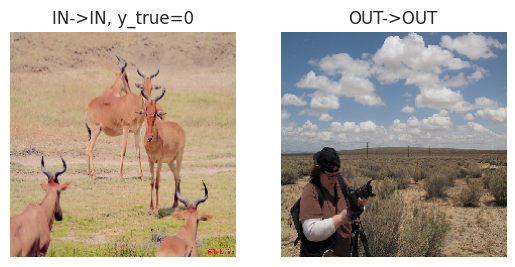

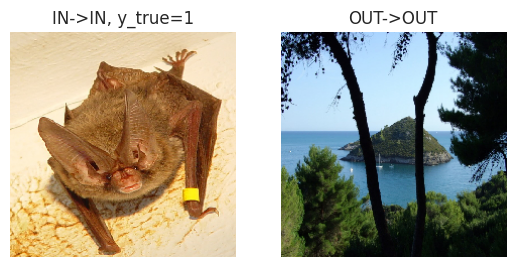

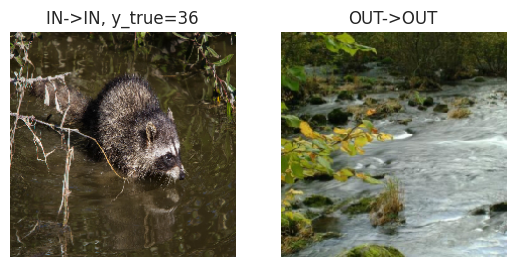

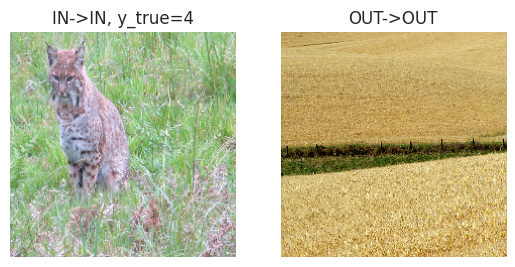

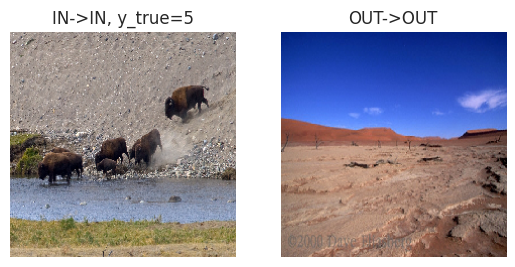

...

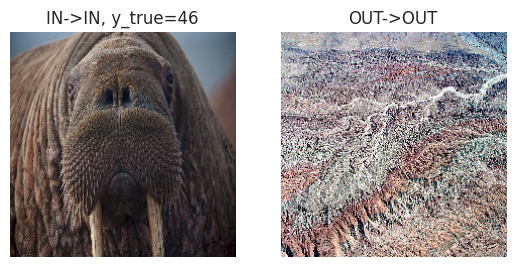

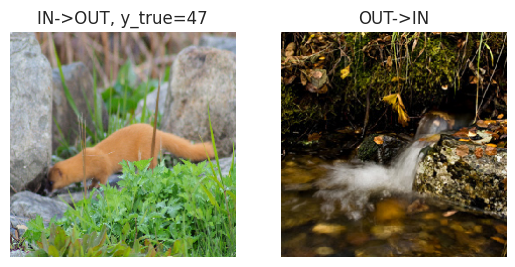

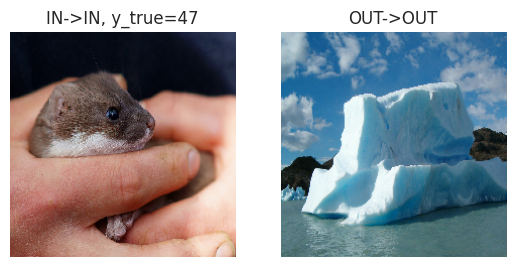

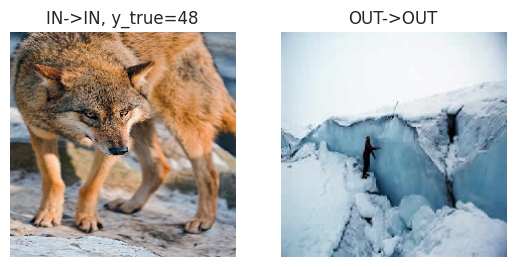

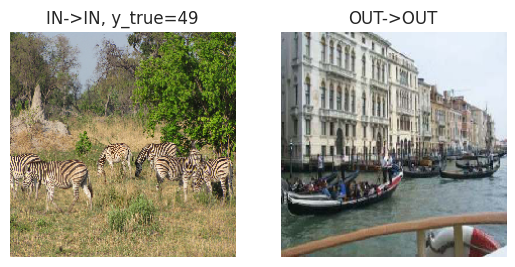

In [13]:
with tf.device('/CPU:0'):

    if args.explain and args.shap:
        logger.info(f'classes with highest and lowest separabilities...: {classes}')
        k = 10
        for i in range(N_CLASSES):
    
            idx_in = np.where(in_test_yhat == i)[0]
            idx_out = np.where(out_test_yhat == i)[0]
            in_concepts_ith = in_test_concepts[idx_in,:] # concept scores of ID data classified as class i
            out_concepts_ith = out_test_concepts[idx_out,:] # concept scores of OOD data classified as class i
            
            # if len(idx_in) < N_CONCEPTS or len(idx_out) < N_CONCEPTS:
            #     continue
    
            # indices for OOD detection results
            idx_IN_IN = in_test_scores[idx_in] >= thres95   # ID detected as ID
            idx_IN_OUT = ~idx_IN_IN                 # ID detected as OOD
            idx_OUT_OUT = out_test_scores[idx_out] < thres95 # OOD detected as OOD
            idx_OUT_IN = ~idx_OUT_OUT               # OOD detected as ID
            
            # relative comparison
            scores = {}
            labels = ['ID', 'OOD', 'ID->OOD', 'OOD->ID']
            scores[labels[0]] = in_concepts_ith
            scores[labels[1]] = out_concepts_ith
            scores[labels[2]] = in_concepts_ith[idx_IN_OUT]
            scores[labels[3]] = out_concepts_ith[idx_OUT_IN]
    
            scores1 = {}
            if (len(np.where(idx_IN_OUT)[0]) > 0) and (len(np.where(idx_OUT_IN)[0]) > 0):
                labels1 = ['ID', 'ID->OOD', 'OOD->ID', 'OOD']
                i_in_out = np.random.choice(len(np.where(idx_IN_OUT)[0]))
                i_out_in = np.random.choice(len(np.where(idx_OUT_IN)[0]))
                idx_in_out_sp = idx_in[idx_IN_OUT][i_in_out]
                idx_out_in_sp = idx_out[idx_OUT_IN][i_out_in]
                x_in_out_sp = in_loader[idx_in_out_sp//256][0][idx_in_out_sp%256]
                y_in_out_sp = in_loader[idx_in_out_sp//256][1][idx_in_out_sp%256]
                y_in_out_sp = int(np.where(y_in_out_sp)[0])
                x_out_in_sp = out_loader[idx_out_in_sp//256][idx_out_in_sp%256]
    
                scores1[labels1[0]] = in_concepts_ith
                scores1[labels1[3]] = out_concepts_ith
                scores1[labels1[1]] = np.expand_dims(in_concepts_ith[idx_IN_OUT][i_in_out], axis=0)  
                scores1[labels1[2]] = np.expand_dims(out_concepts_ith[idx_OUT_IN][i_out_in], axis=0)   
                
                fig, axes = plt.subplots(nrows=1, ncols=2)
                axes[0].imshow(x_in_out_sp)
                axes[0].set_title(f"IN->OUT, y_true={y_in_out_sp}")
                axes[0].axis("off")
                axes[1].imshow(x_out_in_sp)
                axes[1].set_title(f"OUT->IN")
                axes[1].axis("off")
                plt.savefig(os.path.join(explain_dir,'class{}_AwA2_{}_false_samples.jpg'.format(i,args.out_data)))
                
            scores2 = {}
            if (len(np.where(idx_IN_IN)[0]) > 0) and (len(np.where(idx_OUT_OUT)[0]) > 0):
                labels2 = ['ID', 'ID->ID', 'OOD->OOD', 'OOD']
                i_in_in = np.random.choice(len(np.where(idx_IN_IN)[0]))
                i_out_out = np.random.choice(len(np.where(idx_OUT_OUT)[0]))
                idx_in_in_sp = idx_in[idx_IN_IN][i_in_in]
                idx_out_out_sp = idx_out[idx_OUT_OUT][i_out_out]
                x_in_in_sp = in_loader[idx_in_in_sp//256][0][idx_in_in_sp%256]
                y_in_in_sp = in_loader[idx_in_in_sp//256][1][idx_in_in_sp%256]
                y_in_in_sp = int(np.where(y_in_in_sp)[0])
                x_out_out_sp = out_loader[idx_out_out_sp//256][idx_out_out_sp%256]
        
                scores2[labels2[0]] = in_concepts_ith
                scores2[labels2[3]] = out_concepts_ith
                scores2[labels2[1]] = np.expand_dims(in_concepts_ith[idx_IN_IN][i_in_in], axis=0) 
                scores2[labels2[2]] = np.expand_dims(out_concepts_ith[idx_OUT_OUT][i_out_out], axis=0)  
    
                fig, axes = plt.subplots(nrows=1, ncols=2)
                axes[0].imshow(x_in_in_sp)
                axes[0].set_title(f"IN->IN, y_true={y_in_in_sp}")
                axes[0].axis("off")
                axes[1].imshow(x_out_out_sp)
                axes[1].set_title(f"OUT->OUT")
                axes[1].axis("off")
                plt.savefig(os.path.join(explain_dir,'class{}_AwA2_{}_true_samples.jpg'.format(i,args.out_data)))
            
            
            if f"shap_class_class{i}" in shap_expl:
                shap_expl_class_i = shap_expl[f"shap_class_class{i}"]
                shap_expl_class_i_copy = shap_expl_class_i.copy()
                c_is = []
                for c_i, c_js in dict_dupl_topic.items():
                    c_js = [i_ for i_ in c_js if (i_ not in c_is)]
                    if len(c_js) > 0:
                        shap_expl_class_i_copy[np.array(c_js)] = np.nan
                    c_is.append(c_i)
                shap_expl_class_i_copy = shap_expl_class_i_copy[~np.isnan(shap_expl_class_i_copy)]
    
                explain_relative(scores, labels, separa['class'+str(i)], shap_expl_class_i_copy, 
                    figname=os.path.join(explain_dir,'class{}_AwA2_{}_shap_class_top{}_separability_{}.jpg'.format(i,args.out_data,k,args.score)),
                    figname_dist=os.path.join(explain_dir,'class{}_AwA2_{}_distribution.jpg'.format(i,args.out_data)),
                    top_k=k)
                if len(scores1)>0:
                    explain_relative(scores1, labels1, separa['class'+str(i)], shap_expl_class_i_copy, 
                            figname=os.path.join(explain_dir,'class{}_AwA2_{}_shap_class_top{}_separability_{}_false_eg.jpg'.format(i,args.out_data,k,args.score)),
                            figname_dist=os.path.join(explain_dir,'class{}_AwA2_{}_distribution.jpg'.format(i,args.out_data)),
                            top_k=k)
                if len(scores2)>0:
                    explain_relative(scores2, labels2, separa['class'+str(i)], shap_expl_class_i_copy, 
                        figname=os.path.join(explain_dir,'class{}_AwA2_{}_shap_class_top{}_separability_{}_true_eg.jpg'.format(i,args.out_data,k,args.score)),
                        figname_dist=os.path.join(explain_dir,'class{}_AwA2_{}_distribution.jpg'.format(i,args.out_data)),
                        top_k=k)
    
            if f"shap_detect_class{i}" in shap_expl:
                shap_expl_class_i = shap_expl[f"shap_detect_class{i}"]
                shap_expl_class_i_copy = shap_expl_class_i.copy()
                shap_expl_class_i_copy = shap_expl_class_i_copy.astype(float)
                c_is = []
                for c_i, c_js in dict_dupl_topic.items():
                    c_js = [i_ for i_ in c_js if (i_ not in c_is)]
                    if len(c_js) > 0:
                        shap_expl_class_i_copy[np.array(c_js)] = np.nan
                    c_is.append(c_i)
                shap_expl_class_i_copy = shap_expl_class_i_copy[~np.isnan(shap_expl_class_i_copy)]
    
                explain_relative(scores, labels, separa['class'+str(i)], shap_expl_class_i_copy, 
                    figname=os.path.join(explain_dir,'class{}_AwA2_{}_shap_detect_top{}_separability_{}.jpg'.format(i,args.out_data,k,args.score)),
                    figname_dist=os.path.join(explain_dir,'class{}_AwA2_{}_distribution.jpg'.format(i,args.out_data)),
                    top_k=k)
                if len(scores1)>0:
                    explain_relative(scores1, labels1, separa['class'+str(i)], shap_expl_class_i_copy, 
                            figname=os.path.join(explain_dir,'class{}_AwA2_{}_shap_detect_top{}_separability_{}_false_eg.jpg'.format(i,args.out_data,k,args.score)),
                            figname_dist=os.path.join(explain_dir,'class{}_AwA2_{}_distribution.jpg'.format(i,args.out_data)),
                            top_k=k)
                if len(scores2)>0:
                    explain_relative(scores2, labels2, separa['class'+str(i)], shap_expl_class_i_copy, 
                        figname=os.path.join(explain_dir,'class{}_AwA2_{}_shap_detect_top{}_separability_{}_true_eg.jpg'.format(i,args.out_data,k,args.score)),
                        figname_dist=os.path.join(explain_dir,'class{}_AwA2_{}_distribution.jpg'.format(i,args.out_data)),
                        top_k=k)
                